In [1]:
import torch
import math
from SC_IPFP.torch.utils import NN, log_kde_pdf_per_point, silvermans_rule
from SC_IPFP.torch.sde_solvers_time import solve_sde_RK


from tqdm.notebook import tqdm

from torch import nn

import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt

In [2]:
from torch import nn
class NN(nn.Module):

    def __init__(self, input_dim=1,  weight_dim_list=[20,20,20]):
        super(NN, self).__init__()

        self.weight_dim_list = [input_dim] + weight_dim_list
        self.layers = [None for i in weight_dim_list]

        for i in range(len(weight_dim_list)):
            setattr(
                self,
                "f" + str(i),
                nn.Linear(
                    self.weight_dim_list[i], self.weight_dim_list[i + 1], bias=True
                )
            )
            self.layers[i]  = getattr(self, "f" + str(i))

            torch.nn.init.xavier_uniform(self.layers[i].weight)
    
    def get_var(self , other=None):
        return torch.tensor([[0]]).double()

    def forward(self, x, var=None):
        functerino = torch.tanh
        x_ = x.clone()
        for i_, layer in enumerate(self.layers[:-1]):
            try:
                x = functerino(layer(x))
            except:
                print(x.shape, i_, x_.shape)
                import pdb; pdb.set_trace()
                raise
        try:
            return (self.layers[-1](x))
        except:
            import pdb; pdb.set_trace()
            raise


In [3]:
def solve_sde_RK(alfa=None, beta=None, X0=None, dt=1.0, N=100, t0=0.0,
                theta=None, noise=False, forwards=True):
    """
            Euler Mayurama method
    Syntax:
    ----------
    solve_sde(alfa=None, beta=None, X0=None, dt=None, N=100, t0=0, DW=None)
    Parameters:
    ----------
        alfa  : a  function with two arguments, the X state and the time
                defines the differential equation.
        beta  : a  function with two arguments, the X state and the time
                defines the stochastic part of the SDE.
        X0    : Initial conditions of the SDE. Mandatory for SDEs
                with variables > 1 (default: gaussian np.random)
        dt    : The timestep of the solution
                (default: 1)
        N     : The number of timesteps (defines the length of the timeseries)
                (default: 100)
        t0    : The initial time of the solution
                (default: 0)
    
    """
    
#     print(X0)
       
    if alfa is None or beta is None:
        raise ValueError("Error: SDE not defined.")

    n, d, *_ = X0.shape
    
    T = torch.tensor(dt * N).cuda()
    
    DWs  = torch.empty((n, N-1, d)).normal_(mean=0, std=1).cuda() * math.sqrt(dt)
    
    
    Y, ti = torch.zeros((n, N, d + 1)).double().cuda(), torch.arange(N).double().cuda()*dt + t0
    t0rep =  (
        t0 * torch.ones((X0.shape[0], 1)).double().cuda() if forwards
        else (T-t0) * torch.ones((X0.shape[0], 1)).double().cuda()
    )
#     Y[:, 0, :] =  torch.cat((X0, t0rep), axis=1 )
    Y = torch.cat((X0, t0rep), axis=1 )[:, None, :]

    N = int(N)
    
    T = dt * N
        
    for n in range(N-1):
        t = ti[n]
        a, DW_n = alfa(Y[:,n, :]),  DWs[:,n,:]
        newY = (  
            Y[:,n, :-1] + a * dt + beta * DW_n
        )
        
        trep = (
            t.repeat(newY.shape[0]).reshape(-1,1) if forwards
            else T - t.repeat(newY.shape[0]).reshape(-1,1)
        )
        
        tocat = torch.cat((newY, trep), dim=1)[:, None, :]
        Y = torch.cat((Y,tocat) , dim=1)
    if torch.isnan(Y).any() or torch.isinf(Y).any(): import pdb; pdb.set_trace()
#     import pdb; pdb.set_trace()
    return ti, Y

In [4]:
def divergence(outputs, inputs):
    grads_ = torch.autograd.grad(
            outputs, inputs, torch.ones_like(outputs),
            retain_graph=True, create_graph=True
     )[0]
    return grads_[:,:,:-1].sum(dim=2)

In [5]:
class cIPFP(object):
    
    def __init__(self, X_0, X_1, weights=[100], batch_size=None,  rng = None, rng_b = None, 
                nrng = None, number_time_steps=16, sde_solver=solve_sde_RK, sigma_sq=1, 
                step_size = 0.001, num_epochs = 10, weight_decay = 0.9, create_network=None,
                log_prob=log_kde_pdf_per_point, optimizer=torch.optim.SGD, lrs = None):
        
        self.sde_solver = sde_solver
        
        self.number_time_steps = number_time_steps
        self.dt = 1.0 / number_time_steps
        
        
        self.batch_size_f = X_0.shape[0] if batch_size is None else batch_size
        self.batch_size_b = X_1.shape[0] if batch_size is None else batch_size
        with torch.cuda.device(0):
        
            self.X_0 = X_0.requires_grad_()
            self.X_1 = X_1.requires_grad_()

            self.H_0 = silvermans_rule(X_0)
            self.H_1 = silvermans_rule(X_1)

            _, self.dim = self.X_0.shape

            weights = weights + [self.dim]


            self.b_forward = NN(self.dim + 1, weights).double().cuda()
            self.b_backward = NN(self.dim + 1, weights).double().cuda()

            self.theta_f = list(self.b_forward.parameters())
            self.theta_b = list(self.b_backward.parameters())

            self.sigma = sigma_sq

            self.optimizer_f = optimizer(
                self.theta_f, lr=step_size, weight_decay=weight_decay
            )

            self.optimizer_b = optimizer(
                self.theta_b, lr=step_size, weight_decay=weight_decay
            )
            
            m = 0.1
            lr_lambda = lambda epoch : 1.0 / (1.0 + lrs * epoch)


            self.lrs_f  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_f, lr_lambda, last_epoch=-1)
            self.lrs_b  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_b, lr_lambda, last_epoch=-1)

            num_complete_batches_f, leftover_f = divmod(self.X_0.shape[0], self.batch_size_f)
            self.num_batches_f = num_complete_batches_f + bool(leftover_f)

            num_complete_batches_b, leftover_b = divmod(self.X_1.shape[0], self.batch_size_b)
            self.num_batches_b = num_complete_batches_b + bool(leftover_b)

            self.first_iter_fac = 0.0

            self.log_prob = log_prob

            self.burn_in = False
    
    def data_stream(self, forward=True):
        X = self.X_0 if forward else self.X_1
        
        batch_size = self.batch_size_f if forward else self.batch_size_b
        num_batches = self.num_batches_f if forward else self.num_batches_b
        
        num_train = self.X_0.shape[0] if forward else self.X_1.shape[0]
        while True:
            perm = torch.randperm(X.size()[0])
            for i in range(num_batches):
                batch_idx = perm[i * batch_size:(i + 1) * batch_size]
                yield X[batch_idx] 
        
    def loss_for_trajectory(self, Xt, forwards):
        n_, *_ = Xt.shape
        
#         if not forwards :
#             Xt = Xt.flip(1)
        
        if forwards:
            b_minus  = self.b_backward.forward( Xt)
            b_plus = self.b_forward.forward(Xt)
            div = divergence(b_minus, Xt)
        else:
            b_minus  = self.b_backward.forward(Xt)
            b_plus = self.b_forward.forward(Xt) * self.first_iter_fac 
            div = -divergence(b_plus, Xt) * self.first_iter_fac 

            
        sign = 1.0 if forwards else -1.0
        
        time_integral = (sign *  (b_plus - b_minus))**2 * self.dt 
        out =  0.5 * time_integral.sum(dim=(1,2))  - (div.sum(dim=(1)) *  self.dt )
        
        return out


    def inner_loss_jit(self, batch,  
                       batch_terminal_empirical,
                       forwards):
        
        b = (
            self.b_forward.forward
            if forwards else (lambda X: -self.b_backward.forward(X))
        )
        
        t, Xt, *W = self.sde_solver(
            b, self.sigma, batch, self.dt, 
            self.number_time_steps, 0,
            None, False, forwards
        )
        Ht = silvermans_rule(Xt[:,-1,:-1])
        H = silvermans_rule(batch_terminal_empirical)
        
        main_term = self.loss_for_trajectory(Xt, forwards)

        if not self.burn_in:
#             xx = torch.linspace(-30, 30 , 1000).reshape(-1,1).double().cuda()
#             yy = self.log_prob( xx, batch_terminal_empirical, H)  
#             plt.plot(
#                 xx.detach().cpu().numpy(),
#                 np.exp(yy.detach().cpu().numpy())
#             )
#             plt.show()
            cross_entropy = -self.log_prob( Xt[:,-1,:-1], batch_terminal_empirical, H)             
        else:
            cross_entropy = -self.log_prob(batch_terminal_empirical, Xt[:,-1,:-1], Ht)

        J = torch.mean(main_term +  2.0 * cross_entropy )
        J = torch.squeeze(J)
        return J
    
    def inner_loss(self, batch, forwards=True):
        
        if self. burn_in:
            self.batch_terminal_empirical_burn = next(self.data_stream(forward=forwards))
            self.H_burn = self.H_0 if forwards else self.H_1
#         else:
        batch_terminal_empirical = next(self.data_stream(forward=not(forwards)))
        H = self.H_1 if forwards else self.H_0

        return self.inner_loss_jit(
            batch, batch_terminal_empirical,
            forwards
        )

    def closure(self, X, forwards=True):
        """
        Close method required for pytorches CG and LBFGS optimizers
        :params X[torch.tensor]: nxdim  torch tensor representing dataset
        """
        
        opt = self.optimizer_f if forwards else self.optimizer_b
        
        opt.zero_grad()
        loss = self.inner_loss(X, forwards)
        loss.backward()
        return loss
    
    
    def fit(self, IPFP_iterations=10, sub_iterations=10, plot=False, burn_iterations=7):     
        
        name = str(self.optimizer_f).lower()
        bfgs_cg_flag  = "bfgs" in name or "cg" in name
        close_f, close_b =  [], []

        
        
        if plot: self.plot_trajectories()
        
        self.first_iter_fac = 0.0
        if burn_iterations > 0 : self.burn_in = True
            
        
        batches_f = self.data_stream(forward=True)
        batches_b = self.data_stream(forward=False)
        
        loss_b, loss_f = [], []
        for i in tqdm(range(IPFP_iterations + burn_iterations)):
            
            if i == burn_iterations:
                self.burn_in = False
                self.first_iter_fac = 0.0
            
            
            for k in range(sub_iterations):
                for _ in range(self.num_batches_b):
                    batch_b =  next(batches_b)
                    
                    if bfgs_cg_flag:
                        close_b = [lambda : self.closure(batch_b, False)]
                    lossb = self.inner_loss(
                        batch_b, False
                    )
                    lossb.backward()
                    self.optimizer_b.step(*close_b)
                    self.lrs_b.step()
                print(f"loss b {lossb}")
            loss_b.append(lossb)

            self.first_iter_fac = 1.0
       
            for k in range(sub_iterations):
                for _ in range(self.num_batches_f):
                    batch_f =  next(batches_f)
                    if bfgs_cg_flag:
                        close_f = [lambda : self.closure(batch_f, True)]
                    lossf = self.inner_loss(
                        batch_f, True
                    )
                    
                    lossf.backward()
                    self.optimizer_f.step(*close_f)
                    self.lrs_f.step()
  
                print(f"loss f {lossf}")
            loss_f.append(lossf)


            self.loss_f = loss_f
            self.loss_b = loss_b
            if plot: self.plot_trajectories()

        
        plt.plot(range(IPFP_iterations), loss_f, "g")
        plt.show()
        plt.plot(range(IPFP_iterations), loss_b, "b")
        plt.show()
        
    def plot_trajectories(self):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    
    
    #     @partial(jit, static_argnums=(0,2))
    def transport_batch(self, batch_x, forwards):
        theta = self.theta_f if forwards else self.theta_b    
        b = self.b_forward if forwards else  lambda X, theta: -self.b_backward(X, theta)

        t, Xt = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, 
            X0=batch_x.reshape(-1,self.dim), N=self.number_time_steps, theta=theta
        )

        return Xt[:,-1,:]
            

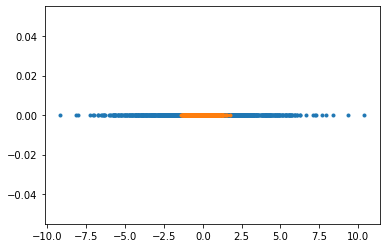

In [36]:
import numpy.random as npr
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n = 900
n_2 = int(n * 1.0 / 3)
n_2 = int(n * 1.0 / 2.0)


X1 = 3 * npr.randn(n).reshape(-1,1) - 0
X21 = 0.5 * npr.randn(n_2).reshape(-1,1) + 0
X22 =  0.5 * npr.randn(n_2).reshape(-1,1) + 0
# X23 =  0.6 * npr.randn(n_2).reshape(-1,1) + 20

X2 = np.concatenate((X21, X22), axis=0)
X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

with torch.cuda.device(0):

    X1 = torch.tensor(X1).cuda()
    X2 = torch.tensor(X2).cuda()

In [37]:


torch.cuda.manual_seed_all(10)
torch.manual_seed(10)

c = cIPFP(
    X1, X2,  number_time_steps=100, batch_size=900 ,
    step_size=1e-3, weights=[20,20,20], rng = None,
    optimizer=torch.optim.Adam, lrs = 0.001, weight_decay=0
)

/anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


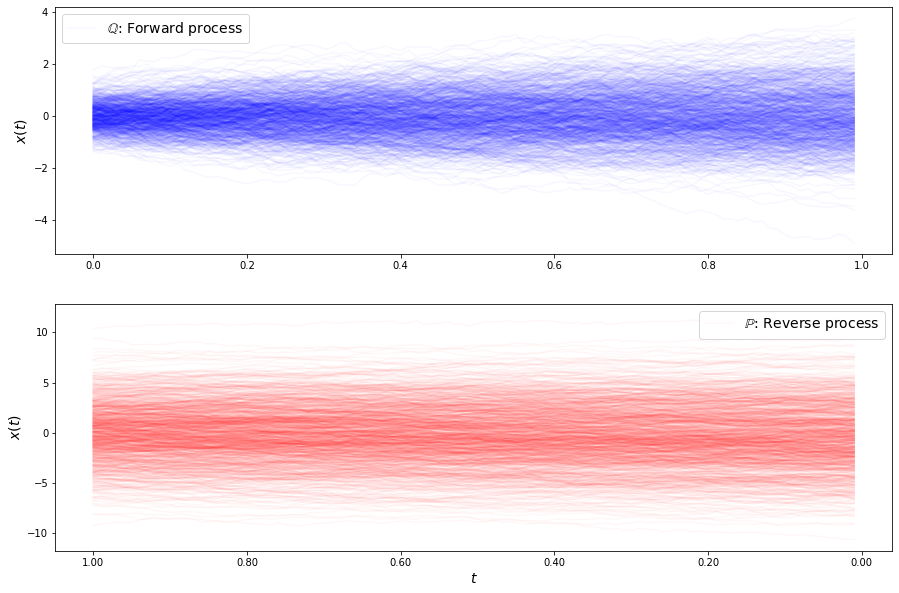

loss b 82.08258619839091
loss b 80.29730580814181
loss b 73.924542401715
loss b 77.98278382357351
loss b 70.05439562049035
loss b 66.86255150350696
loss b 66.6331138802835
loss b 65.43600327794535
loss b 63.01039949862448
loss b 63.88635179828616
loss b 55.54351105427808
loss b 55.89351217254673
loss b 58.27344641655118
loss b 53.977551875270414
loss b 50.105080284867185
loss b 49.63384392813504
loss b 47.22848978977671
loss b 46.13398237605784
loss b 45.04014165128771
loss b 44.084730347792494
loss b 41.89764115789136
loss b 41.792674244744
loss b 39.66985340670602
loss b 36.23540816659137
loss b 33.418442637157575
loss b 35.257869584124165
loss b 31.605264364997698
loss b 31.528148811472335
loss b 30.686420154571955
loss b 29.796334776336302
loss f 1.359538885702661
loss f 1.3721512746107063
loss f 1.3730141224265766
loss f 1.3643441494289033
loss f 1.3685355869974345
loss f 1.362222898870317
loss f 1.364636151363812
loss f 1.3722901104876255
loss f 1.3922919159300151
loss f 1.361219

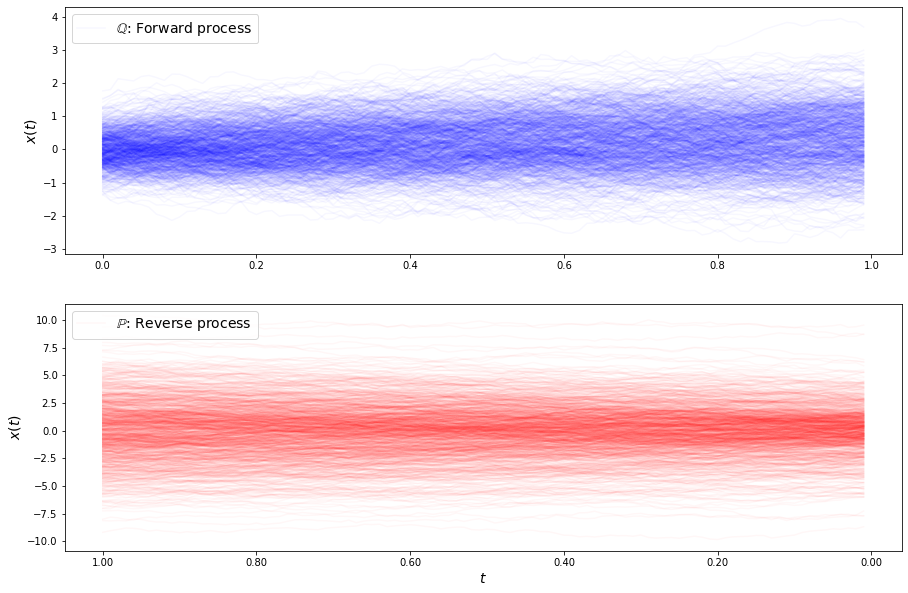

loss b 29.222565549710524
loss b 26.76628785291158
loss b 28.497723069471007
loss b 25.506242457060196
loss b 24.670646793700044
loss b 24.4777311491371
loss b 22.163727335439475
loss b 22.475413061806744
loss b 21.468199604470847
loss b 21.340563522357353
loss b 21.032453757026822
loss b 22.510229935096223
loss b 21.402925533423172
loss b 20.542233418639082
loss b 19.33587938033863
loss b 18.681639150797988
loss b 18.427502498917846
loss b 19.340139414989263
loss b 18.146544891363
loss b 16.62137613186829
loss b 15.163423816791889
loss b 14.63336958535308
loss b 16.105570725318934
loss b 16.540070714480258
loss b 14.103044805096
loss b 15.66836052175086
loss b 13.886825408849385
loss b 14.560689307780336
loss b 13.342214486320291
loss b 14.272413835048221
loss f 1.6849213228054558
loss f 1.6021175187696222
loss f 1.6348010676598133
loss f 1.601988121333632
loss f 1.6194870068293636
loss f 1.5873920702665343
loss f 1.517144568572697
loss f 1.491188184718215
loss f 1.438251859689542
los

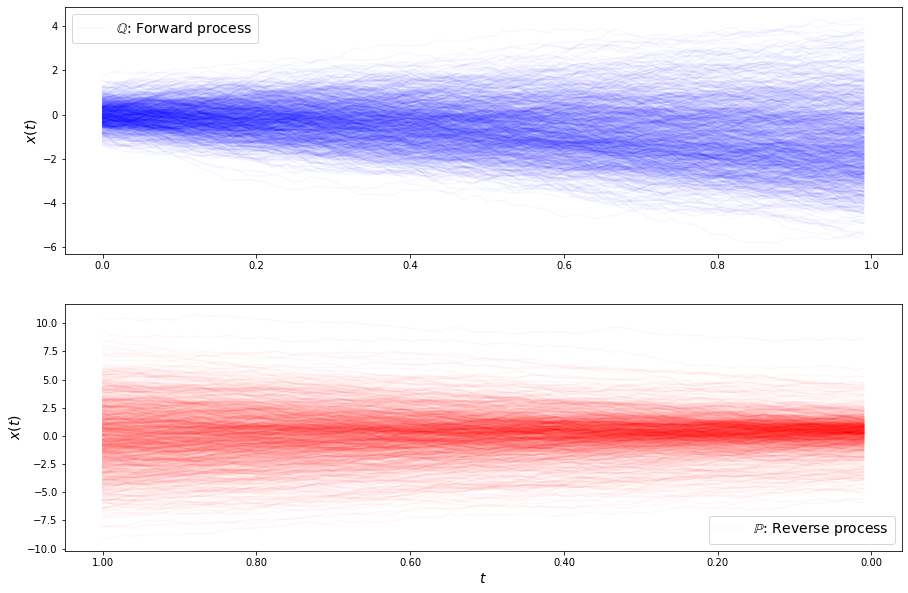

loss b 12.196456959274691
loss b 11.191443016346673
loss b 9.791506526341383
loss b 11.383693295860311
loss b 11.154227601978812
loss b 9.628342482646254
loss b 9.75905521182106
loss b 8.952165503821595
loss b 10.657145900921233
loss b 7.7027419169648
loss b 9.080149947711886
loss b 8.588507135877819
loss b 8.210418488347926
loss b 7.13150518982464
loss b 8.053469712821956
loss b 6.585885133680786
loss b 8.22263611162199
loss b 6.963155263554835
loss b 6.260454032026336
loss b 6.81891091860908
loss b 6.888219046616364
loss b 6.641199674220039
loss b 6.369835848377375
loss b 6.163921088631719
loss b 5.853748347834435
loss b 6.3144767697236714
loss b 5.818933662526286
loss b 5.726644623189427
loss b 6.483718784495468
loss b 5.857968618340364
loss f 1.461103087346688
loss f 1.4514354571793977
loss f 1.4847308726704542
loss f 1.516385830094665
loss f 1.4834496425017563
loss f 1.5249697904897233
loss f 1.4410452324398724
loss f 1.5427908260642742
loss f 1.3928131131074226
loss f 1.387198084

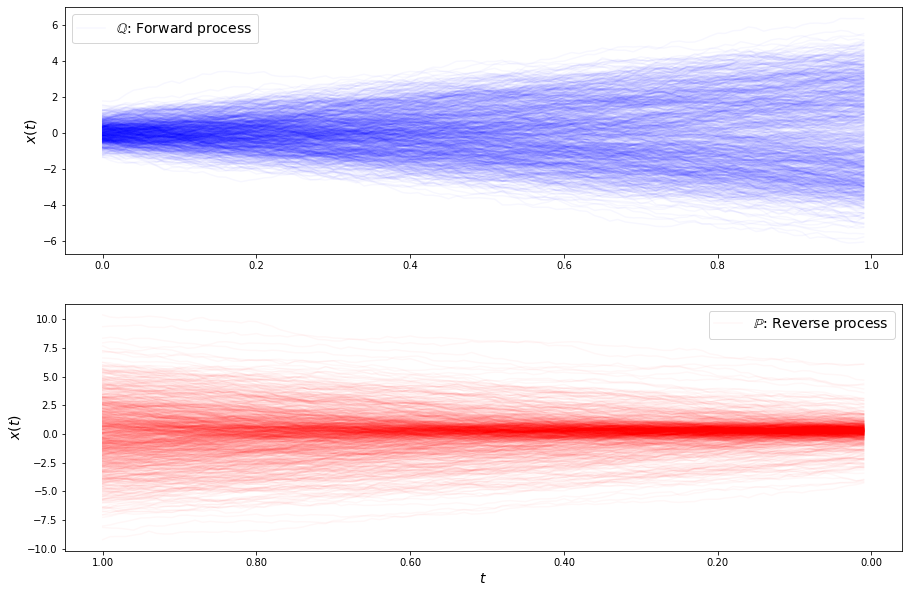

loss b 5.719359671481942
loss b 5.485447688103879
loss b 6.065786343923558
loss b 4.557114876540789
loss b 5.164077343684161
loss b 5.022663331551979
loss b 4.980254716351988
loss b 4.3549861977151165
loss b 4.523327981450748
loss b 5.006799187097772
loss b 4.865392652660454
loss b 4.393371990803493
loss b 4.740382333448446
loss b 4.080024928005982
loss b 4.2174751079701
loss b 4.011723218075666
loss b 4.329488435824692
loss b 3.780002203313812
loss b 3.737809214680328
loss b 3.584863930961924
loss b 4.0202395597231035
loss b 3.513166064930194
loss b 3.8372556782966654
loss b 3.642939353795262
loss b 3.453072190402439
loss b 4.318167102144261
loss b 3.71591828908865
loss b 3.3959038407618216
loss b 3.5221841244351184
loss b 3.6553133597121317
loss f 1.9569703075044211
loss f 1.9721257572572546
loss f 1.9532670165605746
loss f 1.917389407369892
loss f 1.9800038390100572
loss f 1.917844205231598
loss f 1.9676268040971372
loss f 1.842269928790929
loss f 1.9298179851933888
loss f 2.0157186

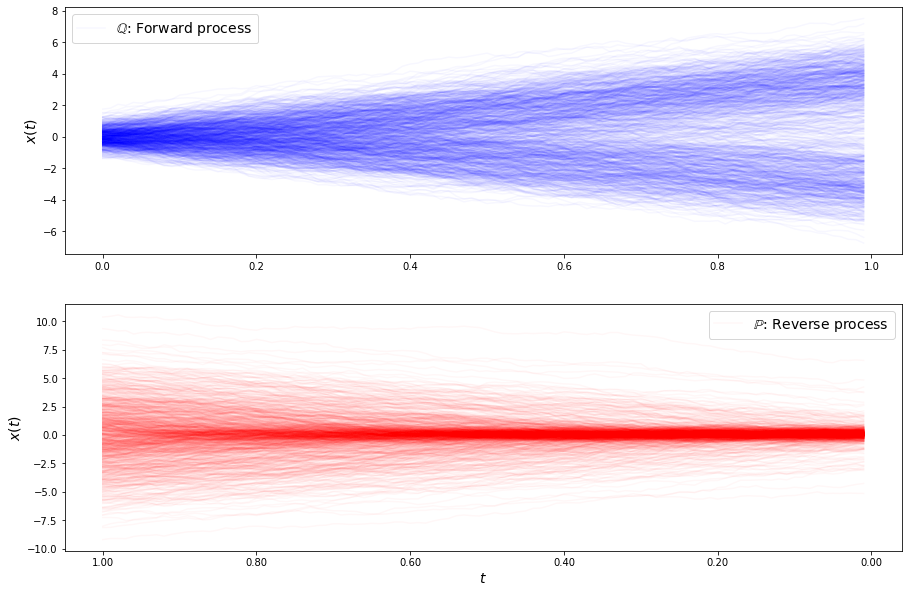

loss b 3.8571226269340113
loss b 3.74905127343583
loss b 3.5780759505689694
loss b 3.68965297718723
loss b 3.7518635723130633
loss b 3.606758129651708
loss b 3.8314741996608377
loss b 3.568985691545264
loss b 3.3832414423107435
loss b 2.93550028682438
loss b 3.53738897474626
loss b 3.3371281763401996
loss b 3.117328581995905
loss b 3.3064128089444504
loss b 3.53638877022805
loss b 3.130837625591359
loss b 3.803390841152298
loss b 3.094756660625041
loss b 3.5132313041138556
loss b 3.6353953131946373
loss b 3.1413112006753074
loss b 3.839626416086814
loss b 3.5142134235004194
loss b 3.325736825750328
loss b 3.0895338192127837
loss b 3.112044755870944
loss b 3.5283838504198184
loss b 3.39755289231075
loss b 3.9571228924593136
loss b 3.7170617874005747
loss f 2.4890849324626623
loss f 2.428048833718739
loss f 2.4887940747826995
loss f 2.4331122847082005
loss f 2.5199736201561818
loss f 2.4871460550847444
loss f 2.505916313196598
loss f 2.4396828215358535
loss f 2.4470589266644724
loss f 2.

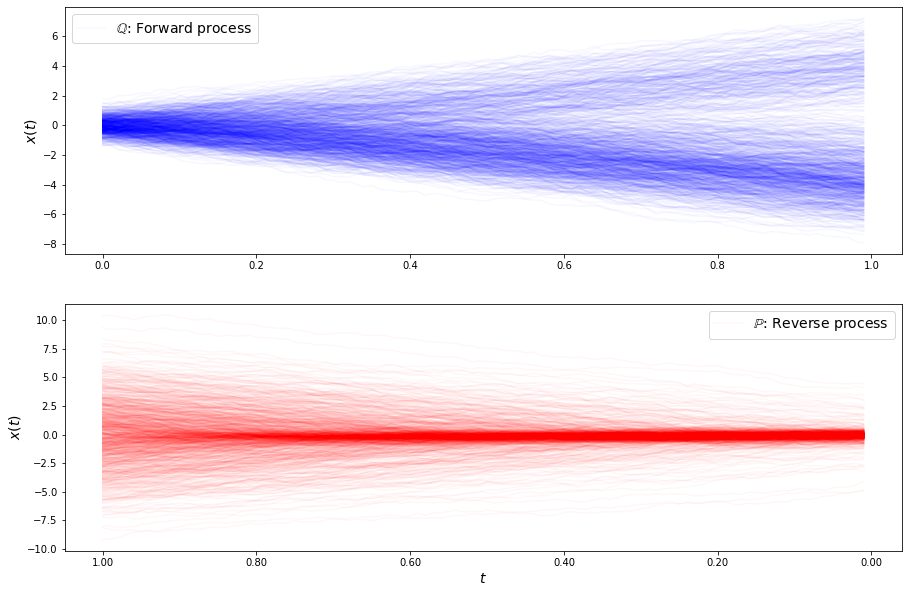

loss b 4.391577411992785
loss b 4.1582679782972205
loss b 4.487456834691086
loss b 4.237813025229212
loss b 4.1008511391747895
loss b 4.418501951625898
loss b 4.697384371467506
loss b 4.197803470471725
loss b 4.531752915711627
loss b 4.921255582705709
loss b 4.5583676458119315
loss b 4.889732091506566
loss b 5.06747888456952
loss b 4.457588033260031
loss b 4.859477846356404
loss b 5.146434202291359
loss b 4.8147823268519945
loss b 4.594040045964517
loss b 5.035108067324449
loss b 4.945429052220816
loss b 5.0592757293030965
loss b 5.014969560459226
loss b 4.552588189231757
loss b 4.962750311385647
loss b 4.825002756111692
loss b 5.204314213981689
loss b 4.717386838131854
loss b 4.882790580897189
loss b 4.662416756055019
loss b 5.079460682177502
loss f 3.6544473157902204
loss f 3.6570211781691273
loss f 3.6254743691807487
loss f 3.6015971018242086
loss f 3.5964438903786053
loss f 3.5773371003132026
loss f 3.5590356605148195
loss f 3.3443260775699613
loss f 3.308232084934734
loss f 3.4033

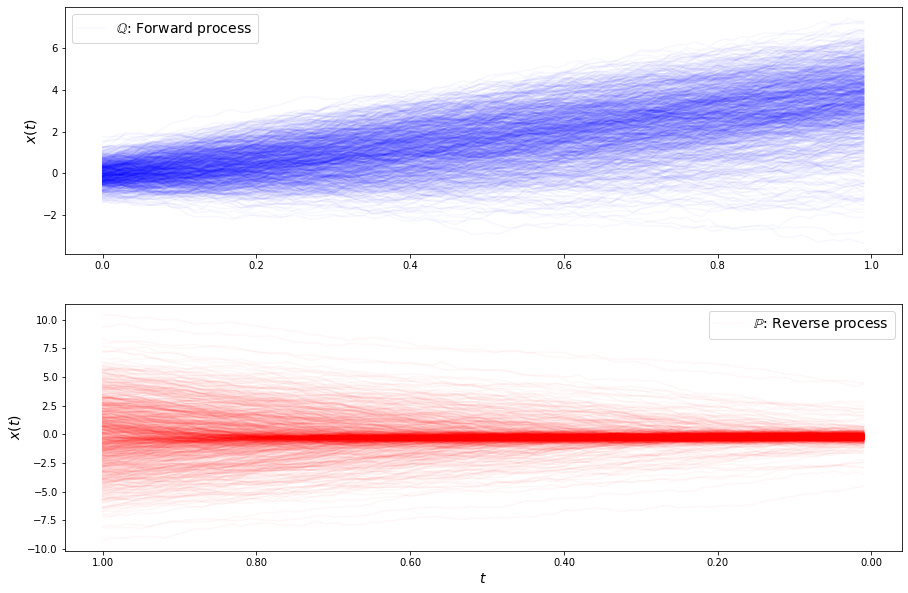

loss b 5.798972207490471
loss b 5.747891570799084
loss b 5.93494313915152
loss b 5.550957351568202
loss b 5.739764989553938
loss b 6.090107678079395
loss b 6.218681686820163
loss b 5.976274363510276
loss b 5.905668919212966
loss b 5.463406359758999
loss b 5.792827679190505
loss b 5.676314601068798
loss b 5.844127206795235
loss b 5.9602058472632695
loss b 5.983667526792411
loss b 5.592649404619697
loss b 5.819087563694527
loss b 5.958457700476836
loss b 5.7158014979926834
loss b 6.438674937923777
loss b 5.920730312002076
loss b 5.851775560220851
loss b 6.168124561348146
loss b 5.85613147533873
loss b 5.908831673405945
loss b 6.361048577069877
loss b 6.1570276133051784
loss b 6.260956719409137
loss b 5.776263600267236
loss b 6.698225517486098
loss f 3.943900192401095
loss f 3.894260819521382
loss f 3.930312064445626
loss f 3.8899309542435825
loss f 3.9598788984254254
loss f 4.0886119296954195
loss f 3.973486312739217
loss f 3.976233557818526
loss f 3.992135877145459
loss f 3.865353114421

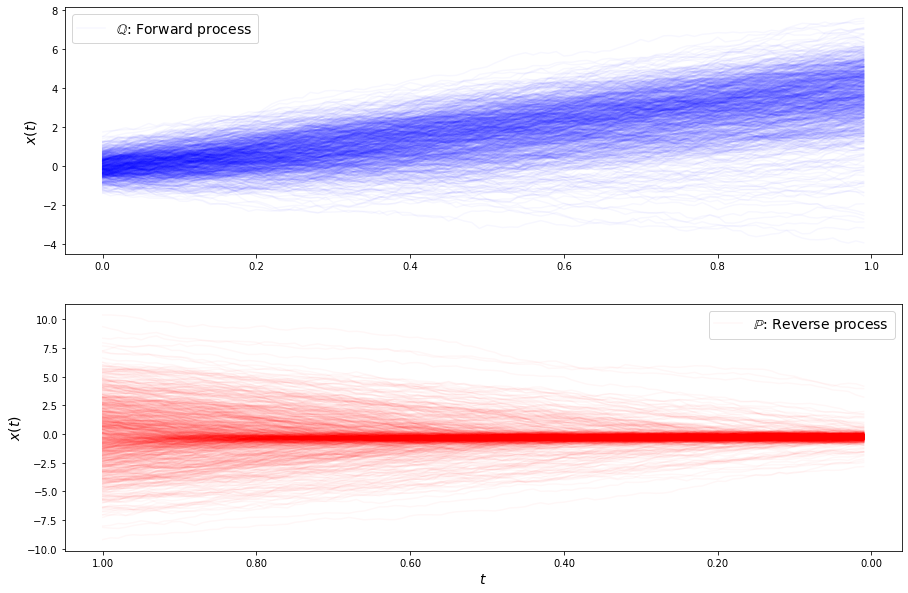

loss b 6.75730124798287
loss b 6.363485680486749
loss b 6.486892638323092
loss b 6.209970774221755
loss b 6.372291452232392
loss b 6.425425625404118
loss b 6.325727719910632
loss b 6.661909529172541
loss b 6.272000521048982
loss b 6.302390043129026
loss b 6.260302361715647
loss b 6.170626231554979
loss b 6.190634218589643
loss b 6.186380600046502
loss b 6.108165677867731
loss b 6.354760349746566
loss b 6.276160808866875
loss b 6.185038219812869
loss b 6.177385621876658
loss b 6.057119770673779
loss b 6.138338692358388
loss b 6.098961007481456
loss b 6.207450488415634
loss b 6.12636373190738
loss b 5.896165830294231
loss b 6.203464264246516
loss b 6.185390212434593
loss b 5.881404765684618
loss b 6.485754864540994
loss b 6.083120996693939
loss f 3.866039795155247
loss f 3.924127617578831
loss f 3.8280742319377787
loss f 3.9055681976374426
loss f 3.905804847920111
loss f 4.11272163634086
loss f 4.0602148264094735
loss f 3.948360089645523
loss f 3.989801759253525
loss f 3.930631824540931


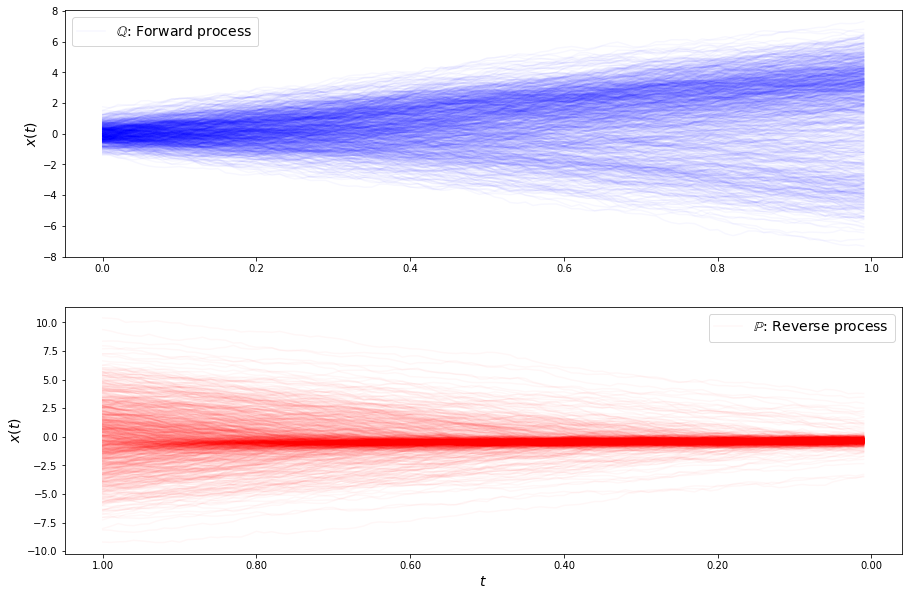

loss b 3.5122788064947366
loss b 4.04835246560015
loss b 3.940047853188691
loss b 3.609565934632498
loss b 3.2401246407743605
loss b 3.6046062879386422
loss b 3.8366367146819544
loss b 3.5835451873473967
loss b 3.685886540080412
loss b 3.732341416191201
loss b 3.4848033469712294
loss b 3.4317822784626553
loss b 3.6122917390046005
loss b 3.8935961578238154
loss b 3.672753029511011
loss b 3.7932723194282274
loss b 3.7032641480144384
loss b 3.8940708990677053
loss b 3.8026909028035023
loss b 3.777794793629475
loss b 3.8945631688416715
loss b 3.7139974335809325
loss b 3.9454650625338425
loss b 4.006310676686062
loss b 3.7216607240477755
loss b 3.979075090508469
loss b 3.9126746575907467
loss b 3.5700800285802066
loss b 3.891952961188994
loss b 3.7082571316637245
loss f 4.0443404567776335
loss f 3.9158692116529754
loss f 3.836511442866965
loss f 3.852495970199611
loss f 4.045034751167689
loss f 3.964994744659927
loss f 4.050602805089959
loss f 4.011487312299597
loss f 3.907994012798373
loss

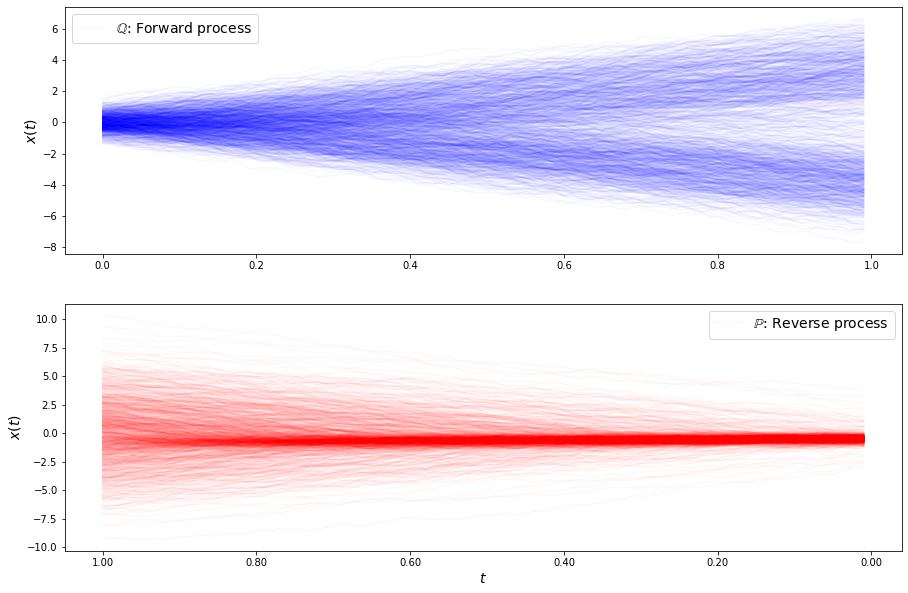

loss b 5.291654867669778
loss b 5.509166994280477
loss b 5.753413346278907
loss b 5.317773969484442
loss b 5.920708327301577
loss b 5.715462281715718
loss b 5.460448754546689
loss b 5.376420315419125
loss b 5.679091134503392
loss b 5.480378808784056
loss b 5.444436678276185
loss b 5.56651989425964
loss b 5.516075089144166
loss b 5.518390169008482
loss b 5.6763094752024434
loss b 5.469226704680139
loss b 5.318381714227166
loss b 5.420515025509249
loss b 5.226874103275868
loss b 5.468018285369166
loss b 5.32349758708082
loss b 5.664188774731534
loss b 5.35818273008642
loss b 5.215664770830528
loss b 5.3146600912368305
loss b 5.286332306933992
loss b 5.222243869807745
loss b 4.922618570468824
loss b 5.014250302716624
loss b 5.015409482959924
loss f 4.102405182699295
loss f 4.277539695674041
loss f 4.188418967555734
loss f 4.261702362320192
loss f 4.219851659967034
loss f 4.232074962800984
loss f 4.298018440236852
loss f 4.219326958253471
loss f 4.164358295405486
loss f 4.257588301442472
l

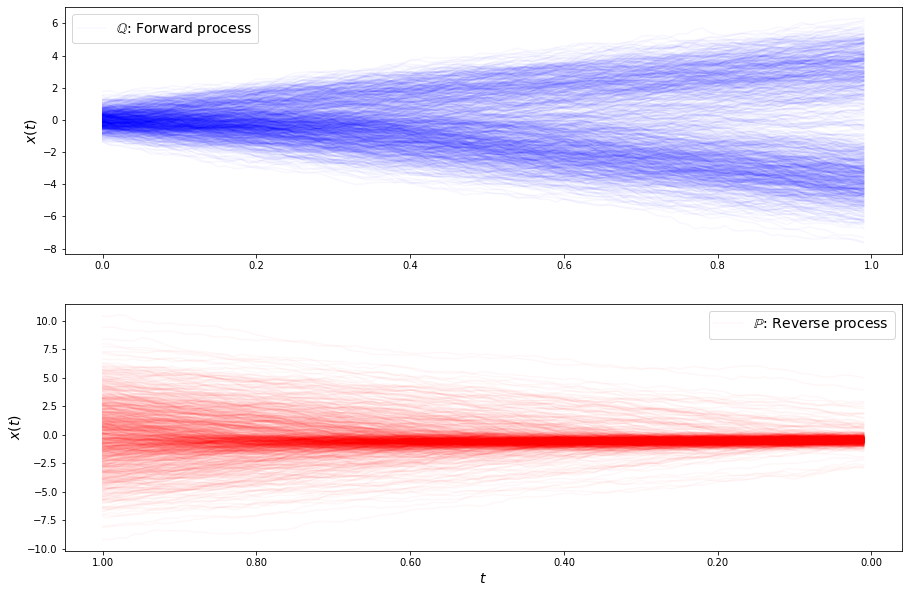

loss b 4.743093560757739
loss b 4.640669595133532
loss b 4.618106557694344
loss b 4.407442019575601
loss b 4.509182007408631
loss b 4.512155447578042
loss b 4.162268098787243
loss b 4.243690072369036
loss b 4.143862847440019
loss b 4.170645648120298
loss b 3.7817765042598497
loss b 4.085346981804576
loss b 3.965875637836969
loss b 4.142381692758016
loss b 3.980751981128129
loss b 3.7774990161317965
loss b 3.692169987933867
loss b 3.568685648532782
loss b 3.6181990373029294
loss b 3.474399857650531
loss b 3.5099201588636544
loss b 3.285293036044038
loss b 3.3930259182389677
loss b 3.250493420733392
loss b 3.0199645476219352
loss b 3.181076061038904
loss b 3.2251003054603973
loss b 3.2237945177062706
loss b 3.3628068287072557
loss b 3.1202784569111564
loss f 2.8486415010782156
loss f 2.9706379570878494
loss f 2.8777589027694104
loss f 2.8803651583077925
loss f 2.7594972170107392
loss f 2.763998186397284
loss f 2.951193082150832
loss f 2.7011319588008793
loss f 2.8382965638838984
loss f 2

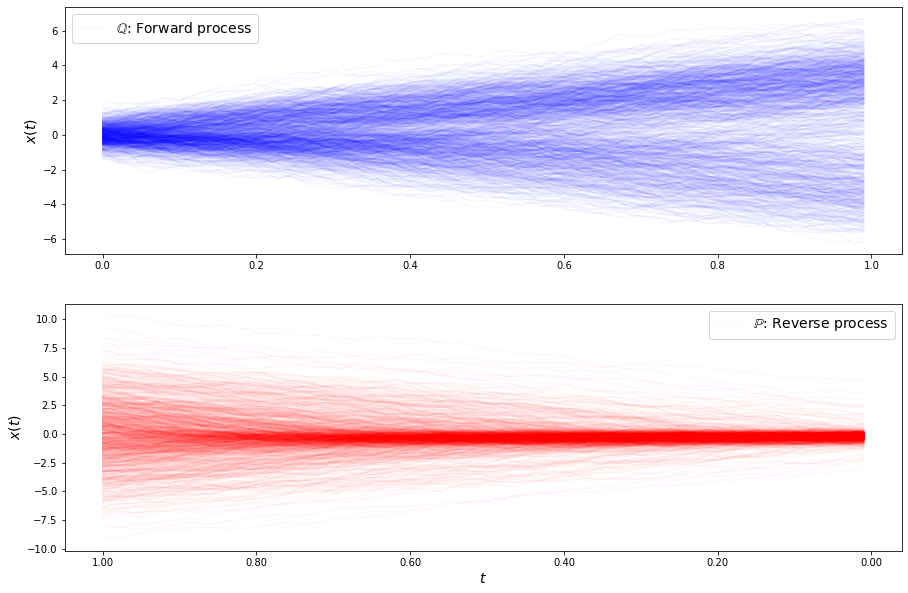

loss b 2.7018530722975815
loss b 2.5842849248465547
loss b 2.7932247117386297
loss b 2.803578679566025
loss b 2.747652432297937
loss b 2.92471551823916
loss b 2.780230677608326
loss b 3.013044468210641
loss b 2.8126155250669203
loss b 3.030300524839298
loss b 2.9484456745974184
loss b 2.8798074481499683
loss b 3.0779646301988706
loss b 2.6264857784668054
loss b 2.8433563162421334
loss b 3.064016148527254
loss b 2.736626605643177
loss b 3.1605733033611854
loss b 2.8932231767914507
loss b 3.0062326452945403
loss b 2.9660588119526743
loss b 3.3100691670610605
loss b 3.000245007613212
loss b 3.545989118977279
loss b 3.6367467351328444
loss b 3.37249853364899
loss b 3.2427147278001853
loss b 3.389930818762364
loss b 3.10751177280602
loss b 3.604044571642427
loss f 2.733707140624324
loss f 2.7281131842678468
loss f 2.7424748852404695
loss f 2.7730444768166667
loss f 2.773936650662468
loss f 2.9036994268962073
loss f 2.9054118131143847
loss f 2.811282309508659
loss f 2.859927760793907
loss f 

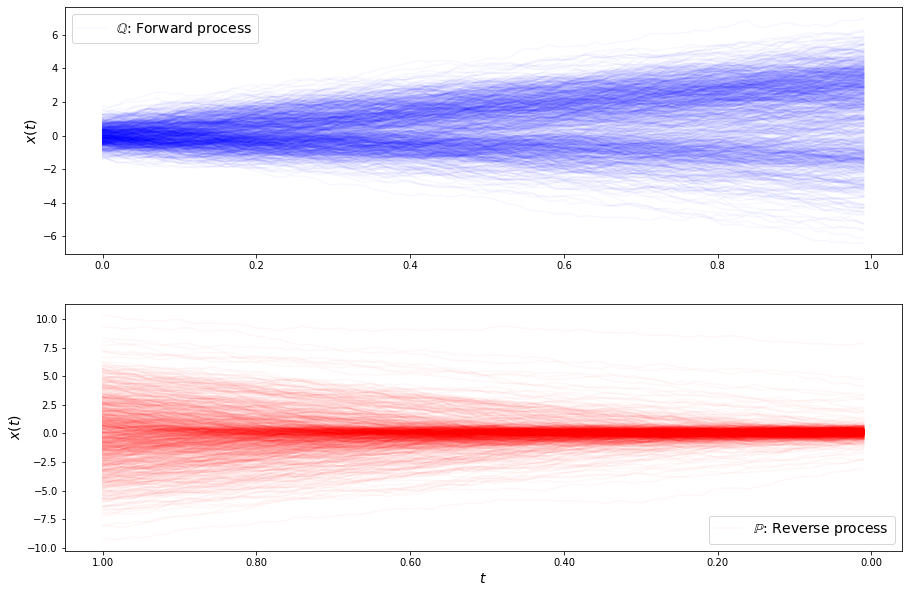

loss b 4.083829688381828
loss b 4.000201661895165
loss b 4.207448963357004
loss b 3.900499393145435
loss b 4.256633140101159
loss b 4.037744409428391
loss b 4.302479426236404
loss b 3.693876315433007
loss b 4.03896562401934
loss b 4.093318199515851
loss b 4.363302290140196
loss b 4.166647727937735
loss b 4.22133126756466
loss b 4.025781850924063
loss b 4.163780444745922
loss b 4.3733295628201505
loss b 4.1895302382878645
loss b 4.165388367838342
loss b 4.225317055665835
loss b 4.291402216077181
loss b 4.374759867587096
loss b 4.021815490239943
loss b 4.2578181276459475
loss b 4.170353034957844
loss b 4.308563564100983
loss b 4.001067960052446
loss b 4.0975819631066335
loss b 4.265481320479753
loss b 3.8940832802340353
loss b 4.241491924009405
loss f 2.855022240545158
loss f 2.8003304786558405
loss f 2.7672818048293317
loss f 2.8430641019955463
loss f 2.809508970496607
loss f 2.9298698659332323
loss f 2.8069277404023927
loss f 2.660139577724836
loss f 2.7856118498994373
loss f 2.7546702

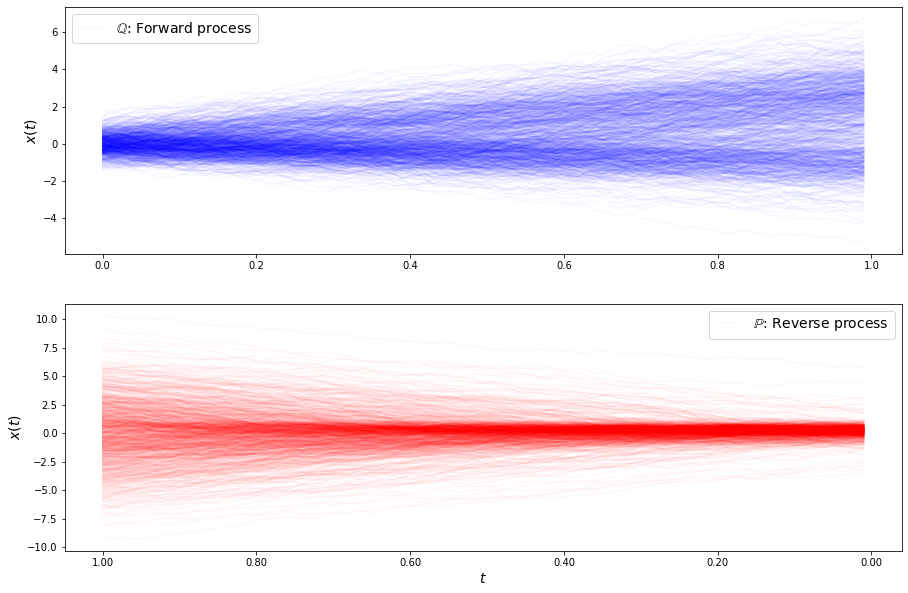

loss b 3.688848563242345
loss b 3.4322857928336252
loss b 4.066659337853507
loss b 3.7087346022132235
loss b 3.95342483669027
loss b 3.466337506869828
loss b 3.7561256232144866
loss b 3.675372210319543
loss b 3.5608185016700857
loss b 3.78538038711904
loss b 3.430315923693501
loss b 3.5900015139906376
loss b 3.2849137876024526
loss b 3.566712390149686
loss b 3.451015430004202
loss b 3.484425812390642
loss b 3.812094930241711
loss b 3.240937781416934
loss b 3.5622472259512397
loss b 3.664210505757656
loss b 3.3610056080689095
loss b 3.2330531138203815
loss b 3.245898220621924
loss b 3.5531949679788104
loss b 3.2641415914610215
loss b 3.4182090684127084
loss b 3.02919778455855
loss b 3.2017418144572423
loss b 3.135617124491749
loss b 3.5108325697931564
loss f 1.7084178327566666
loss f 1.7633994922299097
loss f 1.779382199187502
loss f 1.6518350554945986
loss f 1.70444146618429
loss f 1.6369521024233862
loss f 1.656662829526062
loss f 1.6647589927810513
loss f 1.6647040870605947
loss f 1.

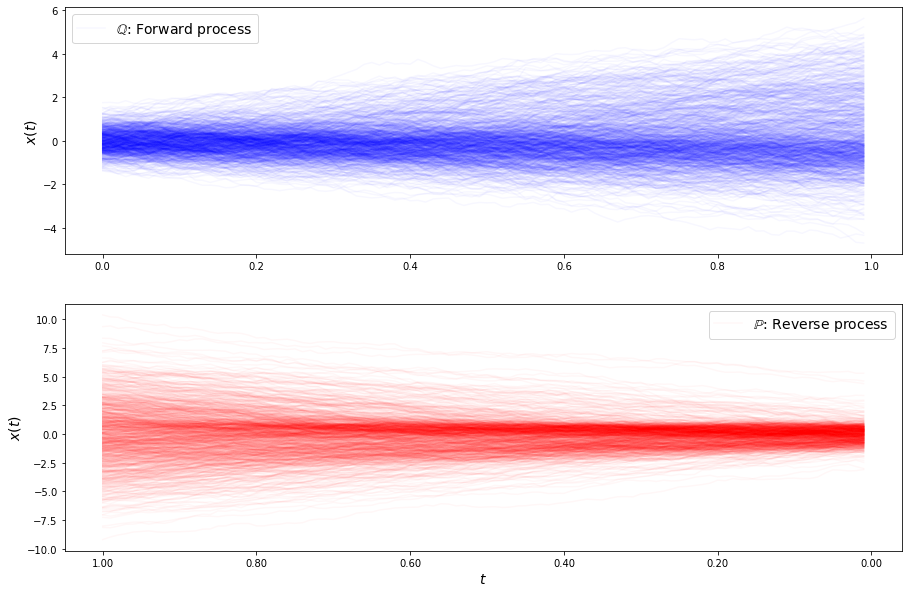

loss b 2.8623629543178994
loss b 2.734057924770036
loss b 3.1674198927321116
loss b 2.7824138160393757
loss b 3.2281482918854962
loss b 3.00158817628707
loss b 3.015795192964289
loss b 2.829493443589998
loss b 3.349024248968147
loss b 3.0532703215806714
loss b 3.253365396655362
loss b 3.1084801154912336
loss b 3.269467583562592
loss b 3.4087751665735686
loss b 3.186024786378774
loss b 3.9990509976207766
loss b 3.527015461497052
loss b 3.8159604873993955
loss b 3.765467369085742
loss b 3.4049642499115946
loss b 4.042884986942514
loss b 4.068353151857718
loss b 4.132272299816734
loss b 4.152617146267701
loss b 4.0458734355457855
loss b 3.989338457715279
loss b 3.943498660296289
loss b 4.286856401117145
loss b 4.7000256873107285
loss b 4.372664096489597
loss f 1.4947495902477475
loss f 1.5626171216001612
loss f 1.4721373503397317
loss f 1.4535512681332001
loss f 1.529561081350011
loss f 1.5920947358563298
loss f 1.4801683854132504
loss f 1.5247843437644029
loss f 1.5118793889243607
loss f

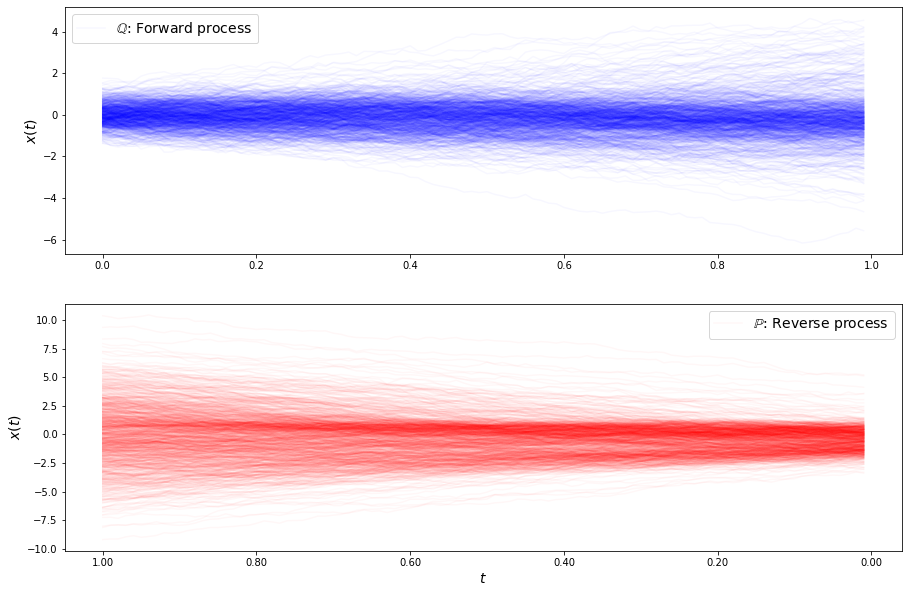

loss b 4.781090589026225
loss b 5.043037563268849
loss b 5.023197605516154
loss b 5.2882676996875615
loss b 5.239244883798444
loss b 5.435517744064504
loss b 5.337205184499419
loss b 5.629812665370667
loss b 5.493894690467237
loss b 5.680427518941256
loss b 5.549978966131755
loss b 5.532415502100053
loss b 5.236525964854161
loss b 6.055469277907979
loss b 5.719310776927258
loss b 5.753815029921652
loss b 6.207314261849676
loss b 5.854366553038645
loss b 5.551907577260855
loss b 5.989325744838874
loss b 5.428617569421239
loss b 5.632771468829408
loss b 6.068526326850319
loss b 5.907502990959642
loss b 6.175073071268932
loss b 5.502366794737584
loss b 5.8623821265850165
loss b 5.475925560872899
loss b 5.526039124139992
loss b 5.341396662885537
loss f 1.882533650080114
loss f 1.856409172868712
loss f 1.874326179581503
loss f 1.894846814253761
loss f 1.9051151386180951
loss f 1.9262029435046586
loss f 1.905479722155759
loss f 1.9153316110964063
loss f 1.894215606687271
loss f 1.87138934122

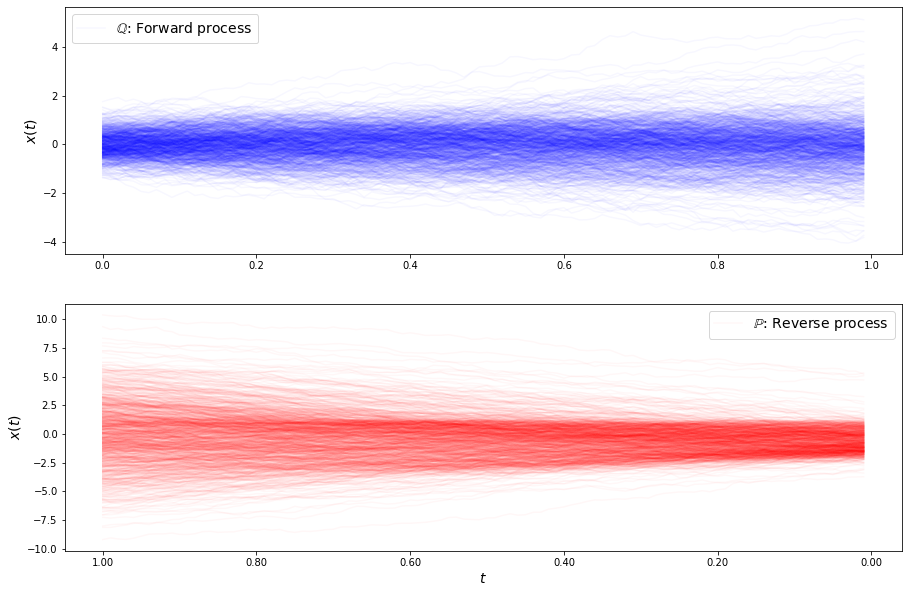

loss b 5.756686199619492
loss b 5.147706159716765
loss b 5.783554573176574
loss b 5.700598280023101
loss b 5.539416867833671
loss b 4.951002780574957
loss b 5.279629090870677
loss b 5.156137856063257
loss b 5.03009132604511
loss b 5.07631327515172
loss b 4.8014842257084975
loss b 4.523632670760573
loss b 4.7695335575321645
loss b 5.030286650812331
loss b 4.686023079374018
loss b 4.9718735340879014
loss b 4.3319531528671416
loss b 4.051950635104164
loss b 4.4048629197683296
loss b 4.218441504700227
loss b 4.316882236420656
loss b 4.440972894029363
loss b 3.881744908768365
loss b 4.521123361749486
loss b 4.128966796064775
loss b 4.264308398838519
loss b 3.835439411395464
loss b 3.5810042772745105
loss b 3.995677400798585
loss b 3.5844091892253833
loss f 1.4542168802223374
loss f 1.443235983024247
loss f 1.5057063034282825
loss f 1.4980960316123282
loss f 1.422406350722684
loss f 1.4470227954779569
loss f 1.442226637594039
loss f 1.4870266317429721
loss f 1.5094338549441493
loss f 1.51600

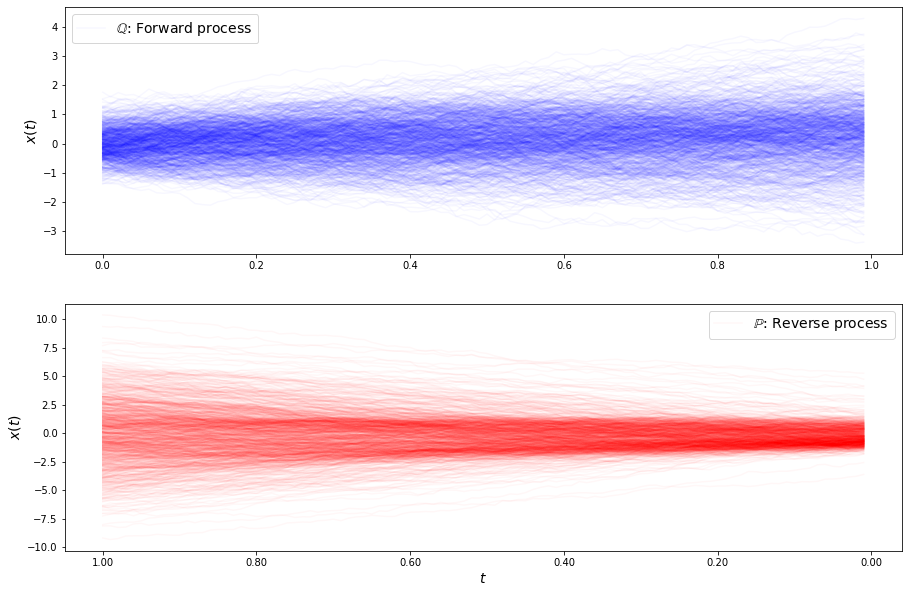

loss b 3.7696480390007667
loss b 4.114037402361941
loss b 3.7232887934053727
loss b 3.8503930953319925
loss b 3.496382051166431
loss b 3.323318123391235
loss b 3.641974750779298
loss b 3.3102095753876113
loss b 3.7839537853867253
loss b 3.265358565112
loss b 3.454375519290966
loss b 3.4024746639906587
loss b 3.327835039061409
loss b 3.988016657061792
loss b 3.7922018788374117
loss b 3.560296449325523
loss b 3.2587671539847975
loss b 3.5062742453982647
loss b 3.439911949096263
loss b 3.122072817080472
loss b 3.5139791446826014
loss b 3.3249543861923416
loss b 3.5263563491772105
loss b 3.569971617134129
loss b 3.553957366034036
loss b 3.4652792606905845
loss b 3.549951016466946
loss b 3.1031456758555858
loss b 3.3491694577981255
loss b 3.730895544670149
loss f 1.4077009249695207
loss f 1.5358901817187378
loss f 1.3970224018790338
loss f 1.5706616729017382
loss f 1.3664465977422084
loss f 1.3791666176684743
loss f 1.47498458321538
loss f 1.4645180792806438
loss f 1.3578071788967596
loss f

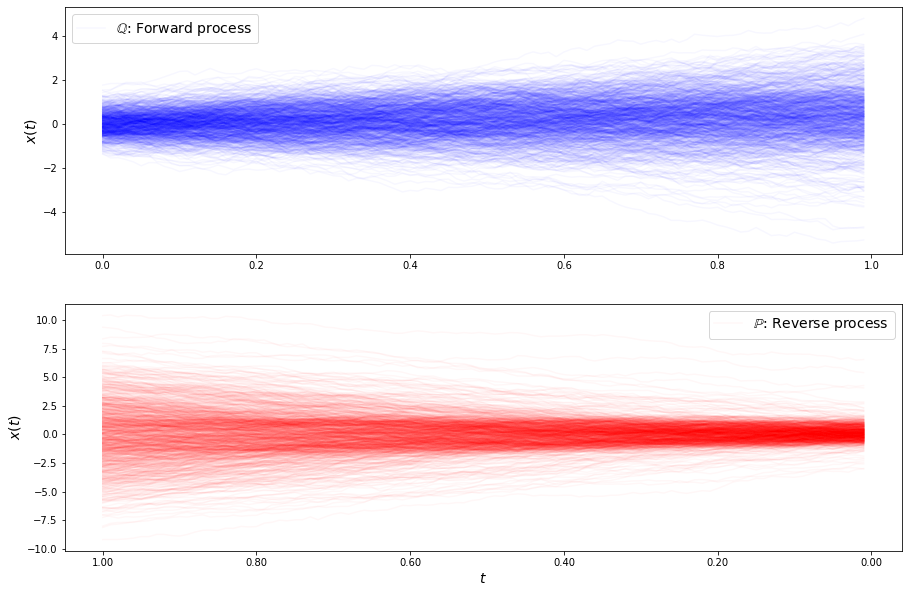

loss b 2.8254523782788765
loss b 3.0450903966887726
loss b 3.3523403131934493
loss b 2.8919780326898454
loss b 3.4903823300122085
loss b 3.306889041266192
loss b 3.1308018445960535
loss b 3.350268097521872
loss b 3.3037835099334814
loss b 3.604180240251142
loss b 3.4086296440739745
loss b 3.5744577235776767
loss b 3.1895789587342027
loss b 3.851304824843019
loss b 3.3567352271310917
loss b 3.651335519255738
loss b 3.7413868675688704
loss b 3.472560263872757
loss b 3.76629214080345
loss b 3.665188535212963
loss b 3.2578092011892767
loss b 3.387763006922117
loss b 3.8603722230992386
loss b 3.436080882058474
loss b 3.4210243949789354
loss b 3.8846217284030047
loss b 3.6939037239271992
loss b 3.6158895220757175
loss b 3.736860514517369
loss b 3.5089570664850296
loss f 2.0129541012313417
loss f 2.1104144142043664
loss f 2.0471170514128594
loss f 1.9651390870013177
loss f 1.9819269171801046
loss f 1.997258466872623
loss f 1.99540718970792
loss f 2.151268549238887
loss f 1.7528103684832679
lo

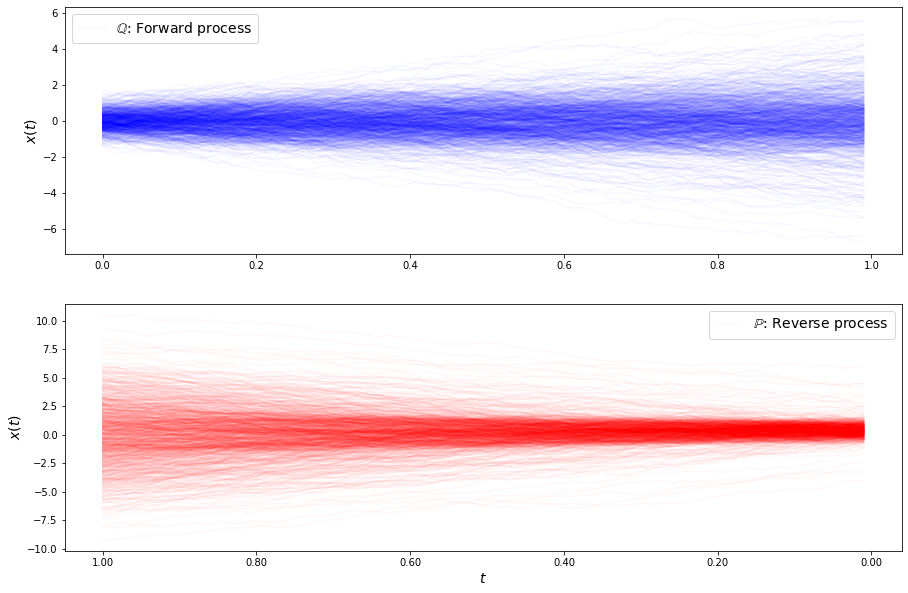

loss b 3.1870640052876245
loss b 2.857481114296083
loss b 3.0440033143097587
loss b 2.919877055382541
loss b 3.0926907298933033
loss b 3.34963674731423
loss b 3.2266580655535737
loss b 2.928743854036009
loss b 3.416612418613623
loss b 3.238312608077586
loss b 3.3851345080787967
loss b 3.2482227477604497
loss b 3.108752249199225
loss b 3.3060415167415593
loss b 3.35050219834452
loss b 3.0582554741266215
loss b 3.483379651992999
loss b 3.412173229314403
loss b 3.660753873754589
loss b 3.340108827857162
loss b 3.5286984772966097
loss b 3.6128004963771776
loss b 3.5799765380801287
loss b 3.223163979228042
loss b 3.425964390888713
loss b 3.461164695133631
loss b 3.675574949519934
loss b 3.382860346904171
loss b 3.982978890901779
loss b 3.619396416905165
loss f 2.5340521596904675
loss f 2.6072334042654814
loss f 2.8097463215153704
loss f 2.554733645301627
loss f 2.560453687431055
loss f 2.655065535756914
loss f 2.6072986353931698
loss f 2.4717548627759185
loss f 2.5273783493908297
loss f 2.4

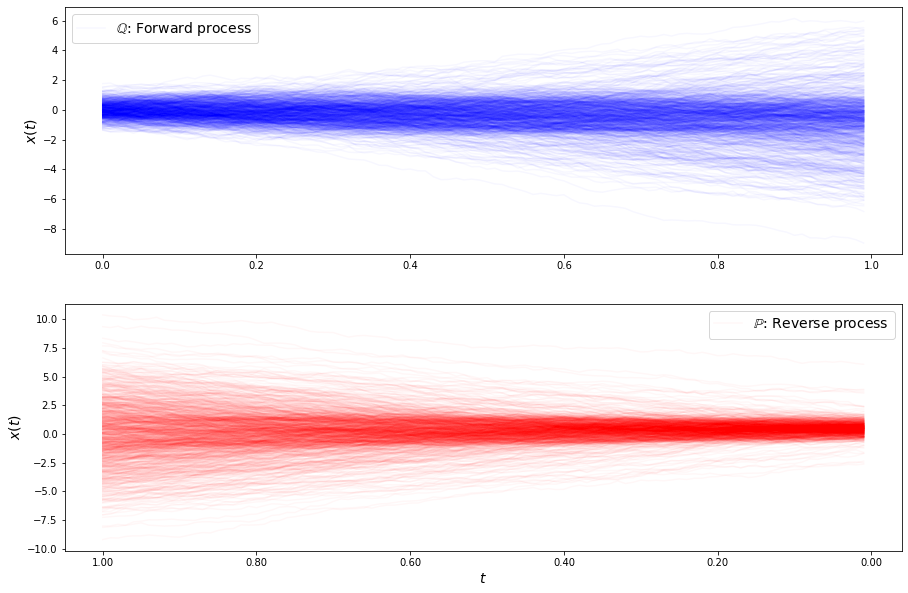

loss b 3.246984630544807
loss b 3.422097523009908
loss b 3.078068920756594
loss b 3.093319926716049
loss b 3.006312061013799
loss b 2.7273709703484728
loss b 2.7503193808824786
loss b 3.053336783798044
loss b 2.9349199630541865
loss b 3.2637036790831515
loss b 2.678867090460957
loss b 3.109381467146647
loss b 2.9396325615133527
loss b 2.936391512960501
loss b 2.7043576310479747
loss b 3.3007348096505607
loss b 2.975727231917849
loss b 3.0835946382329142
loss b 3.143069770025942
loss b 2.8519454094907295
loss b 2.7082530907970717
loss b 3.197953467320172
loss b 2.83748603249661
loss b 2.6668859141860928
loss b 2.8580695163841856
loss b 2.6974235142302
loss b 2.931490911644894
loss b 2.848698429731215
loss b 3.1801278532370363
loss b 2.8984961734749586
loss f 2.4972441924623694
loss f 2.6033210079185554
loss f 2.39288354772302
loss f 2.5171203661644688
loss f 2.241875468213648
loss f 2.5750316704544343
loss f 2.5049045369914418
loss f 2.35123159901783
loss f 2.383335089266748
loss f 2.48

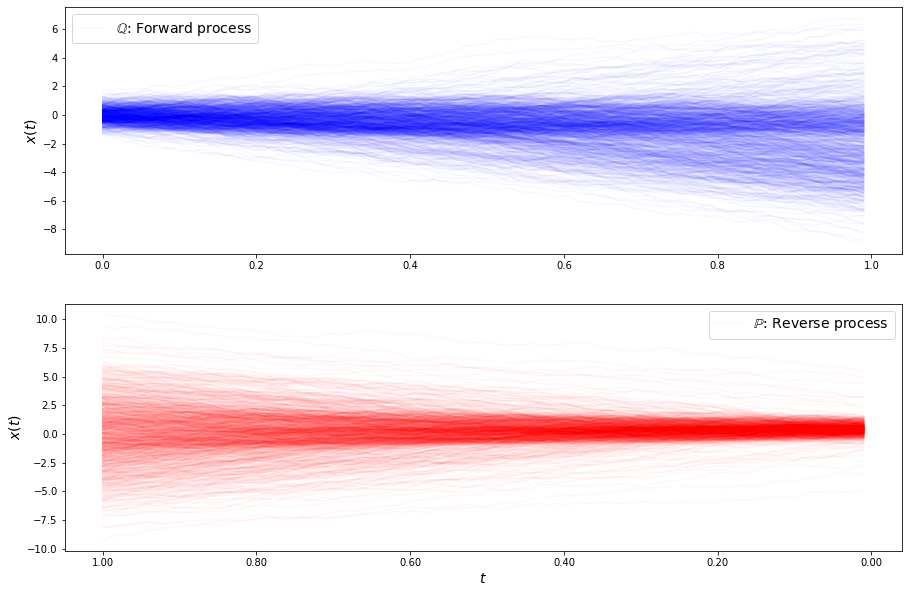

loss b 2.9475735882117364
loss b 2.371689925836765
loss b 2.571460126655682
loss b 2.7984389086211525
loss b 2.707013482748431
loss b 2.8657493459064334
loss b 2.912488064978922
loss b 2.377575693819085
loss b 2.5452389089706844
loss b 2.9509684602803925
loss b 2.960735787158301
loss b 3.2323107954428547
loss b 2.849289728151106
loss b 3.0246704253308216
loss b 2.7769190886969755
loss b 3.0056991268508044
loss b 3.0214484576204748
loss b 2.655929784465313
loss b 3.5654287480620783
loss b 2.3533774904179756
loss b 2.6979243069347807
loss b 2.4819932172887085
loss b 2.533961433927773
loss b 2.7421181536726973
loss b 2.892588778325752
loss b 2.8024831933444476
loss b 2.903640776334561
loss b 2.49784002101854
loss b 2.8188047573840875
loss b 2.5102745990577326
loss f 2.0590944422071975
loss f 1.981484602697568
loss f 1.8491687749818404
loss f 1.873469425257669
loss f 1.9355862065614904
loss f 1.9357193128014132
loss f 1.9304368104168372
loss f 1.960492722075855
loss f 2.094373145980745
los

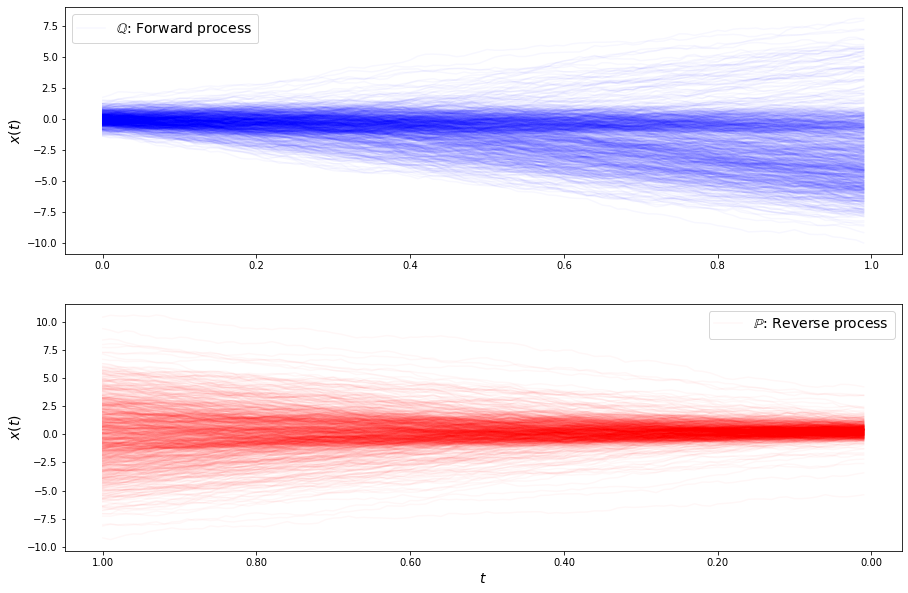

loss b 3.357449505975225
loss b 3.046668240052764
loss b 3.050595193630103
loss b 2.9754370254488243
loss b 2.57173243839779
loss b 2.5985521236536258
loss b 2.848737553729392
loss b 3.068399659818786
loss b 2.554983012130632
loss b 3.0206947189667446
loss b 3.253261593597129
loss b 3.220820468319844
loss b 2.674751700689266
loss b 2.9275757022342583
loss b 2.989165753376745
loss b 2.9739040085221227
loss b 2.6458480663117316
loss b 3.1813475553711927
loss b 2.8771437016659727
loss b 3.2847948614899534
loss b 2.8031631773543078
loss b 2.690588722229858
loss b 2.86701269747225
loss b 2.7234332569266866
loss b 2.778258590890068
loss b 2.7325279609777997
loss b 2.9682460985762806
loss b 2.656837598982989
loss b 2.6745044757472503
loss b 3.072191947049583
loss f 2.1942594469498813
loss f 2.3280433329848207
loss f 2.1651391705725094
loss f 2.3366160078268456
loss f 2.36561288626992
loss f 2.276899103625146
loss f 2.458336795038265
loss f 2.409805756542154
loss f 2.2668534928093393
loss f 2.

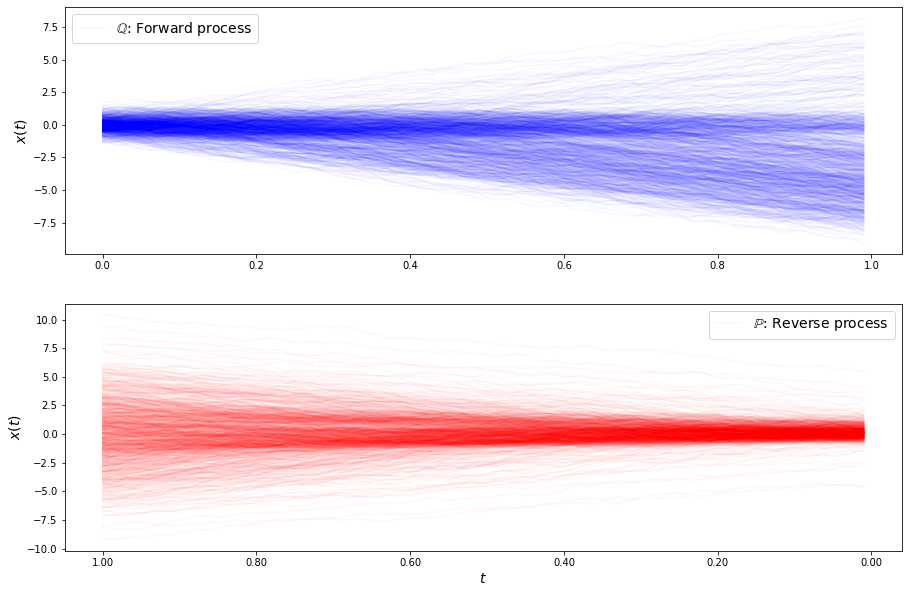

loss b 3.1249156262647317
loss b 3.301415996985973
loss b 3.1403331411396755
loss b 3.059007633503129
loss b 2.7942764058768566
loss b 2.8050734481646016
loss b 3.0849910741225353
loss b 2.9627721838530854
loss b 3.1830398186842164
loss b 3.054603128208551
loss b 2.9440561687887876
loss b 3.0773882029473905
loss b 2.8278320453909673
loss b 3.2506132020457654
loss b 3.011518601229152
loss b 3.1428935817548456
loss b 3.5911285535351802
loss b 3.167080011639028
loss b 3.4617582721653815
loss b 2.8907133870606234
loss b 3.1755756106549575
loss b 2.9839260665631406
loss b 3.152307388104304
loss b 3.612860807528384
loss b 3.7515162650933407
loss b 3.1862845156185164
loss b 3.380833085322395
loss b 3.2001087338865624
loss b 2.966642713771773
loss b 3.169948071625053
loss f 2.6702726966836074
loss f 2.7033854964746933
loss f 2.538596176678326
loss f 2.5521890845209265
loss f 2.5722408055288475
loss f 2.547308054515674
loss f 2.5995333980303066
loss f 2.7383805546358815
loss f 2.586382625183578

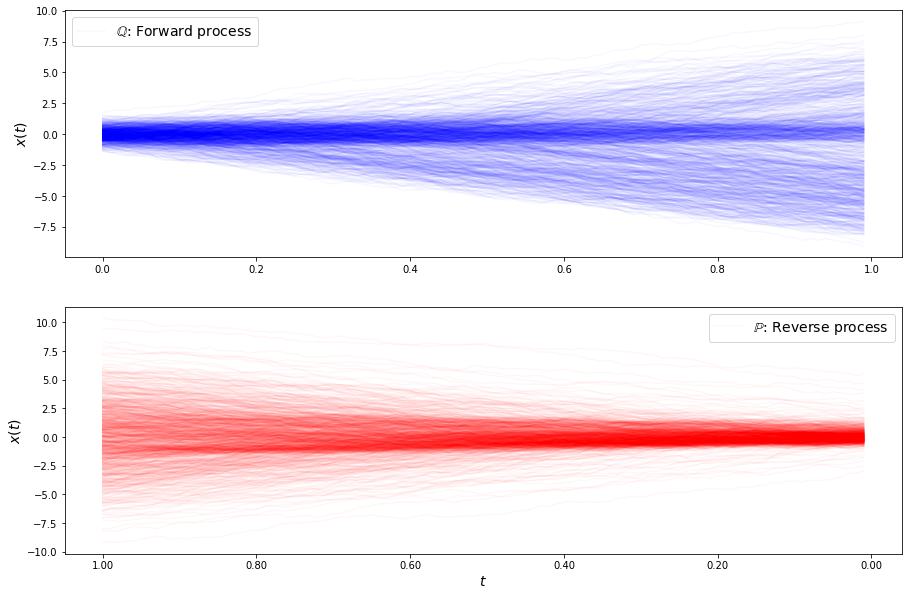

loss b 2.9039337399018414
loss b 2.8910516837027234
loss b 2.709151615048322
loss b 3.3692350550395553
loss b 3.1475416219280996
loss b 3.123048270676629
loss b 2.9298155843945075
loss b 3.2198759962878056
loss b 3.0929988961721646
loss b 2.9552874686457455
loss b 3.2617582577266346
loss b 3.0810587609172297
loss b 3.079044390418554
loss b 2.933516746132859
loss b 3.023929119007935
loss b 3.019204246111895
loss b 3.194619788173098
loss b 2.941175827241448
loss b 3.156231132967097
loss b 3.053022705821217
loss b 2.936733975645103
loss b 2.9431755369196084
loss b 3.2024480455466247
loss b 3.175886486166577
loss b 3.072187112736829
loss b 2.674567629691028
loss b 3.131072481692383
loss b 2.9353476363499458
loss b 2.6587136099601385
loss b 3.125114697620273
loss f 2.1740439564496556
loss f 2.1831483641599765
loss f 2.2731853815132785
loss f 2.162867848186961
loss f 1.9760559964316566
loss f 2.1757278103721545
loss f 1.99147007841503
loss f 1.989825388494721
loss f 1.99777203646266
loss f 2

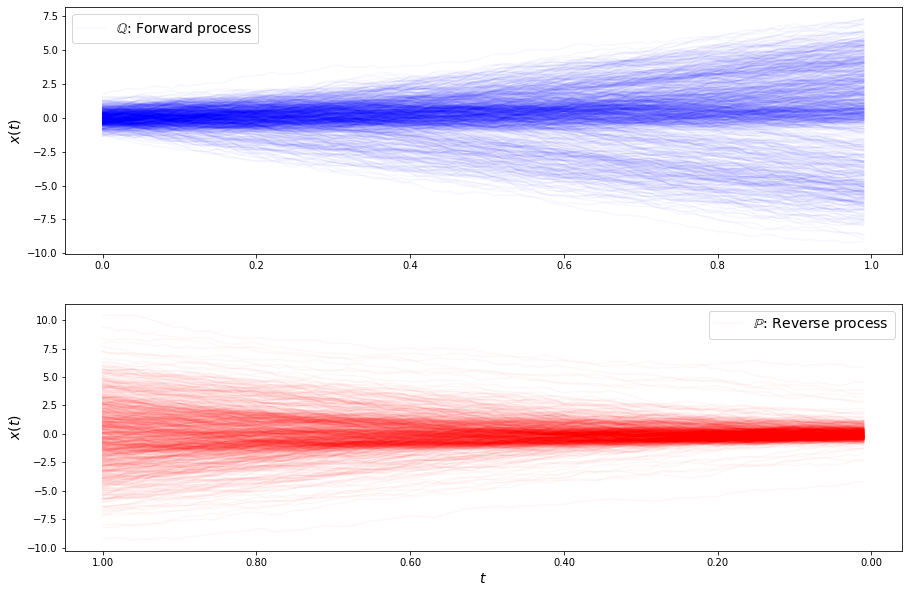

loss b 2.780598861945863
loss b 2.691673437862129
loss b 2.7679860775374676
loss b 2.7008299134543723
loss b 2.5713614139019563
loss b 2.501463769476322
loss b 2.609216507915795
loss b 2.4432673988080564
loss b 2.768901780845799
loss b 2.7888347932011794
loss b 2.468373934906882
loss b 2.745660632897298
loss b 2.554310043460123
loss b 2.597359402692068
loss b 2.200529836220824
loss b 2.523392416283436
loss b 2.3961602911573827
loss b 2.401421462858901
loss b 2.5660568454869006
loss b 2.454419464252755
loss b 2.609766890044844
loss b 2.304472449030445
loss b 2.2705757155335853
loss b 2.4802929211756237
loss b 2.654457175783234
loss b 2.5489870595937565
loss b 2.5554174423575673
loss b 2.2470112518575602
loss b 2.379376110295209
loss b 2.1694939152306736
loss f 1.8106501614628445
loss f 1.8445316547070651
loss f 1.6965499366240642
loss f 1.6324751284171606
loss f 1.7552521050675045
loss f 1.7276838319447092
loss f 1.5666671431335322
loss f 1.600917222796742
loss f 1.7012239366641566
loss

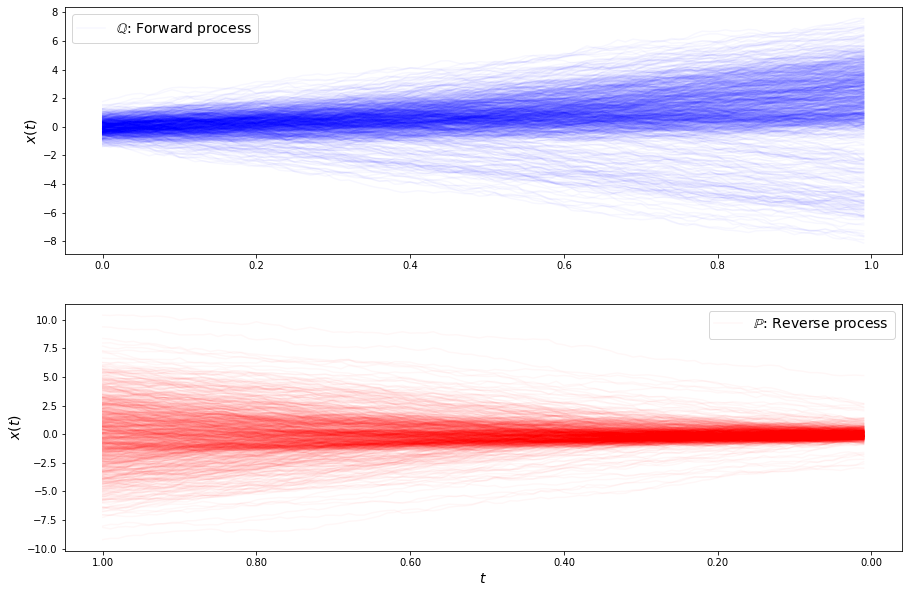

loss b 2.410229681754648
loss b 2.5792507550973065
loss b 2.518773601833369
loss b 2.463547420677096
loss b 2.5115550491757497
loss b 2.3131576890184604
loss b 2.2463925353928715
loss b 2.763393246270524
loss b 2.5088488709185626
loss b 2.737508415381658
loss b 2.4976588503305104
loss b 2.4631509494428183
loss b 2.7005041631875604
loss b 2.4623076905561825
loss b 2.3096935825301195
loss b 2.346867928463433
loss b 2.2481788554588964
loss b 2.352322723941519
loss b 2.398501676604817
loss b 2.4017101969155394
loss b 2.882908882393476
loss b 2.6599364673988144
loss b 2.336347401342869
loss b 2.6997748697870954
loss b 2.242960927278212
loss b 2.5164698668533956
loss b 2.358147486125282
loss b 2.7087449110856276
loss b 2.587691191384182
loss b 2.5847118393673334
loss f 1.8524415246402393
loss f 1.9657628841360781
loss f 1.8879667858298186
loss f 1.9656423258470215
loss f 1.8059919545062109
loss f 1.959791454070263
loss f 1.9333796525668527
loss f 1.9730268357658587
loss f 1.9294569008394495


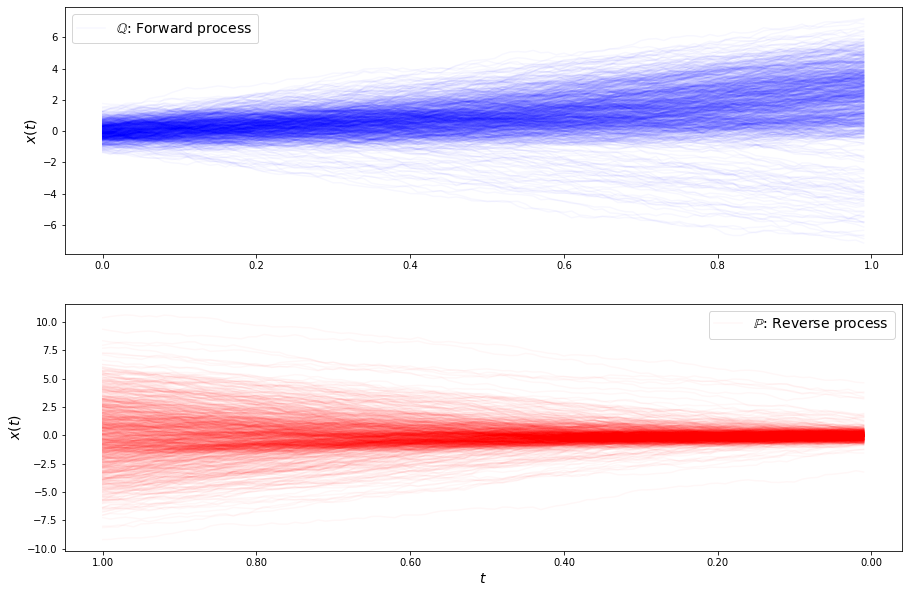

loss b 2.883610766676371
loss b 2.9456115231867948
loss b 2.5597249851221737
loss b 3.1754784492951806
loss b 2.7994782730049192
loss b 2.943332684396634
loss b 2.7654731152069347
loss b 2.818848853438075
loss b 2.6574229707152273
loss b 2.8607286215061833
loss b 3.0987175862799345
loss b 2.677713891911553
loss b 2.618625570536826
loss b 2.6634204791350684
loss b 3.196176110092709
loss b 2.861491473938274
loss b 2.76530387089184
loss b 2.8617305322567548
loss b 2.7305457060187903
loss b 3.440874315317554
loss b 2.907019476902975
loss b 2.7704028895815123
loss b 3.0069950305549784
loss b 2.763922646237937
loss b 2.759409548566706
loss b 2.782959407730194
loss b 2.837772156415859
loss b 2.8766423941936785
loss b 2.7131206006340878
loss b 2.812487959164358
loss f 2.2506207583594806
loss f 2.475405481046533
loss f 2.3511818818533157
loss f 2.365069546027357
loss f 2.425495491109917
loss f 2.3631165745623375
loss f 2.396391112302405
loss f 2.3357616985084833
loss f 2.2740071664771313
loss f

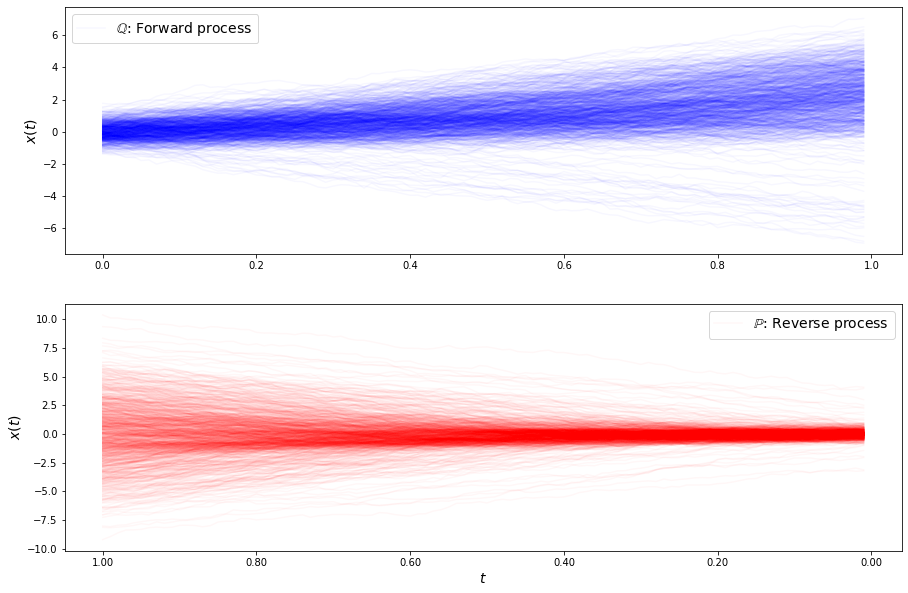

loss b 3.165419084738744
loss b 3.3628224409288294
loss b 3.3200627985919566
loss b 3.181251041829633
loss b 3.073229144228849
loss b 3.024213988733755
loss b 3.2136897564876943
loss b 3.084350645150446
loss b 3.157929610693793
loss b 3.1089700041092527
loss b 3.0309530478965345
loss b 3.276907349440666
loss b 3.1035484431726608
loss b 2.9311991276514653
loss b 2.9325690587858197
loss b 3.3791011518826326
loss b 3.277239918079258
loss b 3.2480244437502352
loss b 3.114800758656648
loss b 3.3071228062255327
loss b 3.3646299382219067
loss b 3.2660228861210205
loss b 3.039251267458931
loss b 3.1417252526817356
loss b 3.238130795491438
loss b 3.6010970765900066
loss b 3.0304576214819923
loss b 3.101445168388256
loss b 3.330164348251794
loss b 3.196227049301235
loss f 2.7678212108914555
loss f 2.519085338119756
loss f 2.5819506728026966
loss f 2.5157953507999236
loss f 2.4738811297381234
loss f 2.630046506451849
loss f 2.5123461122866573
loss f 2.3973222322233636
loss f 2.713251852440429
los

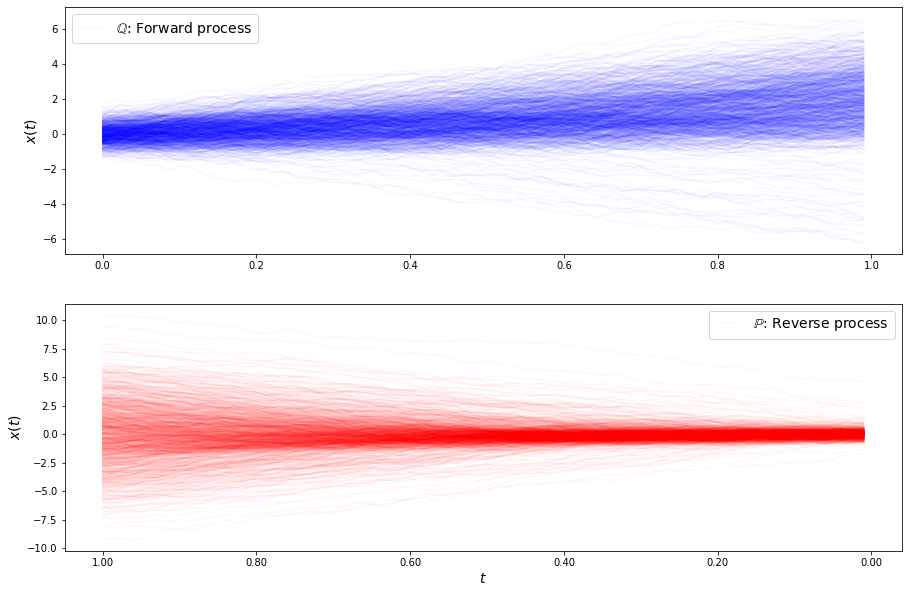

loss b 3.27592873173869
loss b 3.3637404755701477
loss b 3.1291835463112405
loss b 3.1257377341992054
loss b 3.321396265966191
loss b 3.159773074721291
loss b 3.215318692433259
loss b 3.144154691498338
loss b 3.1229010158056445
loss b 3.5123563878839477
loss b 3.241269921154466
loss b 3.010741194605319
loss b 2.9674094278961314
loss b 3.1448117779201286
loss b 3.228912679445702
loss b 2.8525232776735683
loss b 2.9802988153106647
loss b 2.9484991474640805
loss b 2.9630692450786134
loss b 3.0515645607199215
loss b 2.9410336225998672
loss b 3.0666627288774553
loss b 3.0622225924865503
loss b 3.081682365697097
loss b 3.079249603135069
loss b 3.0550467632120153
loss b 3.0015263690501923
loss b 3.1144824455981364
loss b 2.9952872015915815
loss b 3.1690389617533787
loss f 2.495643716594221
loss f 2.5114260358847504
loss f 2.485360387109542
loss f 2.5881048540648597
loss f 2.7526484603763173
loss f 2.5375641542376877
loss f 2.560620761303711
loss f 2.347301196933423
loss f 2.4783458396563414
l

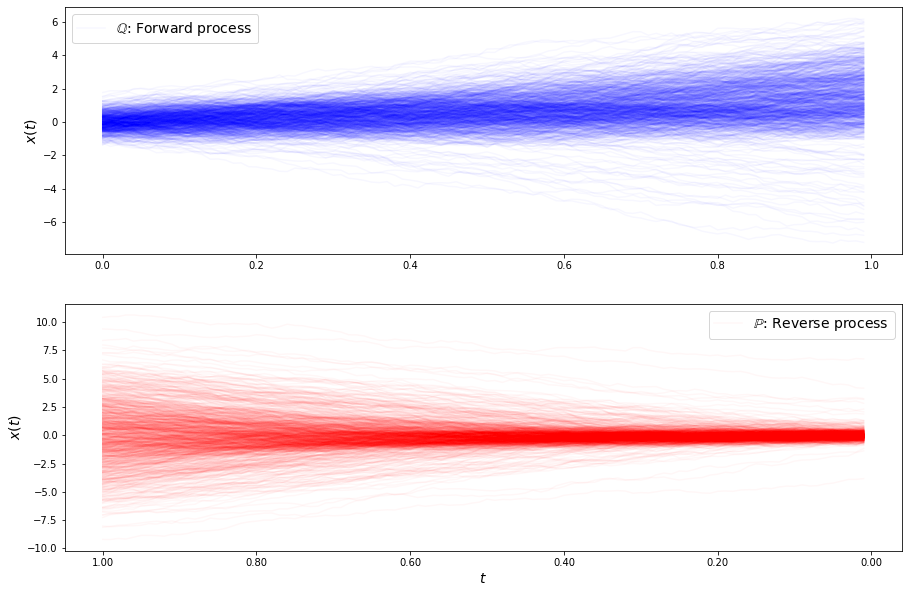

loss b 2.931441238773305
loss b 2.7629054336574117
loss b 2.6804686251676992
loss b 2.843941113013074
loss b 2.7493609941757775
loss b 2.7558715679945975
loss b 2.768576664708839
loss b 2.7249715090150217
loss b 2.965462109142207
loss b 2.6312318177817855
loss b 2.7747627746002563
loss b 2.839302488966871
loss b 3.2472955567336563
loss b 2.8621454029915663
loss b 2.7632270561462104
loss b 2.745781354693756
loss b 2.8428256818397943
loss b 3.013310684226729
loss b 2.832570326027646
loss b 2.794331748787646
loss b 2.7831066242482527
loss b 2.83065898962514
loss b 2.833775227838472
loss b 2.6959757056777227
loss b 2.693498069777175
loss b 2.6030949104814862
loss b 3.1110871340482276
loss b 2.6593689600965806
loss b 2.9025403016160887
loss b 2.645834206763803
loss f 2.4038254535581443
loss f 2.3994748877336436
loss f 2.3728677165001866
loss f 2.3924678774062484
loss f 2.305927074004312
loss f 2.182139701507137
loss f 2.313627078417541
loss f 2.3251267242959366
loss f 2.3849089258234866
los

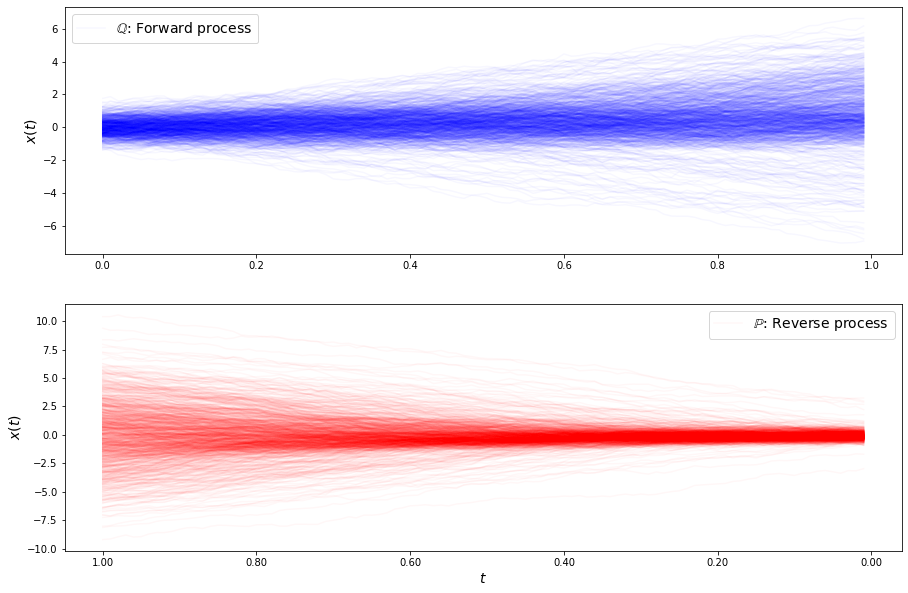

loss b 2.5224944806125933
loss b 2.47890199252254
loss b 2.4017820115279145
loss b 2.3347103003931666
loss b 2.4399207441056734
loss b 2.564895968643365
loss b 2.680380688611383
loss b 2.347400346637782
loss b 2.428441280690324
loss b 2.376227413809119
loss b 2.3345990117678608
loss b 2.6275250465172766
loss b 2.5136245808972513
loss b 2.4421858867797
loss b 2.469097633037825
loss b 2.164261311513224
loss b 2.4292527056894033
loss b 2.4556180382209556
loss b 2.1785284912010003
loss b 2.3470635073245187
loss b 2.639063767186901
loss b 2.4467561099725668
loss b 2.2195465279522955
loss b 2.55837319648039
loss b 2.271266254185206
loss b 2.4012260903507614
loss b 2.235887054221519
loss b 2.239220189811896
loss b 2.2754395780302854
loss b 2.2180103464641068
loss f 2.022763178187736
loss f 1.8120109447531147
loss f 1.9531168907055783
loss f 1.9909590750279977
loss f 1.8100913100256353
loss f 1.8864473296714337
loss f 2.1036080823391483
loss f 1.9121507603819534
loss f 1.9691159325000447
loss 

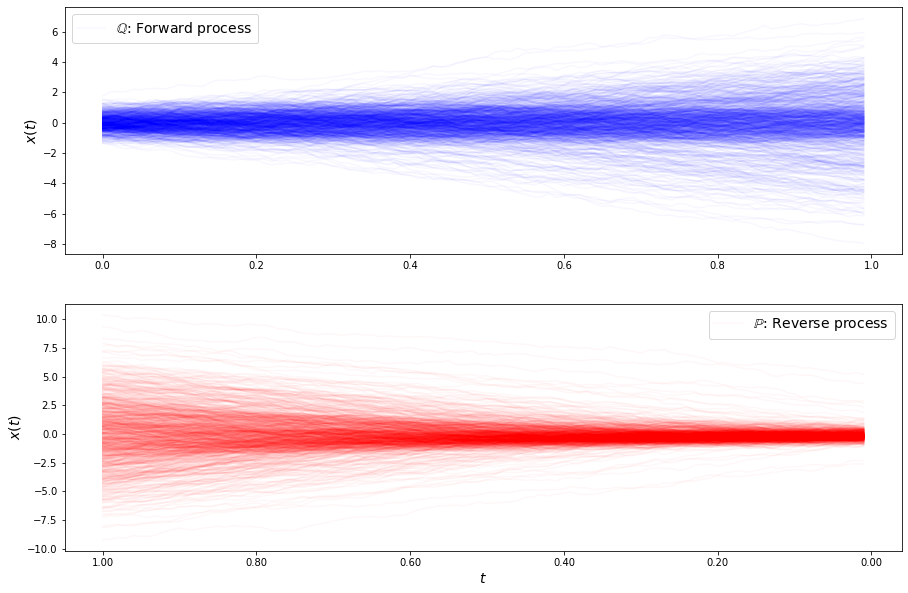

loss b 2.3760909838516238
loss b 2.2242777941118947
loss b 2.230211559238151
loss b 2.3922351910939006
loss b 2.420042654313818
loss b 2.00119364676659
loss b 2.2493209988707665
loss b 2.063902217850732
loss b 2.2416825928330555
loss b 2.3227295084114403
loss b 2.3493436656656668
loss b 2.216054607193902
loss b 2.237778739133809
loss b 2.208611893200597
loss b 2.157616375135942
loss b 2.089938776026188
loss b 2.122790483329255
loss b 2.1328453993752867
loss b 2.244892376726396
loss b 1.9281635204420824
loss b 2.1533748597608606
loss b 2.24110892352897
loss b 2.0698520316219953
loss b 2.3806702627241916
loss b 2.0446909365905293
loss b 2.4012138957529325
loss b 2.33829310995507
loss b 2.2952019145913223
loss b 2.149996363367346
loss b 1.9607591731034708
loss f 1.8883359315383215
loss f 1.756438988503393
loss f 1.6811063180714307
loss f 1.6399048636721492
loss f 1.6052726048417452
loss f 1.6355225666504094
loss f 1.6255780875169916
loss f 1.7680037979848418
loss f 1.7581296054940536
loss

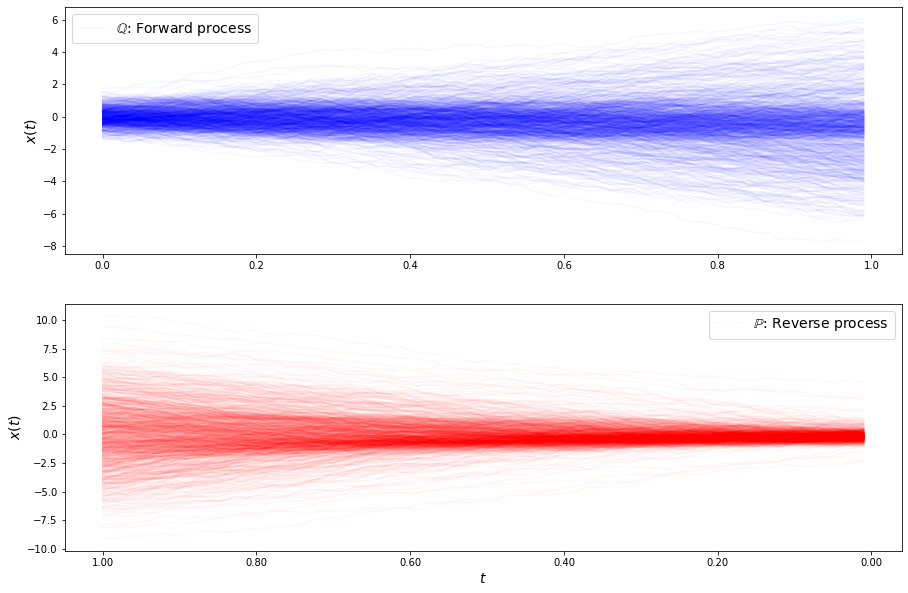

loss b 2.3213793128961293
loss b 2.040976105964199
loss b 2.138355401157262
loss b 2.1862219985295326
loss b 2.2584601993510915
loss b 2.3000660242277986
loss b 2.1337475725058215
loss b 2.294702348476775
loss b 2.409136053343871
loss b 2.1191611914909445
loss b 2.238728089998295
loss b 2.096323105980917
loss b 2.090386461930498
loss b 2.556427011109964
loss b 2.105885579026748
loss b 2.4040363515559866
loss b 1.9675816231679246
loss b 2.0724387801702027
loss b 2.2769436464477164
loss b 2.0135470064709406
loss b 1.9679151291608867
loss b 2.0881302061978455
loss b 2.1402689409810667
loss b 2.0126011079981443
loss b 2.1707732240130557
loss b 2.223109344052676
loss b 2.2207369594290336
loss b 2.0991711800649075
loss b 2.2618707996391287
loss b 2.5176355068749072
loss f 1.6288124383190765
loss f 1.8182991379583933
loss f 1.8329675501633897
loss f 1.6950216149775834
loss f 1.6167778152503525
loss f 1.6092612018987464
loss f 1.859633466050687
loss f 1.7908284332888615
loss f 1.73514062393428

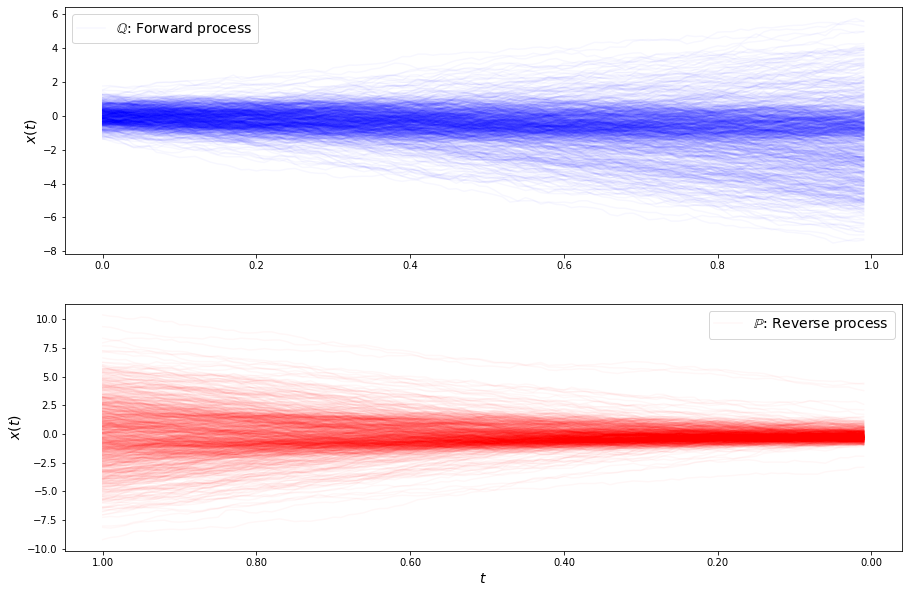

loss b 2.408111921023575
loss b 2.3368875899727195
loss b 2.2895087092736093
loss b 2.2637191418857987
loss b 2.316603413432406
loss b 2.1049966520409487
loss b 2.602680718439185
loss b 2.0826998697758428
loss b 2.286834812288056
loss b 2.529571899060994
loss b 2.190604644454384
loss b 2.1975960008446216
loss b 2.11221353395222
loss b 2.252127899809626
loss b 2.102935272931628
loss b 2.211649867143578
loss b 2.234673408447922
loss b 2.0996590515778557
loss b 2.397076424393861
loss b 2.370778158510779
loss b 2.104770968281607
loss b 2.2929628151818244
loss b 2.2082840117163474
loss b 2.607929782387715
loss b 2.349482086695251
loss b 2.2563129927613157
loss b 2.1141417886005254
loss b 2.088138320180487
loss b 2.347267000166273
loss b 2.3493250640200647
loss f 1.7296247553314676
loss f 1.7026494147724187
loss f 1.8275056784943269
loss f 1.7875662709304347
loss f 1.8396066588560755
loss f 1.8238216500583406
loss f 1.78175704387621
loss f 1.7040694518726793
loss f 2.025029324318648
loss f 1

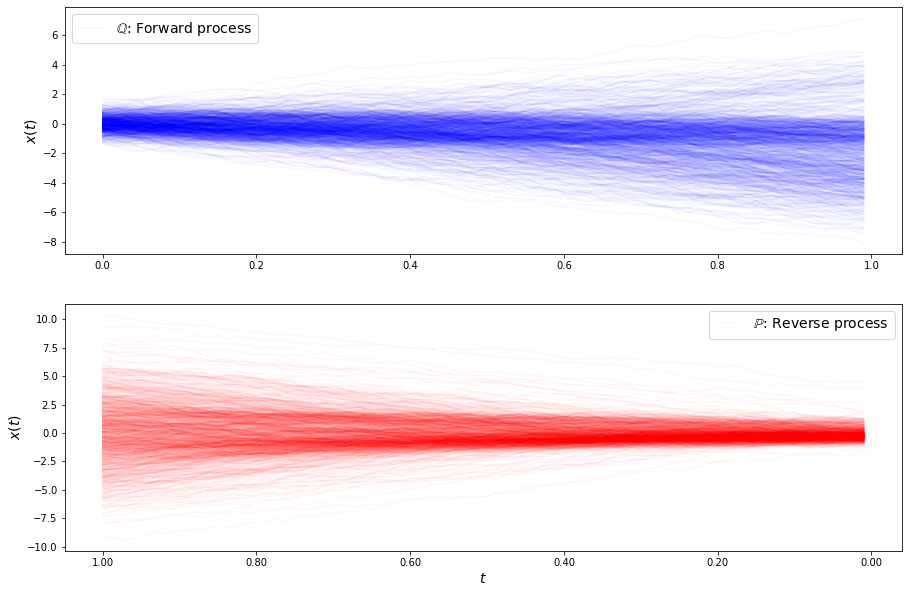

loss b 2.2826030935763963
loss b 2.310479660269547
loss b 2.248298850161279
loss b 2.326881091240222
loss b 2.329028107750907
loss b 2.3316573520164816
loss b 2.2236587045214264
loss b 2.2089394160483207
loss b 2.339258924612791
loss b 2.367922059676183
loss b 2.2977915818570294
loss b 2.3647438296309304
loss b 2.311134161811762
loss b 2.49414885176054
loss b 2.1452368223892684
loss b 2.367705729607923
loss b 2.175527887148224
loss b 2.21531215654247
loss b 2.3268115861072687
loss b 2.5436823527111043
loss b 2.1422572620883837
loss b 2.4520769931096287
loss b 2.304529658908299
loss b 2.1445918015117846
loss b 2.274377913697714
loss b 2.107315781706202
loss b 2.341896212079478
loss b 2.434657586147703
loss b 1.9557882813491434
loss b 2.2748067095897526
loss f 1.9059046524809762
loss f 1.8359711275988058
loss f 1.7942083282029406
loss f 1.731517161005063
loss f 1.9116744008540967
loss f 1.8056109703839196
loss f 1.683531848001473
loss f 1.7337981479266062
loss f 1.6904683823424358
loss f

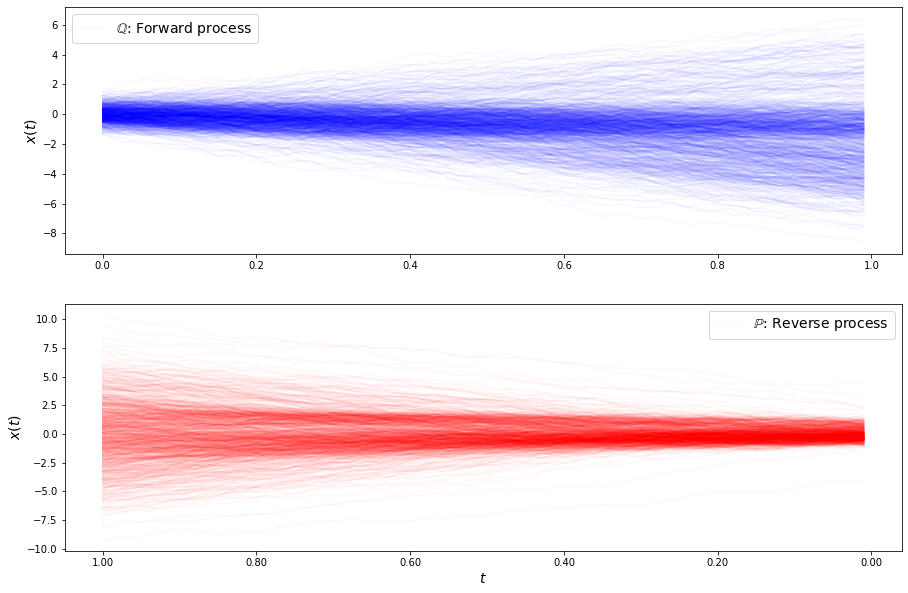

loss b 2.2726410554280703
loss b 2.006177311782691
loss b 2.212696523338849
loss b 2.1996306681338025
loss b 2.261282260179181
loss b 1.9795381298317611
loss b 2.0250032357069765
loss b 2.672722088339737
loss b 2.180580629238929
loss b 2.031433976452519
loss b 2.4194619345060735
loss b 2.4117468683617935
loss b 2.269379281534571
loss b 2.3214534798767774
loss b 2.1894489453972046
loss b 2.369216620762464
loss b 2.1972010951894023
loss b 2.2195527393869843
loss b 2.234405192886683
loss b 2.3942727371986097
loss b 1.9967352063326815
loss b 2.21744410805806
loss b 2.495044519473459
loss b 2.2512205856113003
loss b 2.5101939703442655
loss b 2.1007551483816016
loss b 2.2327922255476613
loss b 2.200101356207087
loss b 2.1979308182619484
loss b 2.4082182107596544
loss f 1.6879007340367593
loss f 1.7014677092964667
loss f 1.5958815803591275
loss f 1.6889737976818788
loss f 1.6802663434899225
loss f 1.6858375642319223
loss f 1.6209446375495409
loss f 1.6662855868280493
loss f 1.5132700172299711

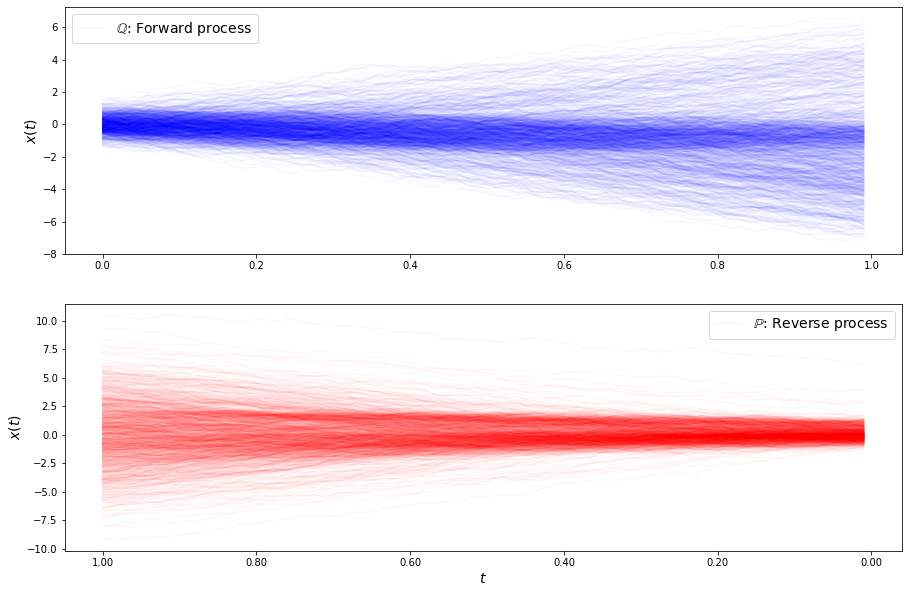

loss b 2.306594770648332
loss b 2.1638148500853465
loss b 2.371686996983052
loss b 2.5269816664173876
loss b 2.1289701257231584
loss b 2.3272531663792346
loss b 2.2856455091879435
loss b 2.3605101411321914
loss b 2.3446091317604654
loss b 1.9572943110196337
loss b 2.426858445769192
loss b 2.2193793845810217
loss b 2.1225989019649028
loss b 2.282034763824464
loss b 2.128591014081428
loss b 2.381933459170199
loss b 1.9778427731562547
loss b 2.3721463102801286
loss b 2.202285514672549
loss b 2.0962186639633833
loss b 2.073604589012059
loss b 2.445416972470694
loss b 2.1816383751840434
loss b 2.2642295511974164
loss b 2.6002082621765625
loss b 2.1588770763752425
loss b 2.160298411838891
loss b 2.3335504142372514
loss b 2.3089180980752335
loss b 2.445369039406741
loss f 1.4802989186324502
loss f 1.5491103897883167
loss f 1.453763030720771
loss f 1.6174509489020974
loss f 1.5184942185563353
loss f 1.4858082932736656
loss f 1.5713431848174992
loss f 1.5257186695153313
loss f 1.550794839182548

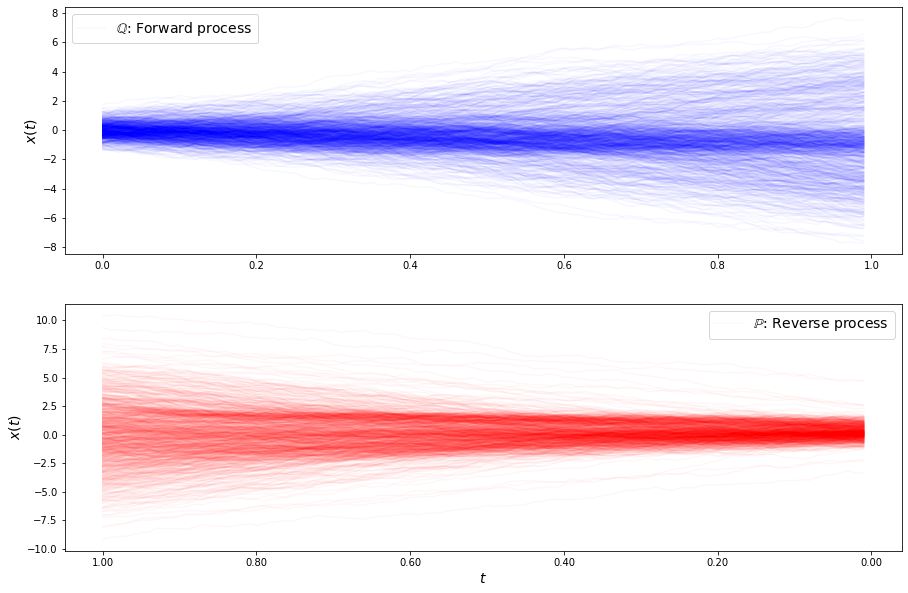

loss b 2.2959892610148973
loss b 2.322816638387393
loss b 2.3157167316369534
loss b 2.8035730534280505
loss b 2.5484661144949485
loss b 2.45047999704646
loss b 2.48498471735979
loss b 2.314386339535483
loss b 2.2855200729953493
loss b 2.536008602611247
loss b 2.3212422579990957
loss b 2.2875031703829634
loss b 2.446057883973833
loss b 2.6519867558397627
loss b 2.3985382746086232
loss b 2.508933215918807
loss b 2.289367655285918
loss b 2.683740459088838
loss b 2.6887401012080754
loss b 2.8310383559534515
loss b 2.732302167966029
loss b 2.472949537540016
loss b 2.7347195487462765
loss b 2.604323149440636
loss b 2.6160627745906604
loss b 2.597470280696472
loss b 2.4925553456438077
loss b 2.6417828605309923
loss b 2.3323454251606384
loss b 2.6028660976023907
loss f 1.6714109632109795
loss f 1.6203307787851398
loss f 1.6508032783378757
loss f 1.6602658174806446
loss f 1.7459363533839087
loss f 1.6313391131531554
loss f 1.605863964514139
loss f 1.6531347930732347
loss f 1.7578584421414838
lo

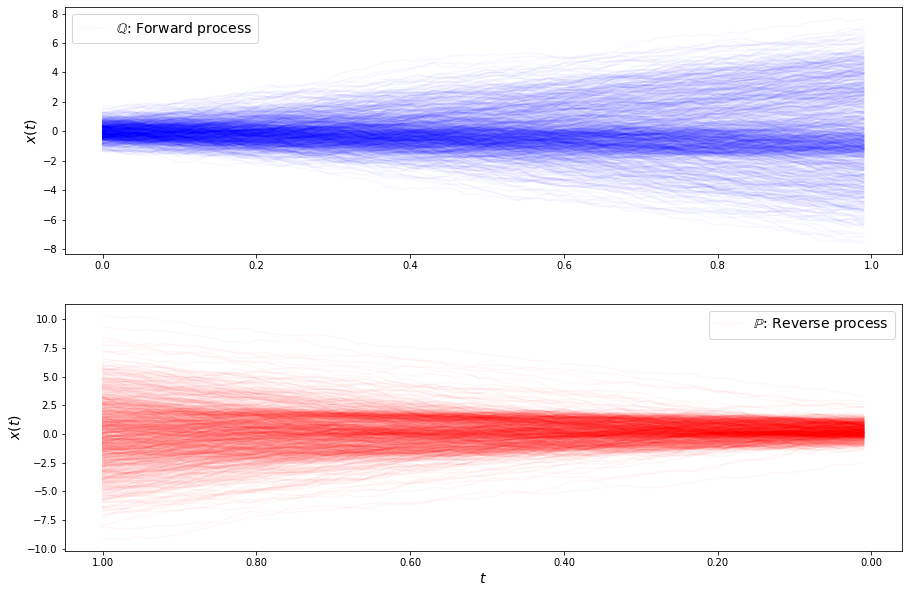

loss b 2.8190783776534234
loss b 2.7361640401151495
loss b 2.788378145452886
loss b 2.8336466385232306
loss b 2.7336155696127413
loss b 2.6843095573890494
loss b 2.9184682573545926
loss b 2.772198806682035
loss b 2.892488337235736
loss b 2.861897490205047
loss b 2.7483143239615937
loss b 2.733708295134301
loss b 2.7106185444695496
loss b 2.5101181563709014
loss b 3.0135642616826868
loss b 2.589816853122668
loss b 2.748833728888858
loss b 3.1046284225421132
loss b 2.714469005901064
loss b 2.8400476601837354
loss b 2.9759570069522656
loss b 3.15211549947605
loss b 2.9745350411852827
loss b 2.9639003421202976
loss b 2.722777437000617
loss b 2.745985931280025
loss b 2.729032173873731
loss b 3.170488394056716
loss b 2.8889037269085636
loss b 3.049141073964098
loss f 1.7406009518364691
loss f 1.8915231893227553
loss f 1.8890695916899076
loss f 1.848900515742629
loss f 1.8217976384461503
loss f 1.8185336819144529
loss f 1.8410293183868363
loss f 1.9306521886922923
loss f 1.9183965402440046
lo

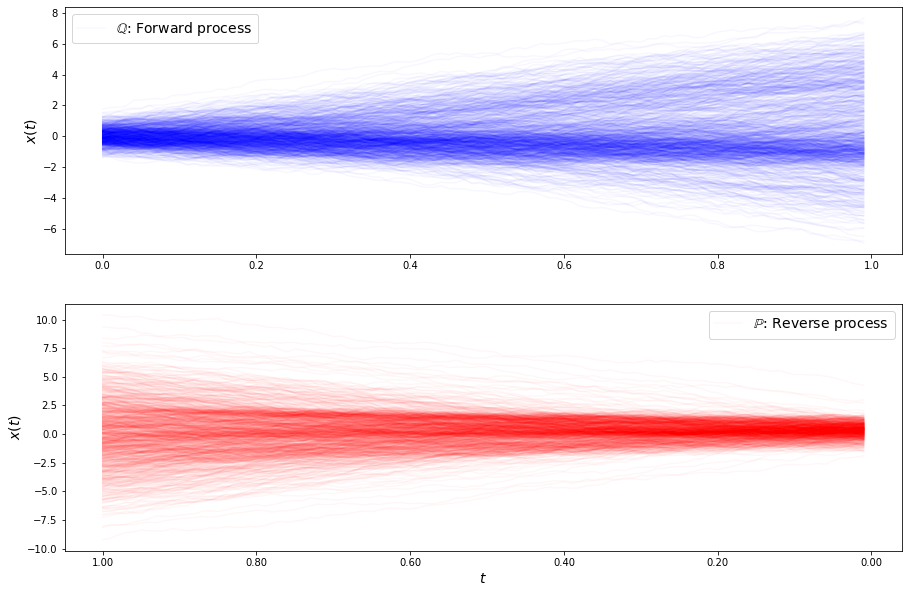

loss b 2.988503755456009
loss b 3.0067087358085343
loss b 2.828477895263997
loss b 3.0345955596089618
loss b 2.7296285101098956
loss b 2.7941266910545504
loss b 2.866695232711276
loss b 2.8780022638514704
loss b 3.0348388274093523
loss b 2.7618868942920587
loss b 2.826886861782004
loss b 2.9611776287636036
loss b 2.874181638172434
loss b 2.650463729368638
loss b 2.762999893015516
loss b 2.7937093021874344
loss b 2.736203076696912
loss b 2.6137812180202213
loss b 2.750352140326192
loss b 2.910880061151535
loss b 2.864152009175407
loss b 2.780229132049113
loss b 2.6480233812712193
loss b 3.044592288217045
loss b 2.9913678718945658
loss b 2.857686204400839
loss b 2.759755512157138
loss b 2.6697083006672346
loss b 2.9019459681574666
loss b 2.8040056446883486
loss f 1.9679105999123006
loss f 1.927744459888981
loss f 1.90589318007637
loss f 1.892424261878826
loss f 2.0823206380941475
loss f 1.9757984664544834
loss f 1.9270365321857237
loss f 1.8609056638391932
loss f 1.977764922854223
loss f

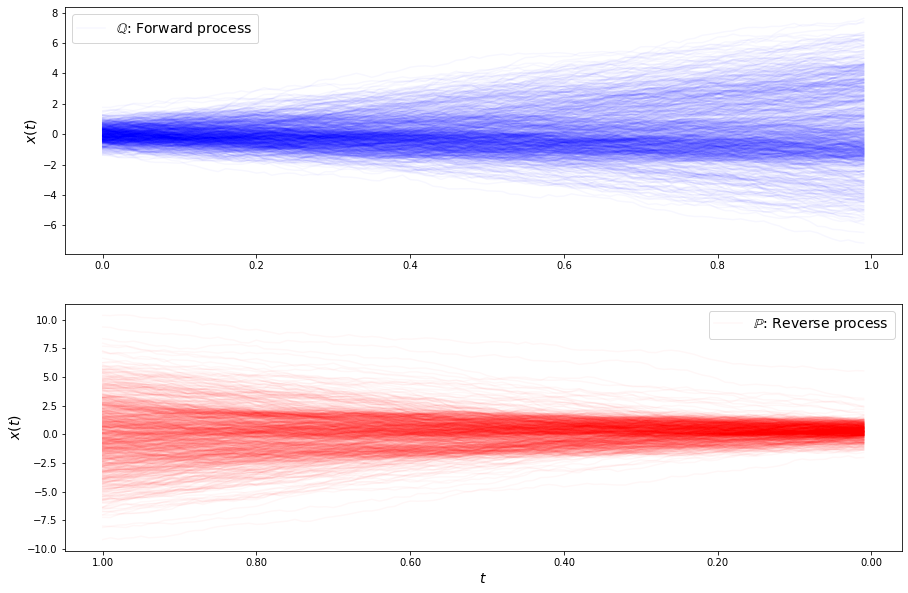

loss b 2.6939053764071432
loss b 2.9659118900451036
loss b 2.5251328498817514
loss b 2.550098298083467
loss b 2.555686853806615
loss b 2.716369162122246
loss b 2.800457489300397
loss b 2.6855088294279787
loss b 2.7569541073357464
loss b 2.6382667441351466
loss b 2.583883802871616
loss b 2.5770332370644513
loss b 2.6637303361810654
loss b 2.399885909129031
loss b 2.474312412443433
loss b 2.53447656195718
loss b 2.4478832633004863
loss b 2.6690386191444007
loss b 2.5306382534686302
loss b 2.653984898824782
loss b 2.5083563176635786
loss b 2.7013438563851917
loss b 2.5830328907284907
loss b 2.4485654225718676
loss b 2.6642998594527207
loss b 2.46772837834799
loss b 2.4424426096157217
loss b 2.5313467474107556
loss b 2.600052748687255
loss b 2.620853716836204
loss f 1.7612259878670764
loss f 1.7841040333075298
loss f 1.7577755268921822
loss f 1.7584723381811407
loss f 1.8114832354716712
loss f 1.7004819818457046
loss f 1.900092643894775
loss f 1.7856896475193587
loss f 1.7355780443236248
l

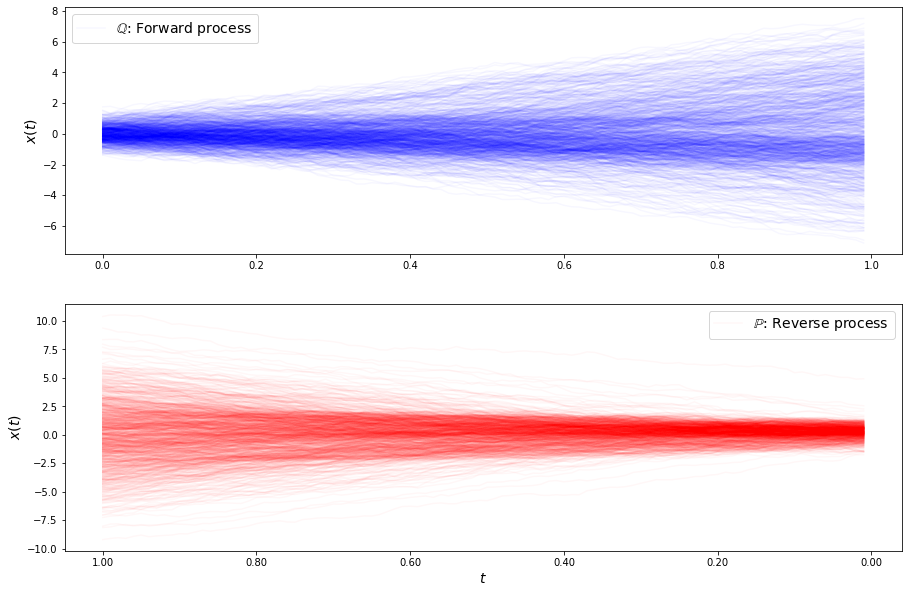

loss b 2.2744917088459276
loss b 2.165112069012069
loss b 2.32191111086985
loss b 2.109734994218787
loss b 2.2130760184841534
loss b 2.1419795222188007
loss b 1.9877346143843124
loss b 2.0662874678177663
loss b 1.8999866152507636
loss b 2.177319443101583
loss b 2.165835672678409
loss b 2.4350600945263476
loss b 2.187141674003206
loss b 2.0222694163083124
loss b 2.0807800144031363
loss b 1.9487525608400036
loss b 2.0572616838098505
loss b 2.069559547145274
loss b 1.9556760775323845
loss b 1.9233503798991178
loss b 1.9102546321136393
loss b 1.8461609281726368
loss b 2.0805966291243343
loss b 2.048549159534744
loss b 1.8366281330309184
loss b 1.79124160136596
loss b 1.8620255455853887
loss b 1.7921975832460617
loss b 2.1469014781688847
loss b 1.8759901316737078
loss f 1.3968774045695918
loss f 1.3553636968015623
loss f 1.524804649945497
loss f 1.3420966069034803
loss f 1.484301947070446
loss f 1.3886911248512783
loss f 1.4195836601433374
loss f 1.4250883854078995
loss f 1.5375716973117162

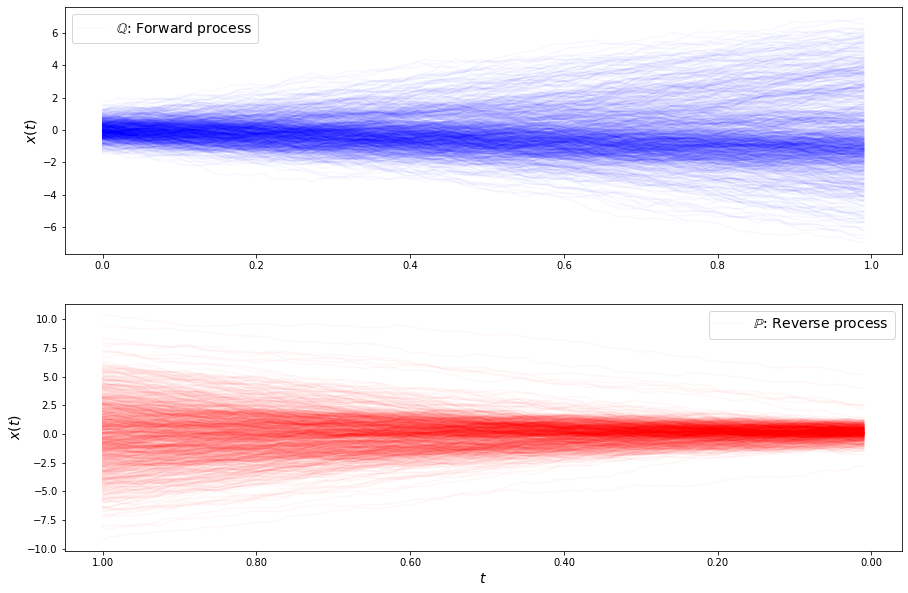

loss b 1.751852335871385
loss b 1.5732756415995726
loss b 2.0837778540220966
loss b 1.655174911881707
loss b 1.764910053933988
loss b 1.9495371834660296
loss b 1.9840302396136016
loss b 1.7688309388334105
loss b 1.5572021071040867
loss b 1.9981915556108274
loss b 1.5547354076635318
loss b 1.5040117406613358
loss b 1.8278399530027591
loss b 1.6648608050219291
loss b 1.6359744200448807
loss b 1.7191789806563733
loss b 1.6170806688685093
loss b 1.8087887576063932
loss b 1.6318392486502984
loss b 1.7192208993074616
loss b 1.7239049492746585
loss b 1.6495398599605666
loss b 1.7611762000479627
loss b 1.5358164997538188
loss b 1.6046242801622732
loss b 1.6645262392244016
loss b 1.6152847607378356
loss b 1.8109899350119496
loss b 1.581006683245471
loss b 1.64931652814217
loss f 1.1608680374914158
loss f 1.1871711575161685
loss f 1.1059942461718724
loss f 1.1752810199260526
loss f 1.2405586710077772
loss f 1.256177751044346
loss f 1.2328156102689198
loss f 1.1983722230769456
loss f 1.2274976579

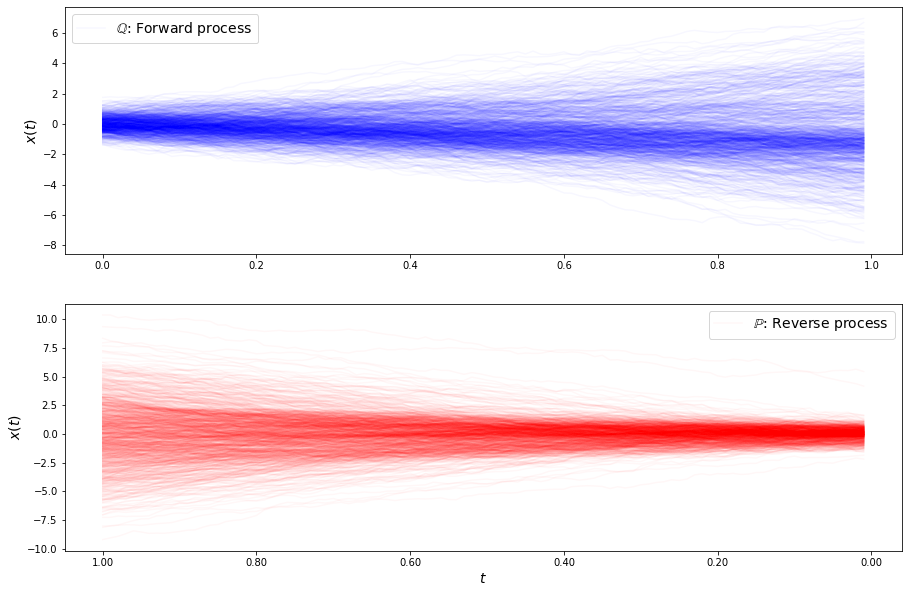

loss b 1.6820522129604074
loss b 1.6509869870186957
loss b 1.870377944423752
loss b 1.7621499430462946
loss b 1.6595327589883373
loss b 1.6805819963482151
loss b 1.8131236950816938
loss b 1.709970124944239
loss b 1.8016282792473466
loss b 1.7748588072276854
loss b 1.5812914619035636
loss b 1.6913993491635808
loss b 1.6987271327343054
loss b 1.6429369107170313
loss b 1.4536477092383604
loss b 1.6017048818618997
loss b 1.633414360862586
loss b 1.7945320937461249
loss b 1.6529180606656124
loss b 1.694611028283519
loss b 1.8714177339885676
loss b 1.8653726729519766
loss b 1.6720728797788837
loss b 1.9649128615054068
loss b 1.5043099687962527
loss b 1.6951893999531407
loss b 2.1890959160289567
loss b 1.5484997179674984
loss b 1.6636574307887626
loss b 1.7473991342247261
loss f 1.3224184949460498
loss f 1.2940629888847703
loss f 1.2551146005155804
loss f 1.2691171348113401
loss f 1.314714657151343
loss f 1.1390270297423137
loss f 1.2493483443017206
loss f 1.263171624796549
loss f 1.271275071

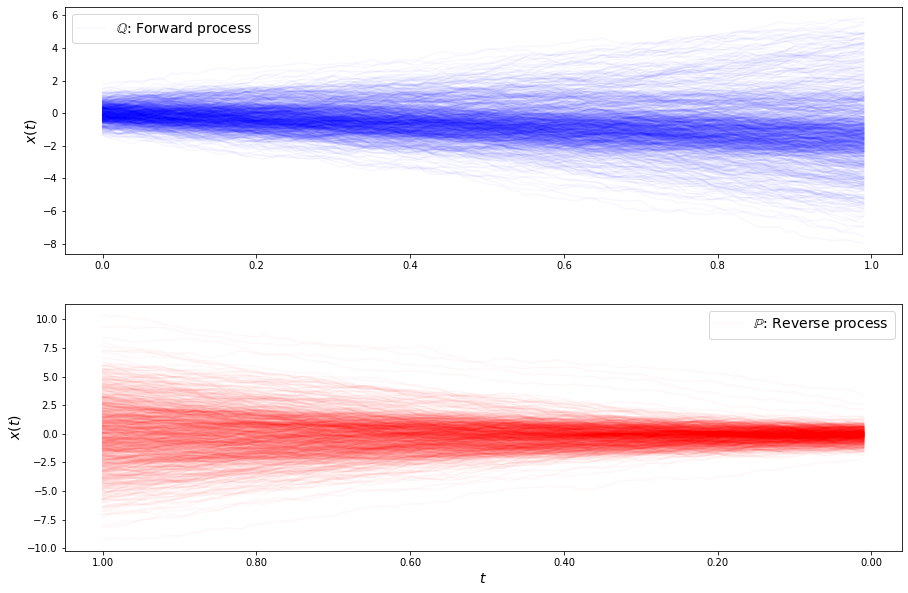

loss b 2.010873888006244
loss b 1.8001103434206172
loss b 1.9492210450783416
loss b 1.831885036274283
loss b 2.1137759270809773
loss b 1.8448796649098849
loss b 2.1883566749411387
loss b 2.2052374243629784
loss b 1.8870625040058606
loss b 2.0651868769454627
loss b 1.8453094104230578
loss b 2.0352668573246095
loss b 2.0547496359217163
loss b 1.9712036895044123
loss b 2.0563626589420476
loss b 1.9561988888051631
loss b 1.866896846047981
loss b 2.0548347286971715
loss b 1.931122094341138
loss b 1.9396685100480582
loss b 1.8248837878716782
loss b 2.042970054547874
loss b 1.9008988501421615
loss b 2.0854056974923116
loss b 2.124600945764227
loss b 2.0344279229975806
loss b 2.14861207520431
loss b 2.047112346645036
loss b 1.944790480069975
loss b 2.3352333864767503
loss f 1.517227425199981
loss f 1.6020049312904252
loss f 1.5152715861291506
loss f 1.561893144308625
loss f 1.5530180707845338
loss f 1.5586386498824074
loss f 1.6363913072457676
loss f 1.6082700275926296
loss f 1.536082943938596

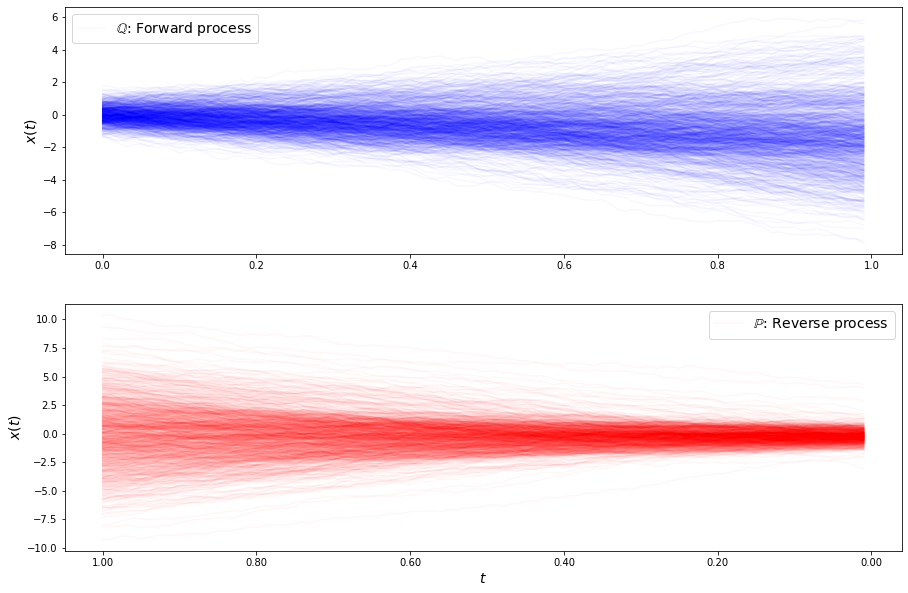

loss b 2.2630608126550382
loss b 2.3172374469057675
loss b 2.226365167974874
loss b 2.4444258944474906
loss b 2.4064816431355207
loss b 2.3153923329263946
loss b 2.1996214092103847
loss b 2.320824987602948
loss b 2.206572376413016
loss b 2.2369167184207157
loss b 2.3042637623899966
loss b 2.1991946279576577
loss b 2.322564728767614
loss b 2.589615424714673
loss b 2.2708555302006226
loss b 2.3424332119947913
loss b 2.3580932582931315
loss b 2.1810809760534835
loss b 2.299834039423221
loss b 2.238477149036324
loss b 2.2056424714941856
loss b 2.6519418712513065
loss b 2.281357758544377
loss b 2.3648192513045267
loss b 2.5943334653767605
loss b 2.335121443430709
loss b 2.190073652057175
loss b 2.4782222609826277
loss b 2.4355699089612357
loss b 2.376704895271365
loss f 1.6985523628489347
loss f 1.90717737727609
loss f 1.8384670622845896
loss f 1.7578889819584453
loss f 1.7263737132809576
loss f 1.7366371245159578
loss f 1.762040971309301
loss f 1.8255112170196133
loss f 1.780617973137847
l

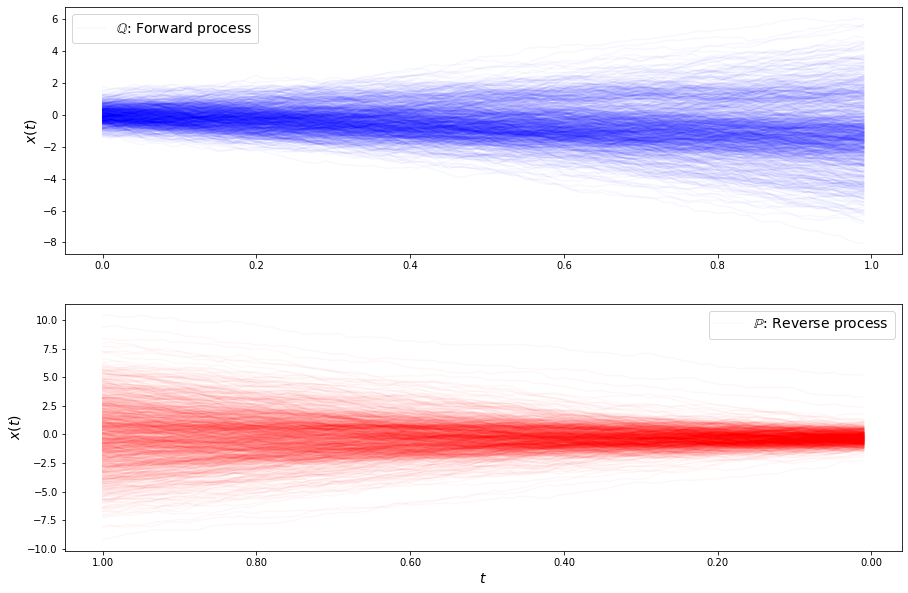

loss b 2.574239977422669
loss b 2.3829750777053347
loss b 2.345183181452027
loss b 2.369219180247801
loss b 2.404592930865205
loss b 2.4782374819939577
loss b 2.264152875843518
loss b 2.362389208968037
loss b 2.4264869654319354
loss b 2.4901616270456417
loss b 2.6632685325982983
loss b 2.524788899203858
loss b 2.6045631689004316
loss b 2.5366456637702672
loss b 2.3147157885097047
loss b 2.426625663584663
loss b 2.348594353527638
loss b 2.6176373907611206
loss b 2.7355102538318756
loss b 2.366657806461762
loss b 2.457776992973507
loss b 2.447531583798589
loss b 2.6342808509154167
loss b 2.4399052032993245
loss b 2.6692768286375226
loss b 2.4949304591140633
loss b 2.357182790075496
loss b 2.4324995562154434
loss b 2.4957950448334447
loss b 2.5227029867934005
loss f 1.8615178877263001
loss f 1.9012916675729836
loss f 1.9003564542100877
loss f 1.7347751730493284
loss f 1.7110956891727336
loss f 1.8724881317517201
loss f 1.7227876408996117
loss f 1.7171049946975478
loss f 1.6996400710185753

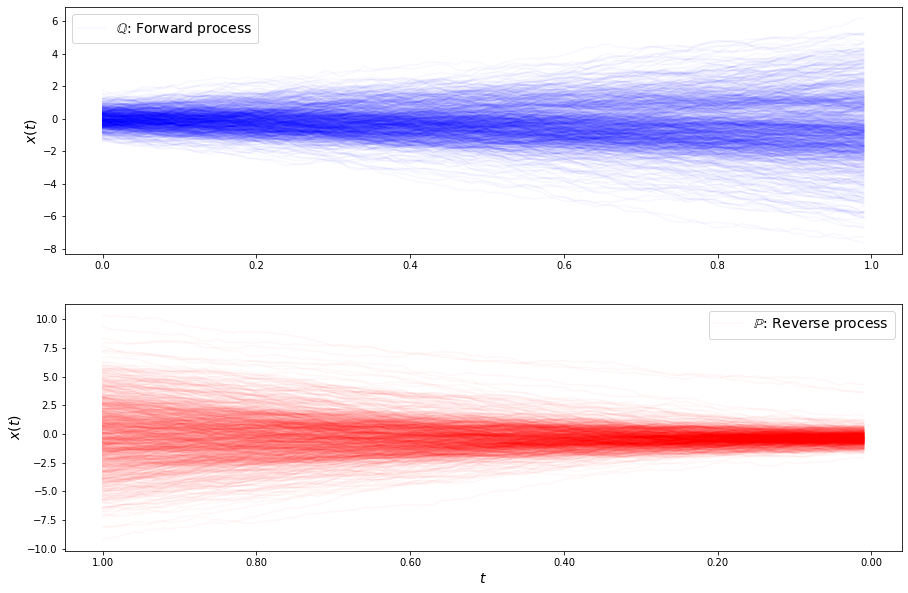

loss b 2.33292269677442
loss b 2.413312605486757
loss b 2.2132975859961554
loss b 2.2216567706415593
loss b 2.208511035830371
loss b 2.01828081674373
loss b 2.0993468440754617
loss b 2.2708399823899272
loss b 2.253082769737673
loss b 2.3310347376845706
loss b 2.1318269525024713
loss b 2.4418705911154444
loss b 2.315033552625037
loss b 2.2326883885343447
loss b 2.1493518153794766
loss b 2.2947633523925894
loss b 2.31371653264225
loss b 2.32109027228092
loss b 2.42188904260217
loss b 2.4400374780717824
loss b 2.2962640618448824
loss b 2.214838251850347
loss b 2.2764465492045276
loss b 2.3053755188824447
loss b 2.2385404779944174
loss b 2.2390928561986905
loss b 2.2143584698572885
loss b 2.201483662260009
loss b 2.350772341445674
loss b 2.2362482459397586
loss f 1.7497936253483908
loss f 1.5779293623278483
loss f 1.7396446369873724
loss f 1.6308112725409607
loss f 1.7511793520895393
loss f 1.5525448532447215
loss f 1.6608231434427776
loss f 1.6011142756119492
loss f 1.6552643948725485
los

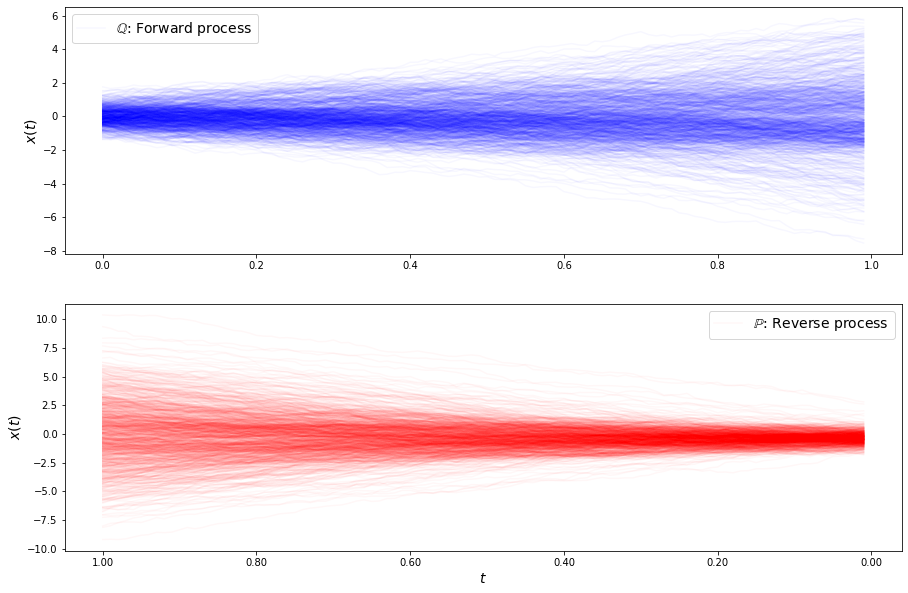

loss b 2.081195261765416
loss b 2.103495770597681
loss b 1.9223463377664998
loss b 1.9412570670797997
loss b 2.3297324925868943
loss b 1.929802177933691
loss b 2.0614851548216726
loss b 2.0524798313105896
loss b 2.019968796802963
loss b 2.1213611544390174
loss b 2.262902806256018
loss b 2.0257400945556316
loss b 1.8798309858096032
loss b 1.7377073671138832
loss b 2.335769575407335
loss b 1.9533454440890825
loss b 1.957294291292255
loss b 1.9525078128984723
loss b 1.9724263365168424
loss b 1.862024755276085
loss b 1.9140858532812455
loss b 2.0157761434374817
loss b 1.9851480353760376
loss b 1.8167503467673305
loss b 2.0066231154559513
loss b 1.8685986336513167
loss b 2.068627484140822
loss b 2.068015167338146
loss b 1.7770792188454563
loss b 2.0041764810040044
loss f 1.4995742028002532
loss f 1.497262532233782
loss f 1.523673573344541
loss f 1.63944192773436
loss f 1.6197492496306514
loss f 1.6325276047668846
loss f 1.633276687617793
loss f 1.5352549677371405
loss f 1.5587555870807852
l

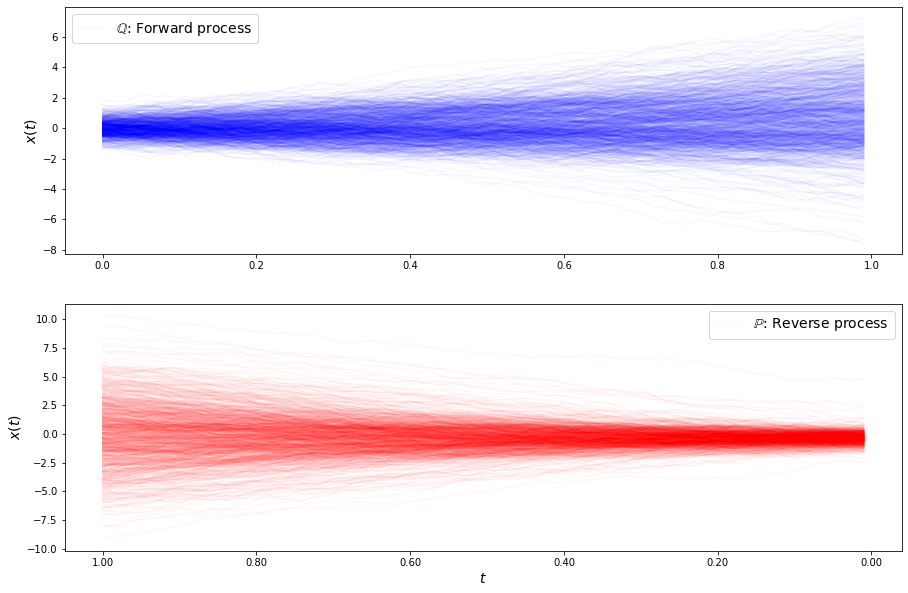

loss b 1.6672187662148197
loss b 1.7477730352848266
loss b 1.8330502325376794
loss b 1.6432419445289008
loss b 1.736167177138493
loss b 1.8087631581764843
loss b 1.8623341615298494
loss b 2.066116988589591
loss b 1.7852657144640387
loss b 1.7910879373404316
loss b 1.760547644861946
loss b 1.7290652319342659
loss b 1.908833219026541
loss b 1.7016589045248076
loss b 2.025634239969049
loss b 1.7275654616822376
loss b 1.8852030461066385
loss b 1.5853741491952154
loss b 1.7527635293920938
loss b 1.9069434643798249
loss b 1.7034634749138713
loss b 1.732646517425075
loss b 1.6842899634427482
loss b 2.0059834210894714
loss b 1.5905595588119352
loss b 1.883556443452781
loss b 1.7949186950423193
loss b 1.7680331026712413
loss b 1.838263368524055
loss b 1.7889982132783362
loss f 1.5276726753185936
loss f 1.5355488784129436
loss f 1.4322015852330738
loss f 1.4750327801616054
loss f 1.4791820605676325
loss f 1.3880826214216948
loss f 1.4973071529576587
loss f 1.512910274094412
loss f 1.436634570656

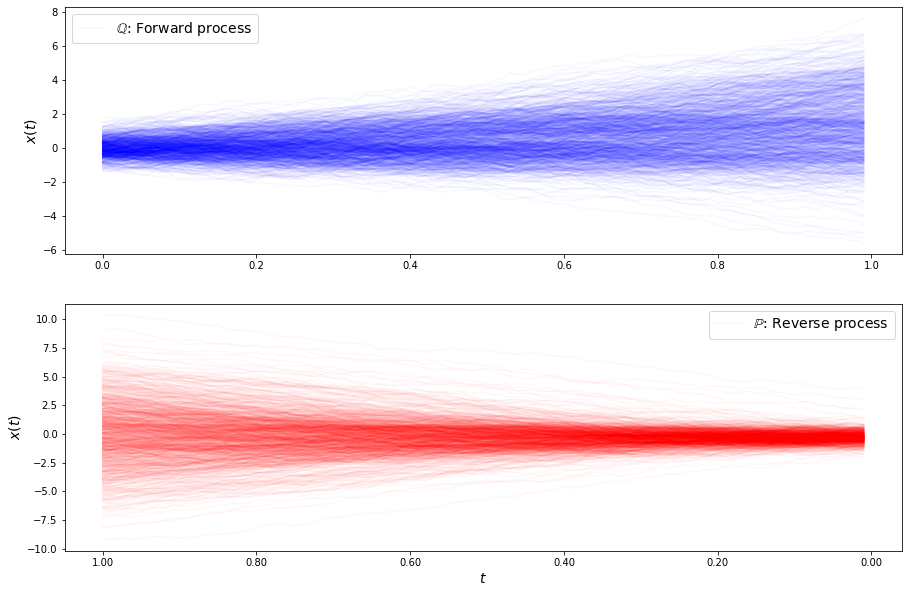

loss b 1.8313911891243349
loss b 1.776581156668829
loss b 1.8983061929822433
loss b 2.2368635177369818
loss b 1.713516680121098
loss b 1.9598680560684214
loss b 1.8678536371188679
loss b 1.7598497575488727
loss b 2.2256877043763175
loss b 1.759679927354848
loss b 1.8156690269776357
loss b 1.8711614589220593
loss b 1.694248196185774
loss b 1.8873549209693061
loss b 1.854228380523956
loss b 1.7257028054812233
loss b 1.6538864606384103
loss b 1.9136422257007635
loss b 1.9517521322801736
loss b 2.13482852897091
loss b 1.889176417271882
loss b 1.8961300844311302
loss b 1.7981470934740116
loss b 1.7439558687929986
loss b 1.7823357367890578
loss b 1.849211140980278
loss b 1.7832182311698828
loss b 1.6449943059496897
loss b 1.8025036529964482
loss b 1.7190005082949746
loss f 1.6113824831899204
loss f 1.4711149730324857
loss f 1.6061526831035566
loss f 1.4429480244676345
loss f 1.477989252459654
loss f 1.5295842798052923
loss f 1.5262330943191276
loss f 1.4830073419412197
loss f 1.5044089327943

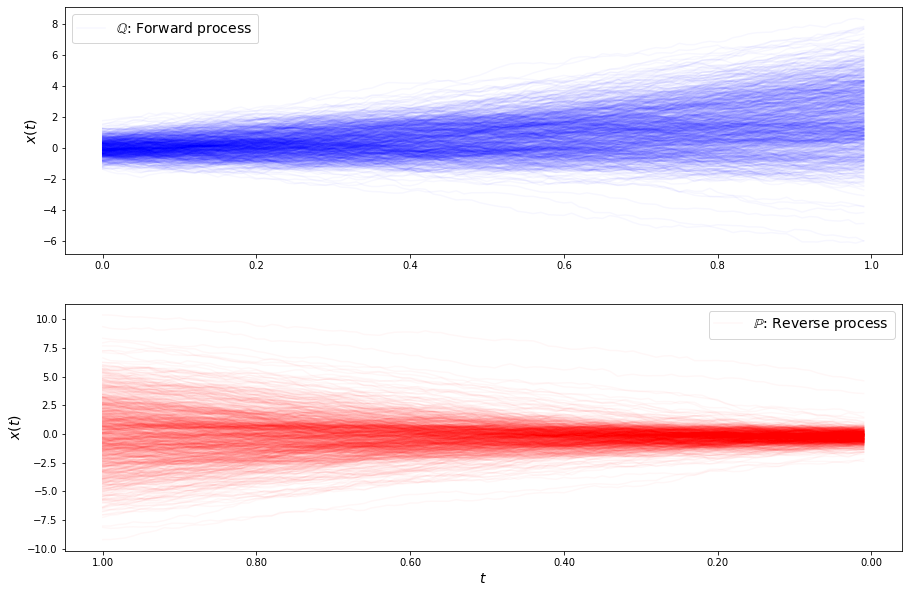

loss b 1.9994126558539025
loss b 2.188004927167305
loss b 1.9988423176793901
loss b 2.073490521283453
loss b 1.8615653004550177
loss b 2.0834788449154225
loss b 1.9982747089492725
loss b 1.9119881291636676
loss b 2.0129697225931924
loss b 1.9455460438815644
loss b 2.126091867374468
loss b 2.17060254664725
loss b 2.1905435190524156
loss b 1.9216255585467936
loss b 1.9356207210649876
loss b 1.9966828748274152
loss b 1.9525884967242848
loss b 2.048045141838819
loss b 2.166301876750528
loss b 2.3005290321525558
loss b 1.8901259499883531
loss b 1.9517330750794044
loss b 1.8280887388196805
loss b 2.0638696077629786
loss b 2.136745189946474
loss b 1.966640241465308
loss b 2.2572308459529027
loss b 2.1243141206413365
loss b 1.9435503727857877
loss b 1.9743942559903365
loss f 1.6937333240157901
loss f 1.754446399426085
loss f 1.6596990944940342
loss f 1.6585952048695896
loss f 1.8104516723868127
loss f 1.709564212377734
loss f 1.7135108324291164
loss f 1.7464509943763251
loss f 1.78353785471285

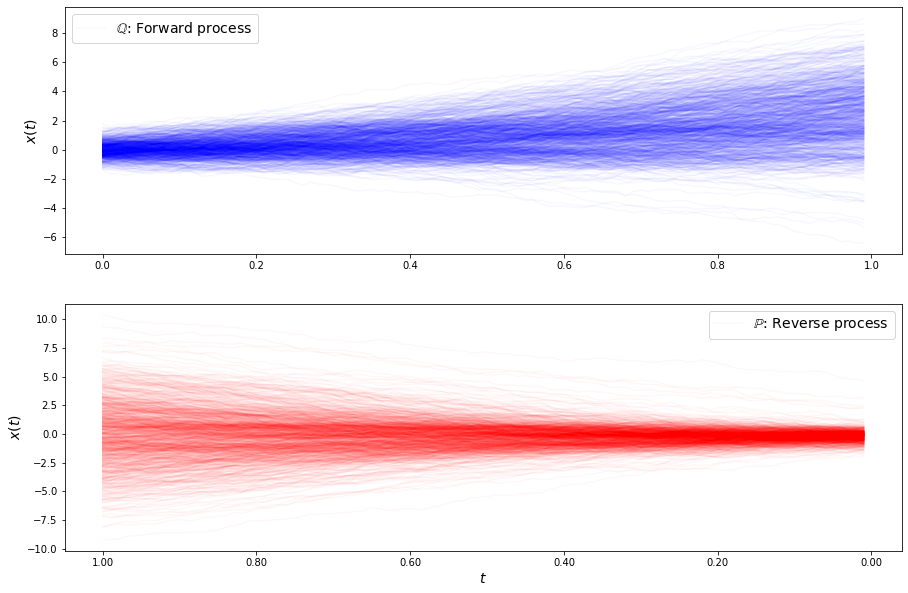

loss b 2.2608171303046856
loss b 2.2142058306455903
loss b 2.262074677646563
loss b 2.38903730203939
loss b 2.1967427183958166
loss b 2.251631794872067
loss b 2.173067262456292
loss b 2.365892385884272
loss b 2.2557303892896896
loss b 2.256803249707938
loss b 2.390083010013356
loss b 2.273497333911071
loss b 2.155990122205253
loss b 2.264031342196409
loss b 2.507994665447048
loss b 2.424312083440048
loss b 2.190783626777905
loss b 2.14255201528942
loss b 2.31896061817256
loss b 2.1829348896596126
loss b 2.235089116751822
loss b 2.2769414952573275
loss b 2.2486978759458363
loss b 2.1797874737982488
loss b 2.428996991768928
loss b 2.3673609843795957
loss b 2.5601812903319394
loss b 2.227357430200624
loss b 2.2425769231913875
loss b 2.282167263205879
loss f 1.975807986206203
loss f 1.8237297343302774
loss f 1.876480232279595
loss f 1.9270898300581552
loss f 1.9519516831941146
loss f 1.8997701978700616
loss f 1.938825729318406
loss f 1.854241743059369
loss f 1.9504747117212802
loss f 1.848

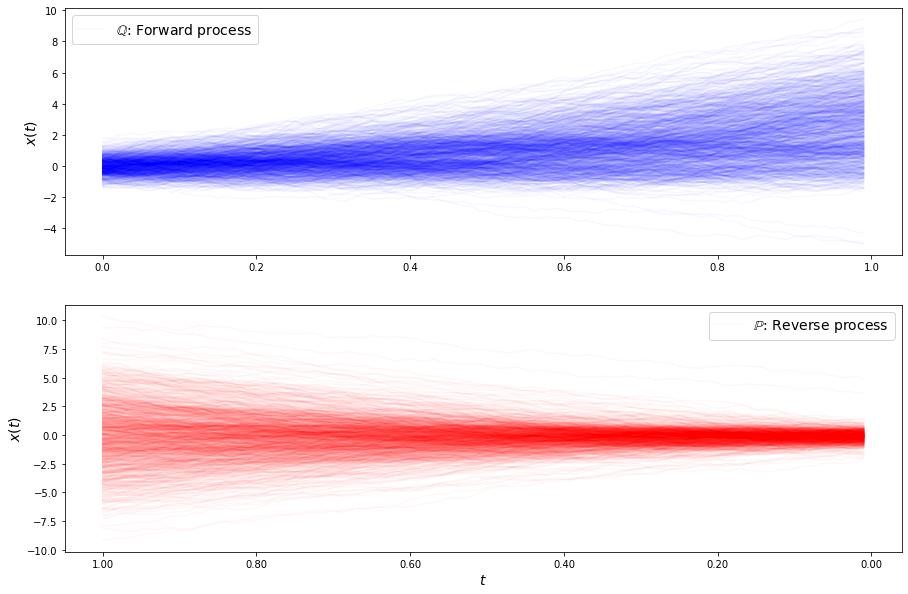

loss b 2.2528192332870645
loss b 2.3271435573275245
loss b 2.3380029796174533
loss b 2.4838614001538937
loss b 2.404838982834032
loss b 2.3023970403224414
loss b 2.2237366874708577
loss b 2.2599199711741287
loss b 2.359670808451675
loss b 2.2280174433066575
loss b 2.466370911504962
loss b 2.3379603931547126
loss b 2.509453359435022
loss b 2.2425196970151027
loss b 2.3358036032062413
loss b 2.2489812348894627
loss b 2.3173503194716574
loss b 2.2374717874466423
loss b 2.513273638143722
loss b 2.2558939162872615
loss b 2.4813665731891805
loss b 2.396978485421922
loss b 2.167594017137165
loss b 2.2960802368358944
loss b 2.2302756813420963
loss b 2.3639653201834037
loss b 2.300075834142634
loss b 2.2358419605004216
loss b 2.12613862781778
loss b 2.4008992842732715
loss f 1.937202930789234
loss f 1.9043789773541948
loss f 1.9272493353541995
loss f 1.9121293697392043
loss f 1.8483125474901796
loss f 1.861250468992078
loss f 1.8836700705500007
loss f 1.964446155520948
loss f 1.8543730630554955

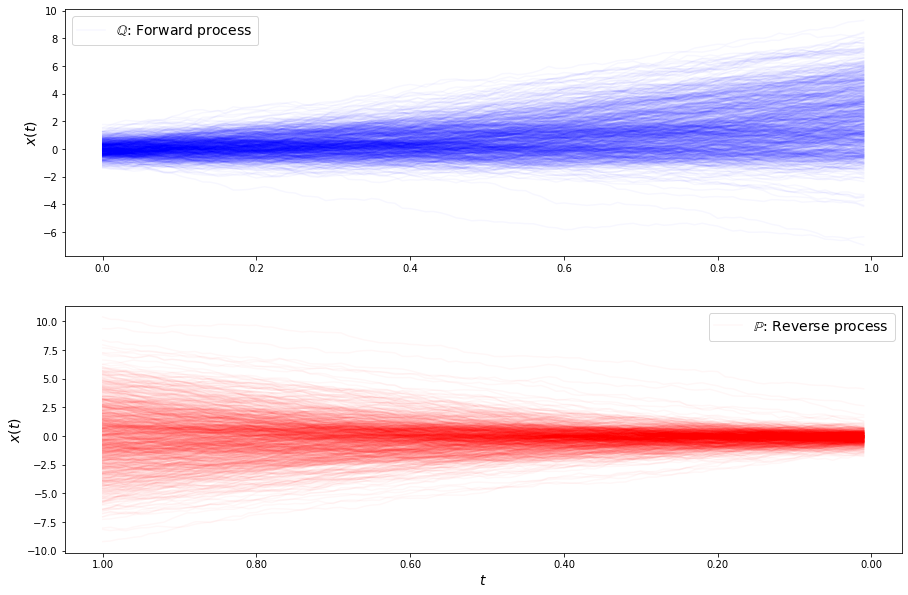

loss b 2.088769564295175
loss b 2.1935787370629947
loss b 2.2790276470155977
loss b 2.280247272870264
loss b 2.084772369341339
loss b 2.202802503844605
loss b 1.992698317216727
loss b 2.2697692511405454
loss b 2.3320460586529834
loss b 2.1903465431514926
loss b 2.1229749987866
loss b 2.2482707433469202
loss b 2.1833994725221615
loss b 2.063020188356821
loss b 2.0350122228200713
loss b 2.0877380989927175
loss b 2.348306821977798
loss b 2.389528872234731
loss b 2.242536068563517
loss b 2.258873215425304
loss b 2.2145820409064636
loss b 2.1062995335676042
loss b 2.121297590942243
loss b 2.035366246464039
loss b 2.139097381998377
loss b 2.042814907161535
loss b 2.204494459748958
loss b 2.1835955926639183
loss b 2.0364648471982094
loss b 1.9964857028717558
loss f 1.7945844676481664
loss f 1.7351986355613025
loss f 1.7597928262139684
loss f 1.6865856692634162
loss f 1.788906472460373
loss f 1.7593514625312148
loss f 1.7320034059432767
loss f 1.6615914888858987
loss f 1.7287594587846111
loss 

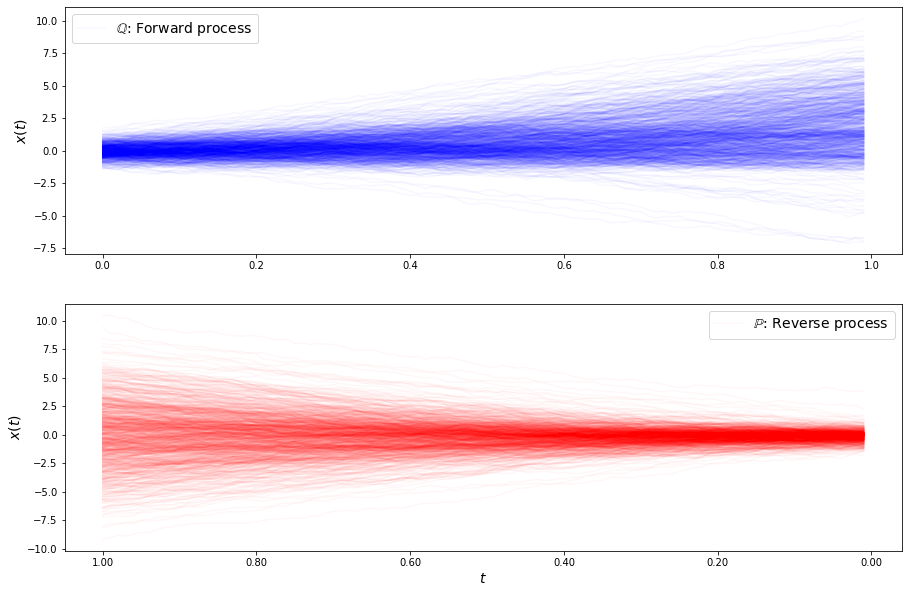

loss b 1.6616055308317108
loss b 1.8384452136632439
loss b 1.9115674133719223
loss b 1.9123583904951091
loss b 1.9301921379087716
loss b 1.9065300589454153
loss b 1.9110248770508558
loss b 1.8015765302737738
loss b 1.7548902440099938
loss b 1.681825236051832
loss b 1.8433811771406108
loss b 1.9011712767648383
loss b 1.826939721764424
loss b 1.897473447363358
loss b 1.8164477762436297
loss b 1.9845418528221734
loss b 1.749450468786207
loss b 1.8348680487032043
loss b 1.8312283943119358
loss b 1.6500182255354339
loss b 1.7586420054322003
loss b 1.841286276551283
loss b 1.8419082504694497
loss b 1.7342993803477829
loss b 1.8547976523109855
loss b 1.7618855307620345
loss b 1.6938265809386863
loss b 1.790343982259731
loss b 1.7626048787624788
loss b 1.830044451022206
loss f 1.5670500710431408
loss f 1.390209499351962
loss f 1.447548207949074
loss f 1.3114163025628984
loss f 1.414508566252619
loss f 1.3305455014443954
loss f 1.3973110133292603
loss f 1.3980669315773886
loss f 1.3482665732425

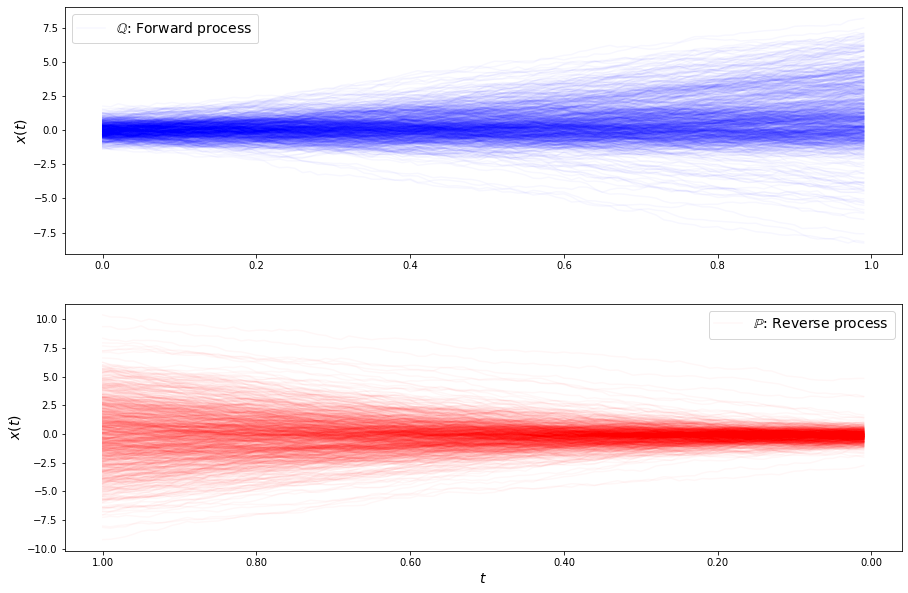

loss b 1.675596819086107
loss b 1.4635501433039284
loss b 1.6663855198334607
loss b 1.7889115159925295
loss b 1.474038046453213
loss b 1.4665197204471063
loss b 1.5575761855834855
loss b 1.880011053226049
loss b 1.669179801810175
loss b 1.5009323560014232
loss b 1.6103683693176467
loss b 1.7269665962735081
loss b 1.8116975703195313
loss b 1.5886448747652346
loss b 1.546445195690135
loss b 1.4330235536321594
loss b 1.575646753183782
loss b 1.776620214544171
loss b 1.640133394291113
loss b 1.6478215696872656
loss b 1.5433608572185857
loss b 1.578903638778901
loss b 1.4899917936783236
loss b 1.543963497311687
loss b 1.6317728081591767
loss b 1.5859584590446738
loss b 1.8729315994187345
loss b 1.6168631840985521
loss b 1.3146492232971123
loss b 1.684708150194817
loss f 1.1601809008104806
loss f 1.16366197589075
loss f 1.169260570537551
loss f 1.1858092456175993
loss f 1.222397142568316
loss f 1.1791993767601567
loss f 1.2076351769392764
loss f 1.3302130967138288
loss f 1.2263500698366625
l

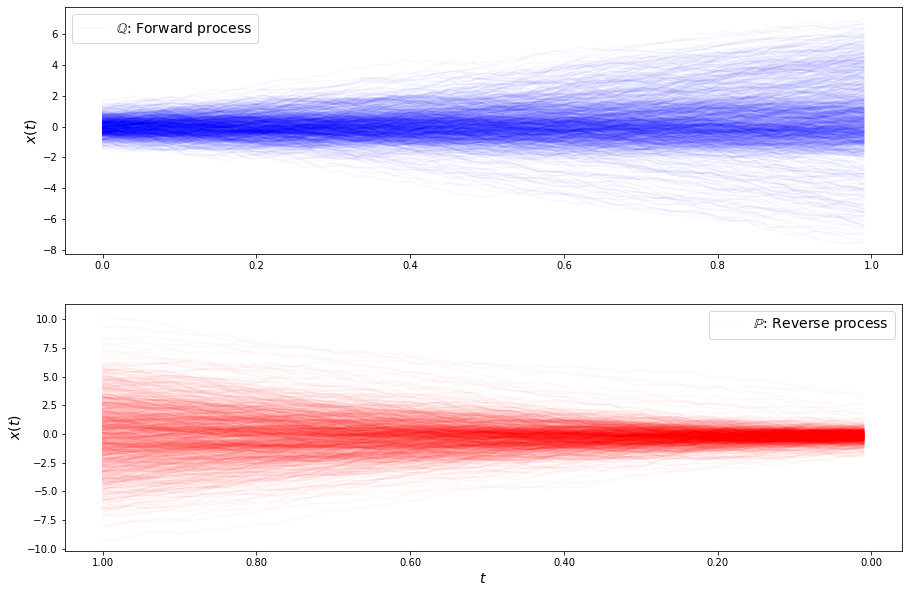

loss b 1.6015963017921022
loss b 1.5481968237568553
loss b 1.5432032817975287
loss b 1.595496618228055
loss b 1.472398870346444
loss b 1.6733920673771752
loss b 1.4548128880016333
loss b 1.5278614063709672
loss b 1.776608643484775
loss b 1.5768856711751977
loss b 1.7991411268593118
loss b 1.4089549623568605
loss b 1.7004466338959776
loss b 1.5348442740248158
loss b 1.4058195577809172
loss b 1.5795565572962273
loss b 1.6226393885692945
loss b 1.6285694686549437
loss b 1.7456857923663365
loss b 1.539692562404124
loss b 1.4840102869046679
loss b 1.5732346328214322
loss b 1.5847744307210623
loss b 1.5884723909604201
loss b 1.5594844318273704
loss b 1.5754349644029277
loss b 1.540444017890298
loss b 1.752521931854005
loss b 1.5478916098625615
loss b 1.4707489169644699
loss f 1.0956245158861253
loss f 1.1225852175567599
loss f 1.234170973664416
loss f 1.1852532686477708
loss f 1.069455510054572
loss f 1.1475623838207523
loss f 1.243295964107045
loss f 1.1591396410948025
loss f 1.148044283198

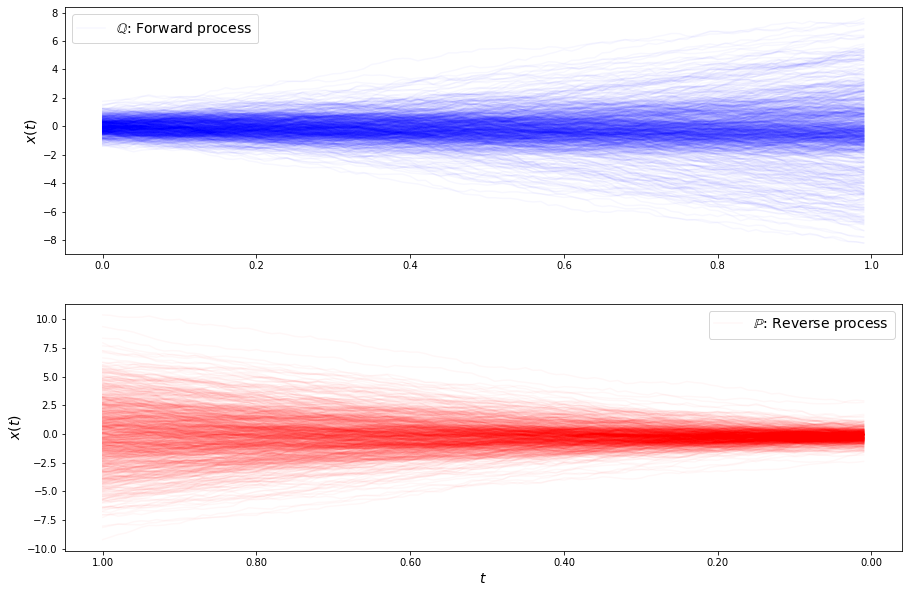

loss b 1.6749200496476986
loss b 1.6114123054224458
loss b 2.0939129559566694
loss b 1.6513964605365865
loss b 1.7085294984559705
loss b 1.5906850039713112
loss b 1.6847690815578418
loss b 1.79151287842627
loss b 1.679852578057417
loss b 1.7844967194680286
loss b 1.604048594531708
loss b 1.665566269265854
loss b 1.702078471314805
loss b 1.68419322363202
loss b 1.4874262530411957
loss b 1.4741180140953245
loss b 1.5605728842831703
loss b 1.6772545177535523
loss b 1.6923707676364657
loss b 1.7280168462819048
loss b 1.6620307680244226
loss b 1.8709890004844312
loss b 1.6690466439531413
loss b 1.671171880748619
loss b 1.6191941523558129
loss b 1.6573964305968296
loss b 1.7122328903667783
loss b 1.7540760864419846
loss b 1.6169690928801028
loss b 1.6774021916130888
loss f 1.2481581831647972
loss f 1.2830171668230705
loss f 1.3391150713481534
loss f 1.4307332118799756
loss f 1.3526733541338323
loss f 1.351306277268655
loss f 1.3695311026664214
loss f 1.431551031902164
loss f 1.36099761892193

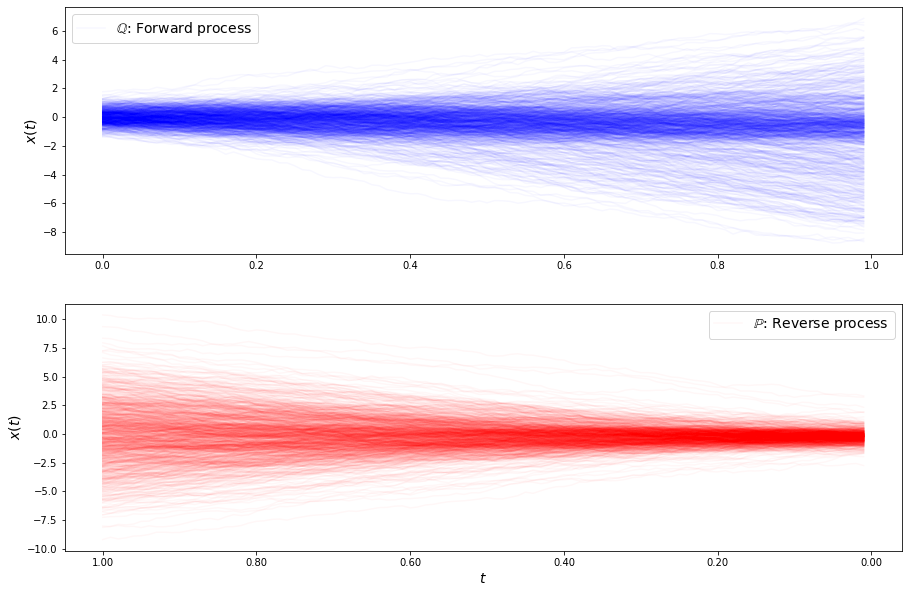

loss b 2.0869285023374933
loss b 1.742519781873479
loss b 1.9641936418353305
loss b 1.880756917877949
loss b 2.0593947608967946
loss b 2.1540571674832534
loss b 1.7625763302875161
loss b 1.8779880257809674
loss b 1.9784129509404023
loss b 1.9446862828641351
loss b 1.7559146374653367
loss b 2.1007381143190815
loss b 1.752151261733179
loss b 1.8640651024299963
loss b 1.8061813858673677
loss b 1.9274529343144478
loss b 1.8443375404421027
loss b 1.7758791653765578
loss b 1.7338583899943152
loss b 1.9012261843827445
loss b 1.8215758973824014
loss b 1.8962936447843015
loss b 1.9069940940148231
loss b 1.8266802771915815
loss b 1.9861712289377766
loss b 1.8812263105418612
loss b 1.7653604397531972
loss b 1.841771624719444
loss b 1.7622510142813386
loss b 1.9711002474886758
loss f 1.5333040117615186
loss f 1.6465043597384754
loss f 1.6322572380726696
loss f 1.5231232752395463
loss f 1.4901300335353278
loss f 1.4764532402749784
loss f 1.5442527539116453
loss f 1.5473499762698355
loss f 1.6268736

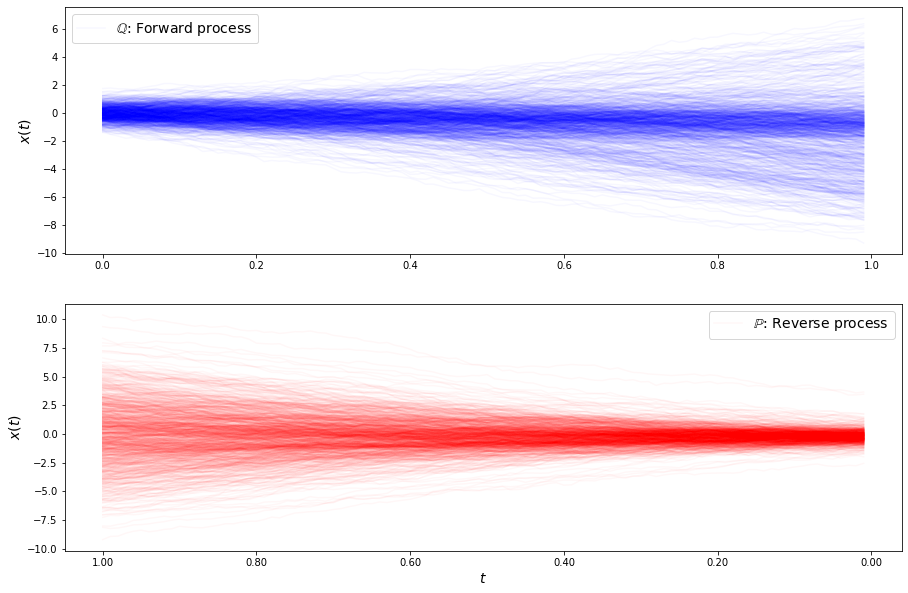

loss b 2.190649584254419
loss b 2.0996588743585893
loss b 2.0576457863596445
loss b 2.164905162192363
loss b 2.09734485160328
loss b 1.9813810495760824
loss b 2.2281149699809486
loss b 2.187114140575814
loss b 2.0261236267186913
loss b 1.8709382747926697
loss b 2.1636085942316843
loss b 2.142855110920793
loss b 1.8848727338851425
loss b 2.0847132617218858
loss b 2.0289429210573786
loss b 2.0015465696898165
loss b 2.071350883685374
loss b 2.141755999893253
loss b 2.011358628058077
loss b 2.034257904443093
loss b 2.1450936558185236
loss b 1.895368126730765
loss b 1.971094514805967
loss b 2.115514914248154
loss b 1.9882835092708024
loss b 2.0061229537765533
loss b 1.9876081428686476
loss b 2.169240471988616
loss b 2.0087380883482635
loss b 1.9574299993801567
loss f 1.7165126726701763
loss f 1.7272820820879995
loss f 1.73600357287829
loss f 1.8472123443619923
loss f 1.7738548396126927
loss f 1.7638964124224399
loss f 1.645988407488584
loss f 1.7642961655168927
loss f 1.8367448888437656
los

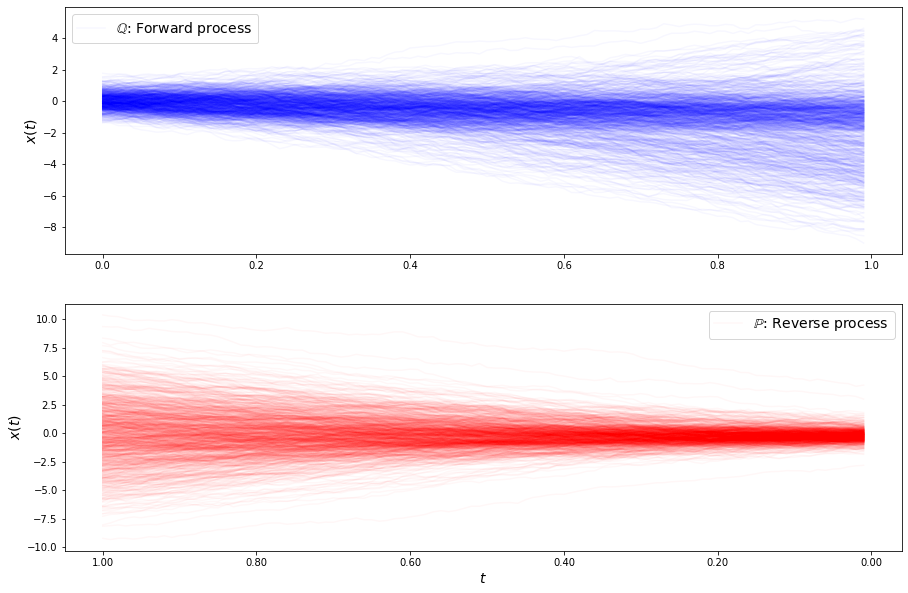

loss b 2.216394133965477
loss b 2.1645785575527166
loss b 2.075490117418678
loss b 2.162858163931942
loss b 2.12573406307278
loss b 2.1367622171824534
loss b 2.114809155327202
loss b 2.082592712792605
loss b 2.0902139969592977
loss b 2.1109937036283015
loss b 1.936700654868916
loss b 2.106366697542841
loss b 1.9736072653652215
loss b 1.9991036435137828
loss b 2.106019119778605
loss b 2.049697678911687
loss b 1.9965866566129142
loss b 2.3011232561494
loss b 1.936366394213718
loss b 2.0562792209060055
loss b 1.9404633020722206
loss b 1.9168550187817943
loss b 1.9759430547062875
loss b 1.988338512956949
loss b 2.1281143407380205
loss b 1.8922343073822372
loss b 2.027692878696882
loss b 2.0436007176751603
loss b 2.0114408394857684
loss b 1.960405804483703
loss f 1.8659189822149358
loss f 1.760531021030282
loss f 1.8141823468879767
loss f 1.7501267198887376
loss f 1.6548629165043696
loss f 1.7117983658807707
loss f 1.8631608872840033
loss f 1.716007896200072
loss f 1.7553173216194258
loss f

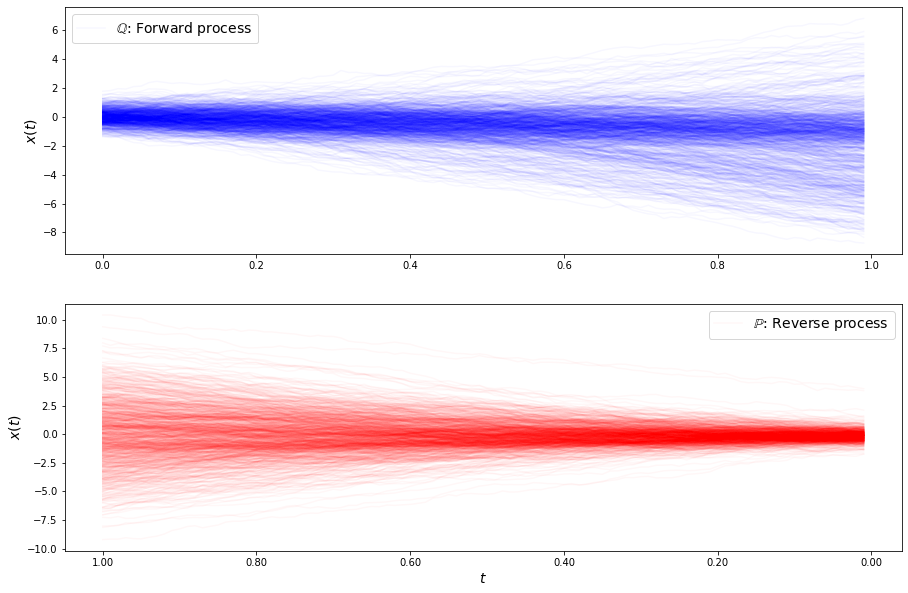

loss b 2.0652106544541207
loss b 2.1565282262863046
loss b 2.062262446196934
loss b 1.9937877616135833
loss b 1.8857402103054983
loss b 1.8875794136250552
loss b 1.858914959556189
loss b 1.8687761449748919
loss b 1.986539704731803
loss b 1.9331547207813153
loss b 1.8536478427557264
loss b 2.101850677381816
loss b 1.8776244638975146
loss b 1.9248739103474808
loss b 1.8925065170792843
loss b 2.0971149115075782
loss b 2.0055791310778512
loss b 2.0632896094905884
loss b 1.8782589122640767
loss b 2.052807224348168
loss b 1.864194030277276
loss b 1.8359293499739242
loss b 1.8769387944784341
loss b 1.885140796304683
loss b 1.8728784611090186
loss b 1.887782871296826
loss b 2.0125682723518437
loss b 1.7420148171862924
loss b 1.9836418939799938
loss b 1.9834335694119527
loss f 1.651764744368294
loss f 1.5813705289849624
loss f 1.6073653944631943
loss f 1.7138425582435508
loss f 1.621779919486784
loss f 1.6303170790566752
loss f 1.6868690685681083
loss f 1.6054164862647589
loss f 1.6670694704895

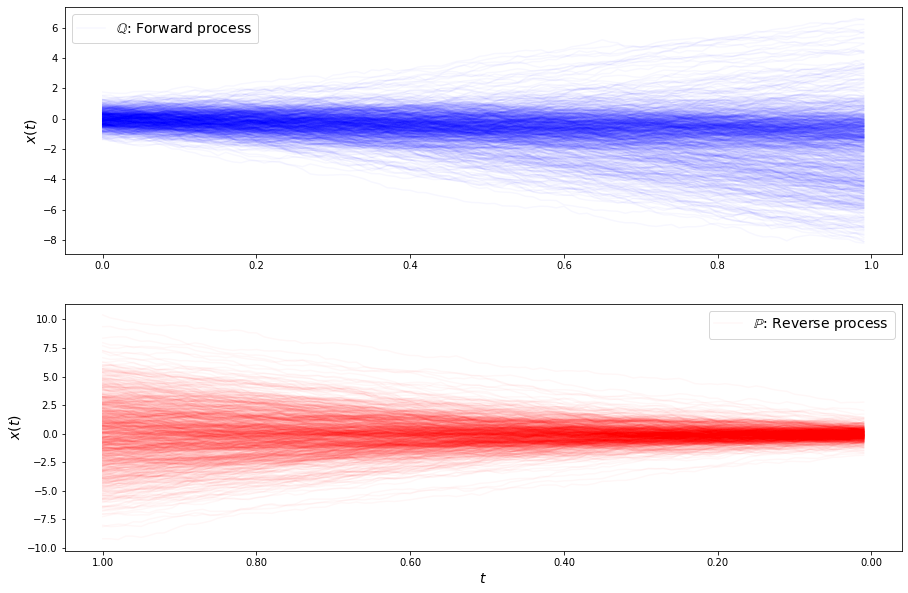

loss b 1.8144214916323727
loss b 1.7125834124062573
loss b 1.7147909588144892
loss b 1.7534278104294423
loss b 1.7146083790977902
loss b 1.8205198982512778
loss b 1.8594073213551934
loss b 1.844177800536482
loss b 1.8674089235641937
loss b 1.8401940311609666
loss b 1.7833199658680925
loss b 1.7076121636120096
loss b 1.7509146336491388
loss b 1.6878368478143488
loss b 1.7943035958199995
loss b 1.6991578545529074
loss b 2.0627349615231734
loss b 1.7133803662640232
loss b 1.8010980200959696
loss b 1.737388345858676
loss b 1.724957522835319
loss b 1.8645649329921377
loss b 1.7172386010909728
loss b 1.6437280986840634
loss b 1.9197161356250783
loss b 1.7845596118985416
loss b 1.768965928185222
loss b 1.7221917466604117
loss b 1.7587244513749503
loss b 1.7034020310904052
loss f 1.4086823151933503
loss f 1.531039156494066
loss f 1.5889151665621464
loss f 1.4413657686075294
loss f 1.4066804238529977
loss f 1.4602102943285058
loss f 1.3734806422227492
loss f 1.413150920831112
loss f 1.481212379

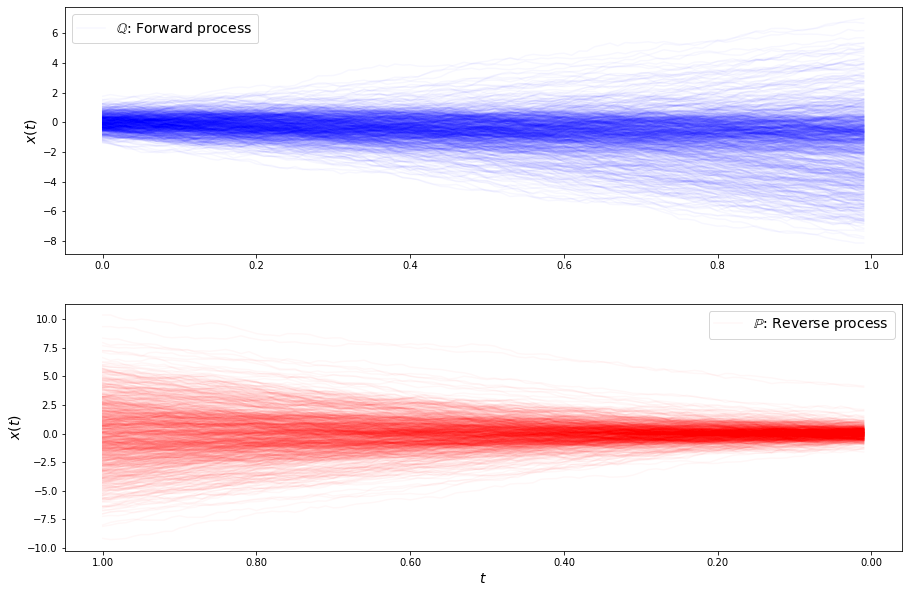

loss b 1.508265707172028
loss b 1.534167818673751
loss b 1.6838204868629525
loss b 1.5545592083423703
loss b 1.6358813301438018
loss b 1.4071939802194466
loss b 1.5341325471094873
loss b 1.6432737448940784
loss b 1.7180142314128442
loss b 1.7691234128470792
loss b 1.56522186486006
loss b 1.7297918186048797
loss b 1.4580129264058483
loss b 1.4906588709109132
loss b 1.4857234403228217
loss b 1.6403360338728095
loss b 1.5290264059355037
loss b 1.594068926814507
loss b 1.5056732534596629
loss b 1.5462456631602306
loss b 1.5131530584829926
loss b 1.8018305280720595
loss b 1.6207312791546018
loss b 1.4098326302290922
loss b 1.700719380554844
loss b 1.484623496137103
loss b 1.650667005468815
loss b 1.4591395787042023
loss b 1.5341206742673728
loss b 1.6983655567564024
loss f 1.3698934003673109
loss f 1.2207650767586102
loss f 1.2908467544588862
loss f 1.248588123970926
loss f 1.24242034942119
loss f 1.3668119232108926
loss f 1.2676035843934939
loss f 1.1992205438725572
loss f 1.23544349811100

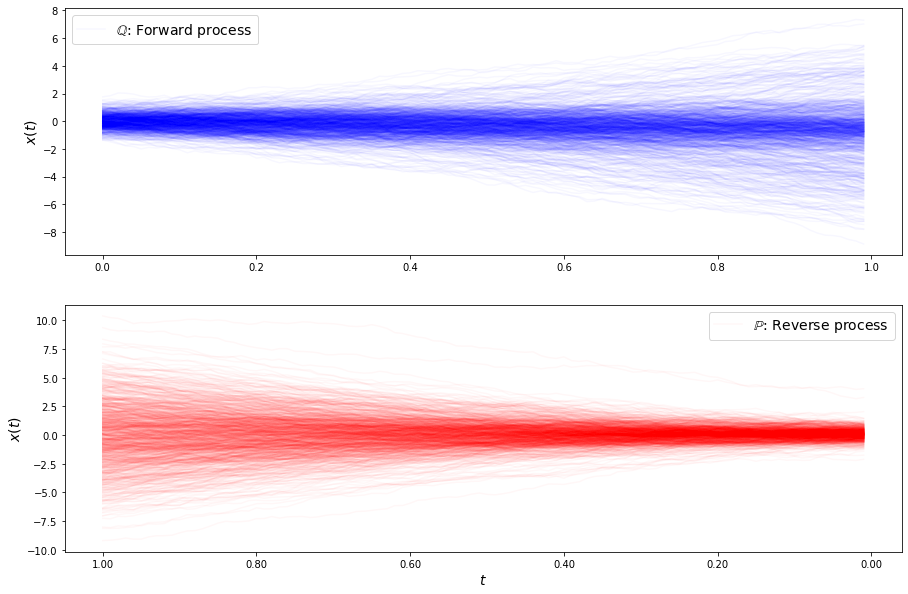

loss b 1.7703352675635062
loss b 1.573351749304686
loss b 1.4826004968636073
loss b 1.5025374620343006
loss b 1.4563526169707626
loss b 1.352211398389396
loss b 1.4031197495759578
loss b 1.24433999192959
loss b 1.5429030746508967
loss b 1.520128569189837
loss b 1.4278778692148089
loss b 1.5024506761521763
loss b 1.5747674589674847
loss b 1.3602207033515734
loss b 1.4859940498137623
loss b 1.6368029537017263
loss b 1.4870103269894948
loss b 1.6144899721326353
loss b 1.6096814097951917
loss b 1.3918778512881482
loss b 1.6831906761707176
loss b 1.5147412965144391
loss b 1.4968546225867592
loss b 1.568897465908492
loss b 1.5963024239535346
loss b 1.548863359696898
loss b 1.6408918322855777
loss b 1.5334915638760458
loss b 1.5346841543433902
loss b 1.4492821460206338
loss f 1.2043387684186369
loss f 1.2959554587843571
loss f 1.2850763872925464
loss f 1.2538001330111952
loss f 1.2622924889177807
loss f 1.2896153253412468
loss f 1.3430696473393062
loss f 1.3108758572294041
loss f 1.3041111961

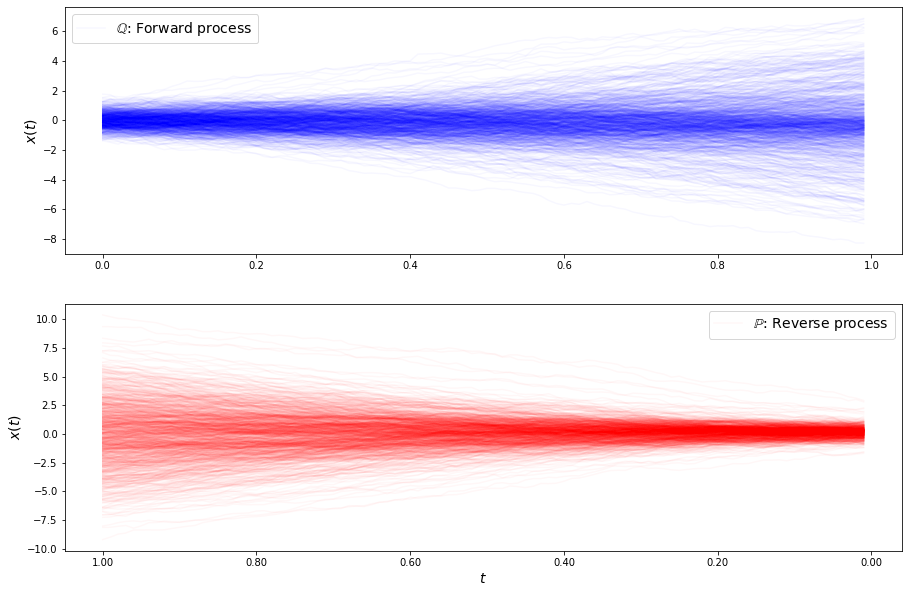

loss b 1.6066338985849384
loss b 1.4845752180162988
loss b 1.48225660265612
loss b 1.5202244544554475
loss b 1.5198028635535323
loss b 1.6299417508679506
loss b 1.6764644808537112
loss b 1.6779308605343222
loss b 1.6135347449536177
loss b 1.6659713095399633
loss b 1.5999351357994198
loss b 1.5573193820349576
loss b 1.6678410191721362
loss b 1.6652789333859337
loss b 1.4977958781397789
loss b 1.5984558538423106
loss b 1.7764070156526899
loss b 1.5483341453224497
loss b 1.740884157152682
loss b 1.6528295821535695
loss b 1.6859197697167367
loss b 1.5906559349257905
loss b 1.5680570568897794
loss b 1.6212511602298803
loss b 1.808046899786446
loss b 1.8904778545419856
loss b 1.6147554658713439
loss b 1.6650919268629532
loss b 1.6158497046308709
loss b 1.6603749260058696
loss f 1.526803262792562
loss f 1.4716416339195244
loss f 1.434502836374852
loss f 1.4133537368275408
loss f 1.3511119444908457
loss f 1.4385524572068493
loss f 1.3820507633974468
loss f 1.3944046090368483
loss f 1.521584115

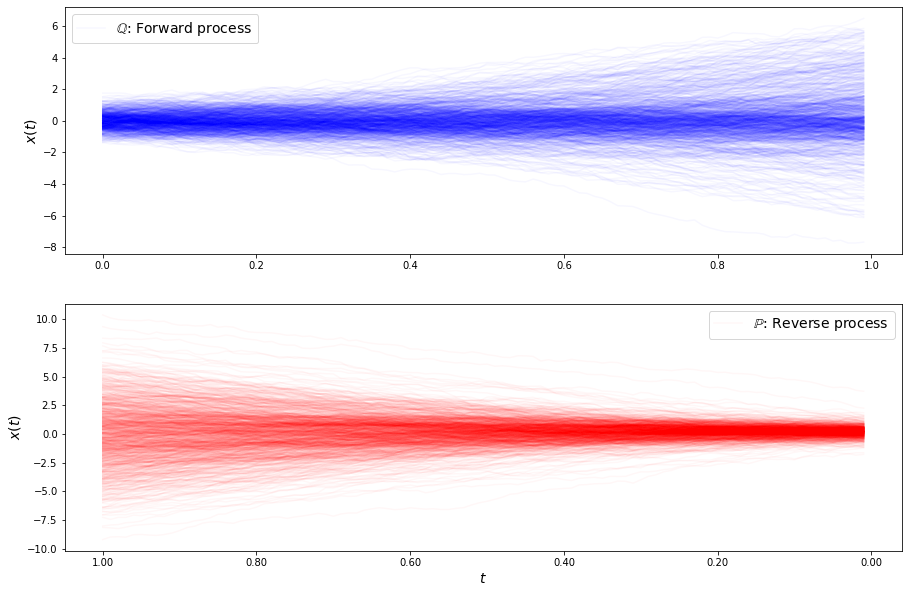

loss b 1.7297445590732128
loss b 2.0241062089476882
loss b 1.7353712231870229
loss b 1.9469833379864603
loss b 1.8872691304396352
loss b 2.046068105643534
loss b 1.8001217190941226
loss b 1.949707197950771
loss b 1.8263118977588744
loss b 1.7945879481696918
loss b 1.9684011622550266
loss b 1.8991604476729216
loss b 1.8200476991482932
loss b 1.8538352657704622
loss b 1.87013920480614
loss b 1.9262860911553223
loss b 1.8703189632085553
loss b 1.7844939321291735
loss b 1.7863905458846598
loss b 1.890184153778236
loss b 1.9027907124861372
loss b 1.836592111567115
loss b 1.786462117339008
loss b 1.8939851599580682
loss b 1.9797810072924877
loss b 1.8210014391239135
loss b 1.8525822177074052
loss b 1.8678986418142047
loss b 1.926132249760533
loss b 1.9732644312285255
loss f 1.5197796475903433
loss f 1.5714963812367504
loss f 1.6416182838686726
loss f 1.6839533282542372
loss f 1.6336006131973768
loss f 1.5872468323902258
loss f 1.443879992435601
loss f 1.6366525135870844
loss f 1.499501437788

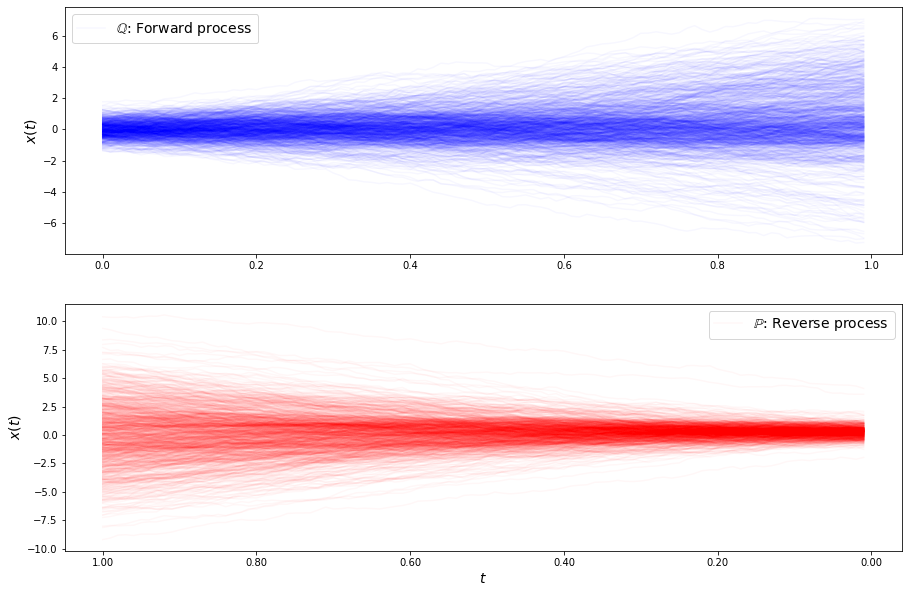

loss b 2.398970904328659
loss b 2.0993055947229284
loss b 2.2357934968157154
loss b 2.0838663727728566
loss b 2.196908441810551
loss b 2.0033795773261915
loss b 2.005933475903063
loss b 2.0673210897087695
loss b 2.1809294714825107
loss b 1.9887321396256559
loss b 2.065295831805643
loss b 1.9977010147834617
loss b 2.110541981660948
loss b 2.1546450901458742
loss b 2.053305176022179
loss b 2.348648138282162
loss b 2.077710741846973
loss b 2.2333626744697996
loss b 2.0640748886508047
loss b 1.9840466365086715
loss b 2.0993110454044417
loss b 2.0999794049507883
loss b 1.9454853936779348
loss b 1.9947696649686077
loss b 2.03558760943069
loss b 1.9768281606438218
loss b 2.23073442733687
loss b 2.0717004894452113
loss b 2.1207246171169025
loss b 2.0323050621751984
loss f 1.7170135871796364
loss f 1.6844770862236895
loss f 1.6280943211402732
loss f 1.7369387539897965
loss f 1.73891690064141
loss f 1.5812961021152314
loss f 1.7471263642773325
loss f 1.6529394326572335
loss f 1.741919299394556
l

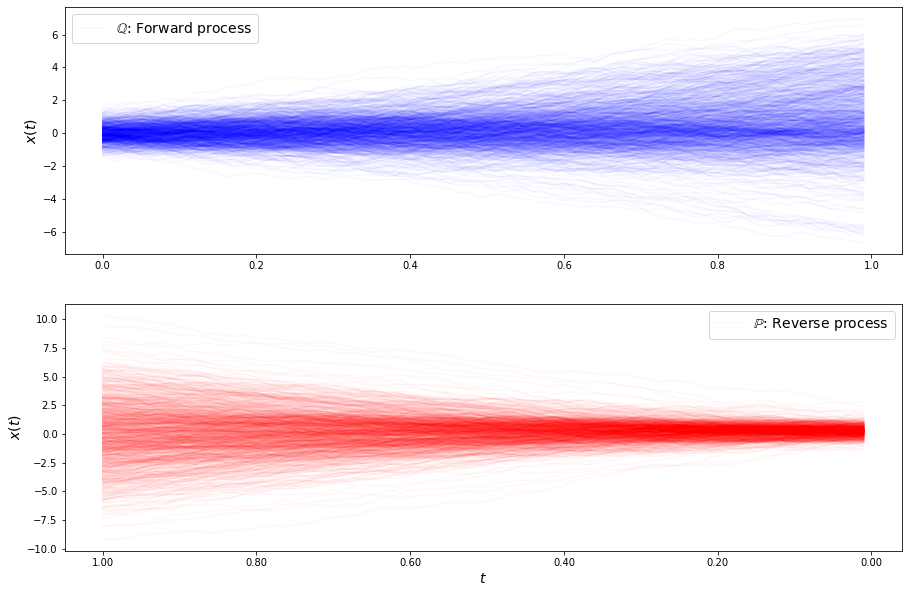

loss b 2.1369338885176443
loss b 2.268836679903954
loss b 2.3111537717195834
loss b 2.2951449857618997
loss b 2.2443696187090434
loss b 2.228812969993141
loss b 2.150491113607391
loss b 2.3850354205554907
loss b 2.22670606423096
loss b 2.075815062971001
loss b 2.277481434236726
loss b 2.3109000551971297
loss b 2.335565442045135
loss b 2.4028516123961796
loss b 2.2062289347274837
loss b 2.200106094987437
loss b 2.0760907718223027
loss b 2.174500415858833
loss b 2.1900154583083005
loss b 2.139550480908968
loss b 2.265543763407942
loss b 2.4030787074495614
loss b 2.13359887015469
loss b 2.0860878227631865
loss b 2.2095065677934307
loss b 1.995552099688768
loss b 2.1569883267004157
loss b 2.0981333011856718
loss b 2.0767485487785273
loss b 2.272502905788654
loss f 1.7455343095893188
loss f 1.6099299638873676
loss f 1.8608884062068274
loss f 1.8395695551010511
loss f 1.7276123599873041
loss f 1.7274096071340577
loss f 1.713695141244203
loss f 1.8073211942055858
loss f 1.6743118554380263
los

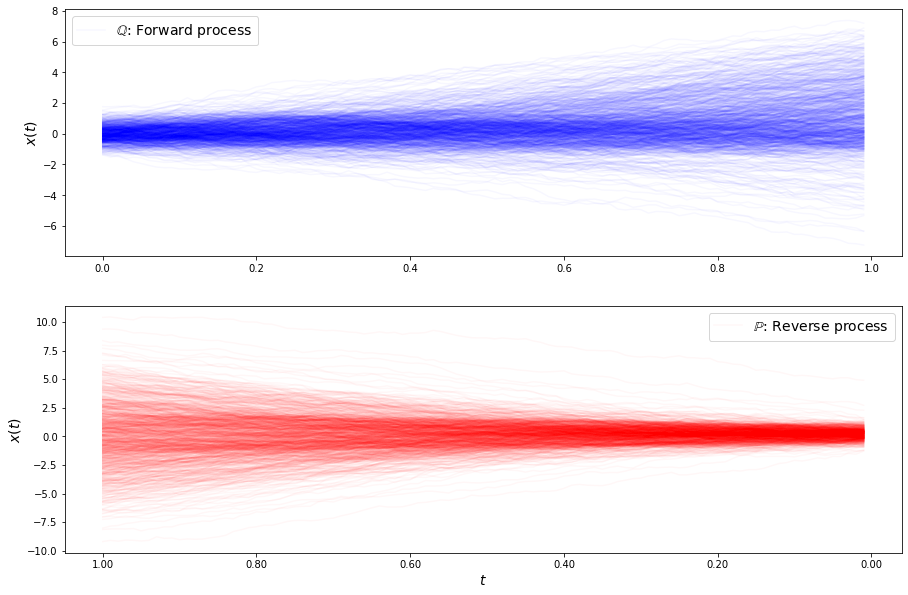

loss b 2.220115848282515
loss b 2.1413780860701106
loss b 2.1890891562885715
loss b 2.2106597885743713
loss b 2.450245626919296
loss b 2.2024442383258673
loss b 2.3297286996836135
loss b 2.127361507103377
loss b 2.2200950215100628
loss b 2.1277871265320254
loss b 2.2204442008556597
loss b 2.178965038586657
loss b 2.3577399979895546
loss b 2.0601071133948037
loss b 2.150608274100545
loss b 2.175499658619545
loss b 2.0775779772713383
loss b 2.1907901744727987
loss b 2.0923511298326316
loss b 2.1698949946324193
loss b 2.1918257177770752
loss b 2.153046607061752
loss b 2.0635114848919205
loss b 2.1763956008127607
loss b 2.0974071788339037
loss b 2.1220854109035066
loss b 2.2191289963872123
loss b 2.0195869864305096
loss b 2.194611657461713
loss b 2.0670895811765813
loss f 1.6250037988862036
loss f 1.4394664548082223
loss f 1.5844806378654532
loss f 1.5084497348390953
loss f 1.594476916214444
loss f 1.3385536556832787
loss f 1.515067520441106
loss f 1.7018673592727287
loss f 1.5911875048014

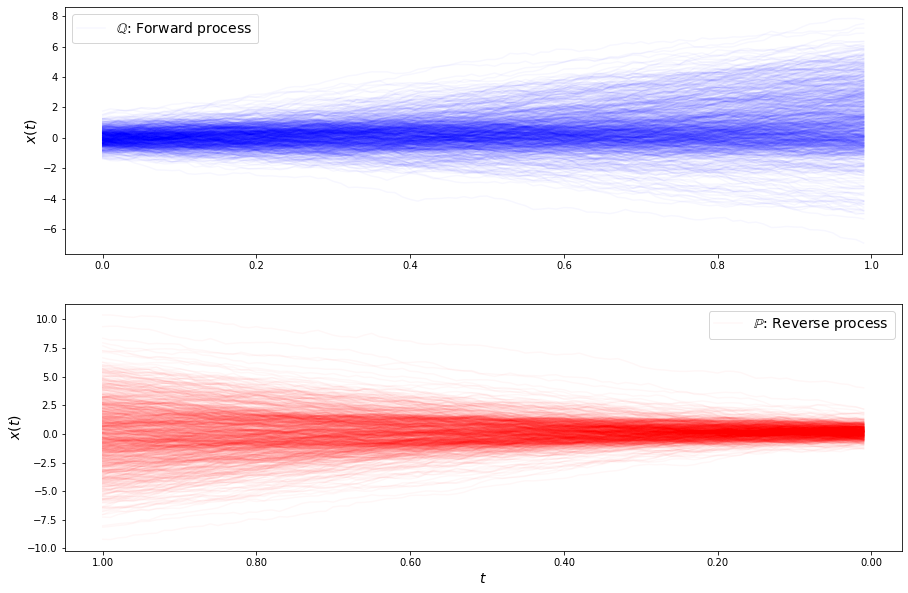

loss b 2.0565990793729356
loss b 1.9529998379720077
loss b 2.0455550932697646
loss b 2.007362629227341
loss b 2.0964138750009402
loss b 1.9790727161898258
loss b 2.0650571817186476
loss b 2.206261906590992
loss b 1.9665192803150715
loss b 2.039960586919892
loss b 1.9874150330067077
loss b 2.048715982151215
loss b 2.0494050561181973
loss b 1.9837120640598778
loss b 1.9911963321789607
loss b 1.8796804573064216
loss b 1.943165176782002
loss b 2.031145118713233
loss b 1.8246862452478985
loss b 2.019959777959841
loss b 1.9359616742327284
loss b 2.0776569888383625
loss b 1.9301733900718143
loss b 2.0893114205709247
loss b 2.0064227072050786
loss b 1.9894459489138647
loss b 1.8759749262531056
loss b 1.8563691902671016
loss b 2.0024857388401824
loss b 1.9343023991756922
loss f 1.317219309259229
loss f 1.488295849997599
loss f 1.4691502186986782
loss f 1.4012659073362206
loss f 1.334344339500551
loss f 1.4108657684471595
loss f 1.3638512780880165
loss f 1.3958865532442817
loss f 1.3513957010516

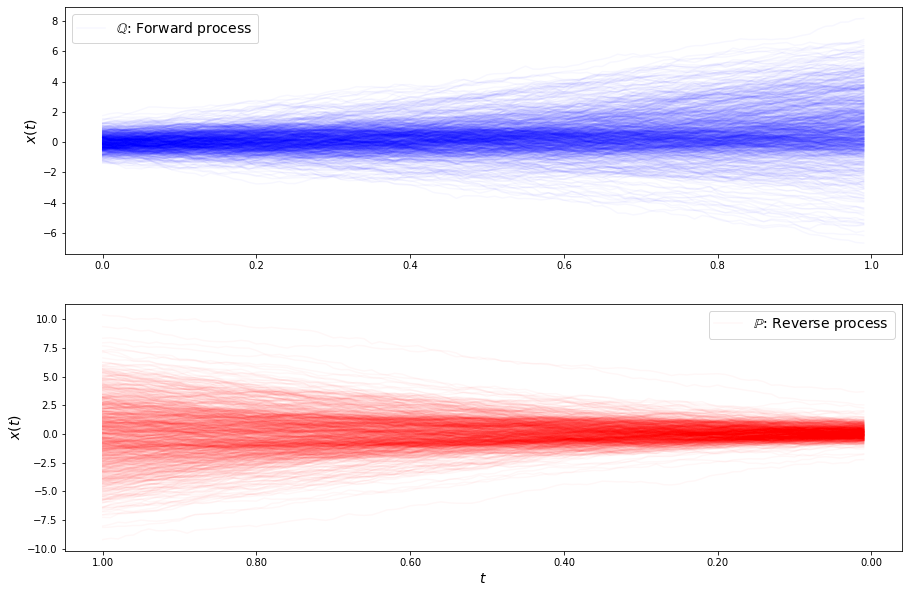

loss b 1.8577990150318286
loss b 1.7709162924890924
loss b 1.8009222967329759
loss b 1.946318982062111
loss b 1.9780663984740314
loss b 1.8287250655869745
loss b 1.9355579695762257
loss b 1.9207028832506368
loss b 1.826342605109024
loss b 1.7123299925465227
loss b 1.9237104327441397
loss b 1.688217939855873
loss b 1.7645366825564979
loss b 1.7387801683360444
loss b 1.765633223539167
loss b 1.8898535574458646
loss b 1.7079521967524225
loss b 1.8354980048654852
loss b 1.8731888200036104
loss b 1.7652410673767087
loss b 1.752407118423967
loss b 1.7375629973499538
loss b 1.798148106872854
loss b 2.059279945618296
loss b 1.8527909827696398
loss b 1.729986660554409
loss b 1.7895479267323768
loss b 1.7850230414456492
loss b 1.8812030235784007
loss b 1.7547794126411476
loss f 1.232816857402809
loss f 1.263031920043537
loss f 1.2353369263012814
loss f 1.3763425244071528
loss f 1.2599319577137111
loss f 1.2717446065136835
loss f 1.2706176299677925
loss f 1.2726236975228693
loss f 1.2029602730377

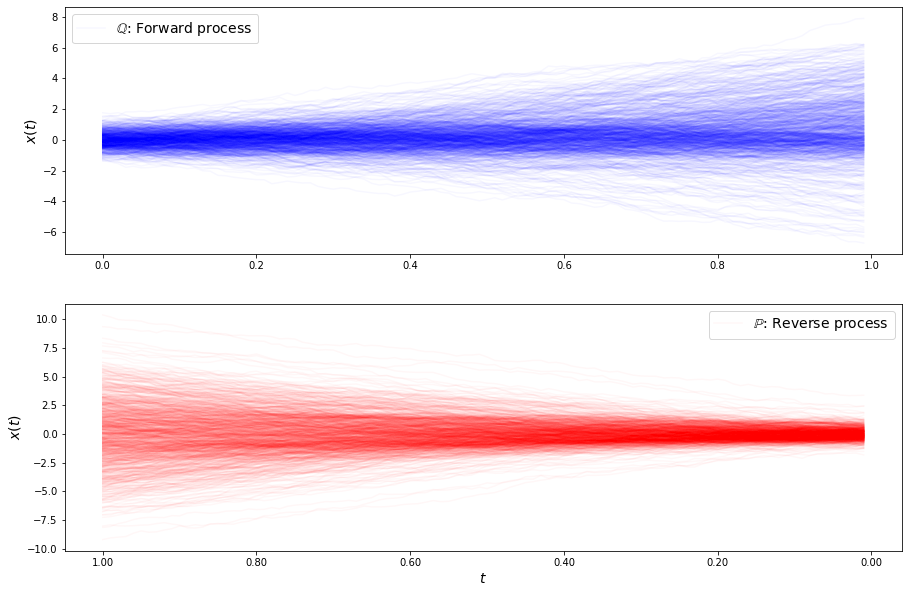

loss b 1.719523877763475
loss b 1.7653326189830647
loss b 1.8157306618826363
loss b 1.756733396656642
loss b 1.5822617574278
loss b 1.8225752150629666
loss b 1.6550111210551177
loss b 1.7747390224241495
loss b 1.631625595786199
loss b 1.56737487779084
loss b 1.6242190237171268
loss b 1.6287535531844646
loss b 1.6658714691271201
loss b 1.6818920449779742
loss b 1.5970038582308221
loss b 1.697065589903327
loss b 1.5225635862366416
loss b 1.5790525142720973
loss b 1.5659792659800649
loss b 1.768715494128883
loss b 1.7617823229182565
loss b 1.7659030966910825
loss b 1.6069909514885004
loss b 1.6331015555469
loss b 1.7083286064756806
loss b 1.6853800813700794
loss b 1.6704732621948204
loss b 1.643193267187176
loss b 1.6379196520002082
loss b 1.960975471859404
loss f 1.171502356919926
loss f 1.1571933675361838
loss f 1.040051287395021
loss f 1.0270320088028484
loss f 1.0865107741386746
loss f 1.1204038452541283
loss f 1.141492965844311
loss f 1.1129061916712437
loss f 1.2143754503151862
loss

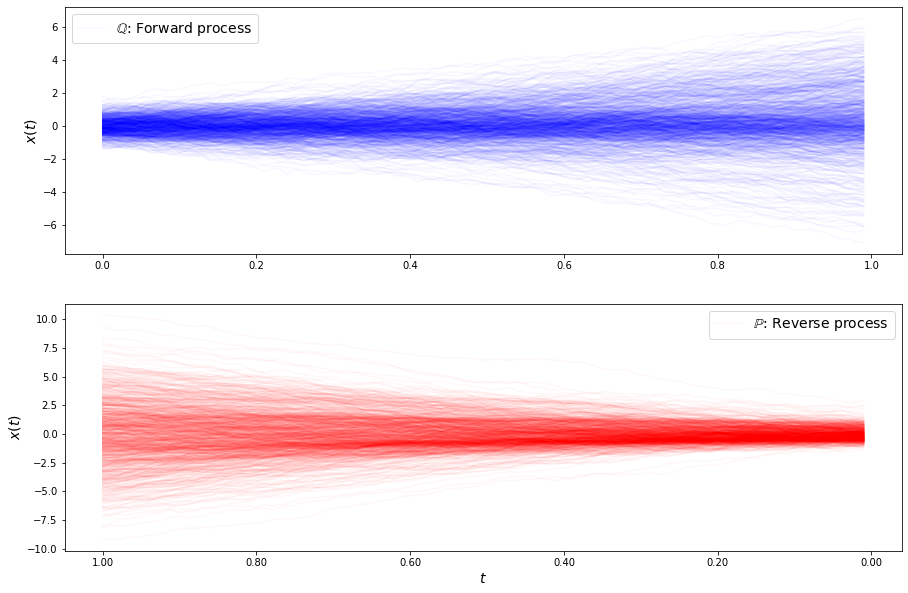

loss b 1.6578439029788463
loss b 1.7463283991606247
loss b 1.661767280922068
loss b 1.6070197691081654
loss b 1.498249322910975
loss b 1.483481976283301
loss b 1.6285723837026889
loss b 1.6327531653840675
loss b 1.4325965751881167
loss b 1.6195026643630552
loss b 1.619144802525333
loss b 1.4353072861974452
loss b 1.5463834456301175
loss b 1.5826195996066343
loss b 1.440301302549687
loss b 1.7205870431952808
loss b 1.7293915572901697
loss b 1.6787013978077412
loss b 1.5934851813361754
loss b 1.583914942858788
loss b 1.5435523239997255
loss b 1.680217569310632
loss b 1.5390140384646325
loss b 1.7670344239594997
loss b 1.6493365446438815
loss b 1.6126323026013447
loss b 1.3996807993791582
loss b 1.6676572989315448
loss b 1.5850226736506212
loss b 1.8898922055795089
loss f 1.2035499022857263
loss f 1.1641442165298606
loss f 1.1691484523574298
loss f 1.1172164198703929
loss f 1.0986595377772663
loss f 1.1242767069168431
loss f 1.0610351347734237
loss f 1.1373137316441297
loss f 1.0347897706

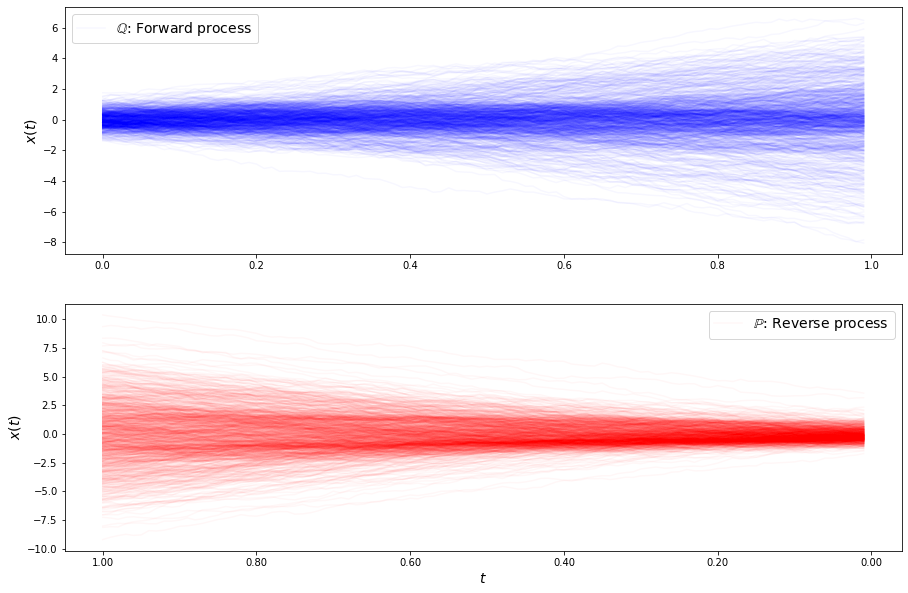

loss b 1.699205172240149
loss b 1.5503916297129996
loss b 1.6560982678991576
loss b 1.5786823561039787
loss b 1.5864490907139686
loss b 1.5438595040776935
loss b 1.5827354345654894
loss b 1.5947112001219037
loss b 1.5145521024305686
loss b 1.8544239802817781
loss b 1.6404206529196041
loss b 1.519360591303026
loss b 1.4646359099468693
loss b 1.6287059277875016
loss b 1.6224678461266901
loss b 1.6687502018180227
loss b 1.84190918997961
loss b 1.537117658135911
loss b 1.4826360427704213
loss b 1.5949171599112284
loss b 1.7543423624215797
loss b 1.5904062533080263
loss b 1.5530962677177116
loss b 1.4813268842181848
loss b 1.4608126583917722
loss b 1.498115497443685
loss b 1.5048003487430934
loss b 1.5599755236830462
loss b 1.6064063144170613
loss b 1.6784100464501972
loss f 1.1047873084746493
loss f 1.191253304839493
loss f 1.2235654044070494
loss f 1.1952660875375491
loss f 1.2260907022546883
loss f 1.180539355751231
loss f 1.2195599530951626
loss f 1.1510028489111261
loss f 1.22885520839

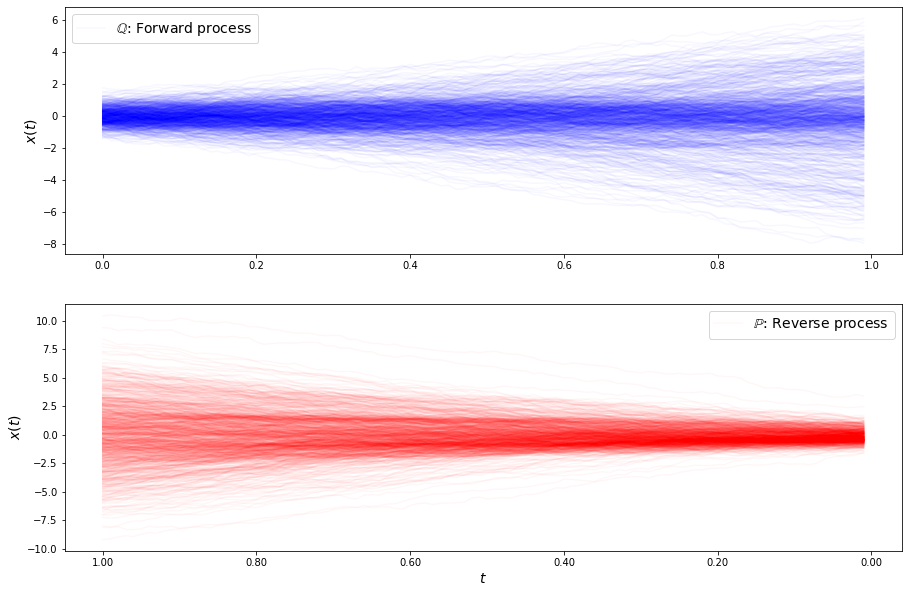

loss b 1.7369501083332193
loss b 1.6227403047012015
loss b 1.621960266067354
loss b 1.6720095753745623
loss b 1.538820887167783
loss b 1.7018627758545337
loss b 1.8128752195730782
loss b 1.7470875109389676
loss b 1.7027907962060909
loss b 1.680053975162862
loss b 1.6285477497446648
loss b 1.6314365051144055
loss b 1.5747787569521499
loss b 1.6729188906320749
loss b 1.5705352865174063
loss b 1.725901314763176
loss b 1.8698583394099377
loss b 1.7330476991938164
loss b 1.5828728933490046
loss b 1.9118484938269895
loss b 1.6320909425397656
loss b 1.8133042460336632
loss b 1.7989719669996571
loss b 1.7630654677435362
loss b 1.7560290494322919
loss b 1.806113247914656
loss b 1.747715958132317
loss b 1.9617820614257788
loss b 1.8116050974556077
loss b 1.7121751346629948
loss f 1.2825900239592152
loss f 1.2694186392639628
loss f 1.3927809685376624
loss f 1.3450622561615835
loss f 1.248852925786966
loss f 1.279335508792978
loss f 1.337761446661343
loss f 1.3177094975975354
loss f 1.259103096394

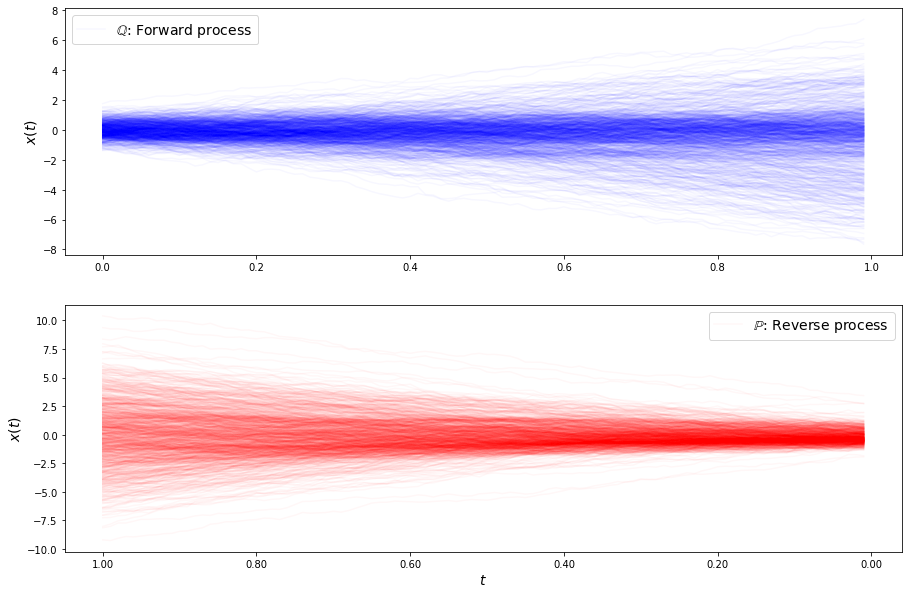

loss b 1.8973845898991748
loss b 1.8458390477960214
loss b 1.946223069192197
loss b 1.7225551231503635
loss b 1.8893404398654843
loss b 1.8359349340008426
loss b 1.7312551237502196
loss b 1.896983528294352
loss b 1.948653878011957
loss b 1.7864088600098573
loss b 2.049772643763197
loss b 1.7497108274173518
loss b 1.8762402739587503
loss b 1.8473252264120008
loss b 1.877149790143112
loss b 2.107177955720446
loss b 1.8737247838840785
loss b 1.8723273182313942
loss b 1.9179452194749225
loss b 1.8585962468963886
loss b 1.9344133135054833
loss b 1.8137059676622032
loss b 2.100401477004269
loss b 1.8807502984244813
loss b 1.8234519218804301
loss b 1.8476316471161487
loss b 2.131380700123146
loss b 1.9544510588856094
loss b 2.1629401366353647
loss b 1.8820844935274257
loss f 1.5166383412559377
loss f 1.4428850308854666
loss f 1.436077670750366
loss f 1.4293870247805387
loss f 1.5306174717051722
loss f 1.5381935532872293
loss f 1.5556564917380449
loss f 1.3613406614874353
loss f 1.452196343061

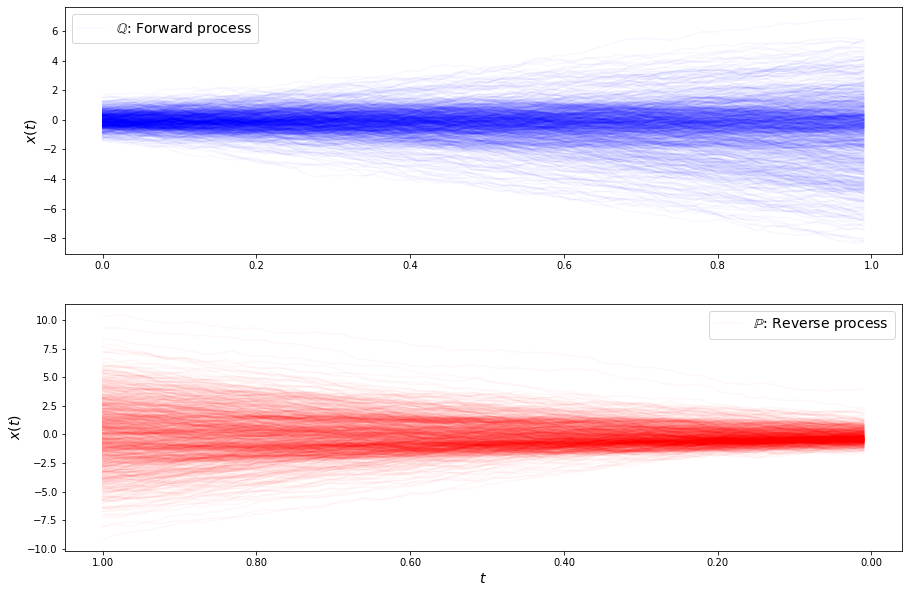

loss b 1.9691533773981467
loss b 2.1496453430041007
loss b 1.9793794843246586
loss b 2.010294828277893
loss b 2.1285663261653367
loss b 2.016192642562927
loss b 2.0586049394363073
loss b 2.04109877888268
loss b 1.9387484391014513
loss b 1.988721914089967
loss b 2.176583203819775
loss b 2.0659534265791026
loss b 2.125278108629671
loss b 2.0202884683238436
loss b 2.034023194053275
loss b 1.997853208418879
loss b 1.8675144440422657
loss b 2.2604506889662304
loss b 2.2484380576818603
loss b 2.1845235575543014
loss b 2.0831267552581165
loss b 2.0193972928841353
loss b 2.1637149521017895
loss b 2.0175560784848483
loss b 2.1035339319533435
loss b 2.1247915598054754
loss b 2.153471330197987
loss b 2.06115926684905
loss b 2.031506724782407
loss b 2.0609520909507313
loss f 1.6104450030075315
loss f 1.6864437563564603
loss f 1.452155125806145
loss f 1.513020182093695
loss f 1.6571689327773933
loss f 1.5239357233825863
loss f 1.6721282051268858
loss f 1.6178313850351072
loss f 1.5953829530209596
l

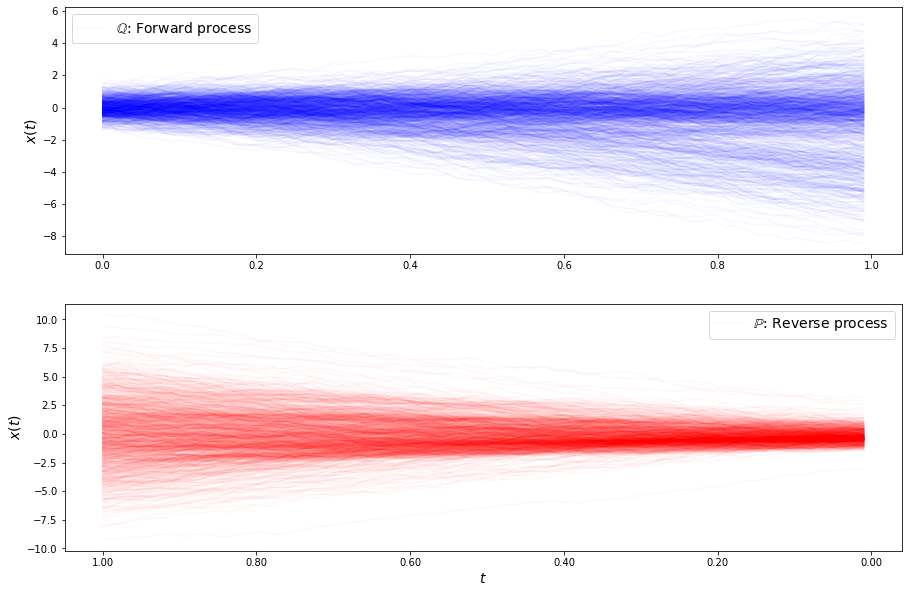

loss b 2.1784527370767415
loss b 2.0915318079747154
loss b 2.1049420794259426
loss b 2.3095230987617947
loss b 2.1662200964968674
loss b 2.0627146303892103
loss b 2.171982832593196
loss b 2.2858464005015944
loss b 2.0137969574811367
loss b 2.0666506608906103
loss b 2.047661834083916
loss b 2.0888681947301224
loss b 2.077500151980585
loss b 2.142838064342792
loss b 2.2162145751824127
loss b 1.9085274352802981
loss b 1.9159730908341523
loss b 1.9859426830206295
loss b 1.9460829861941258
loss b 2.1940468853969746
loss b 2.3092866818570297
loss b 2.1210808138732817
loss b 2.1244861268998902
loss b 2.121219881116554
loss b 2.32047306490831
loss b 2.082403441956352
loss b 2.0107105887634416
loss b 2.0375634252784853
loss b 2.26052740706689
loss b 2.0734202394010413
loss f 1.6031617116767298
loss f 1.6732032377220323
loss f 1.6609924210161666
loss f 1.7327813550837676
loss f 1.768410348214718
loss f 1.5592888361428816
loss f 1.583437361277102
loss f 1.628956884191653
loss f 1.584311354935231


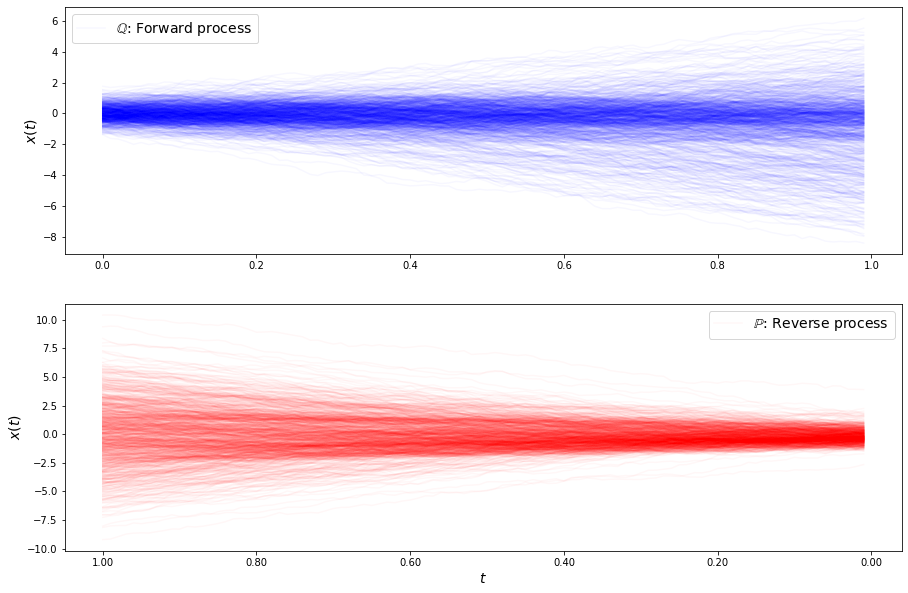

loss b 2.164387756400233
loss b 2.3332775359034423
loss b 2.189615947297134
loss b 2.08708478699914
loss b 2.095438467222579
loss b 2.1107942255559387
loss b 2.1508284841048395
loss b 2.1554332163056147
loss b 2.108765490369936
loss b 1.9545297917470779
loss b 2.1145383308882177
loss b 2.163880811678085
loss b 2.2098274729027043
loss b 2.2037912468148693
loss b 2.1143199403170763
loss b 2.172895830425531
loss b 2.034189189753301
loss b 2.0240708137960954
loss b 2.0349883524702626
loss b 2.1690394162538422
loss b 1.9950875588469632
loss b 2.0819253461619738
loss b 1.9761781927898097
loss b 2.062828843954149
loss b 2.08209565346536
loss b 2.086145183994987
loss b 2.109854869935882
loss b 1.9841740733614923
loss b 2.102467383130948
loss b 1.938642040627659
loss f 1.5214774999300757
loss f 1.487566074153782
loss f 1.4781722216669764
loss f 1.46725112111849
loss f 1.510386820744511
loss f 1.5689150949919466
loss f 1.5369567483754205
loss f 1.5465911505631387
loss f 1.5385643549889136
loss f

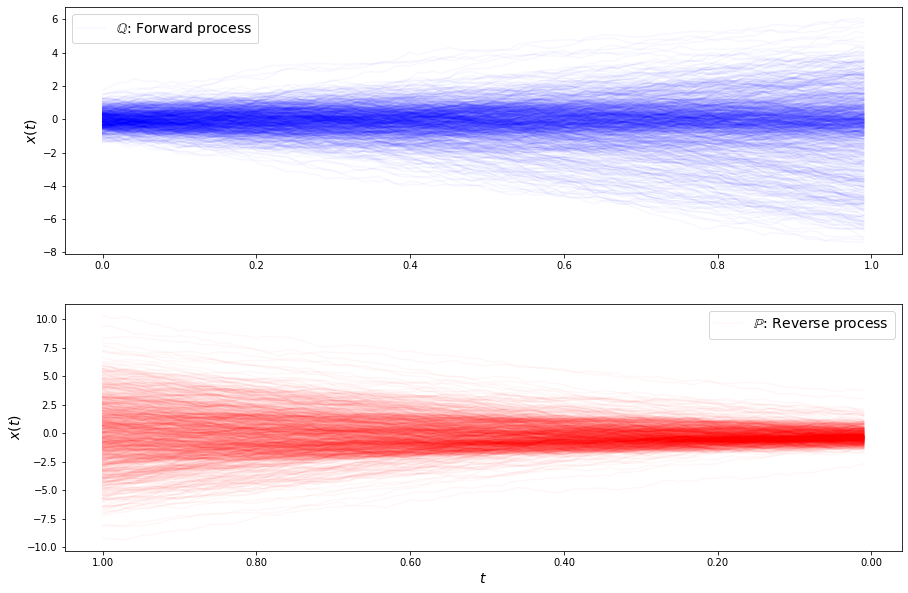

loss b 2.0665280421474823
loss b 1.9899048042171468
loss b 1.9470848833186296
loss b 2.0365354632500954
loss b 2.1189466506836667
loss b 1.9920682546512578
loss b 1.9055197270337054
loss b 2.1906963016365086
loss b 2.0258364925948005
loss b 2.127583660830986
loss b 2.109884437147385
loss b 1.9380213480091784
loss b 2.103494249190122
loss b 1.9446103516990891
loss b 2.033827449678637
loss b 2.0731720098968105
loss b 2.020500071381428
loss b 2.0662239457265965
loss b 1.895095298367315
loss b 2.0075647313880958
loss b 1.9766275547920085
loss b 1.9086898061820725
loss b 1.9368249124245553
loss b 1.9424618626076906
loss b 1.9548581764199067
loss b 1.9212346035929324
loss b 1.8574696034567242
loss b 2.033543042998487
loss b 1.9088192603351273
loss b 1.9777522884025747
loss f 1.3237003271021326
loss f 1.2992145089531217
loss f 1.4025550240245594
loss f 1.3153062073435142
loss f 1.3608174239107544
loss f 1.4577444102989328
loss f 1.4500784533247488
loss f 1.3555074966827092
loss f 1.3578436859

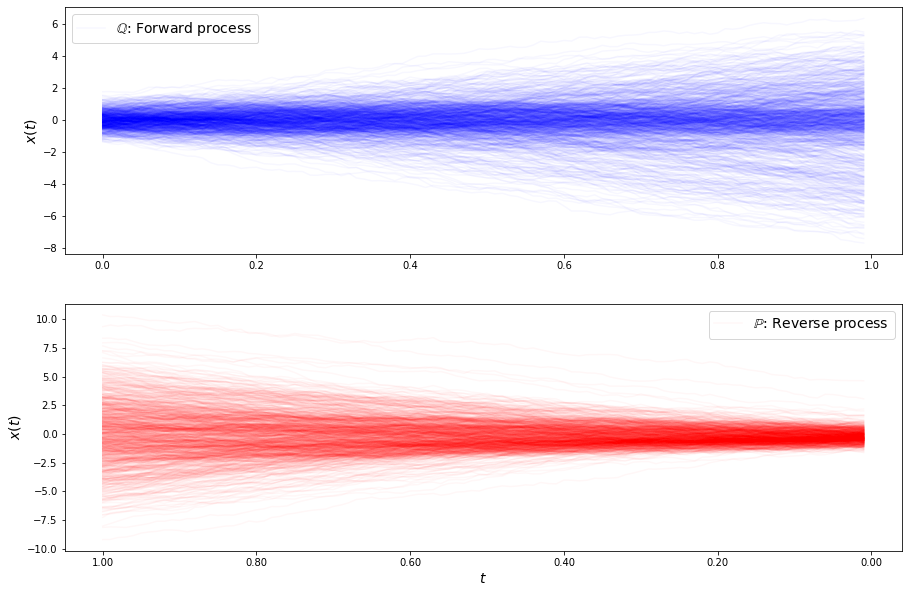

loss b 1.7233806823868407
loss b 1.8393657349480346
loss b 1.7525320030373992
loss b 1.7622780192961514
loss b 1.7042473758011132
loss b 1.9463898941288915
loss b 1.7282964482366527
loss b 1.76757233529618
loss b 1.8595896940928538
loss b 1.8468104521210742
loss b 1.6913234848067769
loss b 1.7083491874218002
loss b 1.8255227443227449
loss b 1.8769056435101326
loss b 1.7933157340822843
loss b 1.7770351884217788
loss b 1.6356284862689796
loss b 1.858859733283189
loss b 1.876757763901579
loss b 1.8065369922671726
loss b 1.8759800472360544
loss b 1.872380114561901
loss b 1.7834390398216646
loss b 1.701010727520883
loss b 1.6959000440673098
loss b 1.8098146190808782
loss b 1.7374530551201655
loss b 1.7006181461758028
loss b 1.8632312973855973
loss b 1.7631231622868007
loss f 1.2551322745761744
loss f 1.3059549323670216
loss f 1.2485545531015427
loss f 1.2880886242429583
loss f 1.1434167695797532
loss f 1.3127383078049568
loss f 1.1953230863662312
loss f 1.3584293135834393
loss f 1.224715631

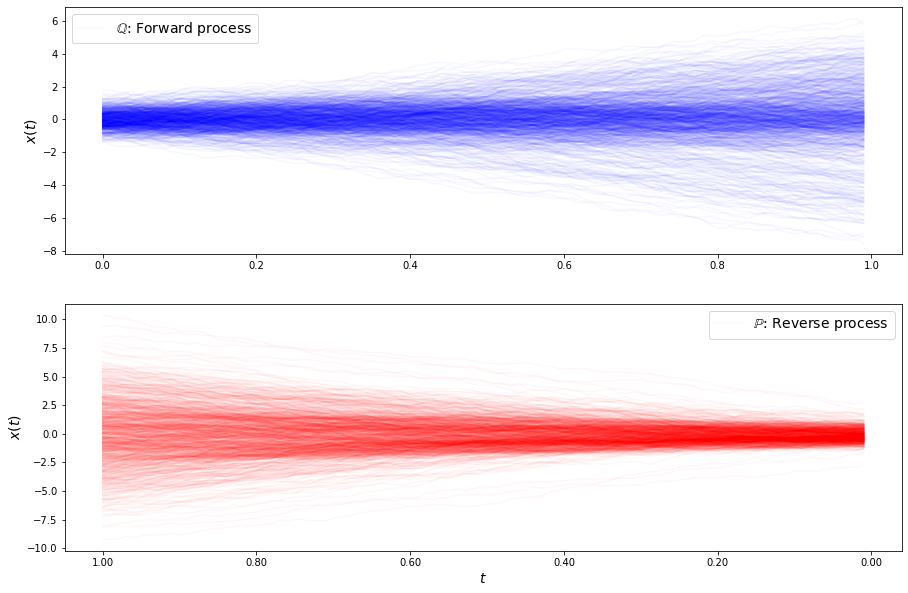

loss b 1.6076120915270853
loss b 1.7511610422921318
loss b 1.5102857751295022
loss b 1.8716555231130323
loss b 1.5792645198830288
loss b 1.6828273235087592
loss b 1.6027451872473164
loss b 1.7915394583887048
loss b 1.6094857758931087
loss b 1.5127204675786727
loss b 1.756496317252258
loss b 1.555274194131957
loss b 1.6179931844363293
loss b 1.7491771538592977
loss b 1.7127611067624053
loss b 1.659381439869942
loss b 1.6010298471328648
loss b 1.8209203669896579
loss b 1.5636673427967247
loss b 1.5485465732363106
loss b 1.6692981432824674
loss b 1.6871919866405136
loss b 1.5109974424517933
loss b 1.687676524633854
loss b 1.7306616023560597
loss b 1.755343614199227
loss b 1.4827823290514763
loss b 1.6390308422508866
loss b 1.5942075406174934
loss b 1.7027338995213799
loss f 1.2092950520981964
loss f 1.152715396257776
loss f 1.229509337998716
loss f 1.1957139152999832
loss f 1.1537306127296654
loss f 1.0829970888555775
loss f 1.1231780318219269
loss f 1.157288440452245
loss f 1.16098702509

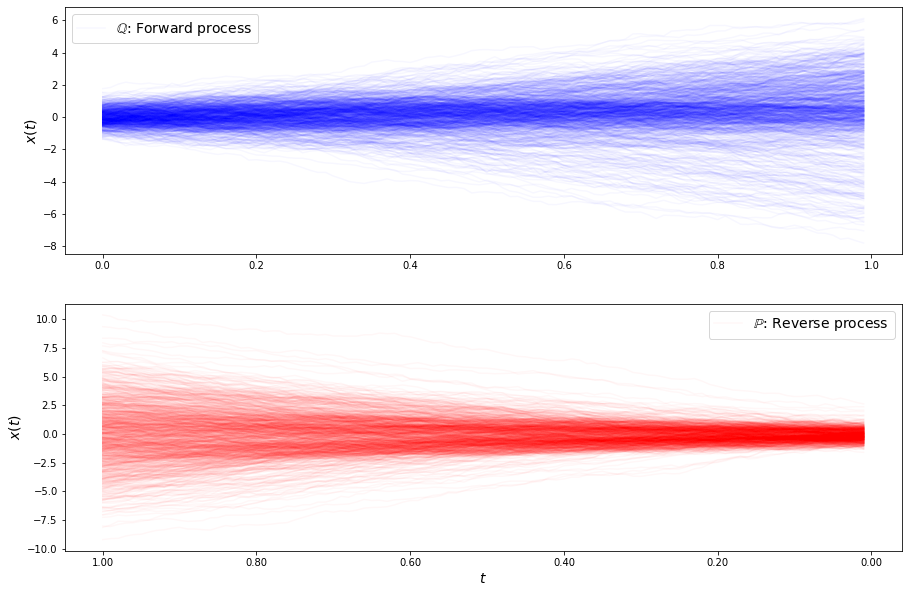

loss b 1.5832970008208793
loss b 1.4893818290603456
loss b 1.6166706243631197
loss b 1.5176293641531315
loss b 1.5994994270288112
loss b 1.6000275066384073
loss b 1.6982009590360991
loss b 1.7009578011104742
loss b 1.5489600193327144
loss b 1.6409347747222478
loss b 1.5790554411996396
loss b 1.6270776987548021
loss b 1.6858838819828388
loss b 1.6589435488348505
loss b 1.6040091514859591
loss b 1.5887742617355347
loss b 1.7507046349609805
loss b 1.505676172423642
loss b 1.600546055488272
loss b 1.5897210061730946
loss b 1.622900835056941
loss b 1.527959406279076
loss b 1.7595291398318438
loss b 1.7177447892508204
loss b 1.5616876214690263
loss b 1.5771317974821946
loss b 1.6352347779835463
loss b 1.5423721356888718
loss b 1.6337350303167673
loss b 1.4597379431651123
loss f 1.2588777603315653
loss f 1.1900738894768168
loss f 1.1106399831684632
loss f 1.3018318996512754
loss f 1.2182174275781168
loss f 1.208284532698986
loss f 1.188312451233627
loss f 1.1191114240102578
loss f 1.195131267

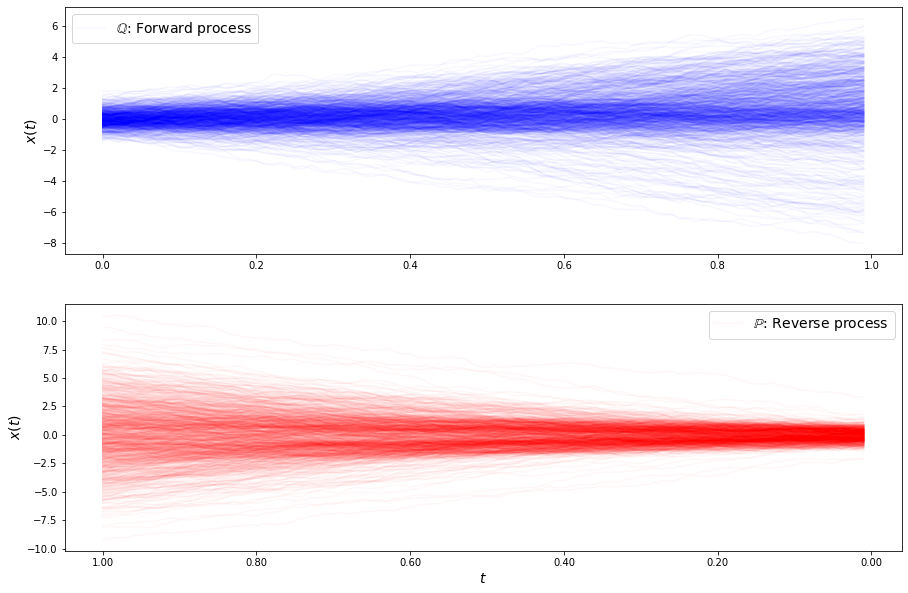

loss b 1.595022790248679
loss b 1.7476617851089036
loss b 1.6512191770229245
loss b 1.5767478571999118
loss b 1.5337172534712178
loss b 1.6189007117748562
loss b 1.6987506991990566
loss b 1.664983252666224
loss b 1.5745742053319671
loss b 1.579918423563053
loss b 1.5855919486515586
loss b 1.69767990564626
loss b 1.6321015419258582
loss b 1.6654497187018473
loss b 1.5979650898020685
loss b 1.5887507382140376
loss b 1.7056705275192052
loss b 1.6047226543463124
loss b 1.545069635833369
loss b 1.6027154802752166
loss b 1.6400089873550758
loss b 1.7003669262695564
loss b 1.6281071278146442
loss b 1.5498708475176963
loss b 1.657306676192619
loss b 1.691023379275472
loss b 1.5120141705276002
loss b 1.7131732730390814
loss b 1.5810425729048492
loss b 1.580672350431159
loss f 1.2252366430812724
loss f 1.3576923222877668
loss f 1.286072293482825
loss f 1.2293553253130463
loss f 1.2548857766656518
loss f 1.3525038137917849
loss f 1.2770028511894975
loss f 1.2697369105052667
loss f 1.2692042997291

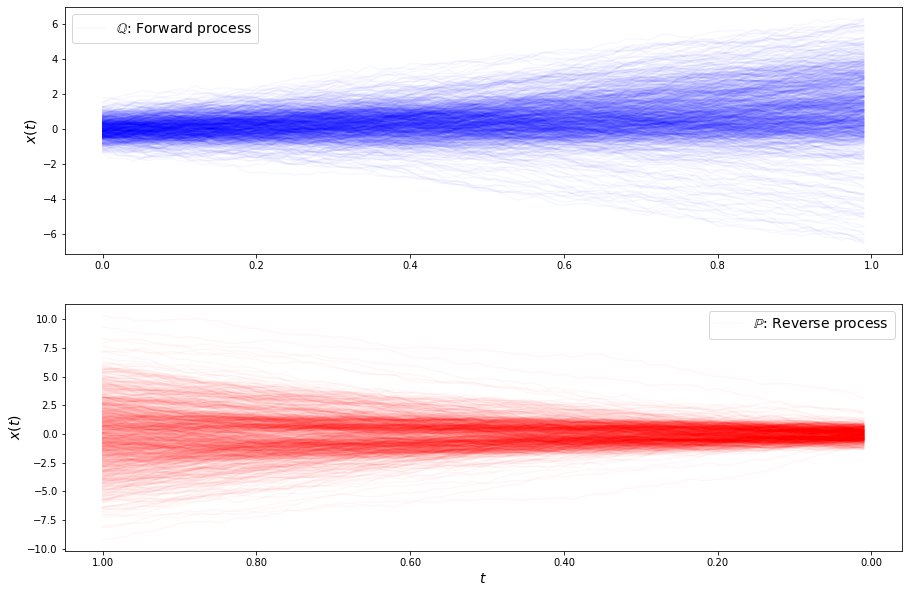

loss b 1.6487268948271872
loss b 1.7509738573082416
loss b 1.8002251818049386
loss b 1.7104238747326324
loss b 1.7981253796933532
loss b 1.7088863277283053
loss b 1.6990719716992682
loss b 1.7567083700793755
loss b 1.7496943950504942
loss b 1.718908279449294
loss b 1.6648066489196287
loss b 1.8935678654273747
loss b 1.7283175952637206
loss b 1.7192495775194834
loss b 1.7793056293737357
loss b 1.7973854433554723
loss b 1.769368797245712
loss b 1.7544595912334617
loss b 1.8420885387117845
loss b 1.7771269210294536
loss b 1.7006548125675993
loss b 1.790848450930568
loss b 1.7788664897927124
loss b 1.7438388891756136
loss b 1.7265532084970647
loss b 1.8101395507907208
loss b 1.7318280202915335
loss b 1.7458160642747433
loss b 1.8003294870729563
loss b 1.7476220486560947
loss f 1.431832087753618
loss f 1.4759459205709213
loss f 1.449385039200528
loss f 1.4572556047457297
loss f 1.2953507076440154
loss f 1.440268467208656
loss f 1.5172778585662479
loss f 1.475531422348105
loss f 1.4192959274

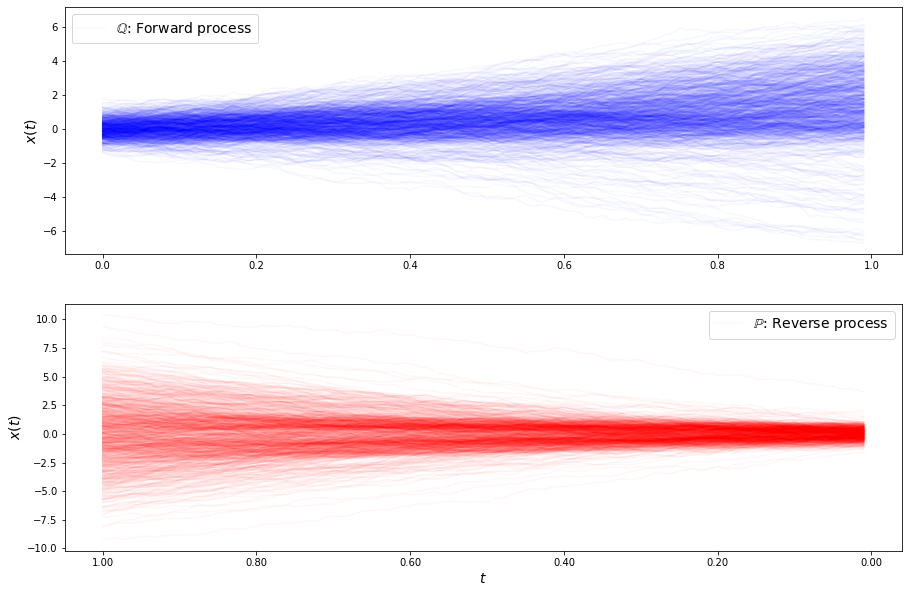

loss b 1.9359873623350734
loss b 1.9304618152863755
loss b 1.9346518038530955
loss b 1.8891940928178126
loss b 1.95818413469191
loss b 1.9092390695940555
loss b 1.8937040604366229
loss b 1.9074514541304584
loss b 1.9664632548409708
loss b 1.9499883271876055
loss b 1.9537778376857042
loss b 1.9694759061429217
loss b 1.8969607373900792
loss b 1.906070701189211
loss b 1.862724030310361
loss b 2.023622618677624
loss b 1.9649925838002844
loss b 1.948149478926755
loss b 1.9105624813235087
loss b 1.8496862730618726
loss b 1.9405506742591738
loss b 2.0004687908715737
loss b 1.835434730868038
loss b 1.863498617959952
loss b 1.9391646674000453
loss b 2.063311766864395
loss b 1.9158863311622492
loss b 1.9889372186403753
loss b 1.9603553671725307
loss b 1.8156716983015717
loss f 1.5455843122474402
loss f 1.4673084409536048
loss f 1.5623058265798666
loss f 1.6109650214312368
loss f 1.5269146441369372
loss f 1.7232345756701049
loss f 1.5786576775360122
loss f 1.6238357710399505
loss f 1.538513115520

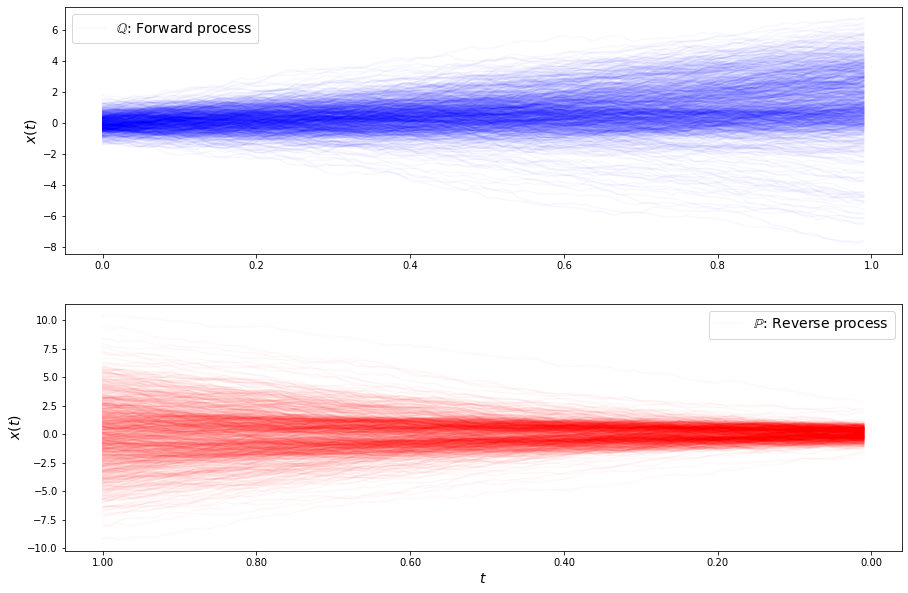

loss b 2.037788506599932
loss b 1.9189576649285025
loss b 2.0800671822985635
loss b 1.9827290501424715
loss b 1.981362841679284
loss b 2.072180303075969
loss b 1.8938330723680934
loss b 2.0961331184713687
loss b 1.935044923231837
loss b 2.0603828223679526
loss b 2.0479580045785504
loss b 1.95508585420217
loss b 2.106151964693233
loss b 2.06381602449543
loss b 2.0753734035082587
loss b 1.9702568901640551
loss b 2.0463499526673457
loss b 1.959199361531292
loss b 1.9421685817284615
loss b 1.9637191005403731
loss b 1.999866819667693
loss b 1.979949885576094
loss b 1.9479512351704475
loss b 1.9660016229697685
loss b 2.001732720937738
loss b 2.1447931796231887
loss b 2.0360114284872717
loss b 2.084696929900739
loss b 2.050835803510374
loss b 1.991376855531895
loss f 1.5808737810570355
loss f 1.6072692000751592
loss f 1.6337764717076186
loss f 1.7253505795218
loss f 1.71240968992886
loss f 1.66719817920358
loss f 1.7784132402953892
loss f 1.6545770902768133
loss f 1.5976882507160615
loss f 1.

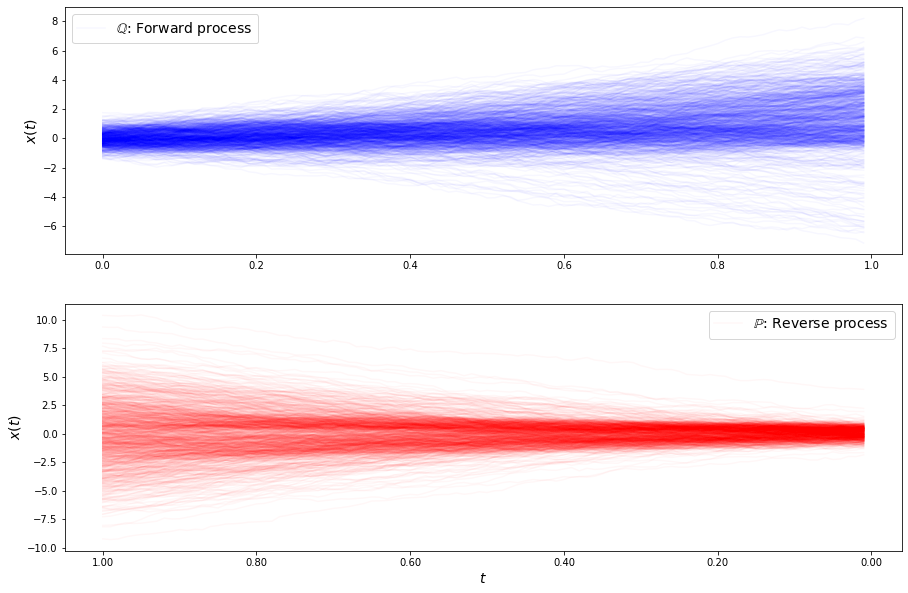

loss b 1.9600663254610804
loss b 1.8993017967281698
loss b 1.9767201330553645
loss b 1.8959801080154248
loss b 2.2903072663330155
loss b 2.045708035388431
loss b 2.0849505745532206
loss b 2.010575190036809
loss b 2.040303633697557
loss b 2.05064861193678
loss b 1.9813848761454183
loss b 2.167900303751113
loss b 1.9909277448700187
loss b 1.8559079752215426
loss b 1.990666869878373
loss b 2.1499251330814895
loss b 2.0393601190708694
loss b 2.0211096111882068
loss b 1.916844260578265
loss b 2.026038098191374
loss b 2.062837375969951
loss b 1.8670121704295861
loss b 2.1971050282117544
loss b 2.0261691330328873
loss b 2.0383435062373723
loss b 1.932257804807839
loss b 2.1945641618724263
loss b 2.0437688216666876
loss b 2.0696438008494242
loss b 2.0530164104180435
loss f 1.726411054615824
loss f 1.7208051072916377
loss f 1.5729602307800057
loss f 1.5975529910521313
loss f 1.5458765759458732
loss f 1.5669580838770256
loss f 1.6140528397248228
loss f 1.6321088233262104
loss f 1.599175117267239

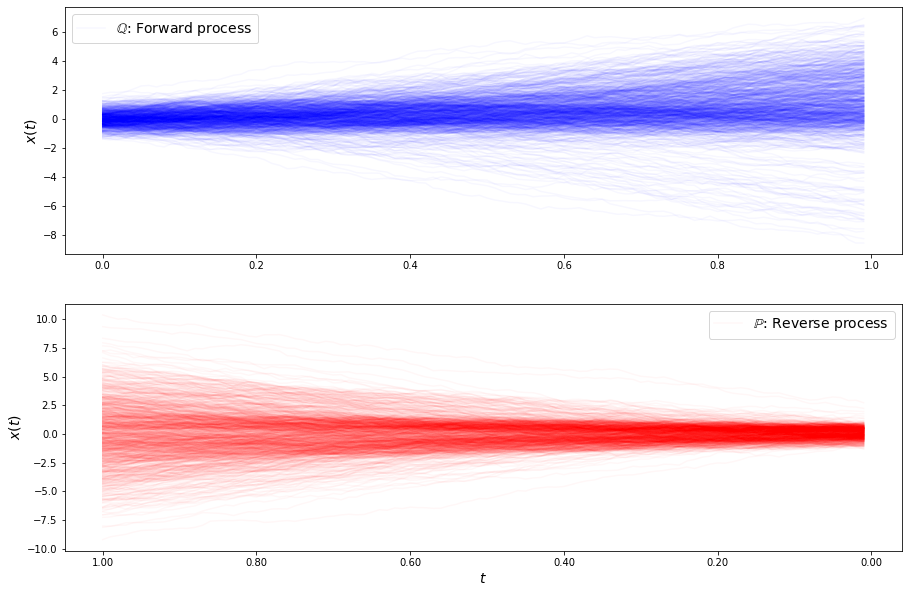

loss b 1.925785092709628
loss b 1.9100718237444545
loss b 1.8776146525878217
loss b 1.8950956548937492
loss b 1.967446681272287
loss b 1.9069908700596663
loss b 2.019418051277992
loss b 1.9585576864870524
loss b 1.8943349570469261
loss b 1.9428229153375873
loss b 2.01909393481608
loss b 1.9722525279983654
loss b 1.9262286150953203
loss b 1.9517423688012365
loss b 1.894978909476768
loss b 2.0336636601739255
loss b 1.865897993704557
loss b 1.9076775147893108
loss b 1.915698145753139
loss b 1.8029603951278026
loss b 1.929313468855848
loss b 1.9405796047125974
loss b 2.176868172237481
loss b 2.0170154996901593
loss b 1.8447028857662005
loss b 2.0480027253889914
loss b 1.9615431164899926
loss b 1.9010422578406365
loss b 1.8648101286980545
loss b 1.966672937776568
loss f 1.5859032632038605
loss f 1.5983594249504571
loss f 1.5702148124960795
loss f 1.5997353342014198
loss f 1.6191055002948456
loss f 1.3950150878795762
loss f 1.5320466835880586
loss f 1.5343675335165692
loss f 1.58531516528348

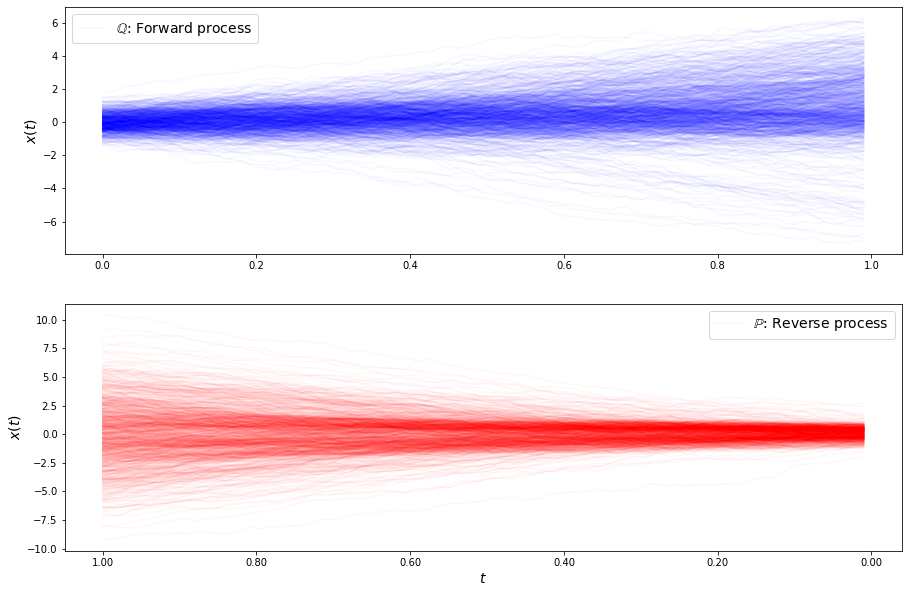

loss b 1.842762149573954
loss b 1.796011933805017
loss b 1.7076300841791638
loss b 1.7653330036353143
loss b 1.7905616827958772
loss b 1.8723168695020864
loss b 1.7306085103122033
loss b 1.7757821997882404
loss b 1.6354588828644545
loss b 1.7539877862085624
loss b 1.9391463693347426
loss b 1.7177261450715806
loss b 1.794584550259224
loss b 1.9050965964822606
loss b 1.6953685148228095
loss b 1.8547423102617293
loss b 1.6653146011291906
loss b 1.8232369896424774
loss b 1.7201465745187705
loss b 1.7187180336405394
loss b 1.5954513360214204
loss b 1.7619649323245719
loss b 1.7271330300879797
loss b 1.7729852725498043
loss b 1.7987110206651227
loss b 1.8226751467294355
loss b 1.773471963544905
loss b 1.7928201231659378
loss b 1.8351881004460637
loss b 1.8776666136338809
loss f 1.491514641343069
loss f 1.5431354525770373
loss f 1.4085744404032532
loss f 1.5070293873210296
loss f 1.371487004910908
loss f 1.433800743723399
loss f 1.3062535767980423
loss f 1.3664176892780577
loss f 1.3318436938

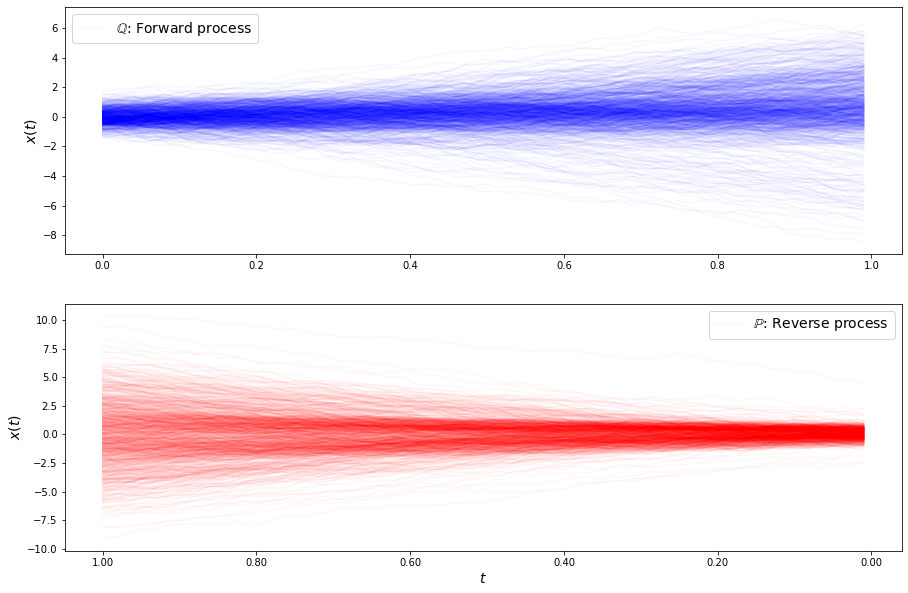

loss b 1.6747910296721729
loss b 1.844466392338242
loss b 1.6472850334581361
loss b 1.6664453000317045
loss b 1.5480809722924385
loss b 1.579840728492208
loss b 1.7242286867078196
loss b 1.6648746680589799
loss b 1.690155434164045
loss b 1.6653122759222598
loss b 1.6317341325728414
loss b 1.6958089153101217
loss b 1.621112529397183
loss b 1.744505191330859
loss b 1.6600143392801017
loss b 1.632122586479729
loss b 1.534341579792734
loss b 1.5826422635858979
loss b 1.5473616621435033
loss b 1.9619285987176236
loss b 1.705226400634593
loss b 1.640428846758496
loss b 1.6577094002190615
loss b 1.6845020297539848
loss b 1.6728154937918702
loss b 1.6375602128992672
loss b 1.5948058959234204
loss b 1.6845996995421877
loss b 1.7164329432013758
loss b 1.6183554167944716
loss f 1.3924170421563262
loss f 1.2359840488835159
loss f 1.3514063841951929
loss f 1.2851704288916148
loss f 1.2206673674564728
loss f 1.270685246459885
loss f 1.2439343267898852
loss f 1.3183906008278634
loss f 1.0922929061063

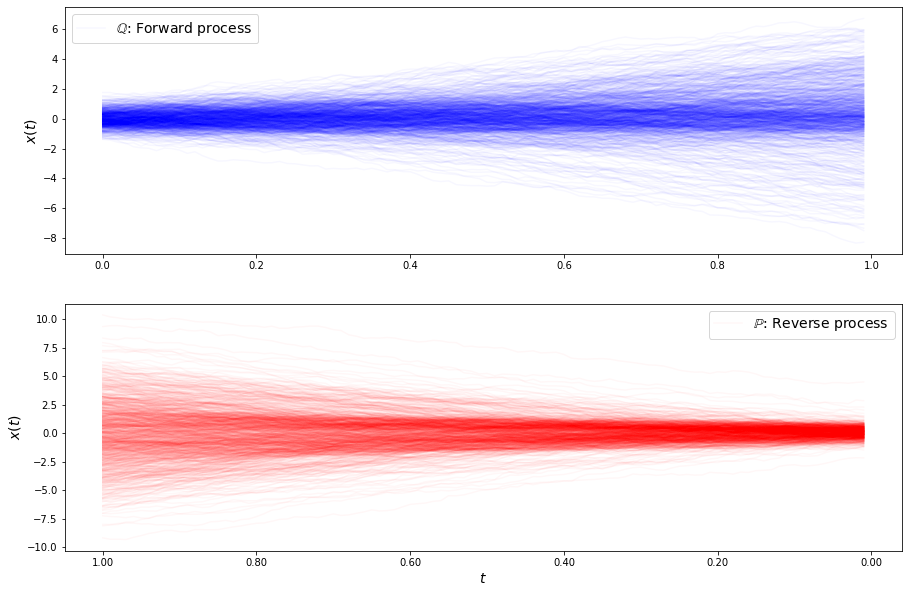

loss b 1.4364764285389804
loss b 1.584733203200564
loss b 1.8025848422692503
loss b 1.5432353142568278
loss b 1.4638486430678144
loss b 1.7002938298024666
loss b 1.7268077546796754
loss b 1.5337592342323543
loss b 1.5954082658560433
loss b 1.6030851848310572
loss b 1.563083101692555
loss b 1.474697373277259
loss b 1.6180794426790408
loss b 1.4217528121710348
loss b 1.5115081893383702
loss b 1.4217881705313726
loss b 1.6173637824303904
loss b 1.5372193786866293
loss b 1.4816945374539758
loss b 1.4691449781191088
loss b 1.5472786844064128
loss b 1.4590708295114247
loss b 1.4020500567410115
loss b 1.5680726618588965
loss b 1.4871939901669422
loss b 1.5914761557468309
loss b 1.4377896315290457
loss b 1.5119946419500896
loss b 1.519994508626299
loss b 1.5823975063473978
loss f 1.1037050315051449
loss f 1.164007674684211
loss f 1.1897867202321635
loss f 1.2208032565319156
loss f 1.26000423814196
loss f 1.1965863337792593
loss f 1.1921618005393197
loss f 1.094338804353645
loss f 1.13455453544

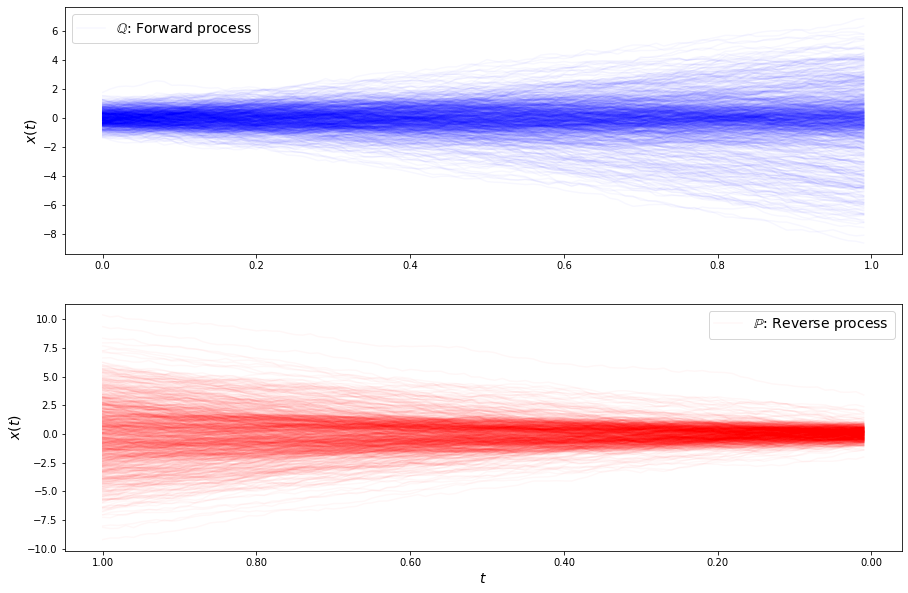

loss b 1.6475964515147452
loss b 1.6897086924361877
loss b 1.5856001621472307
loss b 1.5773125373229229
loss b 1.4942803260328337
loss b 1.4378459514144097
loss b 1.4516759028099158
loss b 1.4326193675817407
loss b 1.273948034444985
loss b 1.3352591694111473
loss b 1.3993216159979145
loss b 1.5606181049301837
loss b 1.391296813884526
loss b 1.520353960838573
loss b 1.5534923666086755
loss b 1.5695864907325126
loss b 1.4767501555365175
loss b 1.5924872914354669
loss b 1.4349768214677947
loss b 1.5775522572739193
loss b 1.4146813157294575
loss b 1.2176367082388024
loss b 1.3295589842873483
loss b 1.346423847274838
loss b 1.4077289309176555
loss b 1.4500663211692055
loss b 1.4161297188427393
loss b 1.3906477259522694
loss b 1.4171840377129463
loss b 1.3916567919067095
loss f 1.1155404853417772
loss f 1.2373069859409633
loss f 1.2207771083706314
loss f 1.0312085521988381
loss f 1.0631390922296147
loss f 1.1603197721218876
loss f 1.1970260000582527
loss f 1.2959384038894797
loss f 1.0436616

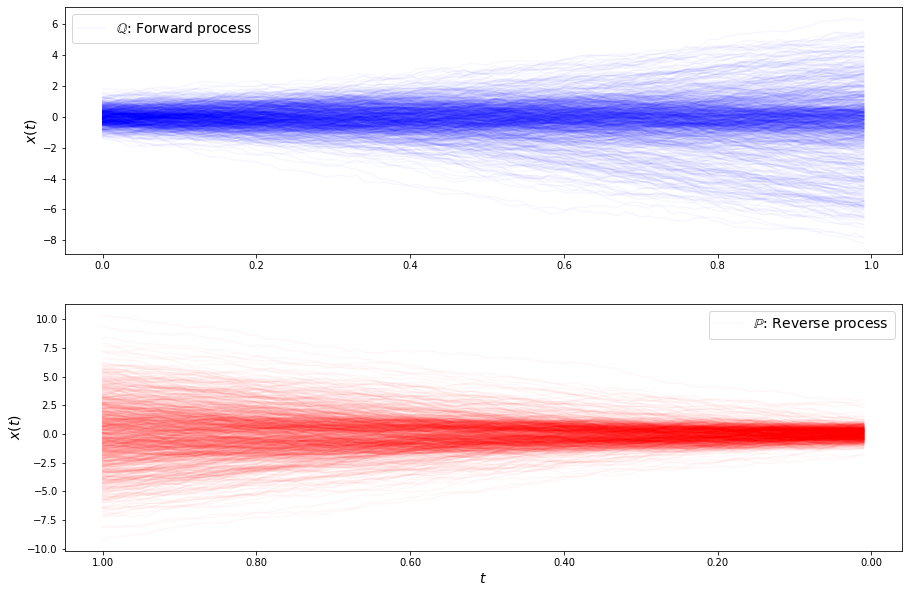

loss b 1.6175672419950982
loss b 1.4530629548597718
loss b 1.6532959623116148
loss b 1.6460391821594558
loss b 1.442053526846939
loss b 1.4387045869850605
loss b 1.3478997485953395
loss b 1.4022370315939205
loss b 1.417588979271755
loss b 1.4575895235467844
loss b 1.5429875210634627
loss b 1.3740003663038804
loss b 1.5061087691573538
loss b 1.5066901418540923
loss b 1.4994255328848163
loss b 1.42257565539652
loss b 1.4335224484461733
loss b 1.5212406519776103
loss b 1.4321820207584328
loss b 1.6163501290417235
loss b 1.4180072721171164
loss b 1.4476262094603103
loss b 1.3221215202677201
loss b 1.6872984012321486
loss b 1.599785545647145
loss b 1.5067755356200887
loss b 1.5210161995512816
loss b 1.5900064084408108
loss b 1.605169455562259
loss b 1.4344033803957486
loss f 1.0602870834548892
loss f 1.1442042853372143
loss f 1.2010321094578416
loss f 1.1456911710690851
loss f 1.1095529734222018
loss f 1.1444787299789851
loss f 1.1068784086537562
loss f 1.1517778074853342
loss f 1.097186445

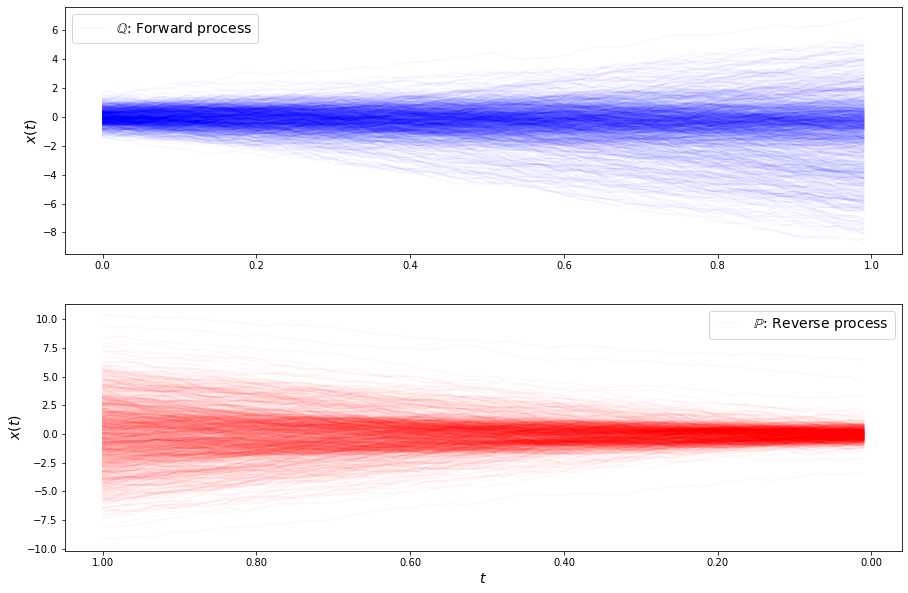

loss b 1.6212778180492076
loss b 1.6467315131365006
loss b 1.551466360903591
loss b 1.5766951373496656
loss b 1.592542708236793
loss b 1.5781306681838387
loss b 1.6610517122868471
loss b 1.5250172854219253
loss b 1.5479171230931537
loss b 1.3997676348891213
loss b 1.4554768534198654
loss b 1.6099107612855932
loss b 1.5629329984424372
loss b 1.5615703633231917
loss b 1.4364303036481605
loss b 1.6509166127140127
loss b 1.576526965906315
loss b 1.4631788997407644
loss b 1.6586028407979063
loss b 1.561405849394457
loss b 1.5163392909401572
loss b 1.5053781007332798
loss b 1.4152208146005991
loss b 1.5556774257161359
loss b 1.6459164768330976
loss b 1.5579090289719646
loss b 1.5348173839889696
loss b 1.495858864047252
loss b 1.4227329478285833
loss b 1.523849333608606
loss f 1.1327864805840329
loss f 1.363018939222141
loss f 1.1617090359302698
loss f 1.2833456174902027
loss f 1.2679112291615688
loss f 1.2670396677348799
loss f 1.332669419216488
loss f 1.171589229008096
loss f 1.244941190307

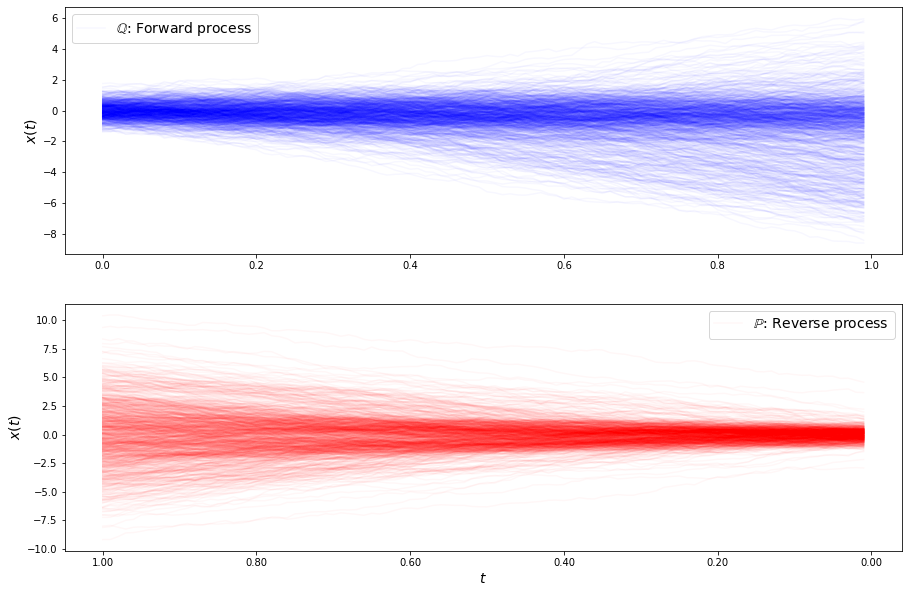

loss b 1.6885884047397475
loss b 1.6758057623958496
loss b 1.689731358299488
loss b 1.7754191184917452
loss b 1.4460134633582193
loss b 1.5800742771115095
loss b 1.752700500344683
loss b 1.7210038498413383
loss b 1.6292362485761762
loss b 1.548639772929641
loss b 1.6580433187455705
loss b 1.5450561809538297
loss b 1.6562677320032158
loss b 1.6861279316644868
loss b 1.6394007156600996
loss b 1.721545322451115
loss b 1.5345358848630366
loss b 1.6135830781219787
loss b 1.6043901249318042
loss b 1.6037797004252168
loss b 1.6658209314658474
loss b 1.6312867051567628
loss b 1.5932507554690618
loss b 1.643066125648827
loss b 1.6048354806233953
loss b 1.715423561830027
loss b 1.7227204492715118
loss b 1.6716097217705672
loss b 1.5949179177423802
loss b 1.669672639363881
loss f 1.2751588844570525
loss f 1.327552719786173
loss f 1.4199324796803625
loss f 1.4485255795968954
loss f 1.2666039107966025
loss f 1.3022493346268003
loss f 1.4389421047692725
loss f 1.379516389842293
loss f 1.361107382825

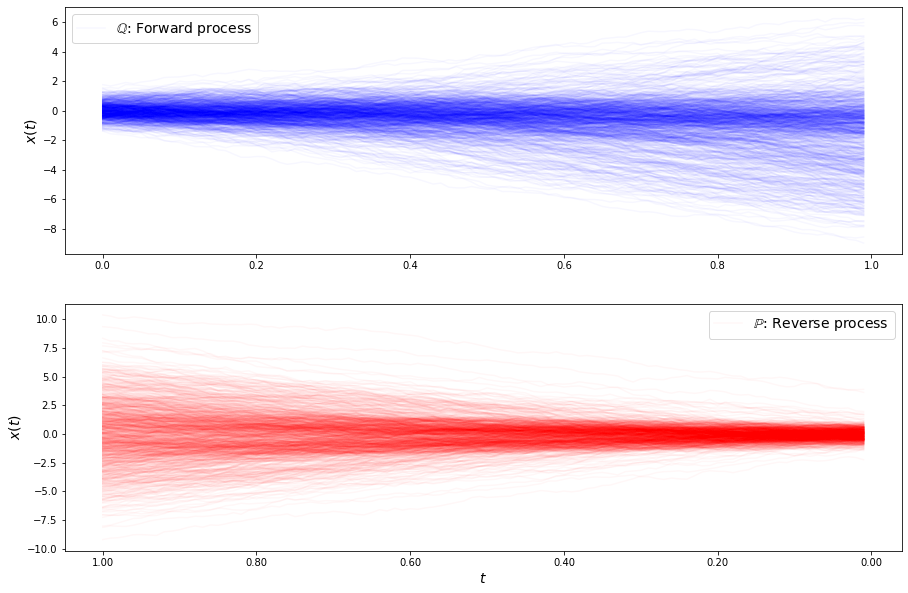

loss b 1.7304585313850138
loss b 1.9656387845007108
loss b 1.6048526281732796
loss b 1.7426517870109923
loss b 1.7100493993991284
loss b 2.013331948574366
loss b 1.716400388578211
loss b 1.7685421196432032
loss b 1.7242790591244355
loss b 1.7682633856968903
loss b 1.7453090745439062
loss b 1.694145496948749
loss b 1.624806686219445
loss b 1.7867073575580403
loss b 1.7603014572314493
loss b 1.7943169063841489
loss b 1.7223196185559522
loss b 1.5954352278331885
loss b 1.7086102078520582
loss b 1.6451513737163206
loss b 1.6893970121733455
loss b 1.7400333915252906
loss b 1.7565558462828146
loss b 1.7535403052574259
loss b 1.7082047974193024
loss b 1.7099024186648732
loss b 1.7883384963998425
loss b 1.7104514589615718
loss b 1.6956636682457418
loss b 1.814888448995778
loss f 1.3627424535881192
loss f 1.4986198122403929
loss f 1.425649020910764
loss f 1.4184970235063887
loss f 1.4417021316402718
loss f 1.4070122126459768
loss f 1.4818424629466245
loss f 1.4738872932585303
loss f 1.425866479

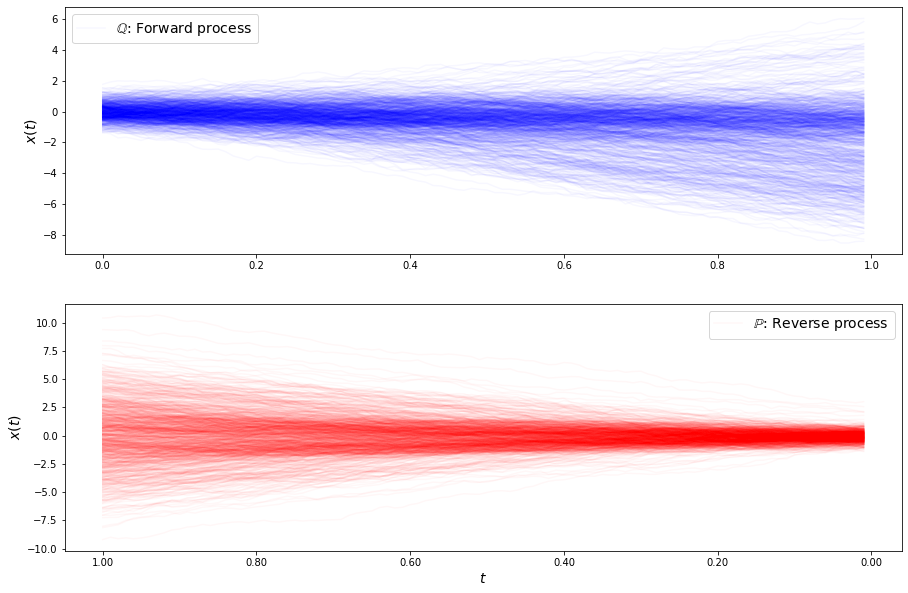

loss b 1.9128307497843917
loss b 1.7468216246527066
loss b 1.7611838262737247
loss b 1.8191844010150942
loss b 1.9141583474229407
loss b 1.8054044466597083
loss b 1.7090266564410843
loss b 1.7874812948233716
loss b 1.6808358080219203
loss b 1.6659057714782286
loss b 1.741702776337504
loss b 1.69409648520558
loss b 1.6616749878189274
loss b 1.7288172036296647
loss b 1.7948291950831228
loss b 1.7979491939451386
loss b 1.7766485423377159
loss b 1.889142441239472
loss b 1.6840136504282697
loss b 1.7851672712826359
loss b 1.7749680517805544
loss b 1.7513073671757275
loss b 1.5480744503254622
loss b 1.8513718967013364
loss b 1.8754392618345102
loss b 1.6858981943287223
loss b 1.7443842880455775
loss b 1.762430600884868
loss b 1.7005446892800156
loss b 1.715235593169848
loss f 1.5645184376324601
loss f 1.5222416350382788
loss f 1.4571554324776295
loss f 1.5574392142956723
loss f 1.5314122637783645
loss f 1.5453020340366557
loss f 1.3760866370776474
loss f 1.5017718191927445
loss f 1.607140241

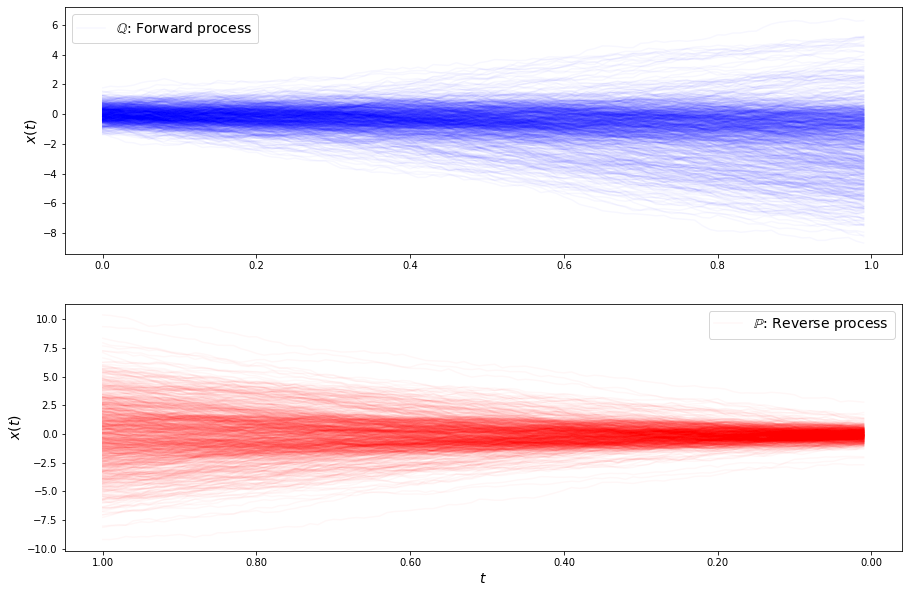

loss b 1.6752324567507777
loss b 1.8222654790892314
loss b 1.6626327063201964
loss b 1.8272027801260458
loss b 1.7594790397810083
loss b 1.8147263759307148
loss b 1.6997565953981322
loss b 1.6989381317173238
loss b 1.6528143154725825
loss b 1.693440011647927
loss b 1.7227632831178998
loss b 1.6830809699945122
loss b 1.7729251326137272
loss b 1.714742822313424
loss b 1.9697120716987235
loss b 1.7771702923195947
loss b 1.8723019519076205
loss b 1.821853827627167
loss b 1.7430440713226945
loss b 1.8354538572010854
loss b 1.6658639127043378
loss b 1.8736017960283526
loss b 1.7425871808374334
loss b 1.6941123115516712
loss b 1.7398191118592221
loss b 1.5965881888115787
loss b 1.5486859399096833
loss b 1.845281986253577
loss b 1.7245235814279913
loss b 1.7508484488133282
loss f 1.4149185385360383
loss f 1.5014326705555936
loss f 1.463600060068323
loss f 1.438234285534041
loss f 1.6294093298990409
loss f 1.5812400896838337
loss f 1.5134221685819444
loss f 1.4560681825815522
loss f 1.534128419

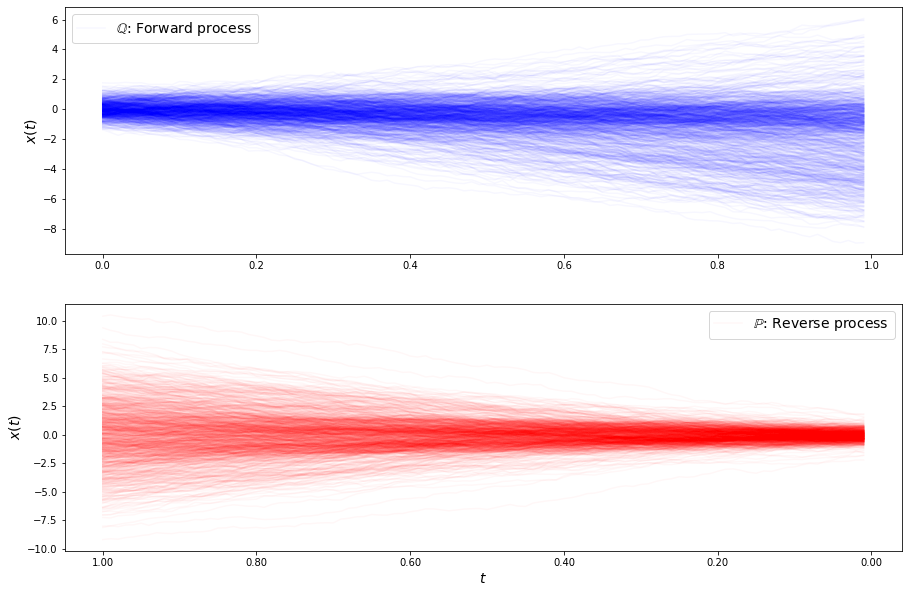

loss b 1.6207953784442737
loss b 1.6853896851900527
loss b 1.6275436448293708
loss b 1.5931176164029248
loss b 1.6126222694864436
loss b 1.7462865591682522
loss b 1.9819219819586915
loss b 1.6940725585001062
loss b 1.5846533775549663
loss b 1.7148581542308345
loss b 1.5413034548429116
loss b 1.6784094965436716
loss b 1.5714118764730955
loss b 1.7002756533565986
loss b 1.6595523753781574
loss b 1.5747547974262193
loss b 1.7057240970085283
loss b 1.6545350765084046
loss b 1.645178945848439
loss b 1.6296544836895472
loss b 1.751145940159902
loss b 1.6319366796902637
loss b 1.683437140982914
loss b 1.7040429505321093
loss b 1.5827028741702136
loss b 1.6740297819946233
loss b 1.7028542630340153
loss b 1.7705549859255232
loss b 1.7616111030414852
loss b 1.8331994876319926
loss f 1.3787181624340734
loss f 1.5170805873291513
loss f 1.5480916739939328
loss f 1.4350801652343534
loss f 1.4816267203834077
loss f 1.3805367666694515
loss f 1.3380345488084968
loss f 1.3090946181474554
loss f 1.588447

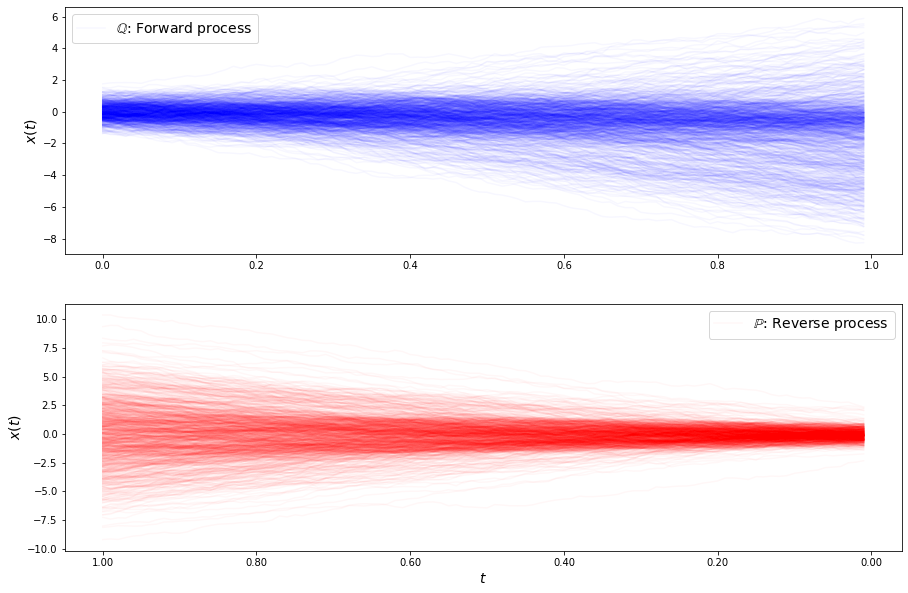

loss b 1.5327486567349426
loss b 1.4603361438324334
loss b 1.4793845254417344
loss b 1.5236140572938683
loss b 1.5768095643332574
loss b 1.514113751276297
loss b 1.485673360761107
loss b 1.5164983708579807
loss b 1.4439424544138133
loss b 1.4523994013679113
loss b 1.516462241691377
loss b 1.5057254014918675
loss b 1.5061966778108191
loss b 1.707279397487421
loss b 1.477167178978179
loss b 1.5204318128466792
loss b 1.6008575429477718
loss b 1.4386605283169944
loss b 1.4684323058074311
loss b 1.4296788288403073
loss b 1.6363045089169572
loss b 1.5074081063180147
loss b 1.4510267726980597
loss b 1.5827305167782026
loss b 1.4954310700638904
loss b 1.4637911166371926
loss b 1.4384358895993148
loss b 1.5299316965619008
loss b 1.5936029431580916
loss b 1.5620004708162711
loss f 1.3178861445774093
loss f 1.3621363532203088
loss f 1.3657568281099393
loss f 1.4427122433648394
loss f 1.3270943248492582
loss f 1.3389636940715615
loss f 1.1751391832059574
loss f 1.3310107800323467
loss f 1.28517518

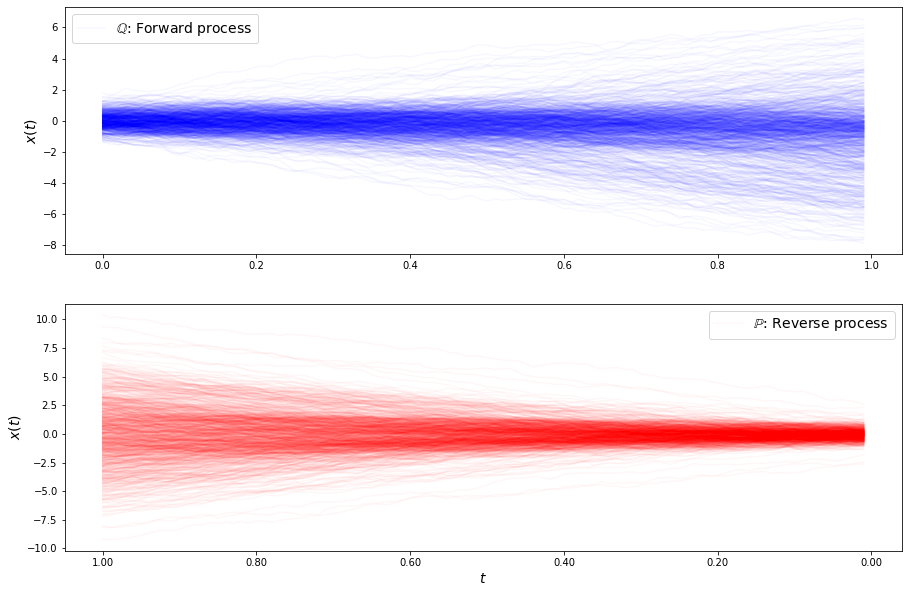

loss b 1.3607824489624485
loss b 1.4584182760986004
loss b 1.3694800776297813
loss b 1.513032611391086
loss b 1.505162535507327
loss b 1.4413650966987952
loss b 1.4544998712565744
loss b 1.4119301063514886
loss b 1.5200380968178924
loss b 1.3688490677301302
loss b 1.525195485723913
loss b 1.378873496079778
loss b 1.4316304174297783
loss b 1.4703559453419541
loss b 1.591713814007556
loss b 1.4235523187109371
loss b 1.4088840962393196
loss b 1.4192385246351753
loss b 1.3072055125086355
loss b 1.468254298992015
loss b 1.4111189715095744
loss b 1.3587549656315792
loss b 1.4773822011638609
loss b 1.324888901180034
loss b 1.36206206669417
loss b 1.436971061119637
loss b 1.478926706067238
loss b 1.3850872226008475
loss b 1.5013438328714666
loss b 1.582405986259475
loss f 1.265247603327435
loss f 1.257329028784819
loss f 1.1560663520946581
loss f 1.2405326133763086
loss f 1.2512262743137454
loss f 1.086600089992454
loss f 1.2659182465217351
loss f 1.2062779822373662
loss f 1.1744645862150236
l

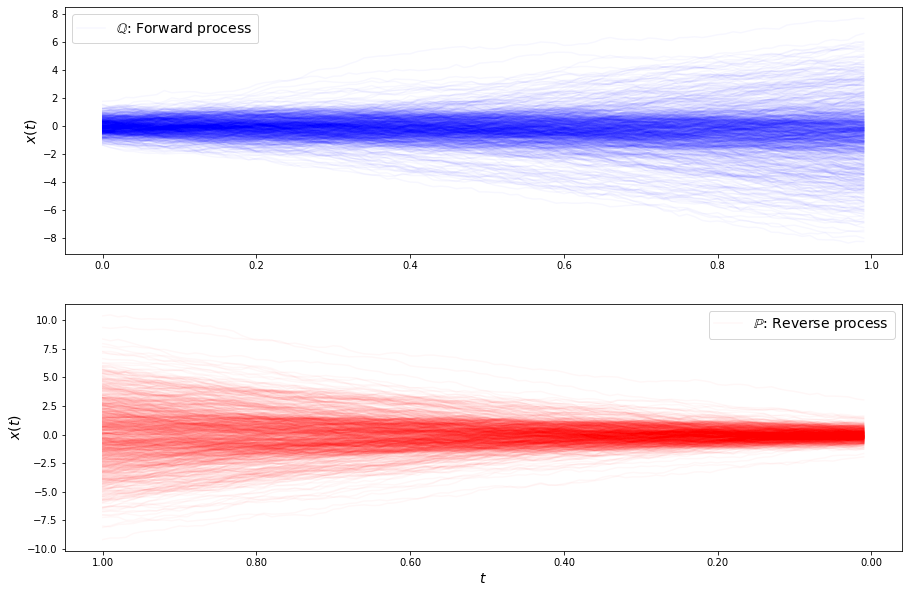

loss b 1.3244086459488806
loss b 1.4036585314659995
loss b 1.289023925081927
loss b 1.2989568210449034
loss b 1.2972119544363339
loss b 1.3568211998648274
loss b 1.324013253741122
loss b 1.2554183525404083
loss b 1.4628429513203884
loss b 1.4356332415270467
loss b 1.3484327143458015
loss b 1.4056691036894444
loss b 1.4139985742595222
loss b 1.325038005744647
loss b 1.2430714634522435
loss b 1.3725422048982672
loss b 1.3109539531302907
loss b 1.2824813501235084
loss b 1.3487726800015056
loss b 1.2958004199855722
loss b 1.274207815993103
loss b 1.3143463056657212
loss b 1.3329324435280445
loss b 1.318241679688324
loss b 1.2937241628144243
loss b 1.246257977211882
loss b 1.368229247861346
loss b 1.3607521136510778
loss b 1.3154287537376395
loss b 1.4275866383673654
loss f 1.0519348318114912
loss f 1.1353910970805723
loss f 1.082168034486568
loss f 1.0867923212192292
loss f 1.1115564746450188
loss f 1.1204121465829875
loss f 1.2782289333208394
loss f 1.2755399681033015
loss f 1.15787130927

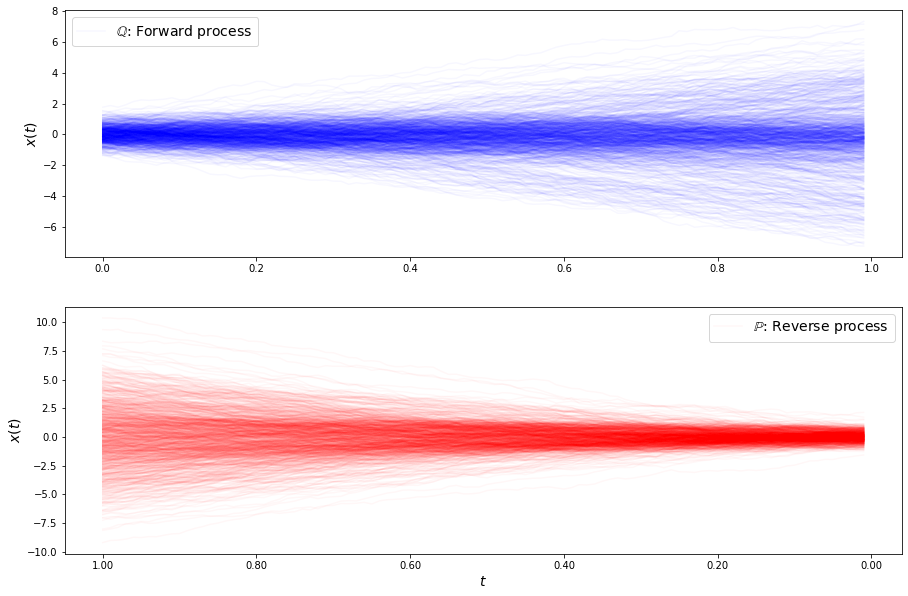

loss b 1.4203896974345636
loss b 1.338448495562293
loss b 1.2893579661601897
loss b 1.3001196644519448
loss b 1.1922854868328905
loss b 1.3124654832618956
loss b 1.2566947302860823
loss b 1.2596565023785675
loss b 1.392471887430817
loss b 1.3243975024525312
loss b 1.287995685927266
loss b 1.4557911311399498
loss b 1.2362630405315012
loss b 1.37745982293073
loss b 1.3697439071004298
loss b 1.4337877995938455
loss b 1.2637604674790848
loss b 1.3410896667714751
loss b 1.293916194262261
loss b 1.339330496195215
loss b 1.3480525731173891
loss b 1.2872759393521076
loss b 1.2728296020218177
loss b 1.335043375891619
loss b 1.3258159900961375
loss b 1.3675332550410542
loss b 1.3754242727430341
loss b 1.371972364033362
loss b 1.3592114425208615
loss b 1.3240714990482525
loss f 1.1096153608946742
loss f 1.1267853843799431
loss f 1.1621486732124886
loss f 1.1149440340330812
loss f 1.0141121934995851
loss f 1.075473569323045
loss f 1.0885527700874984
loss f 1.1251595447382488
loss f 1.0852640344176

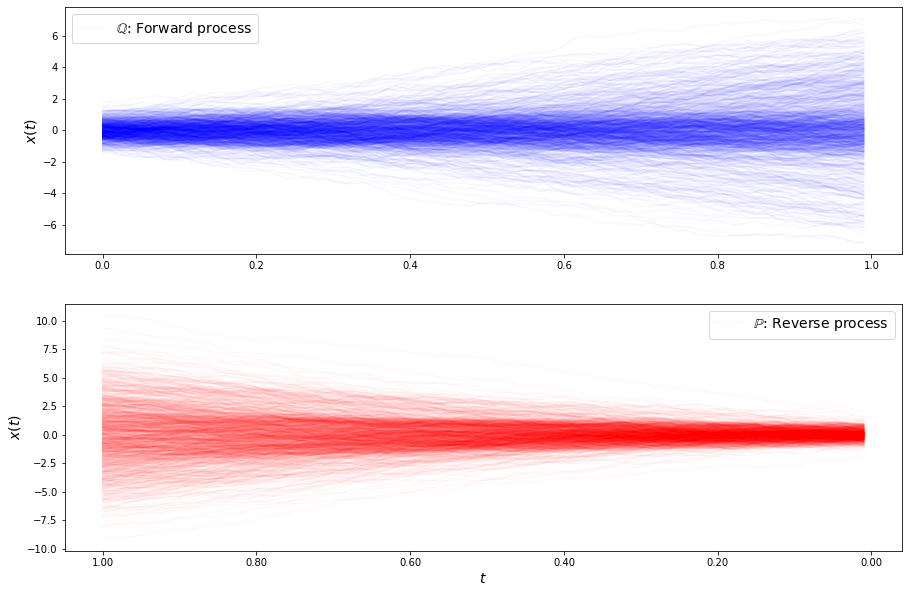

loss b 1.348756454481462
loss b 1.3316863636403946
loss b 1.342636932071393
loss b 1.2701186482987783
loss b 1.321669118324809
loss b 1.4494164026114502
loss b 1.365838209077438
loss b 1.3468689122015216
loss b 1.5288512151692926
loss b 1.331811077466995
loss b 1.460008969982938
loss b 1.2833203965265043
loss b 1.3049201173708327
loss b 1.3877446834858467
loss b 1.3533388146352607
loss b 1.3064398123306742
loss b 1.3138484647024826
loss b 1.4055629440202086
loss b 1.3225974610895996
loss b 1.3548233629361084
loss b 1.304469256371982
loss b 1.4115775147179637
loss b 1.3345249893143045
loss b 1.4211961765444237
loss b 1.3251304909113915
loss b 1.4173369291230449
loss b 1.3515750651253853
loss b 1.378090689045191
loss b 1.3961923669252052
loss b 1.4089621767021017
loss f 1.2463547172895495
loss f 1.1534471184199058
loss f 1.166503195490214
loss f 1.2740764306536254
loss f 1.2268547503584302
loss f 1.12946262194183
loss f 1.08525645446176
loss f 1.1487387303621903
loss f 1.3265152833750302

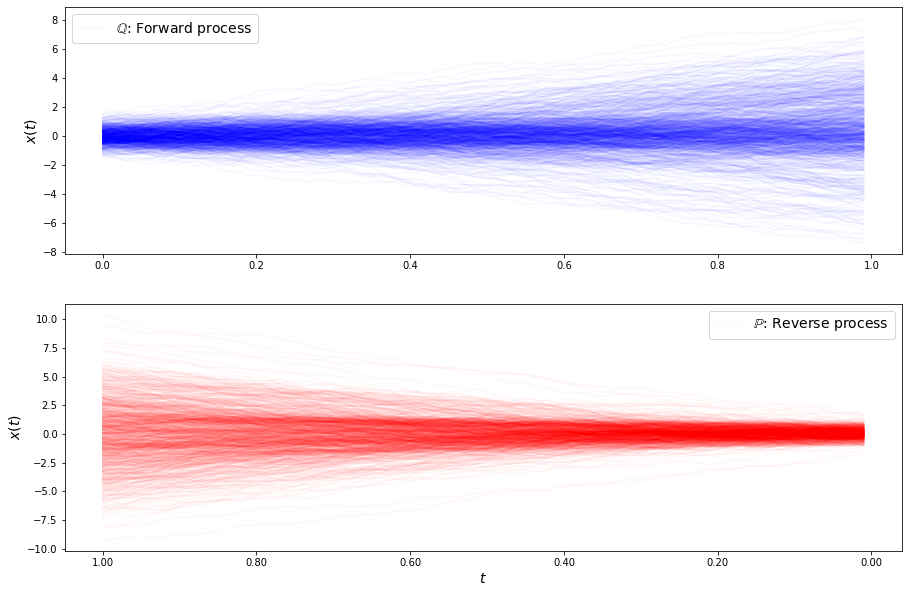

loss b 1.4379337551607787
loss b 1.4024413632270658
loss b 1.3894338153040695
loss b 1.5657927368779427
loss b 1.414473191593803
loss b 1.471539239038969
loss b 1.410101686669955
loss b 1.4423812683555743
loss b 1.4738691495908296
loss b 1.4949229944668005
loss b 1.4071077166358357
loss b 1.4846953974788268
loss b 1.3252023480755069
loss b 1.4897501241197246
loss b 1.406344514338131
loss b 1.4711791330501065
loss b 1.5111489394714828
loss b 1.4067339190182775
loss b 1.4411286251345803
loss b 1.5021743124996783
loss b 1.5183343111978282
loss b 1.4371789325979352
loss b 1.4800098736232128
loss b 1.4238426921115044
loss b 1.536582084146567
loss b 1.5218178928342256
loss b 1.4979478813623726
loss b 1.464678565836344
loss b 1.5206220510814223
loss b 1.588570417463446
loss f 1.196257706578899
loss f 1.4082266280627078
loss f 1.3238871055977819
loss f 1.2034514745393237
loss f 1.3664479168749546
loss f 1.2239694229185543
loss f 1.2064507522155559
loss f 1.2761180004733172
loss f 1.22202644736

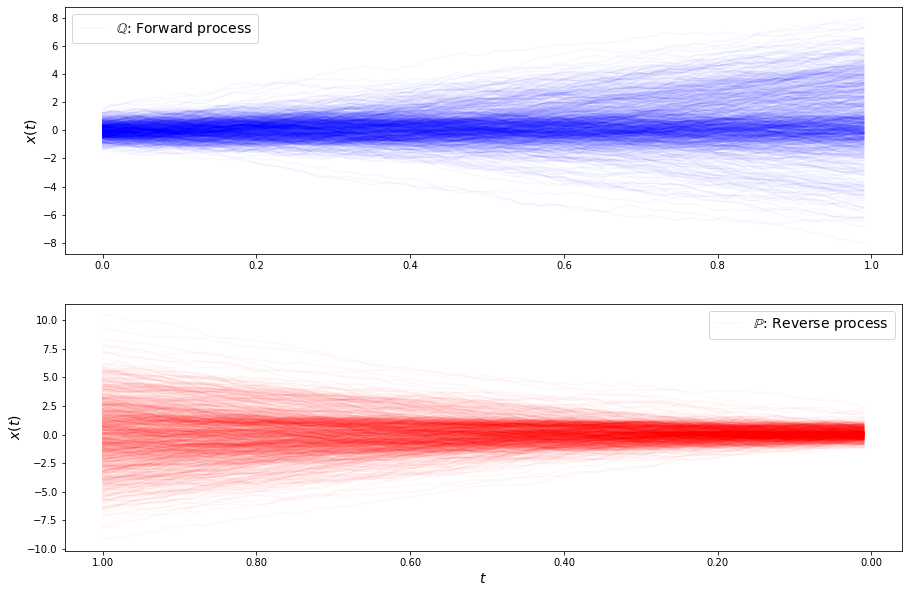

loss b 1.7186973487549797
loss b 1.6235131173678252
loss b 1.4719959525234112
loss b 1.5786948474014435
loss b 1.6061484975779012
loss b 1.5879507281386334
loss b 1.5939714853803915
loss b 1.6581947551166887
loss b 1.5896596647613592
loss b 1.5652414293069767
loss b 1.543242817011891
loss b 1.563174553717573
loss b 1.6384891273730438
loss b 1.6792758462302821
loss b 1.4998288738771492
loss b 1.4949298060129217
loss b 1.5939966257699103
loss b 1.504368592846741
loss b 1.6023343735842501
loss b 1.511904003768678
loss b 1.5151670220392075
loss b 1.4997167959581712
loss b 1.5576404653876008
loss b 1.4605559317423786
loss b 1.5690704020374504
loss b 1.5226968749689307
loss b 1.5884787733998564
loss b 1.5677030916574526
loss b 1.5323578543532679
loss b 1.5949770635240046
loss f 1.3153098968708
loss f 1.4340254468493234
loss f 1.4246580385708687
loss f 1.325050082924526
loss f 1.3680613644061925
loss f 1.3807523316104142
loss f 1.4453159143021908
loss f 1.37786993511033
loss f 1.3670939937576

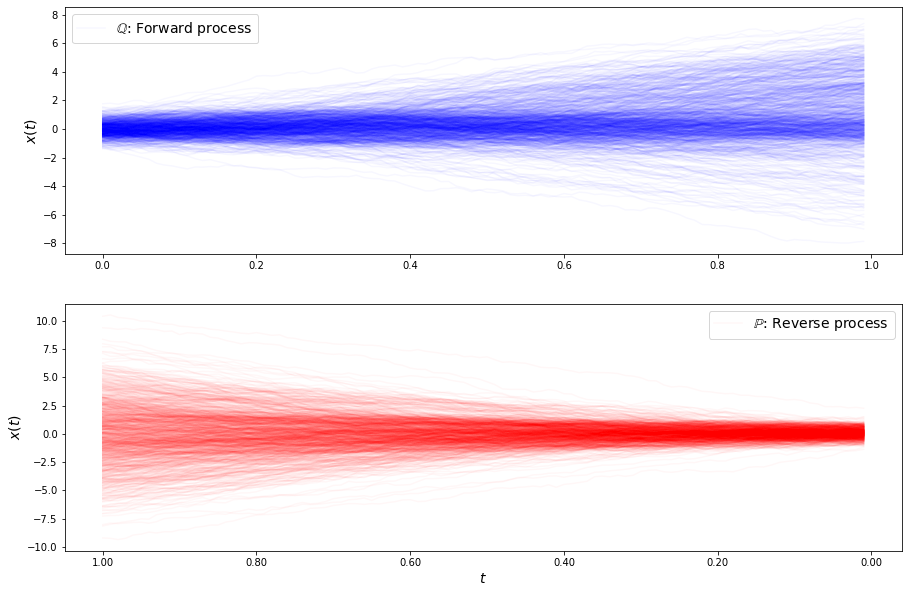

loss b 1.6055500410996788
loss b 1.716777371081321
loss b 1.605474793922225
loss b 1.69175613387889
loss b 1.6418504563341962
loss b 1.8611890530194544
loss b 1.6872526760792406
loss b 1.680896745315922
loss b 1.551436381322613
loss b 1.6341782771114086
loss b 1.6358951467671
loss b 1.6662371294836453
loss b 1.538999979100563
loss b 1.6110510526400337
loss b 1.6355624470508778
loss b 1.791424485558688
loss b 1.6486841276565425
loss b 1.7073095944498629
loss b 1.5905320011286128
loss b 1.6362566590488818
loss b 1.6321024900268055
loss b 1.7640398751337816
loss b 1.7666450919468946
loss b 1.6691134242691814
loss b 1.7244599515889951
loss b 1.710918655939319
loss b 1.6624511034330827
loss b 1.6153354313159585
loss b 1.6439179333097884
loss b 1.5486660806731831
loss f 1.391570429688035
loss f 1.4827413813758312
loss f 1.4436336019631995
loss f 1.305976119901487
loss f 1.5244433012272256
loss f 1.5299842822446923
loss f 1.4085782013456416
loss f 1.4799180024105059
loss f 1.513167489125355
l

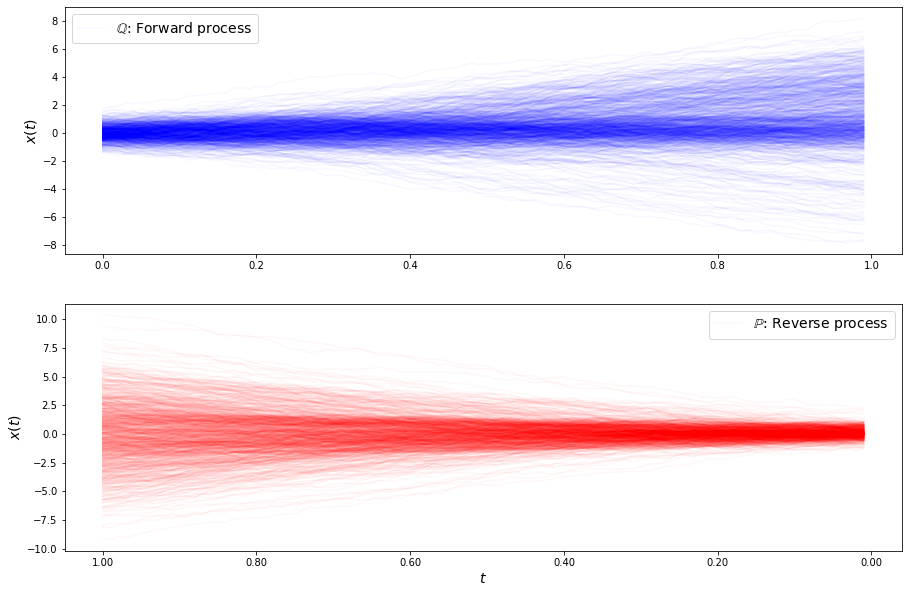

loss b 1.6632575051963443
loss b 1.7062467599094588
loss b 1.6498351235254096
loss b 1.6854510360916326
loss b 1.6951456941421748
loss b 1.6115794869934903
loss b 1.6719568204199822
loss b 1.7561612581969304
loss b 1.6165250660391626
loss b 1.7595606156698989
loss b 1.7840237599380595
loss b 1.786203608971158
loss b 1.7410950477691531
loss b 1.6676565543368738
loss b 1.7961180958667322
loss b 1.7607170843287518
loss b 1.665362100030899
loss b 1.7408243083218289
loss b 1.6741034435613187
loss b 1.593867394325938
loss b 1.740866820529744
loss b 1.5978414190994892
loss b 1.6691661751949223
loss b 1.650859241019285
loss b 1.755415404037232
loss b 1.6560489658226676
loss b 1.7568069756443734
loss b 1.7055484127128657
loss b 1.7096276757134719
loss b 1.6967579586462544
loss f 1.5079089397798826
loss f 1.4983414373398558
loss f 1.3663710062438903
loss f 1.546737873834414
loss f 1.5648736500045146
loss f 1.5777896754990783
loss f 1.4735238425568737
loss f 1.45606889227091
loss f 1.520169744372

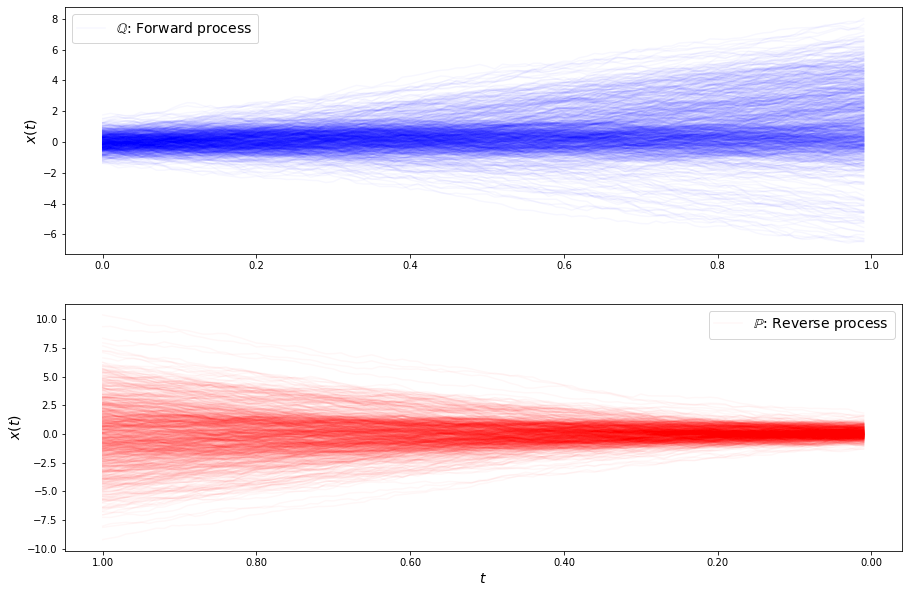

loss b 1.638666415792315
loss b 1.7579874367751833
loss b 1.748103848191356
loss b 1.7299285129105144
loss b 1.6932925539029056
loss b 1.7354052946123426
loss b 1.7228980084255712
loss b 1.7065449540669155
loss b 1.6838299125816434
loss b 1.6393771500809324
loss b 1.7326675596165984
loss b 1.6595395255427
loss b 1.7182051855967544
loss b 1.718663862313364
loss b 1.6853940822466988
loss b 1.7427010124153686
loss b 1.6767866833896237
loss b 1.6952324698480676
loss b 1.7059835298724222
loss b 1.6624882649473025
loss b 1.7009590733785747
loss b 1.5933996079239818
loss b 1.6087129040666996
loss b 1.708979228884308
loss b 1.6396354292057185
loss b 1.636755091692731
loss b 1.7665697417826018
loss b 1.7324804695911922
loss b 1.6725344889193259
loss b 1.5522976645834605
loss f 1.5985433794786044
loss f 1.508339539352938
loss f 1.4263264672122582
loss f 1.5235661519535726
loss f 1.574025869988947
loss f 1.6101828863044112
loss f 1.5531739420777284
loss f 1.532602172417155
loss f 1.47623006719771

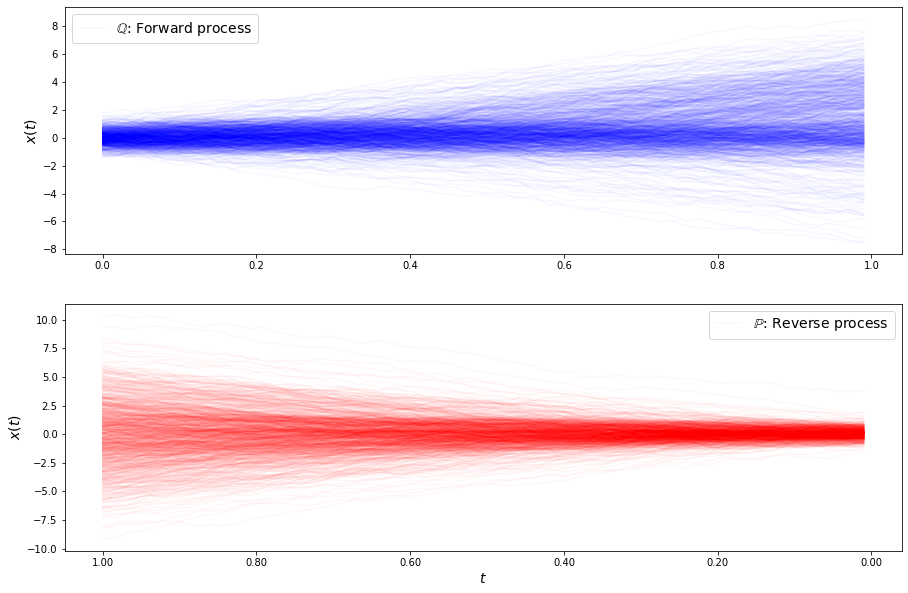

loss b 1.671484244261439
loss b 1.6247532362100834
loss b 1.663722740845446
loss b 1.7081723918125953
loss b 1.7202042212481115
loss b 1.5935333242842165
loss b 1.6578223256102733
loss b 1.6669252099840293
loss b 1.573097218397305
loss b 1.6597128955505758
loss b 1.6032089754640289
loss b 1.4697641575431253
loss b 1.6623394851226256
loss b 1.6593350381759593
loss b 1.6360176212105944
loss b 1.72310678442919
loss b 1.600502461608762
loss b 1.6168229824468823
loss b 1.6594272740042966
loss b 1.6159137987240593
loss b 1.5781787509813594
loss b 1.5767117477360575
loss b 1.6029865236075604
loss b 1.6172234719421001
loss b 1.6066338328093477
loss b 1.6139983461524086
loss b 1.5730530545384083
loss b 1.5947048434109725
loss b 1.673016336301147
loss b 1.6318760698715877
loss f 1.4742039725293137
loss f 1.4614391494986818
loss f 1.59359872743205
loss f 1.5356415156109553
loss f 1.383227385521714
loss f 1.447271207119357
loss f 1.3637473296469431
loss f 1.3750113342224828
loss f 1.45978543693389

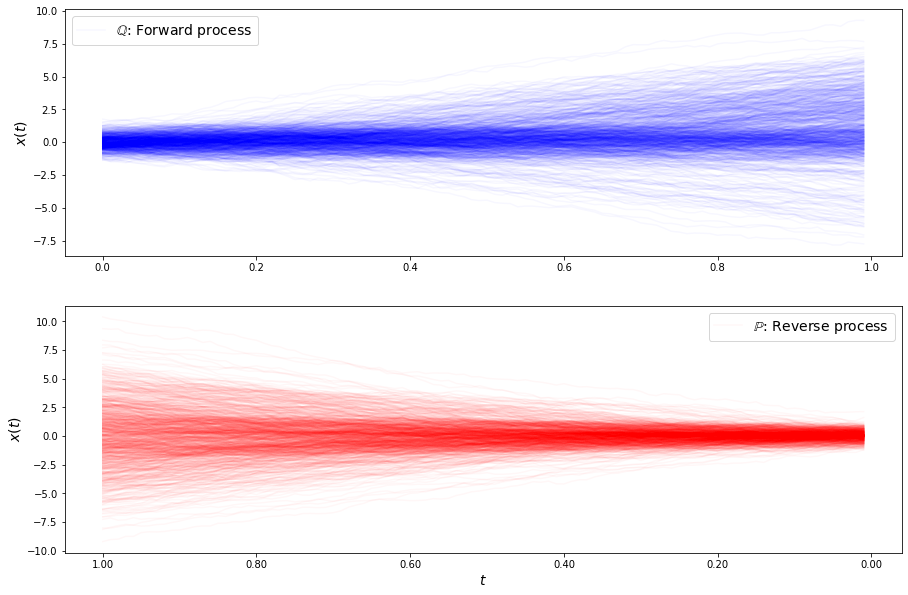

loss b 1.641355966812502
loss b 1.6702325023493991
loss b 1.6588970445670457
loss b 1.5647863951540435
loss b 1.6008201340579897
loss b 1.653927972805527
loss b 1.5810462569124473
loss b 1.6239233318721042
loss b 1.472896746585919
loss b 1.5707651758340408
loss b 1.516084330937264
loss b 1.5260756938298639
loss b 1.6363573872235613
loss b 1.5784117680222876
loss b 1.532126713176878
loss b 1.5158596704746758
loss b 1.6079106795375144
loss b 1.6231306849321039
loss b 1.5151100256380807
loss b 1.6323817601174595
loss b 1.5185272514557262
loss b 1.412718772359774
loss b 1.433857710507525
loss b 1.5500017353678206
loss b 1.471690111124403
loss b 1.4787306815563426
loss b 1.4332411209949236
loss b 1.5333596854884164
loss b 1.5940022264094915
loss b 1.4535742026148806
loss f 1.4236171383587333
loss f 1.4147748399550164
loss f 1.3348415612350235
loss f 1.3864163676727885
loss f 1.3729977354375749
loss f 1.2154859391800519
loss f 1.4415422882999371
loss f 1.4048368104967506
loss f 1.33525766510

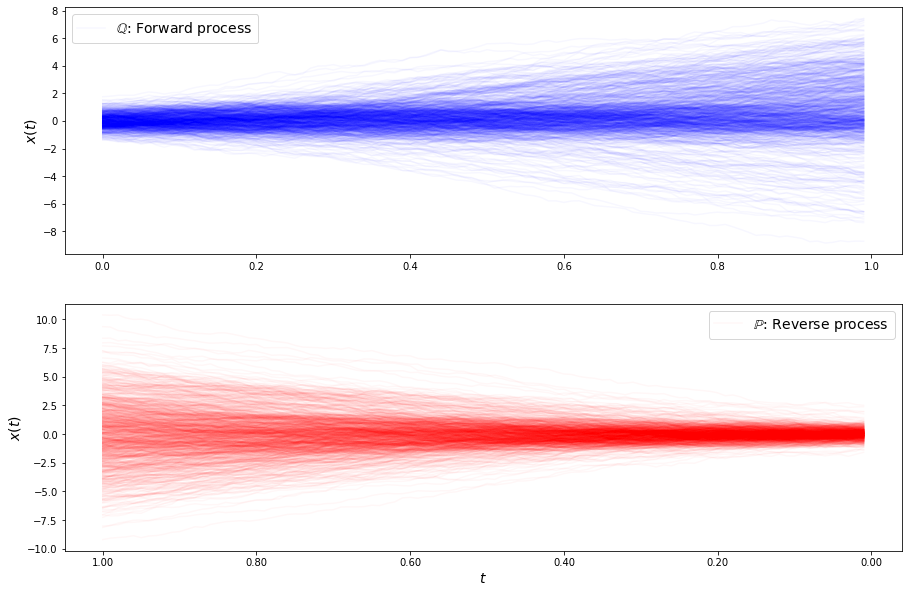

loss b 1.4944218930574011
loss b 1.4971150125222414
loss b 1.4732036459235733
loss b 1.4286149135341624
loss b 1.3746679550733238
loss b 1.4431408568118373
loss b 1.5378281373594995
loss b 1.4615133574758217
loss b 1.4406499742430001
loss b 1.4469815048454557
loss b 1.4728556493643505
loss b 1.3841184290880735
loss b 1.467778527994828
loss b 1.445442343681988
loss b 1.4990972842847967
loss b 1.5375771807440004
loss b 1.4165706999292071
loss b 1.4314775012198429
loss b 1.517921768441072
loss b 1.4382627570298807
loss b 1.4940469212109782
loss b 1.4745681746957349
loss b 1.5319794165667318
loss b 1.4724047553904178
loss b 1.3976848308842014
loss b 1.3989069321167795
loss b 1.4516197545281664
loss b 1.520868610068428
loss b 1.5520351127285528
loss b 1.4034965276128177
loss f 1.3829941902002139
loss f 1.2487579477717525
loss f 1.1372517013342647
loss f 1.2188328242158826
loss f 1.297962970382367
loss f 1.3405699262862911
loss f 1.406890687543487
loss f 1.3885661352182423
loss f 1.278007983

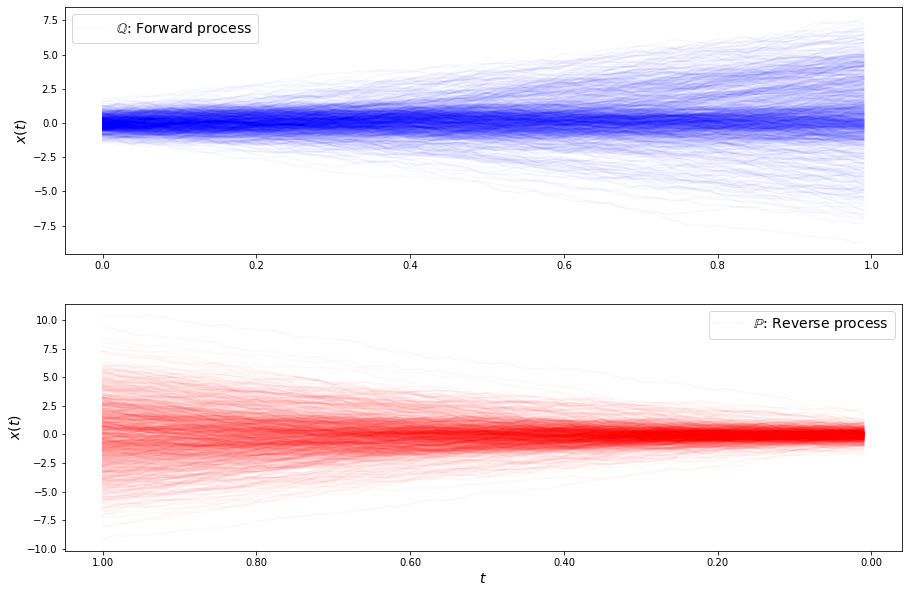

loss b 1.4325285987282272
loss b 1.4199666222295262
loss b 1.508868484198152
loss b 1.4084809291118119
loss b 1.397302377420759
loss b 1.5213790334059656
loss b 1.3238349254360382
loss b 1.5017202833349328
loss b 1.2498614412923015
loss b 1.2925965824317427
loss b 1.4071398018852619
loss b 1.4575004825006512
loss b 1.3610278527999977
loss b 1.4957708331759387
loss b 1.3637229305091059
loss b 1.301849339530632
loss b 1.376322100852056
loss b 1.4653208738508532
loss b 1.4747143481264264
loss b 1.3770195516882002
loss b 1.3203050261130402
loss b 1.4353423052176373
loss b 1.4570626092177887
loss b 1.482228112597228
loss b 1.371995358949863
loss b 1.4291079441081436
loss b 1.3740071006169146
loss b 1.4251641523545568
loss b 1.365885628422076
loss b 1.372157271400563
loss f 1.2068899747041926
loss f 1.180879538428956
loss f 1.2187428338411426
loss f 1.0984478020848496
loss f 1.2593088518154405
loss f 1.3162708929972138
loss f 1.3387518009811628
loss f 1.2702841559437004
loss f 1.274644241771

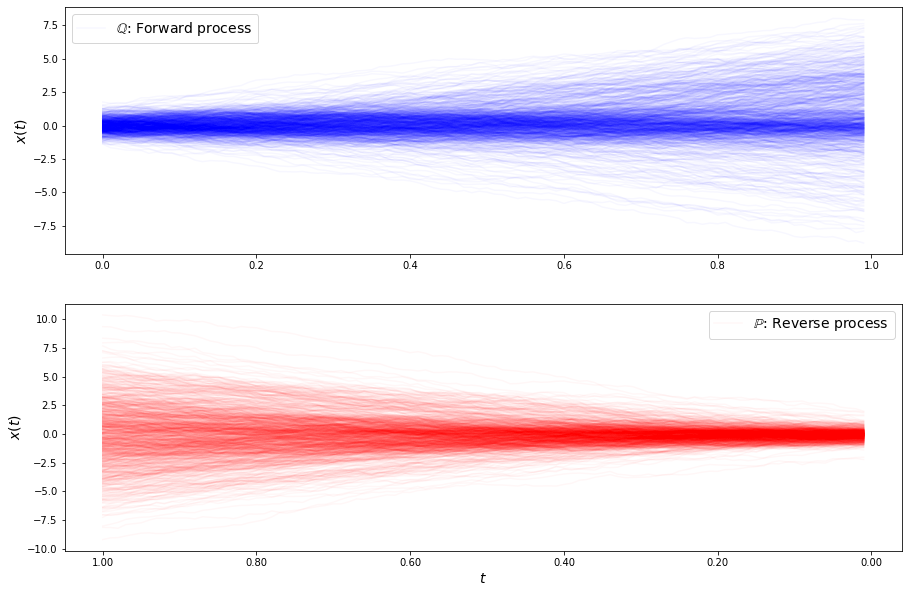

loss b 1.4874595303425044
loss b 1.371505800401174
loss b 1.350951574380482
loss b 1.246595043323896
loss b 1.2812753391782932
loss b 1.4080468396571746
loss b 1.4271725187901905
loss b 1.3234002456907186
loss b 1.361460975236214
loss b 1.2278625869715114
loss b 1.3312176082131408
loss b 1.353988338343238
loss b 1.370534460728309
loss b 1.370225725875603
loss b 1.3024116482977157
loss b 1.4770467913425163
loss b 1.3338567541579747
loss b 1.2372358076747432
loss b 1.3849670629110111
loss b 1.3179147908082882
loss b 1.3107906545137673
loss b 1.373840280204563
loss b 1.3275209090462414
loss b 1.316348040624073
loss b 1.3367734283808403
loss b 1.4005267760940485
loss b 1.3180663824675045
loss b 1.432332371888066
loss b 1.431575353925545
loss b 1.3604125438232433
loss f 1.1340361943160482
loss f 1.2871727090700578
loss f 1.2813847568669006
loss f 1.2385316130314634
loss f 1.161515165167003
loss f 1.280568015289254
loss f 1.2470430350457895
loss f 1.2442527064250433
loss f 1.2285092825188144

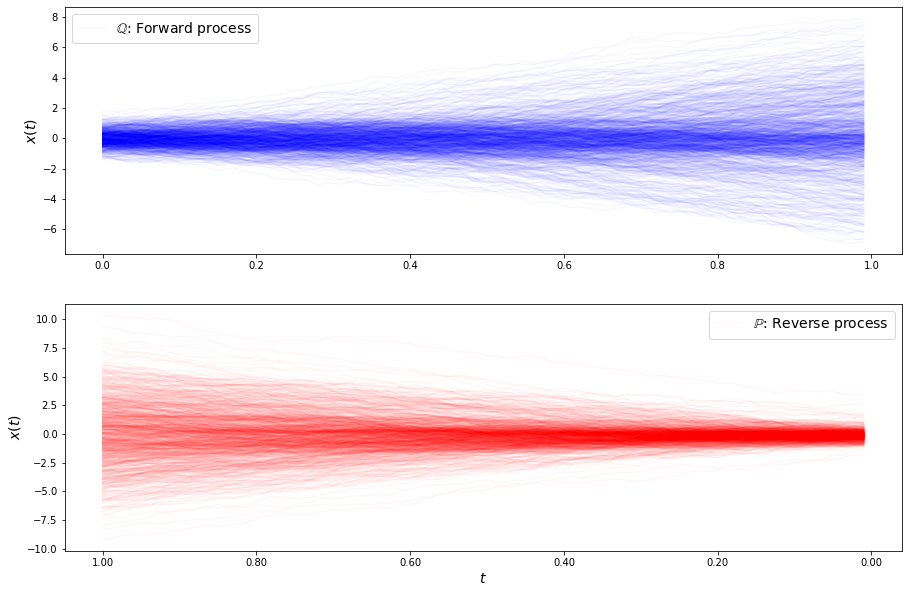

loss b 1.3300782071734953
loss b 1.250805207201446
loss b 1.3921637421027075
loss b 1.3076882495295499
loss b 1.3010413611102258
loss b 1.4047886474269855
loss b 1.3393515787128119
loss b 1.3517405702719185
loss b 1.339402439719897
loss b 1.377240096859816
loss b 1.373702697400915
loss b 1.4021495179536627
loss b 1.35215128776963
loss b 1.4184211702451304
loss b 1.3147390596317687
loss b 1.2739243738181802
loss b 1.3248031208782556
loss b 1.2865648008856239
loss b 1.322949123080898
loss b 1.3629961145554375
loss b 1.3946794985187858
loss b 1.3325326147422176
loss b 1.457358314958884
loss b 1.5136834081604764
loss b 1.3783048067030492
loss b 1.3686489014871017
loss b 1.4784347771816881
loss b 1.4250602636151826
loss b 1.3812200313780842
loss b 1.4567283703978398
loss f 1.3583993900791564
loss f 1.290620928692822
loss f 1.2574645934750928
loss f 1.2700947240092637
loss f 1.270035382785995
loss f 1.3916156813998755
loss f 1.2547346020794228
loss f 1.0589868613584155
loss f 1.3833454920845

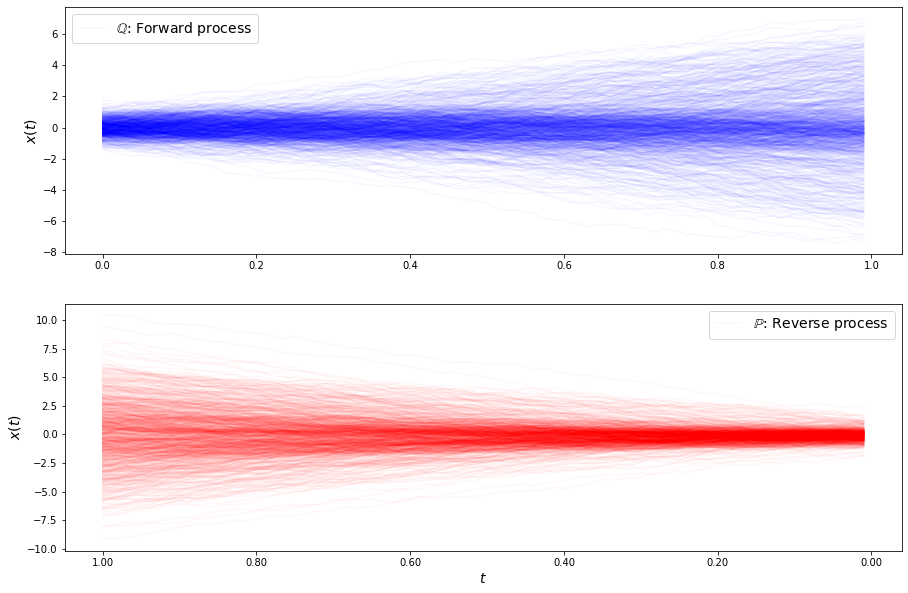

loss b 1.3161394103802007
loss b 1.498919718739224
loss b 1.3362337416780865
loss b 1.4808696837208515
loss b 1.3704787996508578
loss b 1.4115849221121606
loss b 1.4317733732072238
loss b 1.4201007343615895
loss b 1.3545997001966168
loss b 1.3697085448035058
loss b 1.385895888173877
loss b 1.3892620611822037
loss b 1.452313326602489
loss b 1.4619360816568534
loss b 1.5108710544527093
loss b 1.4630854291043007
loss b 1.4151564627331883
loss b 1.490328789309392
loss b 1.5053837646666874
loss b 1.4149460687820135
loss b 1.4269074186440003
loss b 1.4536441362388917
loss b 1.5339745299914922
loss b 1.419966573439445
loss b 1.452965630996204
loss b 1.486639006366984
loss b 1.369069593826667
loss b 1.2767620150226133
loss b 1.4111322015579648
loss b 1.4582261315036642
loss f 1.247244315899009
loss f 1.3318557145123655
loss f 1.3628530055702939
loss f 1.28706729022355
loss f 1.3760683686166013
loss f 1.2992483387572669
loss f 1.19891818289634
loss f 1.2912098940072587
loss f 1.3698635921486038

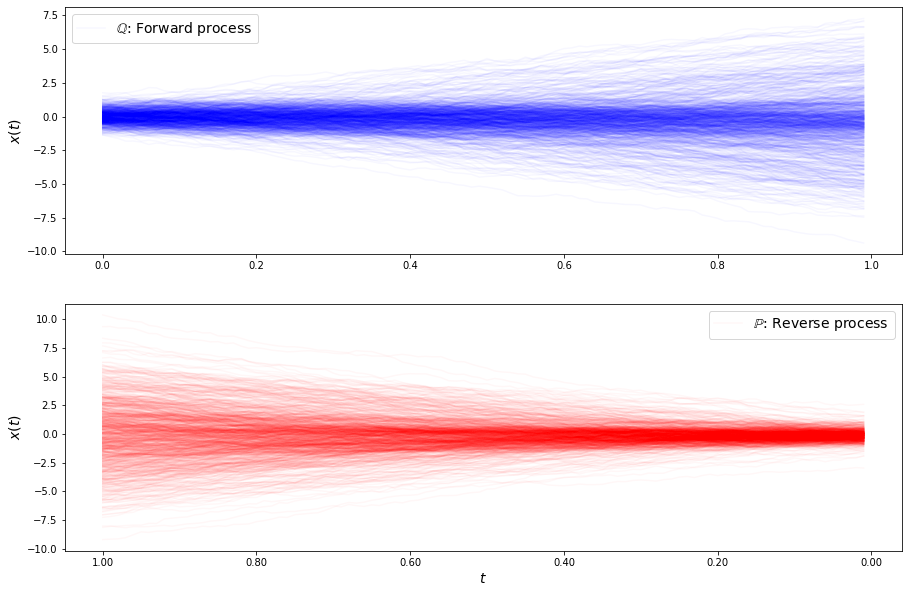

loss b 1.4676339747140028
loss b 1.5175327423783478
loss b 1.4757172568420687
loss b 1.563370252419599
loss b 1.4578919765362186
loss b 1.4762816526958824
loss b 1.5219572574509463
loss b 1.4883057490776797
loss b 1.4559352781648447
loss b 1.4642261015789944
loss b 1.4751365414842752
loss b 1.5020569501058672
loss b 1.435298386657876
loss b 1.4054346048421782
loss b 1.4512211455617625
loss b 1.5297595993826245
loss b 1.4635683611223913
loss b 1.3502373967436991
loss b 1.4143784824325583
loss b 1.4007423342574012
loss b 1.5478535224348136
loss b 1.494932965804891
loss b 1.562796822695994
loss b 1.4837738755132597
loss b 1.4456331865299896
loss b 1.5482671683602507
loss b 1.4765660283722113
loss b 1.4748655791110719
loss b 1.2958021161022122
loss b 1.533353954333731
loss f 1.4782889791525535
loss f 1.1776297918348728
loss f 1.3823397132504351
loss f 1.3705102209506257
loss f 1.4234266251030194
loss f 1.3473932070334516
loss f 1.4191201804030642
loss f 1.3127800478834697
loss f 1.29272257

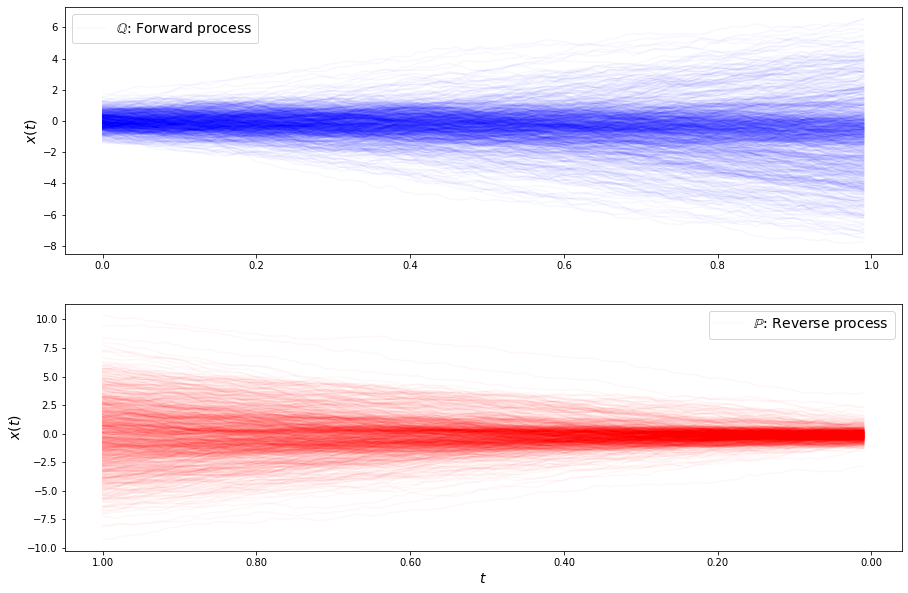

loss b 1.5341378898125577
loss b 1.6062997949529363
loss b 1.599479195072475
loss b 1.5425419448028423
loss b 1.6758881479640801
loss b 1.6103508841047716
loss b 1.5866811789817583
loss b 1.6481180984946797
loss b 1.677688360593106
loss b 1.6337656193174483
loss b 1.4958812309792553
loss b 1.5814232063392968
loss b 1.5466083906642085
loss b 1.5787357229819057
loss b 1.5013315681989763
loss b 1.5083301481490619
loss b 1.5326297186150122
loss b 1.526764482263081
loss b 1.5313317368827388
loss b 1.5474268734036187
loss b 1.5973191434277578
loss b 1.4943718839848057
loss b 1.5334360559181974
loss b 1.5676373035576858
loss b 1.6621297247120543
loss b 1.607595703051029
loss b 1.6427958849219677
loss b 1.5290651029612168
loss b 1.6056230904910191
loss b 1.6144187795861067
loss f 1.4987153234011417
loss f 1.4345744051195815
loss f 1.3693645991994543
loss f 1.3677502495032368
loss f 1.5006589164212623
loss f 1.4041975977428243
loss f 1.4517732801526975
loss f 1.4402184251967922
loss f 1.3311633

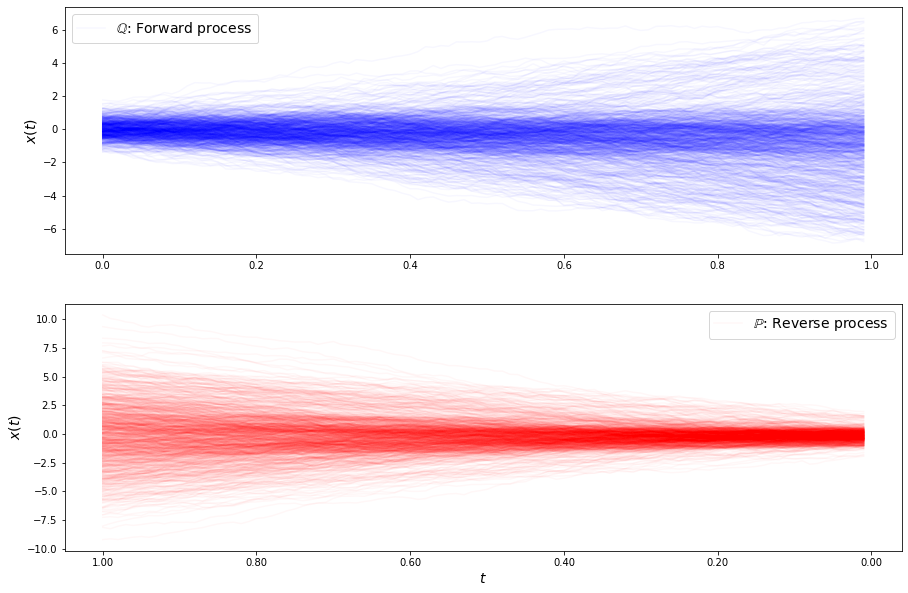

loss b 1.554285614109286
loss b 1.664097883970174
loss b 1.6091666927253125
loss b 1.4625609453187598
loss b 1.6592201532574666
loss b 1.6383591679346041
loss b 1.4958117746037791
loss b 1.5984580519487324
loss b 1.6893869381378512
loss b 1.6876484326877867
loss b 1.6531022442422654
loss b 1.7536736074939474
loss b 1.590591579949372
loss b 1.651755693937087
loss b 1.6708866174640435
loss b 1.5216850236282586
loss b 1.641675454901103
loss b 1.6678598273980256
loss b 1.6652286664558074
loss b 1.5253981708891118
loss b 1.7068463162970426
loss b 1.6485043296088777
loss b 1.7114505090015504
loss b 1.6636365527187558
loss b 1.607542897094359
loss b 1.7492597181606149
loss b 1.5257841914459769
loss b 1.543819762786191
loss b 1.669282854361765
loss b 1.6224740020574486
loss f 1.5184916755209268
loss f 1.590750198226549
loss f 1.3757579819920724
loss f 1.3062581283938466
loss f 1.5142089091468265
loss f 1.404748334695275
loss f 1.526456327417958
loss f 1.361439164392159
loss f 1.339701841876508

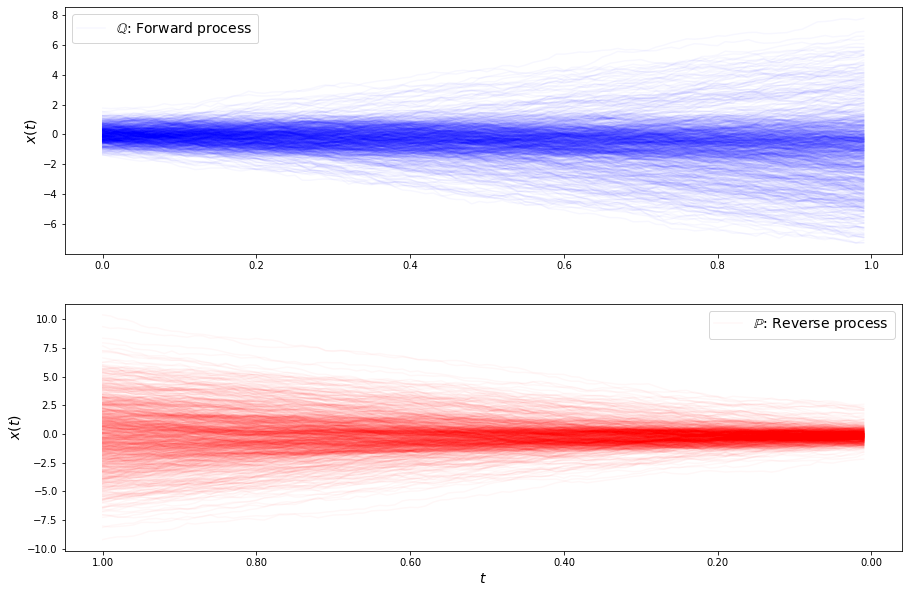

loss b 1.539194900297952
loss b 1.750919594142914
loss b 1.6838533881819853
loss b 1.6032741380016744
loss b 1.5835477775584923
loss b 1.7030551872832238
loss b 1.6764158401010534
loss b 1.6416780525656833
loss b 1.5992066648044798
loss b 1.7287945910987643
loss b 1.6720013415743766
loss b 1.7209916144729147
loss b 1.6214311286420762
loss b 1.6308807334334974
loss b 1.670604105150202
loss b 1.7710066219355651
loss b 1.6460742307401832
loss b 1.6068504004825308
loss b 1.7245840059716537
loss b 1.669725013099334
loss b 1.6872563331898598
loss b 1.7240834996221275
loss b 1.7570684967642594
loss b 1.6604042622679787
loss b 1.7364950129360077
loss b 1.7073809111062634
loss b 1.7121270742186103
loss b 1.6386885157023177
loss b 1.7244915066892907
loss b 1.551720474205544
loss f 1.4801690218814971
loss f 1.4364731228744148
loss f 1.4088601738162176
loss f 1.4454529722993776
loss f 1.453315916137579
loss f 1.3700558660422493
loss f 1.2882722917207736
loss f 1.4035417223970998
loss f 1.415653652

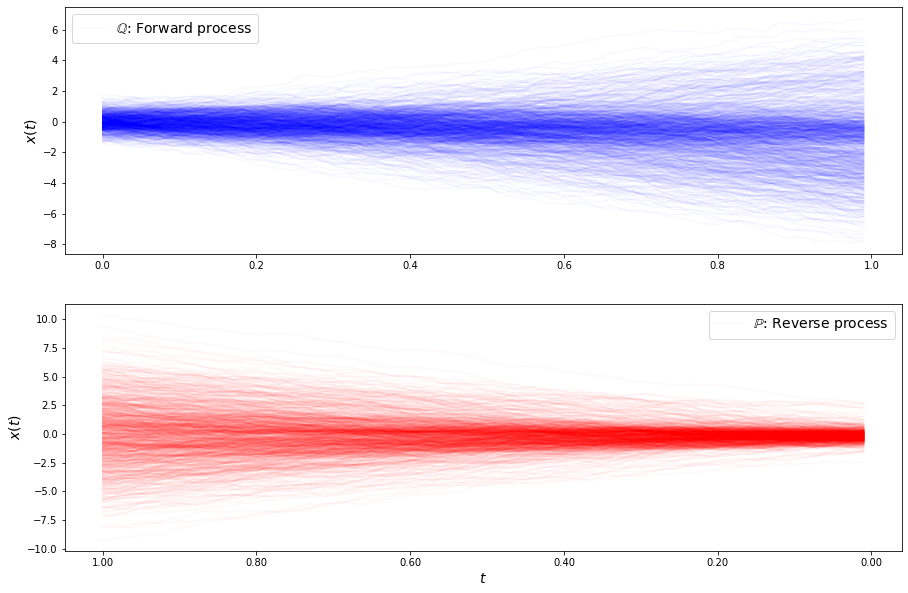

loss b 1.7113733045369424
loss b 1.6581887192667728
loss b 1.7715641348508768
loss b 1.6821948799203883
loss b 1.6157099362071425
loss b 1.6893507537609214
loss b 1.6640129750065846
loss b 1.6989909706375406
loss b 1.7597631242910066
loss b 1.6682436647334775
loss b 1.5829221931488744
loss b 1.5671920790485718
loss b 1.5944397133688444
loss b 1.7780036023774535
loss b 1.6077204162181156
loss b 1.6119015752446157
loss b 1.7488661793830265
loss b 1.682075588162618
loss b 1.6224088393830292
loss b 1.5182231465156668
loss b 1.6898389102143985
loss b 1.670207694022616
loss b 1.6654741466779017
loss b 1.70508273328447
loss b 1.6414163554285532
loss b 1.4841207368790772
loss b 1.6001237954527432
loss b 1.6525844332421167
loss b 1.6703858336588489
loss b 1.6439260293122024
loss f 1.3871067907246897
loss f 1.4033423271047363
loss f 1.4270298401957986
loss f 1.4185729621722016
loss f 1.393540434924269
loss f 1.3673835251349948
loss f 1.3801590680204825
loss f 1.4368309286358538
loss f 1.48647463

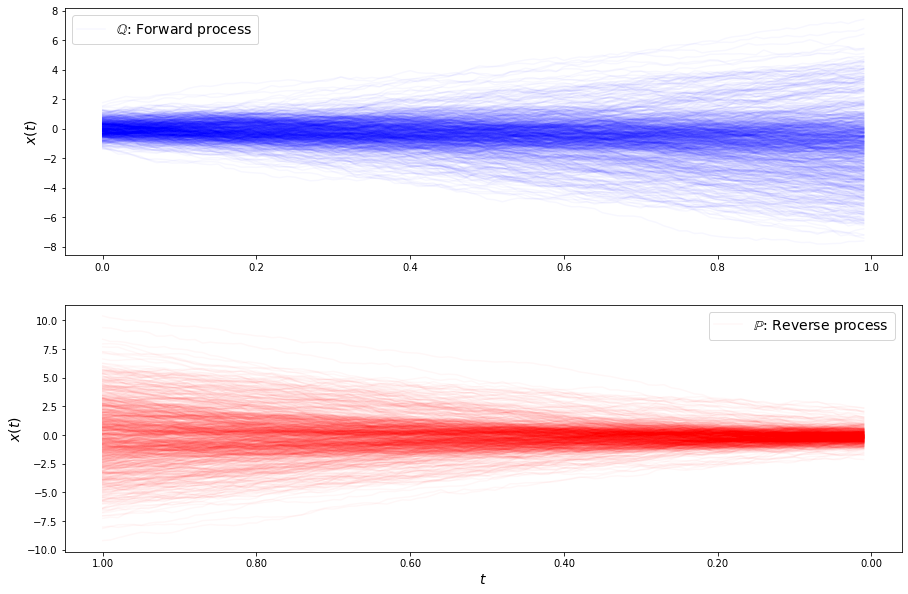

loss b 1.5859568549683984
loss b 1.6348000057862169
loss b 1.6407861846722616
loss b 1.6869391640911933
loss b 1.6669191355143504
loss b 1.692645174188575
loss b 1.5718077655534994
loss b 1.7265447406545302
loss b 1.5091197067422761
loss b 1.5848450665566511
loss b 1.6176503355758287
loss b 1.5653833340688386
loss b 1.4755305558706047
loss b 1.5424096556425262
loss b 1.7166892238913574
loss b 1.555444647267699
loss b 1.660946377408346
loss b 1.6455846224011161
loss b 1.5998881279574186
loss b 1.601155409736771
loss b 1.5798738344093544
loss b 1.6094604321182069
loss b 1.4674711551091049
loss b 1.5764757004772507
loss b 1.555133742423577
loss b 1.5534174755275503
loss b 1.6452425312471302
loss b 1.5615933134534588
loss b 1.6111048574809534
loss b 1.5990623628066025
loss f 1.3662801911716658
loss f 1.3891083617655027
loss f 1.4128854257009742
loss f 1.3222061292485296
loss f 1.448604531970169
loss f 1.4103324966691413
loss f 1.470058232188326
loss f 1.4057412209709421
loss f 1.3201472535

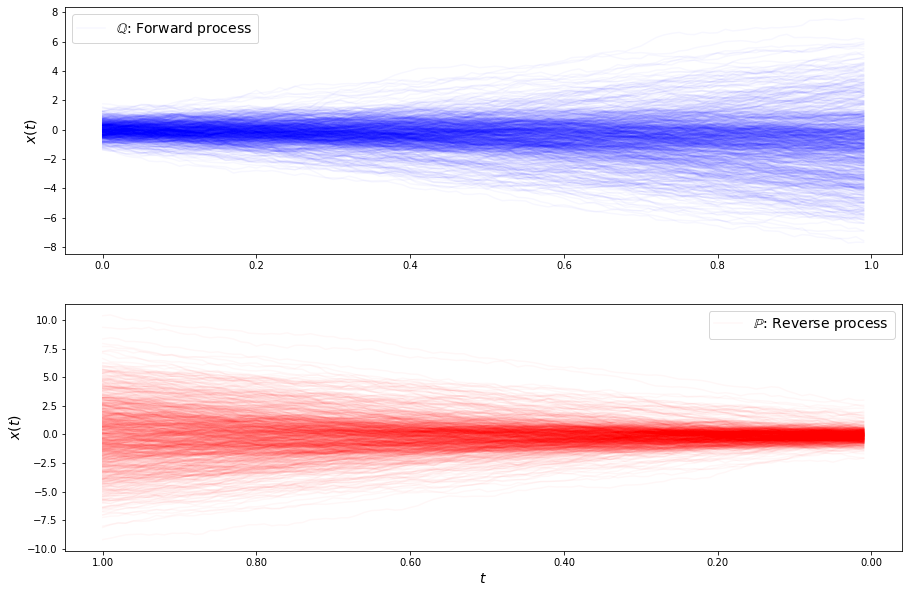

loss b 1.5739569732616263
loss b 1.5001610934487044
loss b 1.4838205773543351
loss b 1.4971370921777838
loss b 1.5589751503212956
loss b 1.373146907308882
loss b 1.5825882214255638
loss b 1.4081971664474475
loss b 1.6945798247430641
loss b 1.6034820636292109
loss b 1.5259998626606317
loss b 1.4031213895774253
loss b 1.5788316024658453
loss b 1.5661085526807315
loss b 1.4778996923598866
loss b 1.5675335679818474
loss b 1.5069725517326933
loss b 1.3578430872878704
loss b 1.4223039535785342
loss b 1.5951845298298113
loss b 1.4529274347221055
loss b 1.4034502997272211
loss b 1.5319978606709972
loss b 1.6249950866785057
loss b 1.5397442133860846
loss b 1.569514170460313
loss b 1.5971285048040247
loss b 1.508786973383998
loss b 1.591843915544324
loss b 1.5353661833193675
loss f 1.396150276312119
loss f 1.182443853463756
loss f 1.2761685606895086
loss f 1.1681894419622425
loss f 1.3391153794255168
loss f 1.3399672227422692
loss f 1.2192142109656263
loss f 1.3217365197147941
loss f 1.302794571

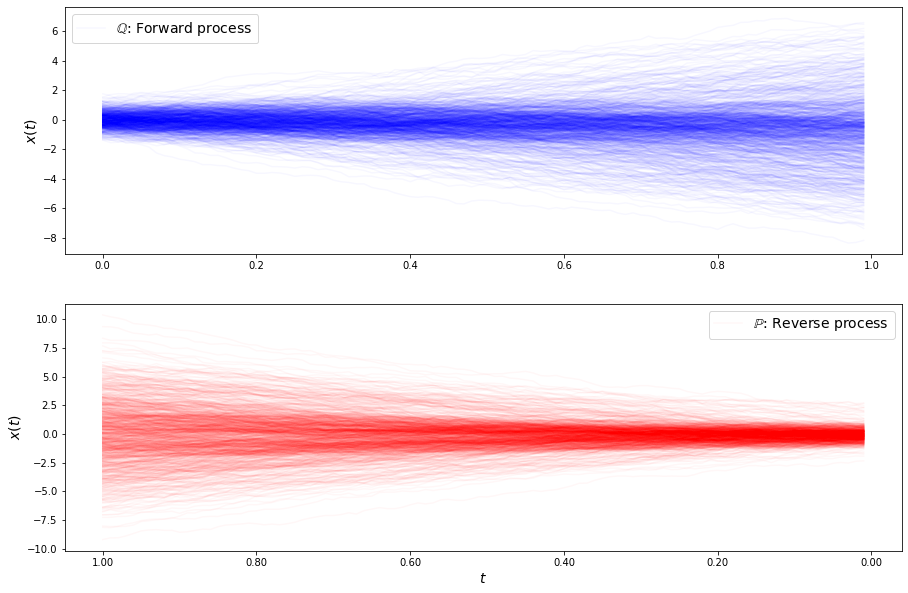

loss b 1.430830909606759
loss b 1.5654227921691137
loss b 1.2722579325044479
loss b 1.3779233112664768
loss b 1.4930724422220443
loss b 1.4282380201625058
loss b 1.5440129513491059
loss b 1.5355824908590332
loss b 1.5145821796878696
loss b 1.3475335530851646
loss b 1.366427260271124
loss b 1.4938928500465352
loss b 1.4682926271671684
loss b 1.4700250582544456
loss b 1.4867960135598721
loss b 1.3792229045837483
loss b 1.4679470992889971
loss b 1.4227354561584036
loss b 1.3894854847202336
loss b 1.3609367892746862
loss b 1.5358766367686083
loss b 1.4006776561101884
loss b 1.4256308064676817
loss b 1.5028632145287821
loss b 1.4822724817973207
loss b 1.431788373453608
loss b 1.33285010670175
loss b 1.3941367435594092
loss b 1.4092861579901077
loss b 1.5058902656288815
loss f 1.1592653808515028
loss f 1.2082373152072605
loss f 1.1939833716741146
loss f 1.2589677728174142
loss f 1.1481010682171675
loss f 1.1141254368066766
loss f 1.214482916538677
loss f 1.0494980866753405
loss f 1.159697394

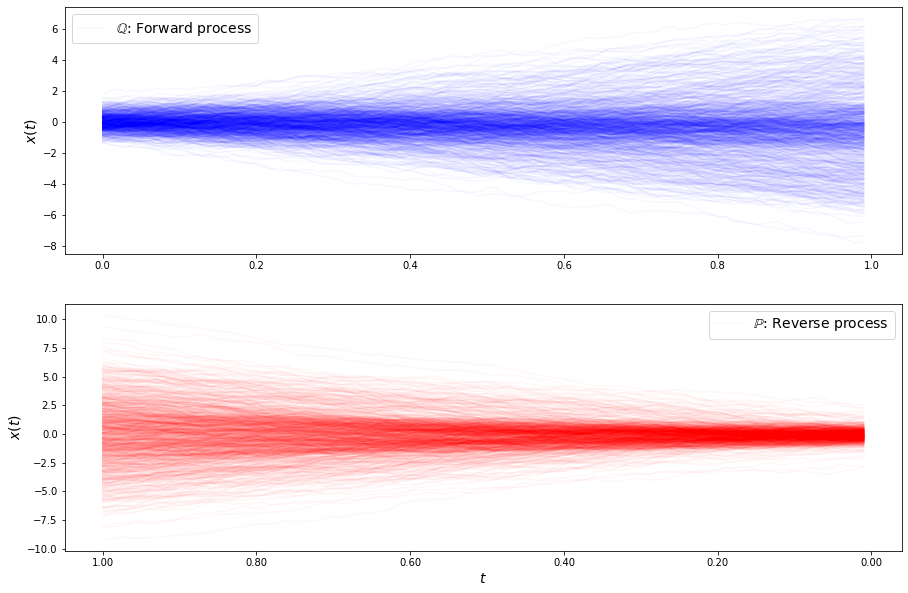

loss b 1.335460733996693
loss b 1.3541871759361204
loss b 1.4422049867107016
loss b 1.4510238099758708
loss b 1.3322495693274727
loss b 1.3209981601794891
loss b 1.3877712383202114
loss b 1.3011464994647013
loss b 1.3341873970130427
loss b 1.3843285824796314
loss b 1.4075312857590152
loss b 1.4717893748786708
loss b 1.3075692795052059
loss b 1.3491615774335879
loss b 1.2241736484227497
loss b 1.3772383918107907
loss b 1.3045578996296499
loss b 1.339047009496827
loss b 1.3247375794386427
loss b 1.4682046554698347
loss b 1.4071457503035
loss b 1.4505529204479701
loss b 1.4626244875257566
loss b 1.3252276045047338
loss b 1.3688017911416674
loss b 1.2718208577314978
loss b 1.3740042274705215
loss b 1.3768609410095858
loss b 1.485390982593169
loss b 1.2961771331804415
loss f 1.073957118940242
loss f 1.0860711068411242
loss f 1.081727073703728
loss f 1.0955246539176258
loss f 1.0458133814532304
loss f 1.039590454285744
loss f 1.1499691215720278
loss f 1.1220609296814825
loss f 1.145142965354

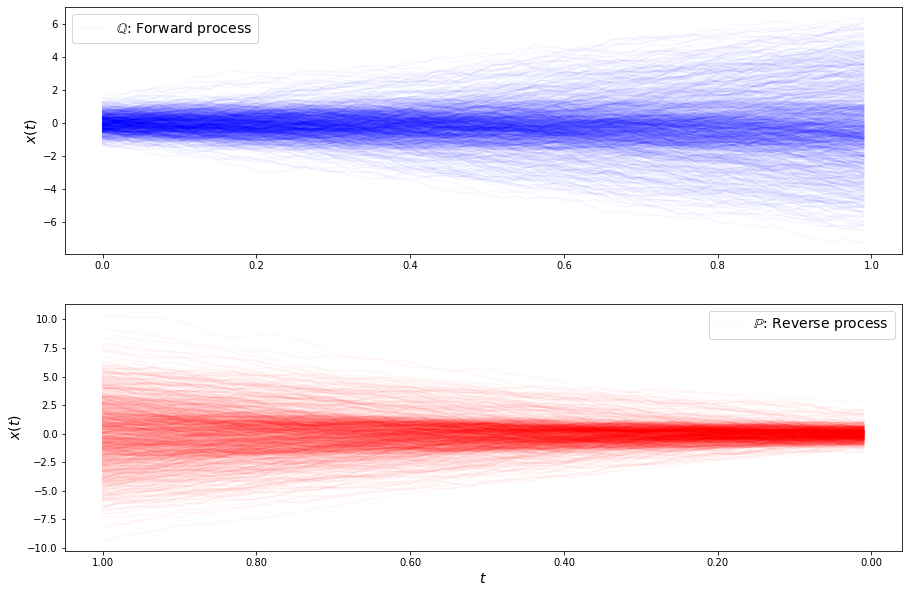

loss b 1.3404340049454515
loss b 1.4441046944648281
loss b 1.3444275436456494
loss b 1.358256274205257
loss b 1.3698037004406467
loss b 1.3917169083521328
loss b 1.3103876203021825
loss b 1.3582483781970347
loss b 1.4124445406690325
loss b 1.3918968564207246
loss b 1.349238158882538
loss b 1.2078645152563827
loss b 1.2408067142104764
loss b 1.34796336073141
loss b 1.2622909054819729
loss b 1.4284256989069777
loss b 1.3905736807046156
loss b 1.3949510174117767
loss b 1.2469146057525562
loss b 1.3118488187592943
loss b 1.340095129916163
loss b 1.2992133660027727
loss b 1.2316042475303757
loss b 1.3299400689041705
loss b 1.2610547555785079
loss b 1.3501873455819662
loss b 1.3324633655699634
loss b 1.3329374024893845
loss b 1.3148476780093168
loss b 1.3559125087408908
loss f 1.0321217944774264
loss f 1.019705204985762
loss f 1.1016879544058529
loss f 1.0217089288417658
loss f 1.0784761290151874
loss f 0.9914542807411884
loss f 1.2182164804383009
loss f 1.1938840468145433
loss f 1.014166597

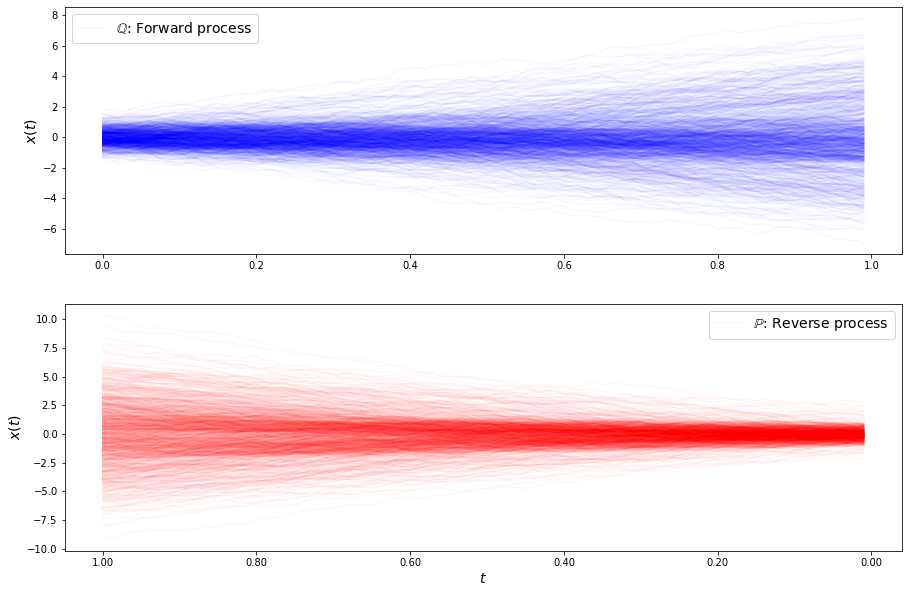

loss b 1.1688739893950473
loss b 1.3079978472232454
loss b 1.3594367898329438
loss b 1.3393196895687327
loss b 1.2721432543810938
loss b 1.2829357030879542
loss b 1.216543464108909
loss b 1.2929531334006705
loss b 1.375870764917166
loss b 1.3752666867743588
loss b 1.3842149692094243
loss b 1.2187359881431188
loss b 1.3142136951677215
loss b 1.3066176573994688
loss b 1.4444413367477396
loss b 1.326291145745872
loss b 1.4462625118234438
loss b 1.3474165437631183
loss b 1.370033819860855
loss b 1.2893255900954625
loss b 1.4264194541503143
loss b 1.3644641242866185
loss b 1.326417710962995
loss b 1.335888123827441
loss b 1.3939337319300529
loss b 1.3358367882671065
loss b 1.326958377549505
loss b 1.3182238528835233
loss b 1.3296559339793534
loss b 1.3544673569662184
loss f 1.0743325102312435
loss f 1.2060371427750927
loss f 1.1531337774460935
loss f 1.1253301879249298
loss f 1.1879936009458438
loss f 1.0781765629790145
loss f 1.0478104847123273
loss f 1.0054857828156656
loss f 1.0892649948

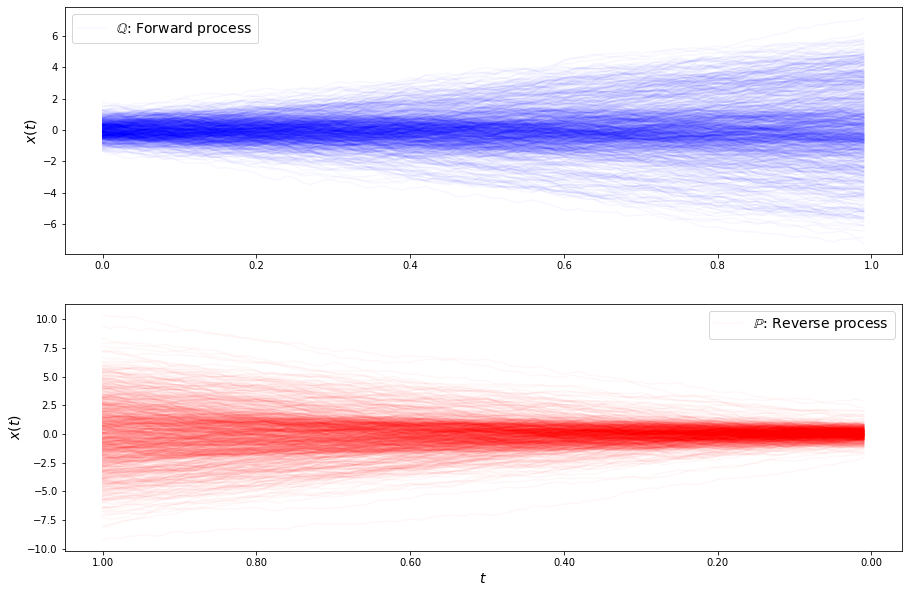

loss b 1.3504669135211504
loss b 1.2701528895284897
loss b 1.4444595599728731
loss b 1.3661637381034843
loss b 1.3377115296796769
loss b 1.3318479215812282
loss b 1.4086331192826131
loss b 1.4241080326077797
loss b 1.4086416054590984
loss b 1.344929314888489
loss b 1.3253303513650785
loss b 1.4839222659116889
loss b 1.3520592413643207
loss b 1.4022086830429592
loss b 1.382930369628506
loss b 1.3774185099075174
loss b 1.4190487526258386
loss b 1.5012268679697125
loss b 1.3194607457668435
loss b 1.4258890176942158
loss b 1.4717303404526112
loss b 1.3230242627083022
loss b 1.444265277571905
loss b 1.4251186377864637
loss b 1.3434130816682537
loss b 1.474731019828052
loss b 1.4772037527324176
loss b 1.454618091280506
loss b 1.4078679659973807
loss b 1.4103343706408136
loss f 1.1391696065124999
loss f 1.1200012828233599
loss f 1.0406449922679974
loss f 1.104115989140611
loss f 1.124252597429838
loss f 0.9928942671220378
loss f 1.182834422480026
loss f 1.1334407565669906
loss f 1.09738155610

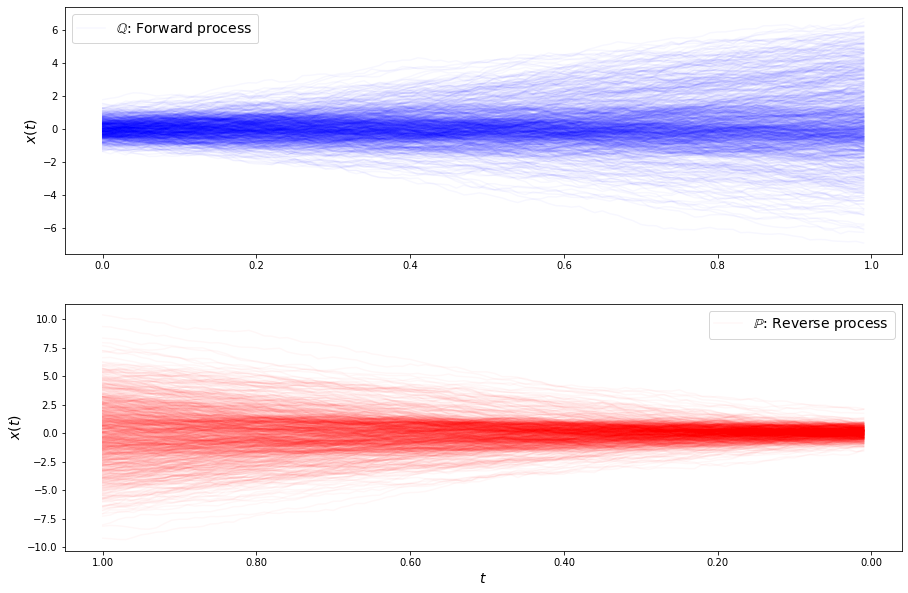

loss b 1.58414548592032
loss b 1.3815579828551765
loss b 1.4574107179536078
loss b 1.4534804892727908
loss b 1.404418259844166
loss b 1.4765338331809432
loss b 1.5453123946923037
loss b 1.4430035341877785
loss b 1.5549012894361238
loss b 1.507958436243111
loss b 1.341690954428626
loss b 1.5122856775056224
loss b 1.425138083866849
loss b 1.4702446888115415
loss b 1.5466363285605116
loss b 1.5466313173214759
loss b 1.470567178228804
loss b 1.395256140890676
loss b 1.449999181849091
loss b 1.3218825116672928
loss b 1.454838797890193
loss b 1.5402118392984128
loss b 1.4441379925978644
loss b 1.494338715177339
loss b 1.494920998742584
loss b 1.4570843669163231
loss b 1.5176485745719202
loss b 1.4698121189918005
loss b 1.5896713221380134
loss b 1.4798431375356438
loss f 1.1235477328636005
loss f 1.1475397743152462
loss f 1.1946391559176597
loss f 1.3109681165516751
loss f 1.1813126169995583
loss f 1.206150533182793
loss f 1.2336804522460183
loss f 1.1268466128326502
loss f 1.1399446320334585

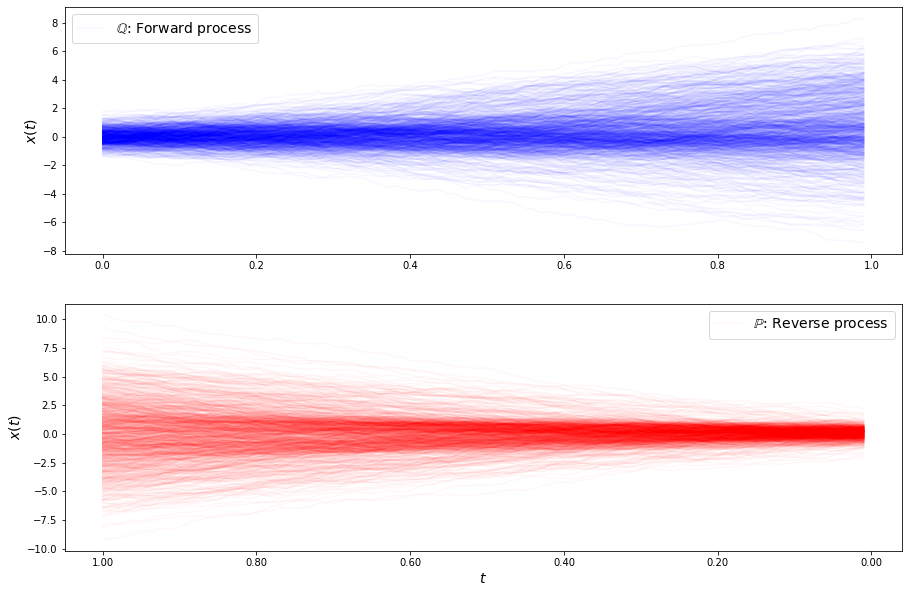

loss b 1.544196850344301
loss b 1.577940116012373
loss b 1.6627615259353759
loss b 1.592713712711801
loss b 1.581906874541693
loss b 1.4956691310732388
loss b 1.519433501803346
loss b 1.595337500032303
loss b 1.610035163980205
loss b 1.5344622990085144
loss b 1.5608698032035686
loss b 1.4939207973548025
loss b 1.5080219571512703
loss b 1.609094924654884
loss b 1.532796206368777
loss b 1.5414924885546448
loss b 1.496451939279816
loss b 1.6026961527071717
loss b 1.621817491097877
loss b 1.5356056135599654
loss b 1.4693167285248916
loss b 1.4479544526327437
loss b 1.5160942525919578
loss b 1.6281997605631422
loss b 1.4889334236136056
loss b 1.5060806451935405
loss b 1.597188143727697
loss b 1.5069741516323703
loss b 1.5810197109774597
loss b 1.6310082644820882
loss f 1.2039478367534537
loss f 1.1287227383474498
loss f 1.3478604736204394
loss f 1.3684275957183896
loss f 1.3352865982614823
loss f 1.2718202846395597
loss f 1.27733103013991
loss f 1.4417198237640998
loss f 1.325622964141611
l

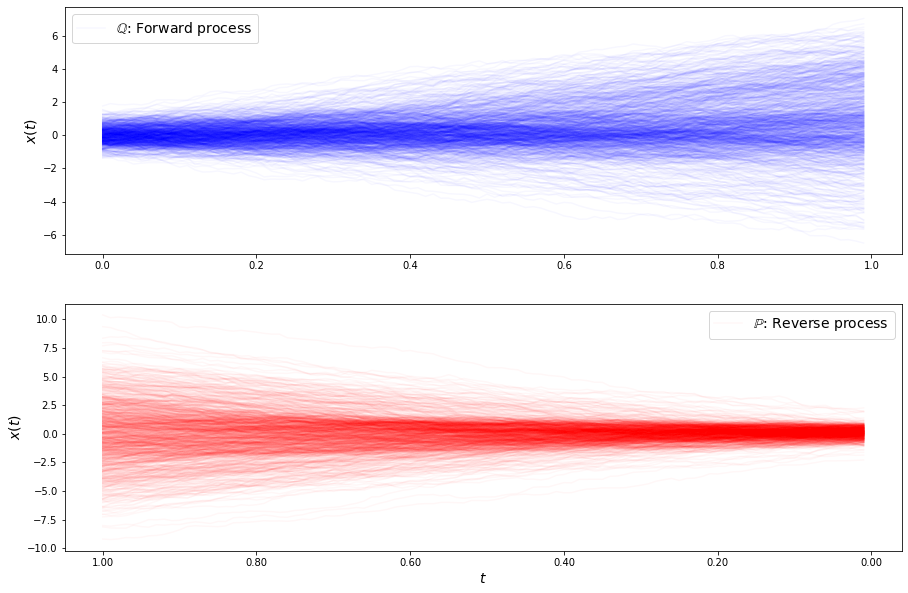

loss b 1.606152499246241
loss b 1.6598834200544155
loss b 1.6845831804519427
loss b 1.5909125695401296
loss b 1.6122960551103154
loss b 1.5653796845327437
loss b 1.6898565245109125
loss b 1.6177597170951605
loss b 1.7194593001320344
loss b 1.6918442243513465
loss b 1.5988355318088467
loss b 1.623592930870653
loss b 1.7474743652802118
loss b 1.6683481864467076
loss b 1.6469785738539229
loss b 1.6637739362840387
loss b 1.5327148401320514
loss b 1.705948321614063
loss b 1.618920574978816
loss b 1.5817946608074156
loss b 1.6593828635413426
loss b 1.6019069380597386
loss b 1.6869140951262922
loss b 1.646479421794589
loss b 1.6560299323347671
loss b 1.6500076331004219
loss b 1.583187006571372
loss b 1.6405321437416307
loss b 1.6616247741378036
loss b 1.760027294338519
loss f 1.426450847483652
loss f 1.4563123822885322
loss f 1.5212408387659329
loss f 1.36305426073117
loss f 1.3277230414044474
loss f 1.264840752932369
loss f 1.3924948195381301
loss f 1.49280027878048
loss f 1.2592094059543169

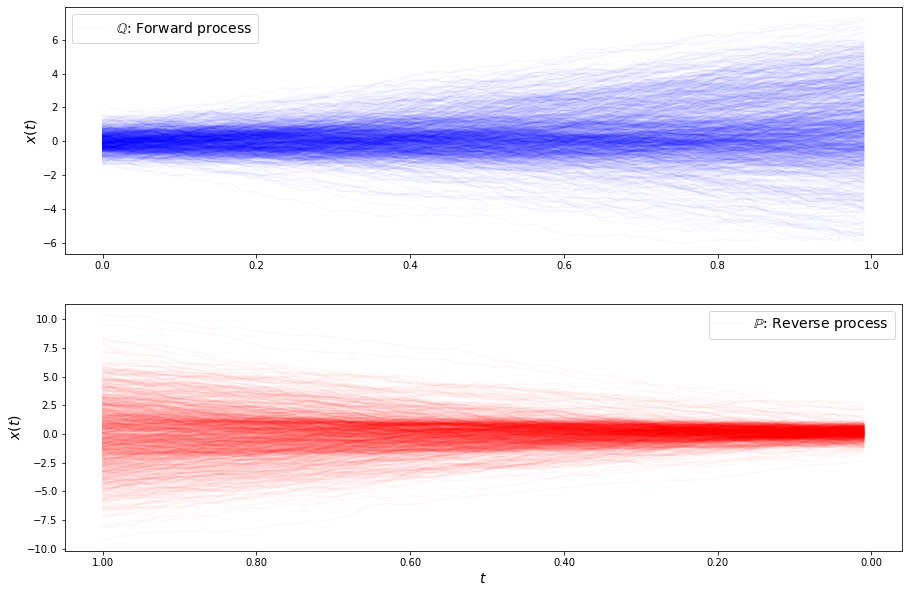

loss b 1.7886541147391977
loss b 1.7441752041936727
loss b 1.6826917759315196
loss b 1.6362755646702085
loss b 1.6152770316771514
loss b 1.834385976265557
loss b 1.6405184620562614
loss b 1.7578159884545403
loss b 1.8866857714521903
loss b 1.7795802873979671
loss b 1.7353424436271627
loss b 1.8146538864614443
loss b 1.7083381983355408
loss b 1.8024980838680682
loss b 1.7024587061203946
loss b 1.7162331035484109
loss b 1.6011429472657763
loss b 1.795116673876144
loss b 1.681972216166866
loss b 1.772497885904552
loss b 1.7657557755249451
loss b 1.744023126008528
loss b 1.7292122236175036
loss b 1.6837017835648007
loss b 1.5907810915572418
loss b 1.7636499436535946
loss b 1.6131442703488785
loss b 1.7875388202836955
loss b 1.6768292197669619
loss b 1.6862048970417634
loss f 1.3091106523392035
loss f 1.3371876866142556
loss f 1.4369459435876455
loss f 1.4609908831833696
loss f 1.5115337137637612
loss f 1.318207165291077
loss f 1.464196318292112
loss f 1.625622096237424
loss f 1.54785479590

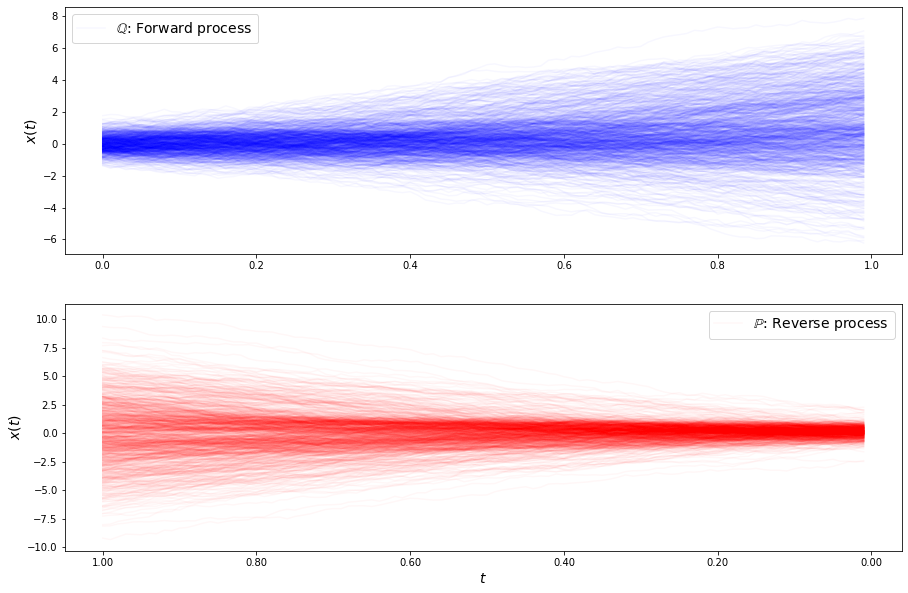

loss b 1.6251756629166436
loss b 1.7343379104521655
loss b 1.8116692900025133
loss b 1.7014050629885413
loss b 1.7182392434660243
loss b 1.7171950503382387
loss b 1.7523250539685316
loss b 1.7993918263766684
loss b 1.7801956275951347
loss b 1.7011175680443549
loss b 1.738675393227497
loss b 1.7967694990242584
loss b 1.7476024355349324
loss b 1.7837704823376723
loss b 1.7868302981345159
loss b 1.7503628652075545
loss b 1.7330250727601466
loss b 1.7495507962742929
loss b 1.7428220278183377
loss b 1.6866598047560355
loss b 1.764498818342907
loss b 1.6906792132850934
loss b 1.8047679913006864
loss b 1.6589014272202782
loss b 1.8120340847673206
loss b 1.7103310919723138
loss b 1.7260343445026078
loss b 1.7844975044285647
loss b 1.782768885922001
loss b 1.7280696355189404
loss f 1.48453832974723
loss f 1.3910918679926538
loss f 1.595781679898486
loss f 1.357211237841427
loss f 1.3080810390186928
loss f 1.4512404131410752
loss f 1.4866807164999642
loss f 1.1871090753063267
loss f 1.4597275449

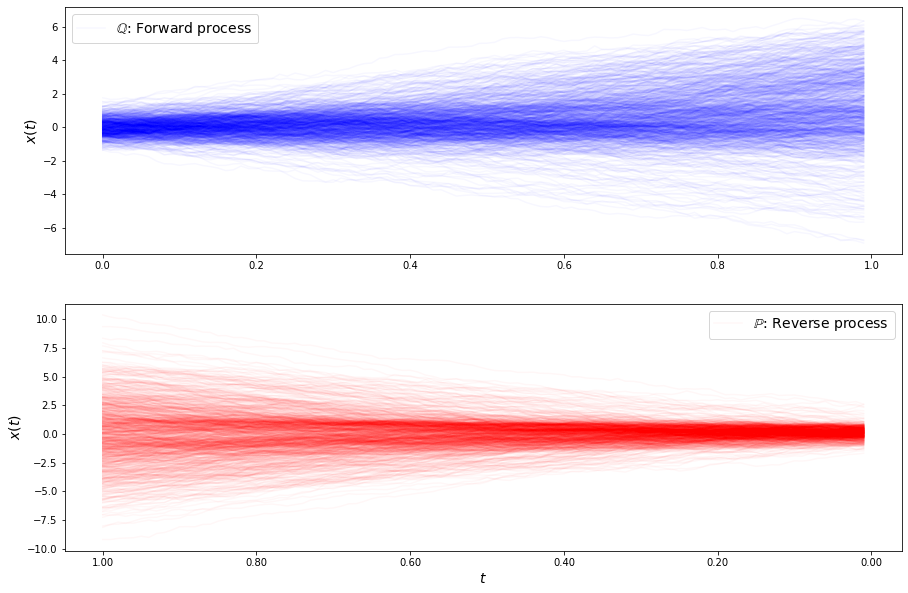

loss b 1.759099529777596
loss b 1.7385010168236326
loss b 1.69424816278074
loss b 1.6745400501420882
loss b 1.6640302540711154
loss b 1.7353588151050694
loss b 1.7379811881902634
loss b 1.7207672957955051
loss b 1.5818975797144548
loss b 1.7702373088046288
loss b 1.7634925696985706
loss b 1.7032124787522178
loss b 1.6762745216611301
loss b 1.8027314638912824
loss b 1.6882600300857666
loss b 1.7679507848668121
loss b 1.7609459476712446
loss b 1.6940165803153775
loss b 1.654864524330961
loss b 1.6674772405396268
loss b 1.6718352699429362
loss b 1.8137212443726785
loss b 1.7466880624586112
loss b 1.537716330928192
loss b 1.761988568771596
loss b 1.7769475023605774
loss b 1.6939403592335867
loss b 1.7124956838364815
loss b 1.71198496853162
loss b 1.7342740580765947
loss f 1.3520349053635732
loss f 1.4213938423197754
loss f 1.3992270570381518
loss f 1.4315481073499123
loss f 1.4119845476573363
loss f 1.3605220786904166
loss f 1.524493183110917
loss f 1.525380379609829
loss f 1.2817680159923

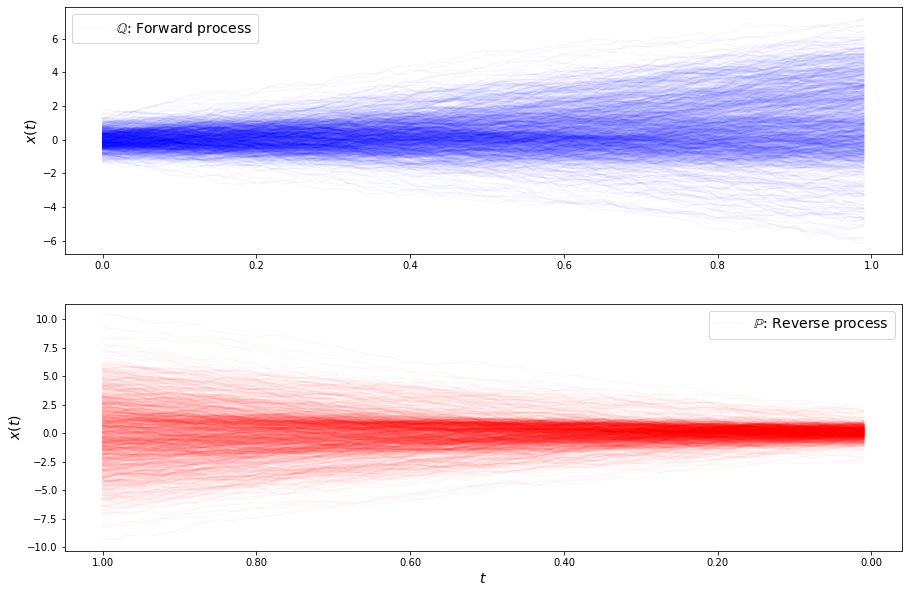

loss b 1.724586081541978
loss b 1.6267091831004548
loss b 1.573061214570566
loss b 1.6612887547223392
loss b 1.6598581522281488
loss b 1.5715876362961545
loss b 1.67912573905704
loss b 1.6610404966122967
loss b 1.6315289740073844
loss b 1.6509725301544251
loss b 1.640407256951592
loss b 1.669150684118402
loss b 1.6116188261294475
loss b 1.6908015715347648
loss b 1.593263053674252
loss b 1.6580619730767485
loss b 1.7487826334311607
loss b 1.6102660650367522
loss b 1.6649943319793483
loss b 1.555548402407386
loss b 1.7025861675489566
loss b 1.6124952046849765
loss b 1.6117676524337918
loss b 1.6821570179920604
loss b 1.5645070671453296
loss b 1.5915009404197649
loss b 1.6112293645525613
loss b 1.5772432880842515
loss b 1.6524465468162535
loss b 1.56661322105385
loss f 1.3383024235162404
loss f 1.3038073294405554
loss f 1.310150769184004
loss f 1.3863621469339908
loss f 1.4251491672640475
loss f 1.2806844916109033
loss f 1.3598808947614727
loss f 1.2826408347086529
loss f 1.36324214210556

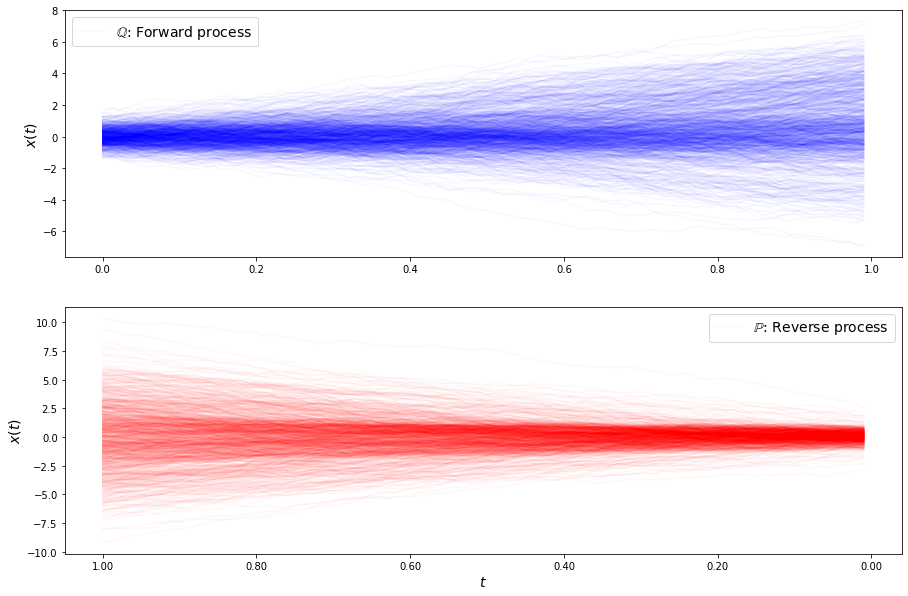

loss b 1.4046433959174396
loss b 1.5672290577383161
loss b 1.4971945571425205
loss b 1.595440268882783
loss b 1.5630435813276706
loss b 1.4828989587764947
loss b 1.6072145056508524
loss b 1.5147643059129152
loss b 1.549535518093933
loss b 1.6311119101740437
loss b 1.5106203225218537
loss b 1.5194548030239245
loss b 1.420621130660422
loss b 1.671093542626971
loss b 1.5446032075677032
loss b 1.5307097489555346
loss b 1.4920837979467978
loss b 1.5794320146296177
loss b 1.486314434894022
loss b 1.5913228785664377
loss b 1.5154762362969338
loss b 1.4276790646758084
loss f 1.3237193361456119
loss f 1.2106184771592872
loss f 1.192415095540279
loss f 1.148112323360292
loss f 1.2157047556897398
loss f 1.2527299195827255
loss f 1.2129144724153798
loss f 1.2814306478397501
loss f 1.2224442524625179
loss f 1.2314286353819874
loss f 1.1375562127524916
loss f 1.1973949834149258
loss f 1.120779328899549
loss f 1.1659571487029816
loss f 1.286315369273513
loss f 1.2666108028266936
loss f 1.267652650770

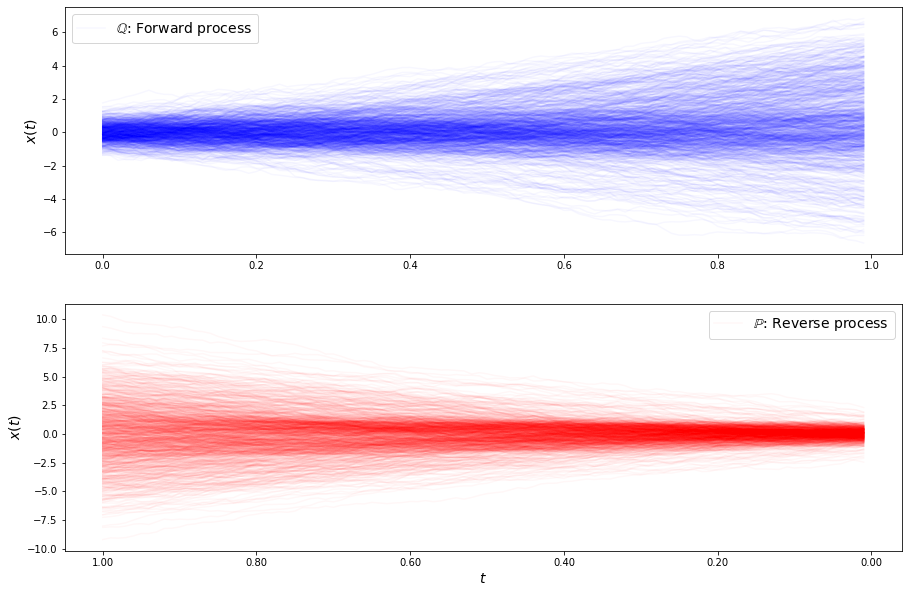

loss b 1.476248684110387
loss b 1.444118360433985
loss b 1.4088905603886333
loss b 1.4794401098615868
loss b 1.4994833678002504
loss b 1.4566157208019848
loss b 1.5986691004747031
loss b 1.530511199352994
loss b 1.590582806861186
loss b 1.4681961114369637
loss b 1.512436286039158
loss b 1.5164626074862246
loss b 1.50192070967005
loss b 1.4070279745218115
loss b 1.3965968214986217
loss b 1.4268340420020005
loss b 1.4671195092891292
loss b 1.4933731931766818
loss b 1.354411724703259
loss b 1.450790905512369
loss b 1.4492704325045918
loss b 1.4578268723023513
loss b 1.3594347602891537
loss b 1.460569734965994
loss b 1.4634521842903963
loss b 1.3284727365564313
loss b 1.467742713841108
loss b 1.4489405084837552
loss b 1.5249430889774938
loss b 1.4230465391524776
loss f 1.0019385502470275
loss f 1.1346131882036563
loss f 0.9318496227054752
loss f 1.203464834791199
loss f 1.1577143139924118
loss f 1.0605241323461858
loss f 1.0888255077673452
loss f 1.140116705345848
loss f 1.2044975911081137

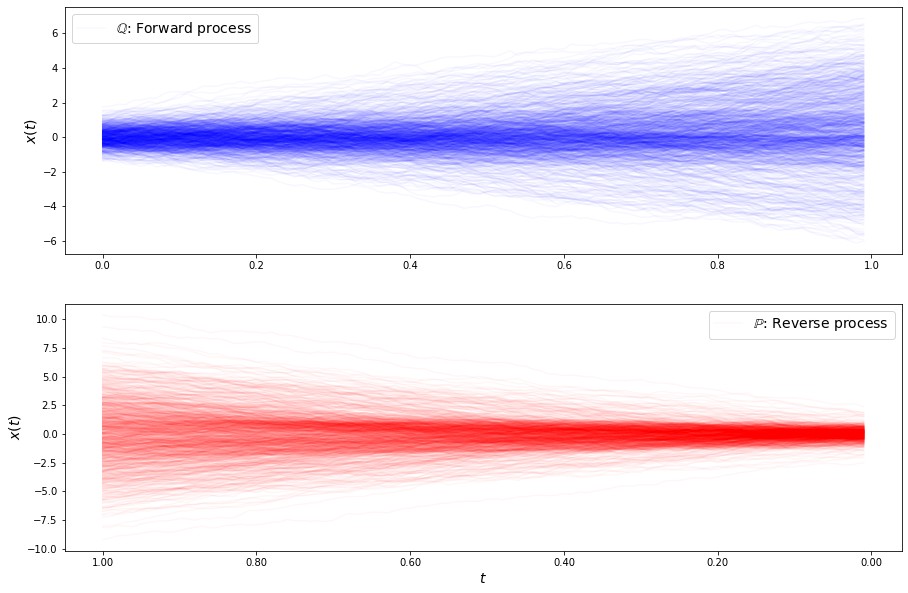

loss b 1.2709406648418196
loss b 1.3774145284977992
loss b 1.4731183704662283
loss b 1.577424231650562
loss b 1.4041115354270457
loss b 1.3781301653863092
loss b 1.3983225217071025
loss b 1.4744622834022085
loss b 1.4435708928934645
loss b 1.3005412937029244
loss b 1.4509763716940274
loss b 1.5208899285511746
loss b 1.3744987025926845
loss b 1.3487711316267101
loss b 1.347719869371665
loss b 1.2696530042870844
loss b 1.3632382376423215
loss b 1.316608836054593
loss b 1.4397084248202117
loss b 1.3398612156613787
loss b 1.2774480716166896
loss b 1.4735527714364327
loss b 1.365626361779915
loss b 1.2807056705768756
loss b 1.295848342508668
loss b 1.3543417096805197
loss b 1.3060898897001532
loss b 1.2675928645801857
loss b 1.3538544609078076
loss b 1.399993152246965
loss f 0.9828632011984484
loss f 1.0377877900034007
loss f 1.0271650397007073
loss f 1.143029103876243
loss f 1.119931070384435
loss f 1.1634799269881093
loss f 0.913065628444473
loss f 1.0499663761945803
loss f 1.181665184750

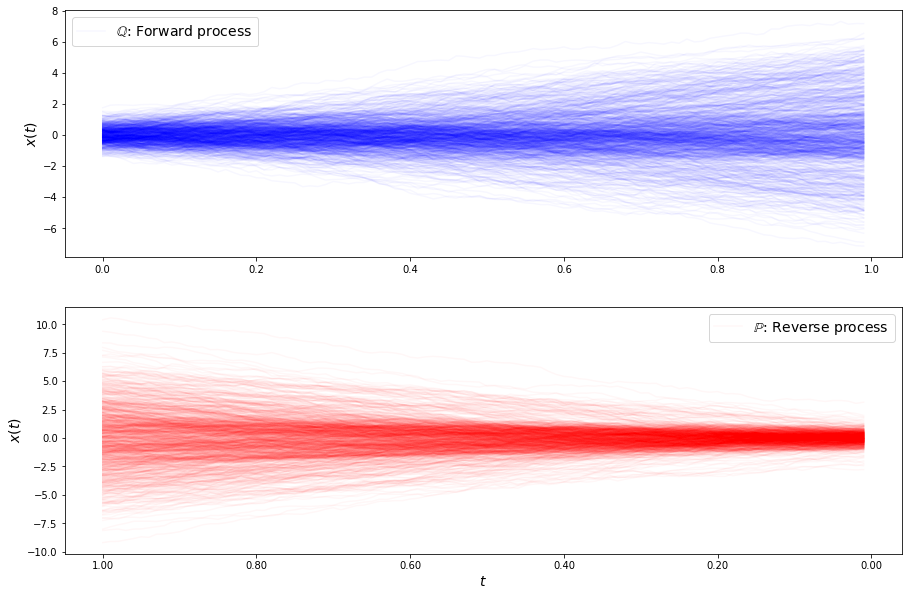

loss b 1.3721409436427037
loss b 1.4370381300837567
loss b 1.3403936133238712
loss b 1.4487621358929477
loss b 1.3680530427305782
loss b 1.3373260607692388
loss b 1.4395596434155844
loss b 1.3569864550622832
loss b 1.4016702362913442
loss b 1.3600599384607024
loss b 1.4514964180545697
loss b 1.3449660621272694
loss b 1.4002306821021502
loss b 1.3356175336290317
loss b 1.3660306357835221
loss b 1.3740752502275868
loss b 1.4123047768910406
loss b 1.3364987135543203
loss b 1.2568579079853102
loss b 1.3536483391782672
loss b 1.4155405328679824
loss b 1.263700643261089
loss b 1.4165490206572087
loss b 1.4284383409943326
loss b 1.3842120437350989
loss b 1.4066928193669896
loss b 1.41795054020452
loss b 1.4212566108200173
loss b 1.4962403691678208
loss b 1.4157569021229768
loss f 0.9919369539116828
loss f 1.034207522014881
loss f 1.1010556350664538
loss f 0.8423832654221758
loss f 1.0128059128789302
loss f 0.9580278835475063
loss f 1.0388327937072939
loss f 1.0394198434461903
loss f 1.0114949

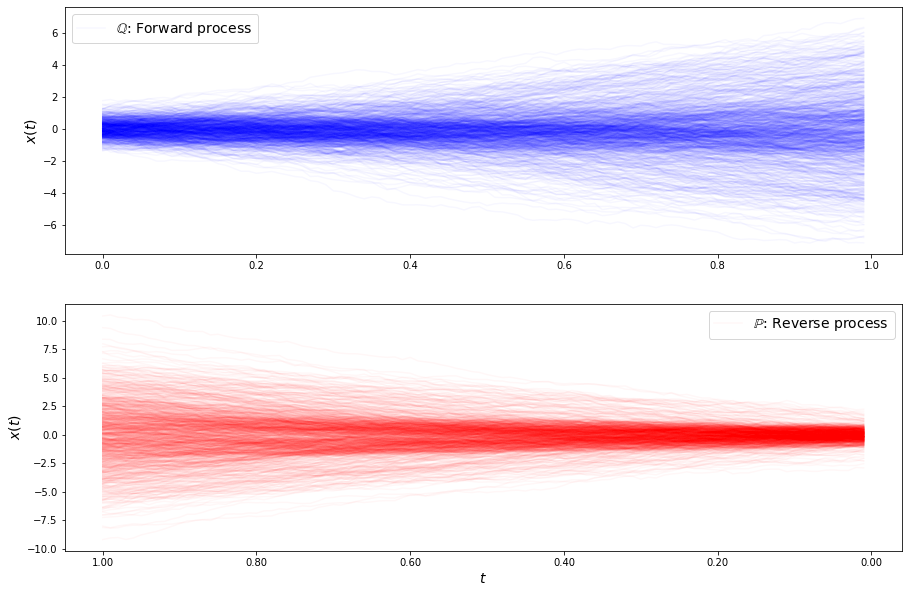

loss b 1.339926116164982
loss b 1.290955893292628
loss b 1.1969640907369392
loss b 1.4322562002302517
loss b 1.4744405261493776
loss b 1.376083236356797
loss b 1.3675207259129176
loss b 1.3389402778007928
loss b 1.4254683126018068
loss b 1.423608133100086
loss b 1.3818577035505428
loss b 1.466195960974566
loss b 1.2909528703539428
loss b 1.3605139574910632
loss b 1.4314591899540767
loss b 1.3672077952310275
loss b 1.4405548895945324
loss b 1.4483635286303242
loss b 1.3341449899227826
loss b 1.391177005242004
loss b 1.2560510877000572
loss b 1.390162558390475
loss b 1.4103612503403025
loss b 1.4020970392633623
loss b 1.47171425557259
loss b 1.3300129576999509
loss b 1.3805897121352677
loss b 1.3391361077494495
loss b 1.2714806320870238
loss b 1.2715358746872294
loss f 0.910177583720616
loss f 0.9407413658700997
loss f 1.059280544925072
loss f 1.036450298080826
loss f 1.084454677520835
loss f 0.9635461754132526
loss f 0.922449940686251
loss f 0.9806341132554415
loss f 0.9577027791244269


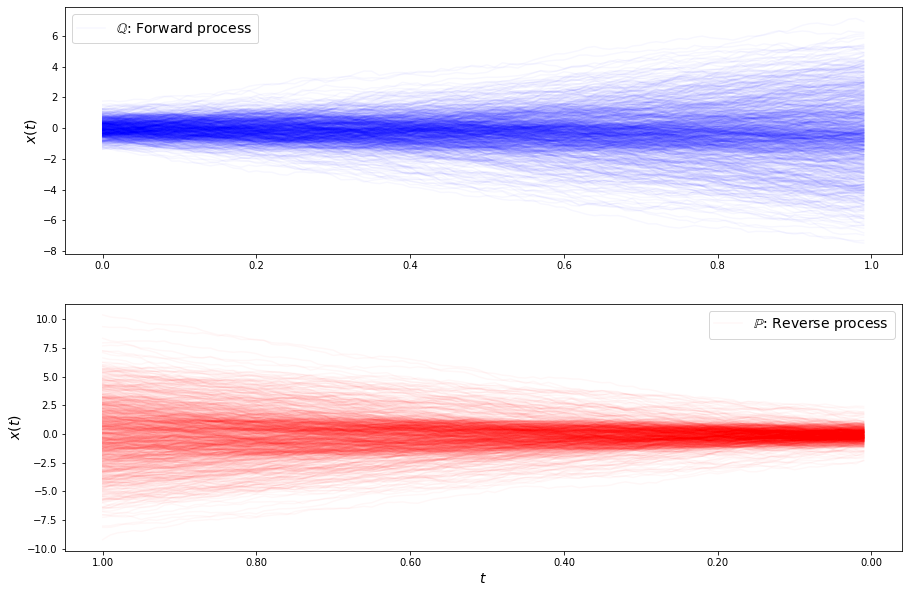

loss b 1.4064998512483637
loss b 1.4937164571599157
loss b 1.423350296905122
loss b 1.4276538217729355
loss b 1.455609062347851
loss b 1.4256036833832744
loss b 1.354701996943976
loss b 1.3407682605166422
loss b 1.2231629406835978
loss b 1.394519741127726
loss b 1.4761719484932492
loss b 1.450642503034596
loss b 1.3114658377993136
loss b 1.5230814577151557
loss b 1.5753273048438479
loss b 1.4323513048187297
loss b 1.4126795626361508
loss b 1.3110850180715374
loss b 1.4206483978120221
loss b 1.4585530892407772
loss b 1.3872268123070728
loss b 1.543171032423225
loss b 1.4751825499665765
loss b 1.4533354697730583
loss b 1.407676750430745
loss b 1.389025944481331
loss b 1.3608807461456278
loss b 1.3968898870865911
loss b 1.4606840261507266
loss b 1.3909367898423906
loss f 1.0877861252338474
loss f 0.9796529946655429
loss f 1.0785074070677005
loss f 1.0899790240207259
loss f 1.0002202476445332
loss f 1.219134632623828
loss f 1.0205208285757
loss f 1.0832608897612328
loss f 1.064906656729649

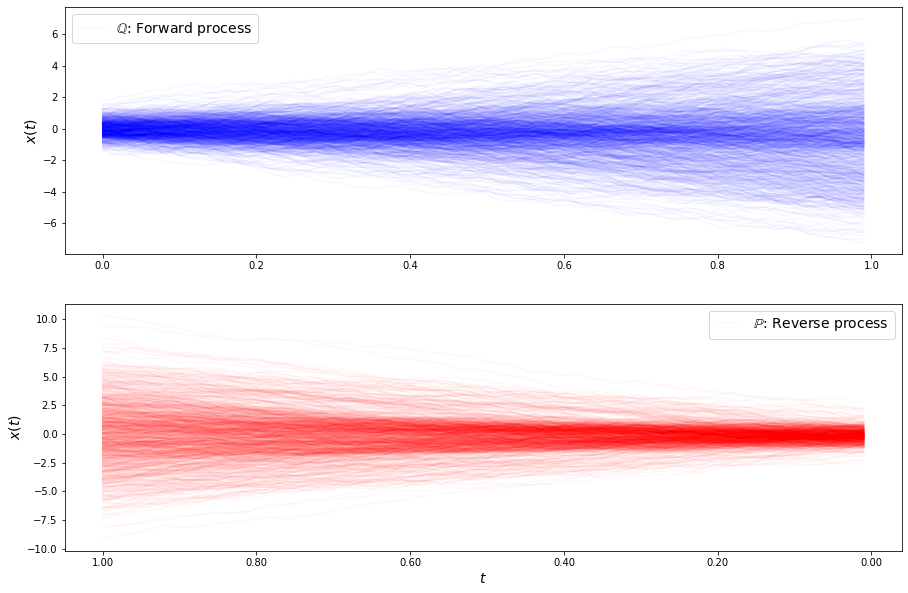

loss b 1.3905542475469932
loss b 1.4332597385008135
loss b 1.6461853827449253
loss b 1.4808701257469443
loss b 1.4702231502790322
loss b 1.4217973609788446
loss b 1.6425202692958796
loss b 1.5067504632402657
loss b 1.5407735252064692
loss b 1.625169364929558
loss b 1.5619162454060342
loss b 1.5136214052895496
loss b 1.5493592999608397
loss b 1.4439212325298025
loss b 1.5822965230483148
loss b 1.452285431739459
loss b 1.3804702092579564
loss b 1.4368865163632238
loss b 1.430948094588409
loss b 1.5433322785711752
loss b 1.4987957842882482
loss b 1.4969148260392684
loss b 1.4741747156310585
loss b 1.4491713958894135
loss b 1.517664757443517
loss b 1.4478486321942996
loss b 1.5260301485356942
loss b 1.4895773504527439
loss b 1.5157235957716255
loss b 1.4102405025359108
loss f 1.1671970823532685
loss f 1.2012247768370048
loss f 1.1474260004471744
loss f 0.9848478658806408
loss f 1.113999676815369
loss f 1.2103674174545145
loss f 1.0619834970576245
loss f 1.2173577772760464
loss f 1.13901488

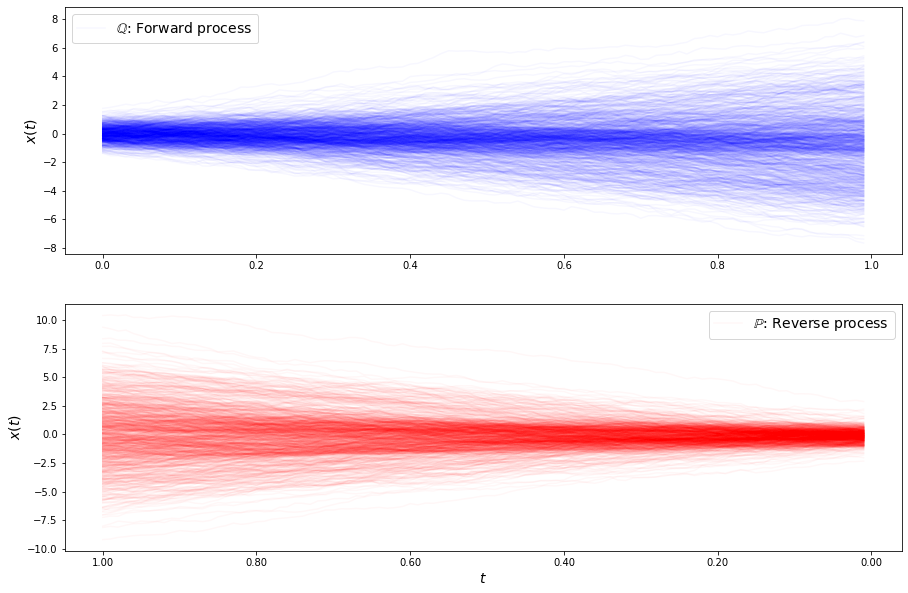

loss b 1.629672009451525
loss b 1.6344227963107842
loss b 1.6286913126153466
loss b 1.522850600404174
loss b 1.5786346504528619
loss b 1.4788747759132548
loss b 1.5774476630021077
loss b 1.5729166506494376
loss b 1.5824035401103855
loss b 1.6279833769936891
loss b 1.6070486154866155
loss b 1.4945851520081177
loss b 1.5174753642694498
loss b 1.5911619083805866
loss b 1.536534616976964
loss b 1.5756444748348397
loss b 1.6591507577497915
loss b 1.5659631565390488
loss b 1.6156618916371503
loss b 1.6143032003976299
loss b 1.5990078193867054
loss b 1.5347099582679944
loss b 1.5720468492532071
loss b 1.5914282649571938
loss b 1.4865764157478811
loss b 1.489885314640968
loss b 1.5625545879478144
loss b 1.5717285946254627
loss b 1.6138168201002543
loss b 1.4509606136672881
loss f 1.126282251974645
loss f 1.1698247163107982
loss f 1.2325236251332166
loss f 1.3057273956950906
loss f 1.3148988691726262
loss f 1.2654119622959212
loss f 1.283710236139605
loss f 1.2093851161445426
loss f 1.288646707

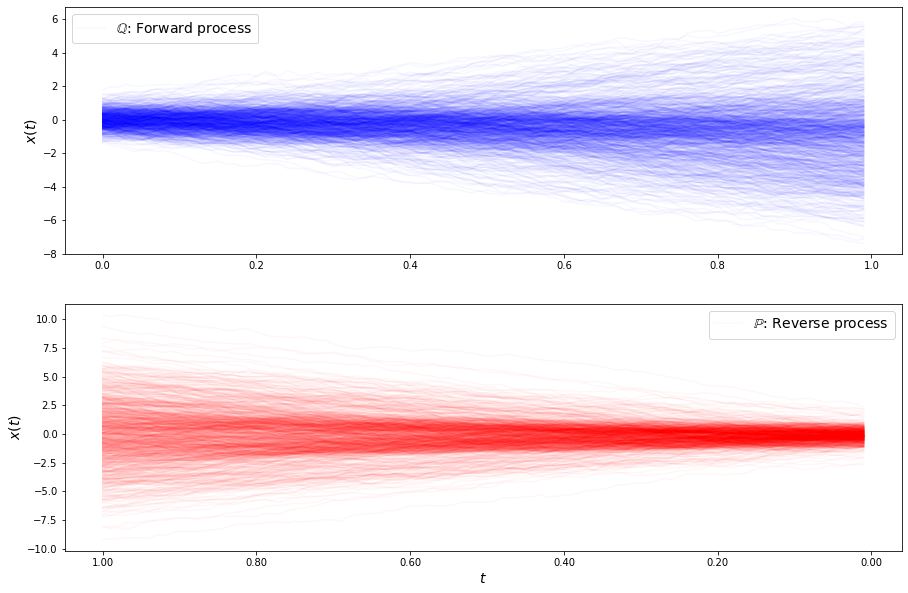

loss b 1.6892481243592754
loss b 1.6651547044559518
loss b 1.4581191864266017
loss b 1.7085971529939556
loss b 1.588639757578493
loss b 1.7689949984615412
loss b 1.6405104449123156
loss b 1.6028912276385714
loss b 1.643272540724415
loss b 1.665035380693061
loss b 1.745634664943155
loss b 1.7011539029105558
loss b 1.5421532324801426
loss b 1.6902089805677316
loss b 1.6829675133041928
loss b 1.5321206623690384
loss b 1.5560112415250476
loss b 1.7801868026663559
loss b 1.7500642205219787
loss b 1.7086549796636945
loss b 1.5662362819801152
loss b 1.6367811797531817
loss b 1.744389969540873
loss b 1.6426727423340888
loss b 1.761484599092805
loss b 1.522974501923571
loss b 1.70867587385979
loss b 1.6116592316313243
loss b 1.6406504051477155
loss b 1.5885270018914017
loss f 1.4087395211586657
loss f 1.2805860821337842
loss f 1.2958123211238928
loss f 1.2990060348054169
loss f 1.3155790789787039
loss f 1.3039768561246547
loss f 1.337022208814121
loss f 1.432250032691205
loss f 1.44351295934780

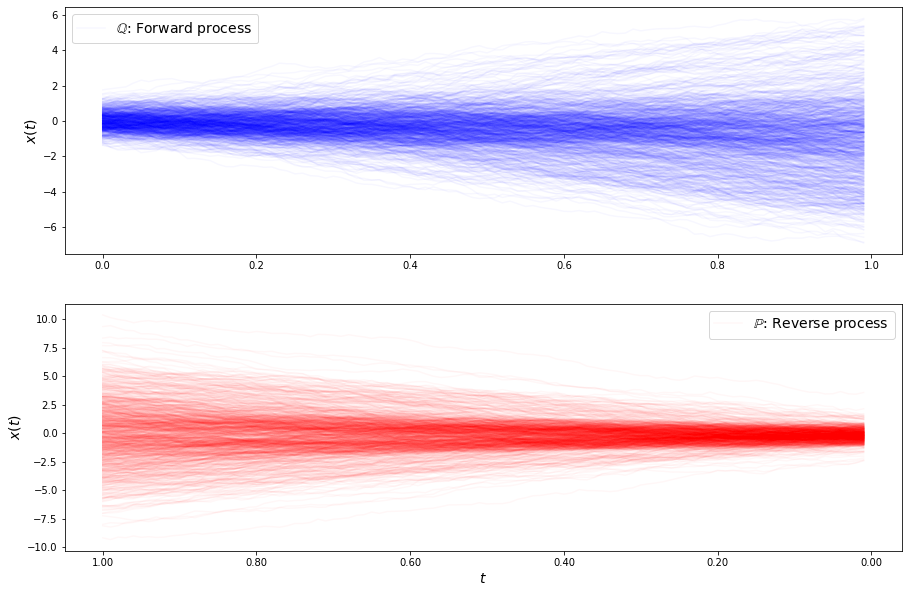

loss b 1.6377076775106951
loss b 1.6344126915095523
loss b 1.6184378574772418
loss b 1.6943744444988635
loss b 1.6178742012001925
loss b 1.7443750410051952
loss b 1.6841640061001035
loss b 1.593718684368483
loss b 1.6314420937674465
loss b 1.769111898285266
loss b 1.7779561192922486
loss b 1.8042676211026303
loss b 1.692239618855982
loss b 1.6918595724463572
loss b 1.722743715372134
loss b 1.8201291339570995
loss b 1.7080888101655094
loss b 1.7970469170393315
loss b 1.6375607016220657
loss b 1.7460700098590305
loss b 1.654618689560343
loss b 1.8334412166477614
loss b 1.6463060097574955
loss b 1.7210732695656468
loss b 1.629465683703348
loss b 1.8021364785245415
loss b 1.5678661604032997
loss b 1.7033599618027575
loss b 1.619207870359296
loss b 1.7093270064943167
loss f 1.3822876011043521
loss f 1.4167261668644138
loss f 1.380872835217335
loss f 1.45369057585548
loss f 1.3140187457589683
loss f 1.4337381249422008
loss f 1.3467365979402939
loss f 1.3359166552552701
loss f 1.3627537318273

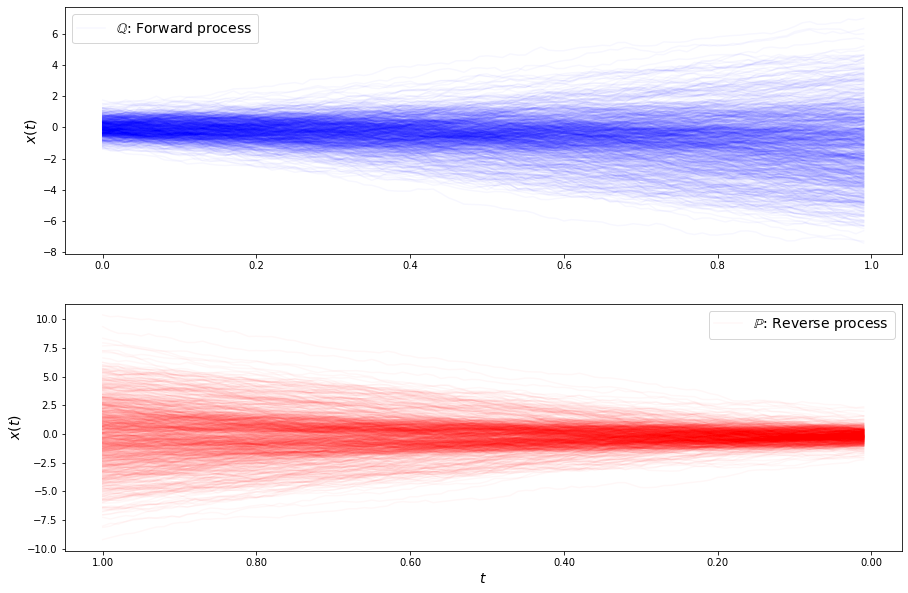

loss b 1.65191799360768
loss b 1.765858000218722
loss b 1.697529783822346
loss b 1.710278087072379
loss b 1.721485903393895
loss b 1.7192792431027633
loss b 1.6719744639196625
loss b 1.7185056439274997
loss b 1.6131205589264643
loss b 1.7530396409388973
loss b 1.6813343883599288
loss b 1.5954925456213431
loss b 1.8021047531843262
loss b 1.860522843055639
loss b 1.7208120205739308
loss b 1.819509783625161
loss b 1.7117850667947003
loss b 1.6547534095915497
loss b 1.65825623888235
loss b 1.6843319258201577
loss b 1.8533415027295699
loss b 1.6998048177014173
loss b 1.6439362985183945
loss b 1.6141126332556164
loss b 1.691008019683085
loss b 1.7250981035165487
loss b 1.5984660359322715
loss b 1.6416875904078405
loss b 1.7077138924268873
loss b 1.6901607947778448
loss f 1.2542761141834036
loss f 1.4037521905559456
loss f 1.3018532862389092
loss f 1.3429081850021194
loss f 1.3104675913879353
loss f 1.3356197855987186
loss f 1.3745316626436423
loss f 1.450400400820832
loss f 1.430674825753248

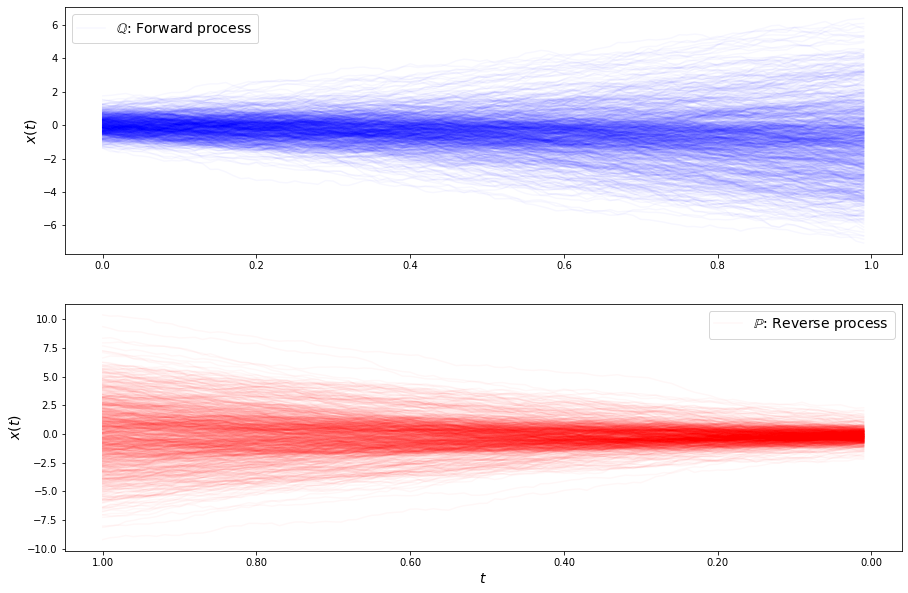

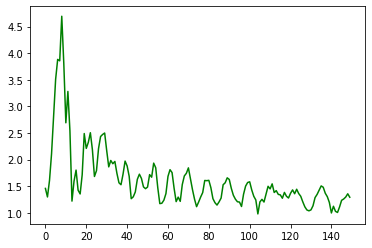

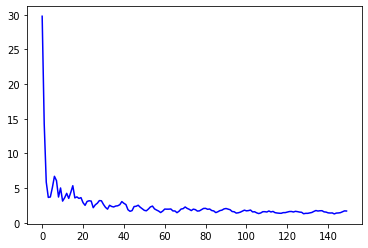

In [38]:


torch.autograd.set_detect_anomaly(True)
c.fit(150, 30, burn_iterations=0, plot=True)

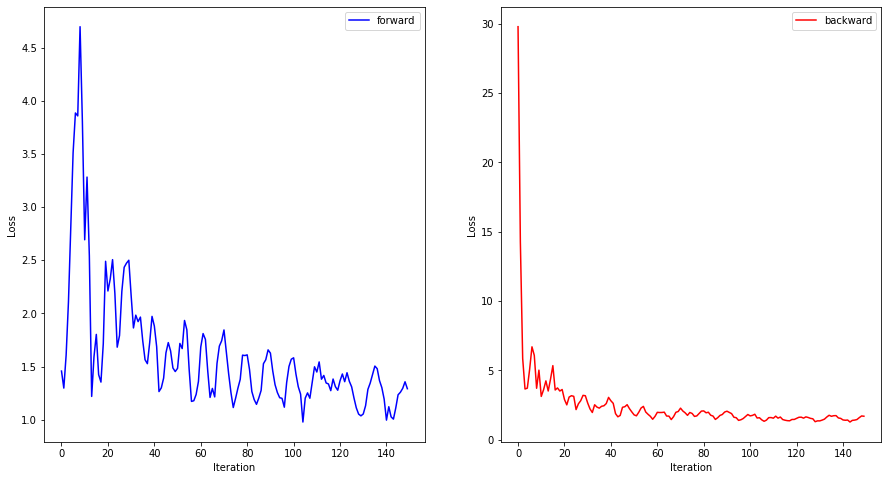

In [39]:
fig, axs = plt.subplots(1,2, sharey=False, figsize=(15, 8))
axs[0].plot(c.loss_f[:], color="blue", label="forward")
axs[0].set_xlabel("Iteration")
axs[0].set_ylabel("Loss")
axs[0].legend()
axs[1].plot(c.loss_b[:], color="red", label="backward")
axs[1].set_xlabel("Iteration")
axs[1].set_ylabel("Loss")
axs[1].legend()
plt.savefig("same_drift_loss.png")


In [40]:
bb = lambda X: -c.b_backward(X)

t, Xts = c.sde_solver(
    c.b_forward.forward, c.sigma,
    c.X_0, c.dt,  c.number_time_steps, 0.0,
    c.theta_f, False, True
)
t_, Xts_ = c.sde_solver(
    bb, c.sigma, 
    c.X_1, c.dt, c.number_time_steps, 0.0, 
    c.theta_b, False, False
)

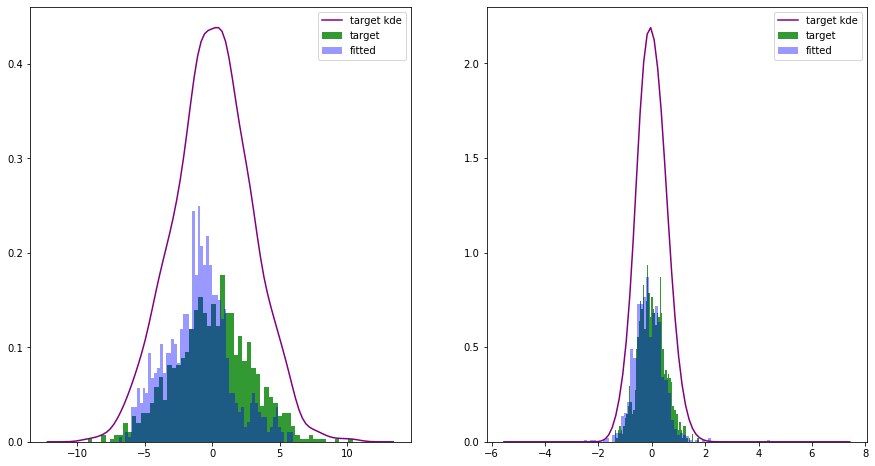

In [41]:
fig, axs = plt.subplots(1,2, figsize=(15, 8))
batch_terminal_empirical_f = next(c.data_stream(forward=True))



bins = 60
axs[1].hist(( X1.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[1].hist(( Xts_[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");



xx = torch.linspace(float(min(X1.min().detach().cpu().numpy(), Xts_[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X1.max().detach().cpu().numpy(), Xts_[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()

H = silvermans_rule(batch_terminal_empirical_f)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_f, H).detach().cpu().numpy())
axs[1].plot(xx.detach().cpu().numpy(), kd, label="target kde", color="purple")
axs[1].legend()

batch_terminal_empirical_b = next(c.data_stream(forward=False))
# xx = torch.linspace(-10, 10).reshape(-1,1).cuda().double()
xx = torch.linspace(float(min(X2.min().detach().cpu().numpy(), Xts[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X2.max().detach().cpu().numpy(), Xts[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()

Hb = silvermans_rule(batch_terminal_empirical_b)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_b, Hb).detach().cpu().numpy())
axs[0].plot(xx.detach().cpu().numpy(), kd, label="target kde", color="purple")


bins = 60
axs[0].hist(( X2.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[0].hist(( Xts[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[0].legend()
plt.savefig("same_drift_tanh_marginals.png")

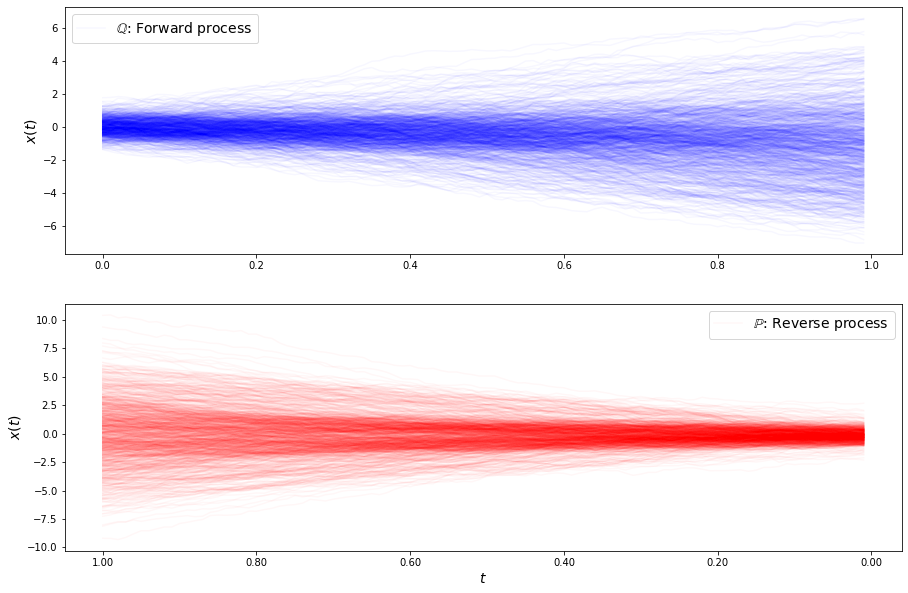

In [42]:
def plot_trajectories(self):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)
        plt.savefig("same_drift_best_tanh_trajectories.png")
        plt.show()    
plot_trajectories(c)